# Intra-individual variability in functional organization

## Load packages

In [1]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv
import math
from math import isnan
import statistics
import pingouin as pg
import pickle

# Computing / Analyses
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM
from statsmodels.stats.multitest import fdrcorrection # does not yield exactly the same FDR correction as R but the same up to 14th decimal place so good enough
import statsmodels.regression.mixed_linear_model as sm

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn
from brainstat.datasets import fetch_parcellation
from enigmatoolbox.permutation_testing import spin_test, shuf_test

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

/data/hu_serio/.local/lib/python3.9/site-packages/pandas/core/computation/expressions.py:21: UserWarning: Pandas requires version '2.8.0' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
/data/hu_serio/.local/lib/python3.9/site-packages/pandas/core/arrays/masked.py:62: UserWarning: Pandas requires version '1.3.4' or newer of 'bottleneck' (version '1.3.2' currently installed).
  from pandas.core import (


## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/28Me/data/'

resdir = '/data/p_02667/28Me/results/'
resdir_fig = resdir + 'figures/'

## Import functions

In [187]:
%run '/data/p_02667/28Me/scripts/p28Me_myfunctions.ipynb'

# Data

## Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)

In [4]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

yeo7_networks_array = np.genfromtxt(datadir+'yeo_7.csv', delimiter=',', skip_header=0)

In [5]:
# Sofie's 17 to 7 network conversion for Schaefer 400 (17 network) parcel order

yeo_17_2_7 = np.genfromtxt(datadir+'yeo_17_2_7.csv', delimiter=',')

### Define custom yeo 7 colormap

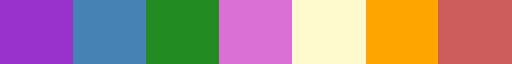

In [6]:
from matplotlib.colors import ListedColormap

# define custom colormap using color names (in order of corresponding networks: 1 visual, 2 sensorimotor, 3 dorsal attention, 4 ventral attention, 5 limbic, 6 fronto parietal, 7 DMN)
colors_yeo7 = ['darkorchid', 'steelblue', 'forestgreen', 'orchid', 'lemonchiffon', 'orange',  'indianred']

yeo7_colormap = ListedColormap(colors_yeo7, 'custom_colormap')

yeo7_colormap

### Plot on hemispheres

#### Schaefer 400 7 networks

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


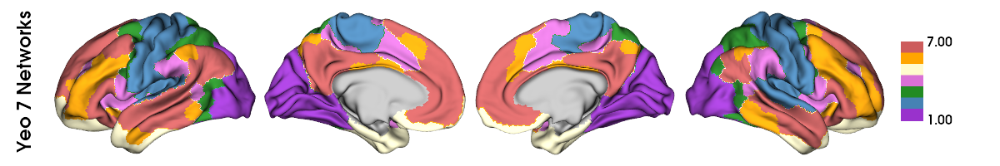

In [7]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan) 

plot_hemispheres(surf_lh, surf_rh, 
                 array_name=networks, 
                 embed_nb = True, 
                 size=(1200, 200), 
                 cmap= yeo7_colormap, 
                 color_bar=True, 
                 nan_color = (0.7, 0.7, 0.7, 1),
                 label_text=['Yeo 7 Networks'], 
                 zoom=1.55,
                 screenshot=False,
                 filename=resdir_fig+'plotted_hemispheres_yeo7.png')

#### Schaefer 400 17 to 7 networks, plotted in fs5 space

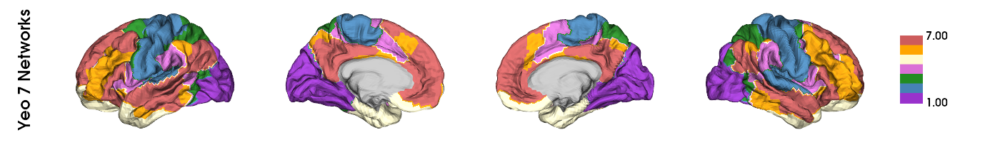

In [8]:
# convert network labels to fs5 space
yeo_17_2_7_fs5 = schaefer400_to_fs5(schaefer400_data = yeo_17_2_7, seven_networks=False)


# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = yeo_17_2_7_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = yeo7_colormap, 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Yeo 7 Networks"],
    zoom = 1.45,
    screenshot=False,
    filename=resdir_fig+'plotted_hemispheres_yeo7.png')

In [9]:
# making an array with yeo network labels (names instead of numbers)
yeo_17_2_7_networks_array_labels = []

for i in yeo_17_2_7:
    if i == 1:
        yeo_17_2_7_networks_array_labels.append('visual')
    elif i == 2:
        yeo_17_2_7_networks_array_labels.append('sensory motor')
    elif i == 3:
        yeo_17_2_7_networks_array_labels.append('dorsal attention')
    elif i == 4:
        yeo_17_2_7_networks_array_labels.append('ventral attention')
    elif i == 5:
        yeo_17_2_7_networks_array_labels.append('limbic')
    elif i == 6:
        yeo_17_2_7_networks_array_labels.append('fronto parietal')
    elif i == 7:
        yeo_17_2_7_networks_array_labels.append('DMN')

yeo_17_2_7_networks_array_labels = np.asarray(yeo_17_2_7_networks_array_labels)

This palette is to be used for every time that Yeo networks are displayed in color (except (a) for showing the networks plotted on the hemispheres - this dictionary doesn't work as cmap for plot_hemispheres; (b) the pie charts - dictionary format not recognized)

In [10]:
# original Yeo network colors
palette_labeled_networks = {'DMN': 'indianred',  
                            'dorsal attention' : 'forestgreen',  
                            'fronto parietal' : 'orange',  
                            'limbic' : 'lemonchiffon',  
                            'sensory motor' : 'steelblue',
                            'ventral attention' : 'orchid', 
                            'visual' : 'darkorchid'} 

In [11]:
network_names = ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"]

print("Number of parcels in each Yeo network:")
for i in range(len(network_names)):
    print(f"- {network_names[i]}: {yeo_17_2_7_networks_array_labels.tolist().count(network_names[i])}")

Number of parcels in each Yeo network:
- visual: 61
- sensory motor: 77
- dorsal attention: 46
- ventral attention: 47
- limbic: 26
- fronto parietal: 53
- DMN: 90


## Fetch fsaverage parcellation (20484 vertices) coded for Schaefer 400 parcels - for Spin permutation tests

Spin permutation testing: https://enigma-toolbox.readthedocs.io/en/latest/pages/08.spintest/index.html -> requires data to be in fsaverage surface (not feasible with Schaefer parcellation)

**NOTE: schaefer_400_fs5 == 0 corresponds to midline (labels go from 0-400) -> disregard 0 in calculations and plotting**

In [12]:
# fetch the fsaverage parcellation labeling each of fsaverage5's 20484 vertices with its corresponding Schaefer parcel
schaefer_400_fs5 = fetch_parcellation("fsaverage5", "schaefer", 400)

## 28&Me functional matrices

In [13]:
path_list = os.listdir(datadir + 'coherence/coherence/28andMe/noGSR/')
path_list.sort()

In [14]:
fc_matrices = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + 'coherence/coherence/28andMe/noGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices.append(extracted_mat)
    
fc_matrices = np.array(fc_matrices)

In [15]:
fc_matrices.shape

(30, 400, 400)

## 28&He functional matrices

In [16]:
path_list = os.listdir(datadir + '28andHe_Coherence_withoutGSR/')
path_list.sort()

In [17]:
fc_matrices_He = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + '28andHe_Coherence_withoutGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices_He.append(extracted_mat)
    
fc_matrices_He = np.array(fc_matrices_He)

In [18]:
fc_matrices_He.shape

(40, 400, 400)

### Making AM and PM only arrays (following the hormone CSV file)

In [19]:
fc_matrices_He_AM = np.delete(fc_matrices_He, (11,13,15,17,19,21,23,25,27,29,30,31,32,33,34,35,36,37,38,39), axis=0)

In [20]:
fc_matrices_He_AM.shape

(20, 400, 400)

In [21]:
fc_matrices_He_PM = np.delete(fc_matrices_He, (0,1,2,3,4,5,6,7,8,9,10,12,14,16,18,20,22,24,26,28), axis=0)

In [22]:
fc_matrices_He_PM.shape

(20, 400, 400)

## Hormonal data

### 28 & Me

In [23]:
hormones = pd.read_csv(datadir+'28Hormones_LP_3_30_20.csv')
testosterone_28Me = pd.read_csv(datadir+'28MeTestosterone.csv')

hormones_28Me = hormones[hormones['Experiment'] == '28andMe']
hormones_28Me = hormones_28Me.rename(columns={"Estradiol (LCMS; pg/mL)": "estradiol", "Progesterone (LCMS; ng/mL)": "progesterone", "LH (mIU/ml)": "lh", "FSH (mIU/ml)": "fsh"})
hormones_28Me['testosterone'] = testosterone_28Me['testosterone']


# standardize hormone values for linear model
hormones_28Me['z_estradiol'] = (hormones_28Me.estradiol - np.mean(hormones_28Me.estradiol)) / np.std(hormones_28Me.estradiol)
hormones_28Me['z_progesterone'] = (hormones_28Me.progesterone - np.mean(hormones_28Me.progesterone)) / np.std(hormones_28Me.progesterone)
hormones_28Me['z_testosterone'] = (hormones_28Me.testosterone - np.mean(hormones_28Me.testosterone)) / np.std(hormones_28Me.testosterone)


# export to csv
hormones_28Me.to_csv(resdir+'hormones_28Me.csv', header = True, index = True)

# exclude day 26 because problem with functional data on that day
hormones_28Me_excl26 = hormones_28Me.drop(25)
hormones_28Me_excl26.to_csv(resdir+'hormones_28Me_excl26.csv', header = True, index = True)


# re-indexing order in menstrual cycle order -> from experimental day 11 -> (index 10)
hormones_28Me_MCreindexed = hormones_28Me.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_MCreindexed['MC day'] = list(range(1,31))


# re-indexing order in menstrual cycle order (IN DATA EXCLUDING DAY 26)-> from experimental day 11 -> (index 10)
hormones_28Me_MCreindexed_excl26 = hormones_28Me_excl26.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_MCreindexed_excl26['MC day'] = list(range(1,31))
hormones_28Me_MCreindexed_excl26['MC day'][25] = np.nan # make MC day corresponding to day 26 nan

/tmp/ipykernel_46539/2734677953.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28Me_MCreindexed_excl26['MC day'][25] = np.nan # make MC day corresponding to day 26 nan


#### Plot

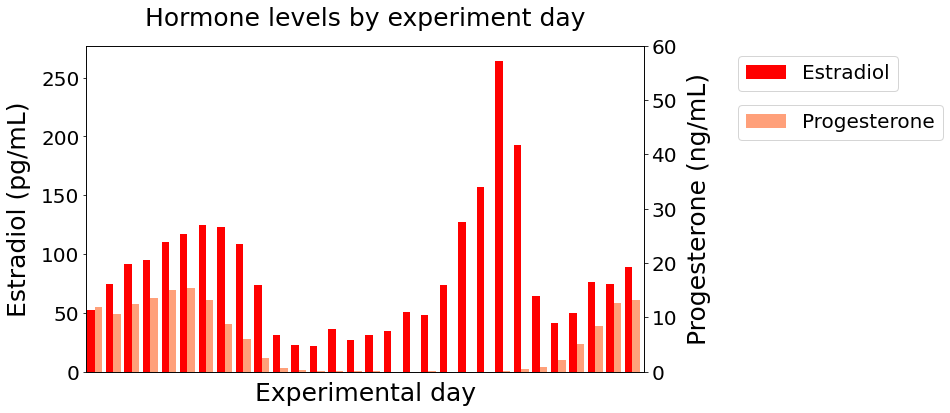

In [24]:
dict_hormones = {'Estradiol': hormones_28Me.estradiol,
                 'Progesterone': hormones_28Me.progesterone,
                 'ExperimentDay': hormones_28Me.ExperimentDay}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Estradiol'].plot(kind='bar', color='red', ax=ax, width=width, position=1)
df_hormones['Progesterone'].plot(kind='bar', color='lightsalmon', ax=ax2, width=width, position=0)

ax.set_ylabel('Estradiol (pg/mL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Progesterone (ng/mL)', fontsize=25, labelpad=10)
ax.set_xlabel('Experimental day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit for progesterone
ax2.set_ylim(0, 60)

# Remove x-axis ticks
ax.set_xticks([])

ax.set_title('Hormone levels by experiment day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_by_experimental_day.png', bbox_inches='tight', dpi=300)

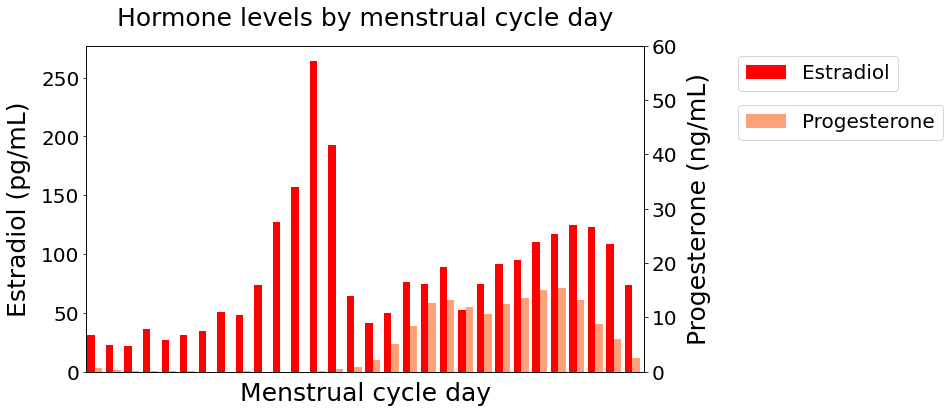

In [346]:
dict_hormones = {'Estradiol': hormones_28Me_MCreindexed.estradiol, 
                 'Progesterone': hormones_28Me_MCreindexed.progesterone, 
                 'MC day': hormones_28Me_MCreindexed['MC day']}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Estradiol'].plot(kind='bar', color='red', ax=ax, width=width, position=1)
df_hormones['Progesterone'].plot(kind='bar', color='lightsalmon', ax=ax2, width=width, position=0)

ax.set_ylabel('Estradiol (pg/mL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Progesterone (ng/mL)', fontsize=25, labelpad=10)
ax.set_xlabel('Menstrual cycle day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit for progesterone
ax2.set_ylim(0, 60)

# Remove x-axis ticks
ax.set_xticks([])


ax.set_title('Hormone levels by menstrual cycle day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_by_MC_day.png', bbox_inches='tight', dpi=300)

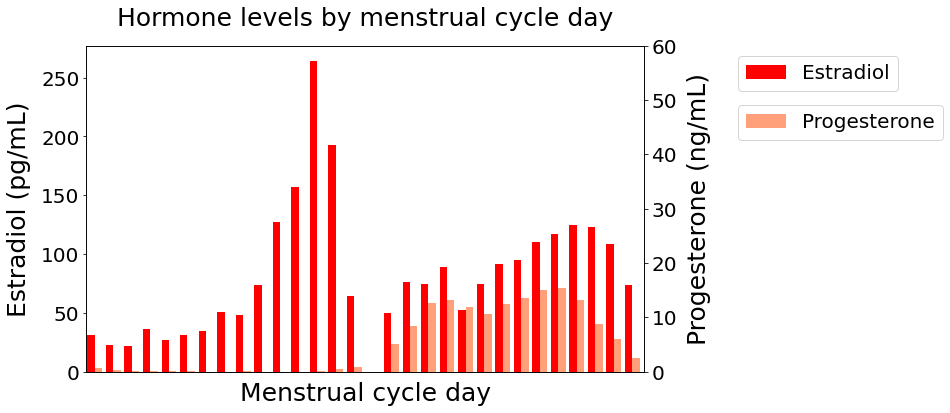

In [347]:
dict_hormones = {'Estradiol': hormones_28Me_MCreindexed_excl26.estradiol, 
                 'Progesterone': hormones_28Me_MCreindexed_excl26.progesterone, 
                 'MC day': hormones_28Me_MCreindexed_excl26['MC day']}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Estradiol'].plot(kind='bar', color='red', ax=ax, width=width, position=1)
df_hormones['Progesterone'].plot(kind='bar', color='lightsalmon', ax=ax2, width=width, position=0)

ax.set_ylabel('Estradiol (pg/mL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Progesterone (ng/mL)', fontsize=25, labelpad=10)
ax.set_xlabel('Menstrual cycle day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit for progesterone
ax2.set_ylim(0, 60)

# Remove x-axis ticks
ax.set_xticks([])

ax.set_title('Hormone levels by menstrual cycle day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_by_MC_day_excl26.png', bbox_inches='tight', dpi=300)

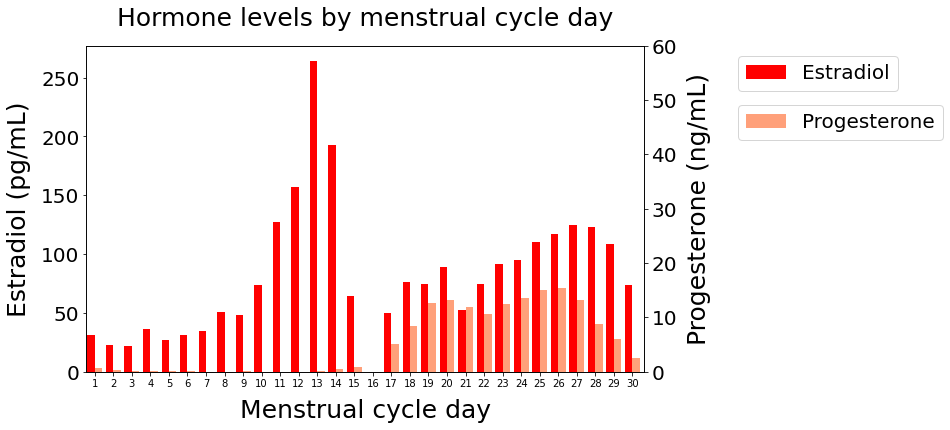

In [374]:
dict_hormones = {'Estradiol': hormones_28Me_MCreindexed_excl26.estradiol, 
                 'Progesterone': hormones_28Me_MCreindexed_excl26.progesterone, 
                 'MC day': hormones_28Me_MCreindexed_excl26['MC day']}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Estradiol'].plot(kind='bar', color='red', ax=ax, width=width, position=1)
df_hormones['Progesterone'].plot(kind='bar', color='lightsalmon', ax=ax2, width=width, position=0)

ax.set_ylabel('Estradiol (pg/mL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Progesterone (ng/mL)', fontsize=25, labelpad=10)
ax.set_xlabel('Menstrual cycle day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit for progesterone
ax2.set_ylim(0, 60)

# Set x-axis ticks from 0 to 30
ax.set_xticks(range(len(df_hormones)))
ax.set_xticklabels([str(i+1) for i in range(30)], rotation=0, fontsize=10)  # Set the labels to range from 1 to 30

ax.set_title('Hormone levels by menstrual cycle day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_by_MC_day_excl26.png', bbox_inches='tight', dpi=300)

In [27]:
print(f"Hormone levels\nEstradiol: M = {round(np.mean(hormones_28Me_excl26.estradiol), 2)}, SD = {round(np.std(hormones_28Me_excl26.estradiol), 2)}\nProgesterone: M = {round(np.mean(hormones_28Me_excl26.progesterone), 2)}, SD = {round(np.std(hormones_28Me_excl26.progesterone),2)}")

Hormone levels
Estradiol: M = 84.26, SD = 53.74
Progesterone: M = 5.25, SD = 5.84


#### Checking for collinearity

In [28]:
# For main analysis
stats.spearmanr(hormones_28Me_excl26.estradiol, hormones_28Me_excl26.progesterone, nan_policy='omit')

SignificanceResult(statistic=0.3255728011825573, pvalue=0.08480650059196888)

In [29]:
# For exploratory analysis
stats.spearmanr(hormones_28Me_excl26.estradiol, hormones_28Me_excl26.testosterone, nan_policy='omit')

SignificanceResult(statistic=0.13597733814189186, pvalue=0.48185167024732134)

#### Behavior

In [30]:
behavior = pd.read_csv(datadir+'28behavioral.tsv', sep='\t')

behavior = behavior.rename(columns={"perceived_stress": "PSS"})

# get only Me data
behavior_28Me = behavior.iloc[:30, :]

# add Experiment column (for linear models)
behavior_28Me['Experiment'] = "28andMe"

# standardize hormone values for linear model
behavior_28Me['z_PSS'] = (behavior_28Me.PSS - np.mean(behavior_28Me.PSS)) / np.std(behavior_28Me.PSS)

# exclude day 26 because problem with functional data on that day
behavior_28Me_excl26 = behavior_28Me.drop(25)

# export to csv
behavior_28Me_excl26.to_csv(resdir+'behavior_28Me_excl26.csv', header = True, index = True)

/tmp/ipykernel_46539/484949236.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28Me['Experiment'] = "28andMe"
/tmp/ipykernel_46539/484949236.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28Me['z_PSS'] = (behavior_28Me.PSS - np.mean(behavior_28Me.PSS)) / np.std(behavior_28Me.PSS)


### 28 & He

In [31]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

In [32]:
hormones_28He.keys()

Index(['session', 'time', 'date (MM/DD/YY)', 'cortisol_serum',
       'cortisol_saliva', 'estradiol_serum', 'free_testosterone_serum',
       'total_testosterone_saliva', 'total_testosterone_serum', 'PSS_raw',
       'PSS_group', 'aggression', 'PSQI_score', 'STAI', 'POMS', 'POMS_tension',
       'POMS_depression', 'POMS_anger', 'POMS_vigor', 'POMS_fatigue',
       'POMS_confusion'],
      dtype='object')

In [33]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

# adding a variable for sampling day
hormones_28He['day'] = [1,2,3,4,5,6,7,8,9,10,11,11,12,12,13,13,14,14,15,15,16,16,17,17,18,18,19,19,20,20,21,22,23,24,25,26,27,28,29,30]

# splitting into AM and PM datasets
hormones_28He_AM = hormones_28He[hormones_28He['time'] == 'Morning']
hormones_28He_PM = hormones_28He[hormones_28He['time'] == 'Evening']

# standardize hormone values for linear model
hormones_28He['z_total_testosterone_saliva'] = (hormones_28He.total_testosterone_saliva - np.mean(hormones_28He.total_testosterone_saliva)) / np.std(hormones_28He.total_testosterone_saliva)
hormones_28He_AM['z_total_testosterone_saliva'] = (hormones_28He_AM.total_testosterone_saliva - np.mean(hormones_28He_AM.total_testosterone_saliva)) / np.std(hormones_28He_AM.total_testosterone_saliva)
hormones_28He_PM['z_total_testosterone_saliva'] = (hormones_28He_PM.total_testosterone_saliva - np.mean(hormones_28He_PM.total_testosterone_saliva)) / np.std(hormones_28He_PM.total_testosterone_saliva)

hormones_28He['z_cortisol_saliva'] = (hormones_28He.cortisol_saliva - np.mean(hormones_28He.cortisol_saliva)) / np.std(hormones_28He.cortisol_saliva)
hormones_28He_AM['z_cortisol_saliva'] = (hormones_28He_AM.cortisol_saliva - np.mean(hormones_28He_AM.cortisol_saliva)) / np.std(hormones_28He_AM.cortisol_saliva)
hormones_28He_PM['z_cortisol_saliva'] = (hormones_28He_PM.cortisol_saliva - np.mean(hormones_28He_PM.cortisol_saliva)) / np.std(hormones_28He_PM.cortisol_saliva)

hormones_28He['z_estradiol_serum'] = (hormones_28He.estradiol_serum - np.mean(hormones_28He.estradiol_serum)) / np.std(hormones_28He.estradiol_serum)
hormones_28He_AM['z_estradiol_serum'] = (hormones_28He_AM.estradiol_serum - np.mean(hormones_28He_AM.estradiol_serum)) / np.std(hormones_28He_AM.estradiol_serum)
hormones_28He_PM['z_estradiol_serum'] = (hormones_28He_PM.estradiol_serum - np.mean(hormones_28He_PM.estradiol_serum)) / np.std(hormones_28He_PM.estradiol_serum)

hormones_28He['z_total_testosterone_serum'] = (hormones_28He.total_testosterone_serum - np.mean(hormones_28He.total_testosterone_serum)) / np.std(hormones_28He.total_testosterone_serum)
hormones_28He_AM['z_total_testosterone_serum'] = (hormones_28He_AM.total_testosterone_serum - np.mean(hormones_28He_AM.total_testosterone_serum)) / np.std(hormones_28He_AM.total_testosterone_serum)
hormones_28He_PM['z_total_testosterone_serum'] = (hormones_28He_PM.total_testosterone_serum - np.mean(hormones_28He_PM.total_testosterone_serum)) / np.std(hormones_28He_PM.total_testosterone_serum)


hormones_28He['z_PSS'] = (hormones_28He.PSS_raw - np.mean(hormones_28He.PSS_raw)) / np.std(hormones_28He.PSS_raw)
hormones_28He_AM['z_PSS'] = (hormones_28He_AM.PSS_raw - np.mean(hormones_28He_AM.PSS_raw)) / np.std(hormones_28He_AM.PSS_raw)
hormones_28He_PM['z_PSS'] = (hormones_28He_PM.PSS_raw - np.mean(hormones_28He_PM.PSS_raw)) / np.std(hormones_28He_PM.PSS_raw)


# export to csv
hormones_28He_AM.to_csv(resdir+'hormones_28He_AM.csv', header = True, index = True)
hormones_28He_PM.to_csv(resdir+'hormones_28He_PM.csv', header = True, index = True)

/tmp/ipykernel_46539/1149994010.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28He_AM['z_total_testosterone_saliva'] = (hormones_28He_AM.total_testosterone_saliva - np.mean(hormones_28He_AM.total_testosterone_saliva)) / np.std(hormones_28He_AM.total_testosterone_saliva)
/tmp/ipykernel_46539/1149994010.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28He_PM['z_total_testosterone_saliva'] = (hormones_28He_PM.total_testosterone_saliva - np.mean(hormones_28He_PM.total_testosterone_

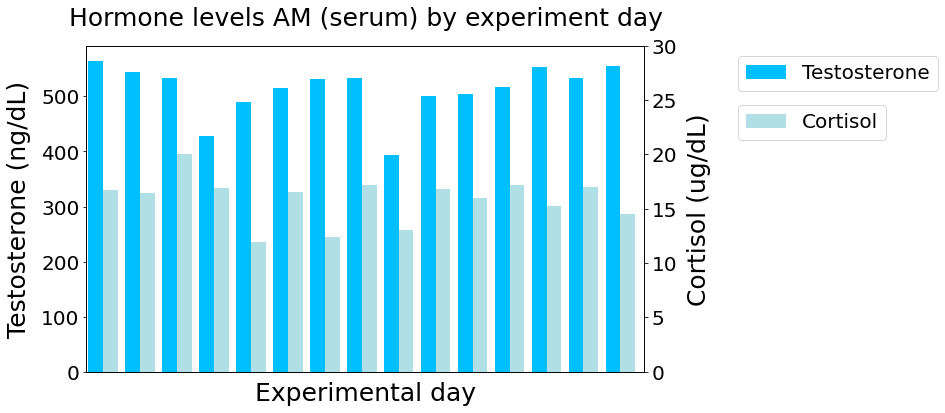

In [34]:
dict_hormones = {'Testosterone': hormones_28He_AM.total_testosterone_serum[:15], 
                 'Cortisol': hormones_28He_AM.cortisol_serum[:15],
                'ExperimentDay': hormones_28He_AM.session[:15]}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Testosterone'].plot(kind='bar', color='deepskyblue', ax=ax, width=width, position=1)
df_hormones['Cortisol'].plot(kind='bar', color='powderblue', ax=ax2, width=width, position=0)

ax.set_ylabel('Testosterone (ng/dL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Cortisol (ug/dL)', fontsize=25, labelpad=10)
ax.set_xlabel('Experimental day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit 
ax2.set_ylim(0, 30)

# Remove x-axis ticks
ax.set_xticks([])

ax.set_title('Hormone levels AM (serum) by experiment day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_He_AM_serum.png', bbox_inches='tight', dpi=300)

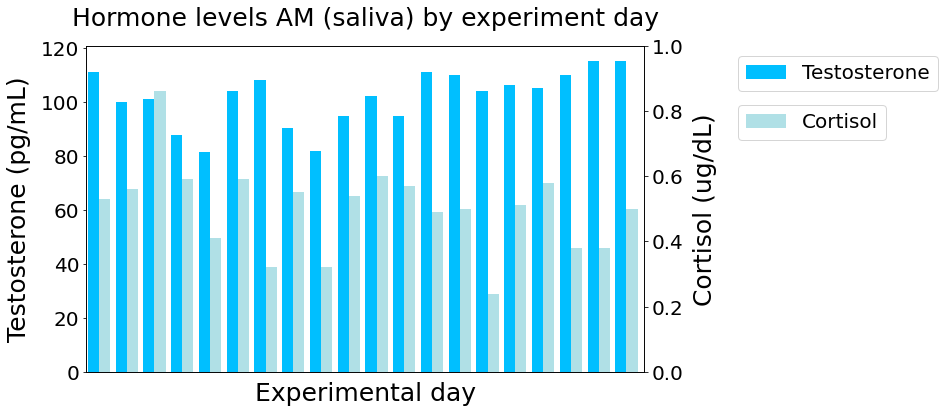

In [367]:
dict_hormones = {'Testosterone': hormones_28He_AM.total_testosterone_saliva[:20], 
                 'Cortisol': hormones_28He_AM.cortisol_saliva[:20],
                'ExperimentDay': hormones_28He_AM.session[:20]}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Testosterone'].plot(kind='bar', color='deepskyblue', ax=ax, width=width, position=1)
df_hormones['Cortisol'].plot(kind='bar', color='powderblue', ax=ax2, width=width, position=0)

ax.set_ylabel('Testosterone (pg/mL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Cortisol (ug/dL)', fontsize=25, labelpad=10)
ax.set_xlabel('Experimental day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit 
ax2.set_ylim(0, 1)

# Remove x-axis ticks
ax.set_xticks([])

ax.set_title('Hormone levels AM (saliva) by experiment day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_He_AM_saliva.png', bbox_inches='tight', dpi=300)

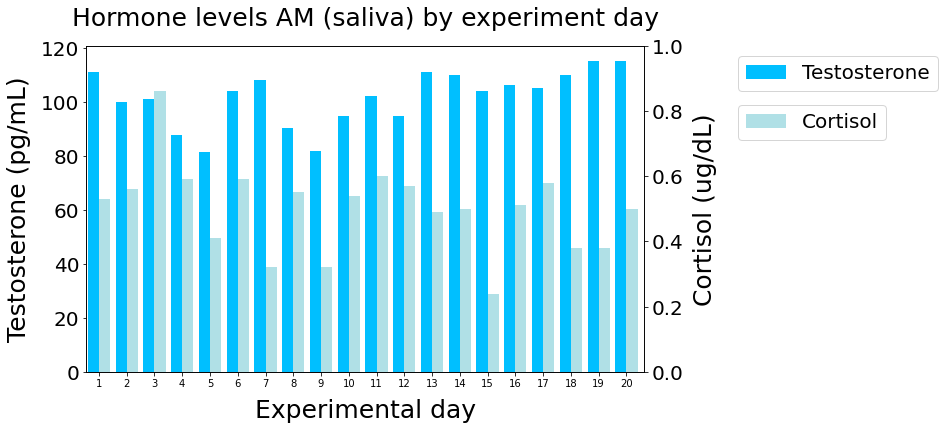

In [373]:
dict_hormones = {'Testosterone': hormones_28He_AM.total_testosterone_saliva[:20], 
                 'Cortisol': hormones_28He_AM.cortisol_saliva[:20],
                'ExperimentDay': hormones_28He_AM.session[:20]}

df_hormones = pd.DataFrame(dict_hormones)

fig = plt.figure(figsize=(10,6)) # Create matplotlib figure

ax = fig.add_subplot(111) # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.4

df_hormones['Testosterone'].plot(kind='bar', color='deepskyblue', ax=ax, width=width, position=1)
df_hormones['Cortisol'].plot(kind='bar', color='powderblue', ax=ax2, width=width, position=0)

ax.set_ylabel('Testosterone (pg/mL)', fontsize=25, labelpad=10)
ax2.set_ylabel('Cortisol (ug/dL)', fontsize=25, labelpad=10)
ax.set_xlabel('Experimental day', fontsize=25, labelpad=10)

ax.tick_params(labelsize=20);
ax2.tick_params(labelsize=20);

# Set y-axis limit 
ax2.set_ylim(0, 1)

# Set x-axis ticks from 0 to 20
ax.set_xticks(range(len(df_hormones)))
ax.set_xticklabels([str(i+1) for i in range(20)], rotation=0, fontsize=10)  # Set the labels to range from 1 to 30

ax.set_title('Hormone levels AM (saliva) by experiment day', fontsize=25, pad=20);

# Move the legends outside the graph
ax.legend(loc='upper left', bbox_to_anchor=(1.15, 1), fontsize=20)
ax2.legend(loc='upper left', bbox_to_anchor=(1.15, 0.85), fontsize=20)

# Adjust x-axis limits to shift the bars
bar_shift = 0.2  # Adjust this value to shift the bars
ax.set_xlim(ax.get_xlim()[0] - bar_shift, ax.get_xlim()[1])

plt.savefig(resdir_fig + 'hormone_levels_He_AM_saliva.png', bbox_inches='tight', dpi=300)

In [36]:
print(f"Hormone levels (saliva)\nTestosterone: M = {round(np.mean(hormones_28He_AM.total_testosterone_saliva), 2)}, SD = {round(np.std(hormones_28He_AM.total_testosterone_saliva), 2)}\nCortisol: M = {round(np.mean(hormones_28He_AM.cortisol_saliva), 2)}, SD = {round(np.std(hormones_28He_AM.cortisol_saliva),2)}")

Hormone levels (saliva)
Testosterone: M = 101.61, SD = 9.98
Cortisol: M = 0.5, SD = 0.13


#### Checking for collinearity

In [37]:
# For main analysis
stats.spearmanr(hormones_28He_AM.total_testosterone_saliva, hormones_28He_AM.cortisol_saliva, nan_policy='omit')

SignificanceResult(statistic=-0.2854449472096531, pvalue=0.22249021838844069)

In [38]:
# For exploratory analysis
stats.spearmanr(hormones_28He_AM.total_testosterone_serum, hormones_28He_AM.estradiol_serum, nan_policy='omit')

SignificanceResult(statistic=0.8315465599698786, pvalue=0.00012161843017642618)

#### Associations serum/saliva levels

##### Testosterone

(array([1., 0., 0., 0., 0., 0., 1., 1., 4., 5., 1., 0., 0., 3., 1., 0., 0.,
        3., 6., 4.]),
 array([ 64.4 ,  89.38, 114.36, 139.34, 164.32, 189.3 , 214.28, 239.26,
        264.24, 289.22, 314.2 , 339.18, 364.16, 389.14, 414.12, 439.1 ,
        464.08, 489.06, 514.04, 539.02, 564.  ]),
 <BarContainer object of 20 artists>)

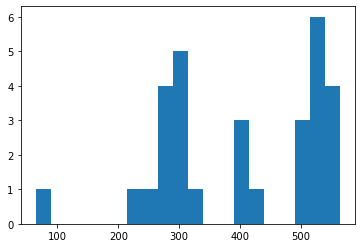

In [35]:
plt.hist(hormones_28He['total_testosterone_serum'], bins=20)

In [34]:
stats.spearmanr(hormones_28He['total_testosterone_serum'], hormones_28He['total_testosterone_saliva'], nan_policy='omit')

SignificanceResult(statistic=0.8955690044151291, pvalue=2.3487895284053423e-11)

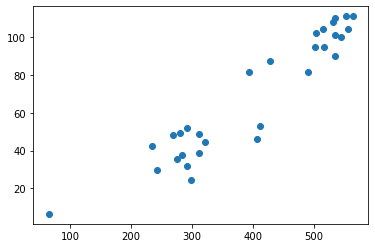

In [35]:
plt.scatter(hormones_28He['total_testosterone_serum'], hormones_28He['total_testosterone_saliva'])

##### Cortisol

(array([9., 4., 1., 1., 0., 0., 0., 0., 0., 0., 0., 2., 1., 0., 2., 1., 8.,
        0., 0., 1.]),
 array([ 1.6  ,  2.521,  3.442,  4.363,  5.284,  6.205,  7.126,  8.047,
         8.968,  9.889, 10.81 , 11.731, 12.652, 13.573, 14.494, 15.415,
        16.336, 17.257, 18.178, 19.099, 20.02 ]),
 <BarContainer object of 20 artists>)

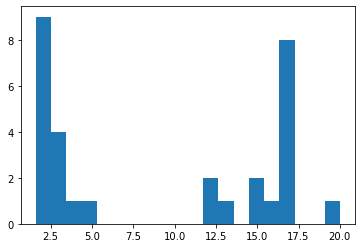

In [36]:
plt.hist(hormones_28He['cortisol_serum'], bins=20)

In [37]:
stats.spearmanr(hormones_28He['cortisol_serum'], hormones_28He['cortisol_saliva'], nan_policy='omit')

SignificanceResult(statistic=0.915044727717242, pvalue=1.4772012682045496e-12)

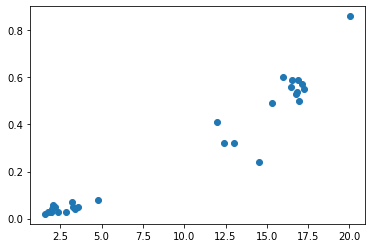

In [38]:
plt.scatter(hormones_28He['cortisol_serum'], hormones_28He['cortisol_saliva'])

### Perceived stress - subject comparison

- higher perceived stress in male 
- higher variance in perceived stress in female
- but no actual statistically significant difference 

In [39]:
print(f"PSS scores\nFemale: M = {round(np.mean(behavior_28Me_excl26.PSS), 2)}, SD = {round(np.std(behavior_28Me_excl26.PSS), 2)}\nMale: M = {round(np.mean(hormones_28He_AM.PSS_raw), 2)}, SD = {round(np.std(hormones_28He_AM.PSS_raw),2)}")

PSS scores
Female: M = 8.28, SD = 6.59
Male: M = 10.1, SD = 2.1


In [40]:
stats.mannwhitneyu(behavior_28Me_excl26.PSS, hormones_28He_AM.PSS_raw) 

MannwhitneyuResult(statistic=211.5, pvalue=0.1108981704194866)

#
#
# Building gradients (Me; exclusion day 26)

## Exclude day 26

In [37]:
fc_matrices_excl26 = np.delete(fc_matrices, 25, axis = 0)

Export to csv

In [38]:
# re-indexing order in menstrual cycle order -> from experimental day 11 -> (index 10)
hormones_28Me_excl26_MCreindexed = hormones_28Me_excl26.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_excl26_MCreindexed['MC day'] = list(range(1,31))

hormones_28Me_excl26_MCreindexed = hormones_28Me_excl26_MCreindexed.drop(25)  # remove the row of day 26 with nans

## Mean gradient

In [39]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_excl26 = sum(fc_matrices_excl26)/len(fc_matrices_excl26)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_excl26 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_excl26 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_excl26.fit(mean_fc_matrix_excl26)

# mean G1
mean_fc_G1_excl26 = mean_fc_grad_excl26.gradients_[:,0]

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')


In [40]:
print(f"Total amount of variance explained by the {len(mean_fc_grad_excl26.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_fc_grad_excl26.lambdas_):.2f}\n")

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_fc_grad_excl26.lambdas_[0]/sum(mean_fc_grad_excl26.lambdas_)*100:.2f}%\nG2: {mean_fc_grad_excl26.lambdas_[1]/sum(mean_fc_grad_excl26.lambdas_)*100:.2f}%\nG3: {mean_fc_grad_excl26.lambdas_[2]/sum(mean_fc_grad_excl26.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 31.75

Scaled variance explained by individual gradients:
G1: 33.95%
G2: 18.84%
G3: 12.29%



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

In [41]:
mean_fc_G1_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_excl26, seven_networks=False)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


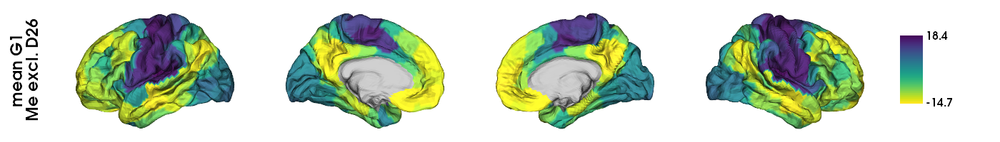

In [42]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nMe excl. D26"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_mean_G1.png')

plotted_hemispheres

## Aligned gradients

In [43]:
compute_aligned_grad_excl26 = compute_aligned_gradients(fc_matrices_excl26, mean_fc_grad_excl26.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1_excl26 = compute_aligned_grad_excl26['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [44]:
array_aligned_fc_G1_excl26.shape

(29, 400)

In [45]:
# fmt = decimals, 
# header = str(list(range(1,401)))[1:-1] ->header = 1 to 400 (without the first and last string letter because it's the [] of the list -> only use for R export, np.genfromtxt will read it as an additional line which is wrong
# comments = empty because otherwise gives a #

np.savetxt(resdir+'array_aligned_fc_G1_excl26.csv', array_aligned_fc_G1_excl26, delimiter=',', fmt = '%.16g', comments = '')

## Variability in gradients

### Quantify variability

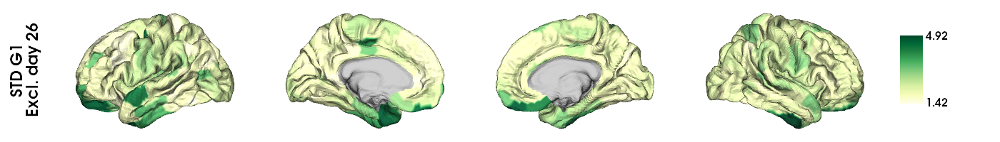

In [48]:
# compute the standard deviation across days per parcel
std_fc_G1_excl26 = np.std(array_aligned_fc_G1_excl26, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_G1_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_G1_excl26, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_G1_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nExcl. day 26"],
    zoom = 1.45)

plotted_hemispheres

2024-03-13 09:43:46,422 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


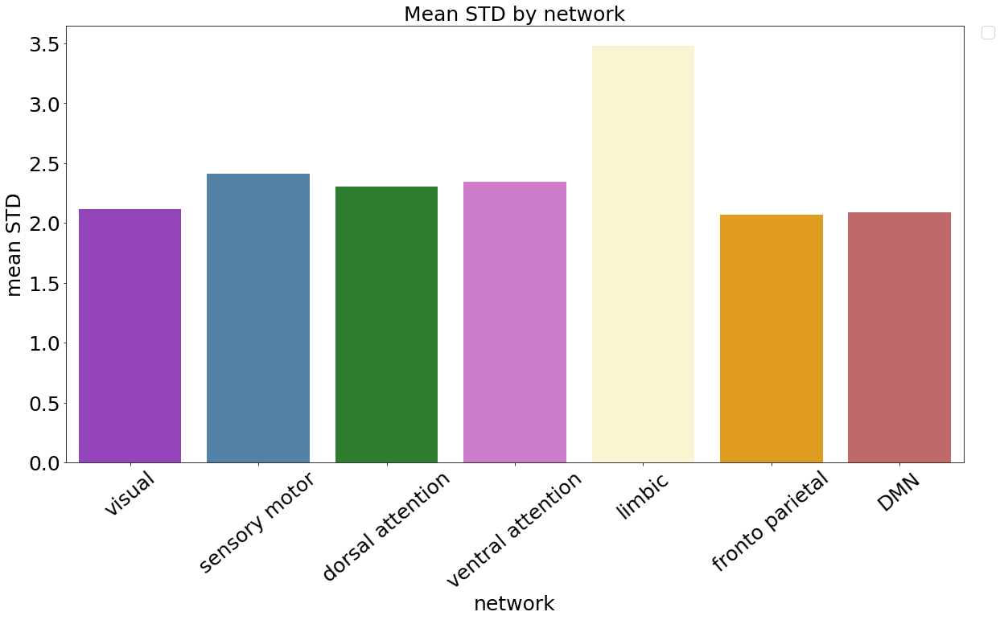

In [49]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_G1_excl26)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_G1_excl26[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_G1_excl26[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1_excl26 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1_excl26 = pd.DataFrame(dict_std_fc_G1_excl26)

df_std_fc_G1_excl26_long = pd.melt(df_std_fc_G1_excl26, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_excl26_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Building gradients (He; AM)

## Mean gradient

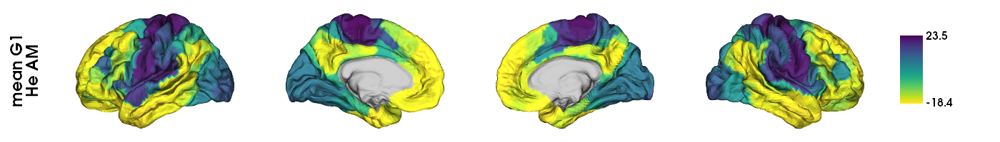

In [46]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_AM = sum(fc_matrices_He_AM)/len(fc_matrices_He_AM)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_He_AM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_He_AM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_He_AM.fit(mean_fc_matrix_He_AM)

# mean G1
mean_fc_G1_He_AM = mean_fc_grad_He_AM.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_AM_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He_AM, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_AM_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_AM_mean_G1.png')

plotted_hemispheres

In [47]:
print(f"Total amount of variance explained by the {len(mean_fc_grad_He_AM.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_fc_grad_He_AM.lambdas_):.2f}\n")

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_fc_grad_He_AM.lambdas_[0]/sum(mean_fc_grad_He_AM.lambdas_)*100:.2f}%\nG2: {mean_fc_grad_He_AM.lambdas_[1]/sum(mean_fc_grad_He_AM.lambdas_)*100:.2f}%\nG3: {mean_fc_grad_He_AM.lambdas_[2]/sum(mean_fc_grad_He_AM.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 39.49

Scaled variance explained by individual gradients:
G1: 35.47%
G2: 24.35%
G3: 9.60%



## Aligned gradients

In [48]:
compute_aligned_grad_He_AM = compute_aligned_gradients(fc_matrices_He_AM, mean_fc_grad_He_AM.gradients_) 

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_AM_G1 = compute_aligned_grad_He_AM['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [49]:
# fmt = decimals, 
# header = str(list(range(1,401)))[1:-1] ->header = 1 to 400 (without the first and last string letter because it's the [] of the list -> only use for R export, np.genfromtxt will read it as an additional line which is wrong
# comments = empty because otherwise gives a #

np.savetxt(resdir+'array_aligned_fc_He_AM_G1.csv', array_aligned_fc_He_AM_G1, delimiter=',', fmt = '%.16g', comments = '')

## Variability in gradients

### Visualize daily gradients

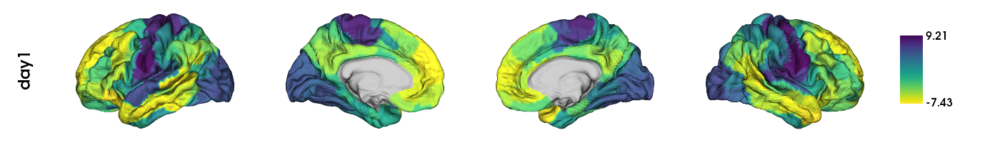

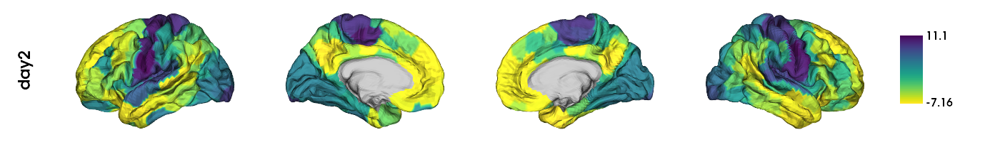

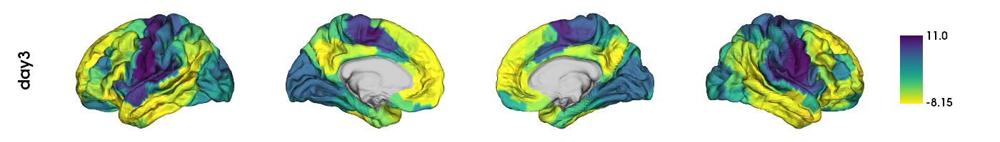

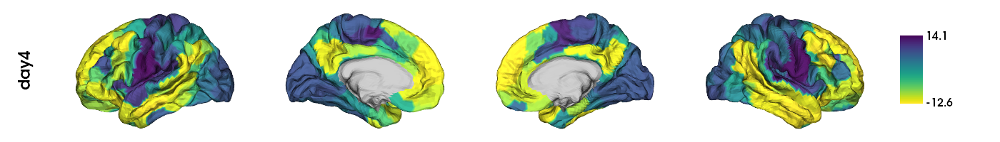

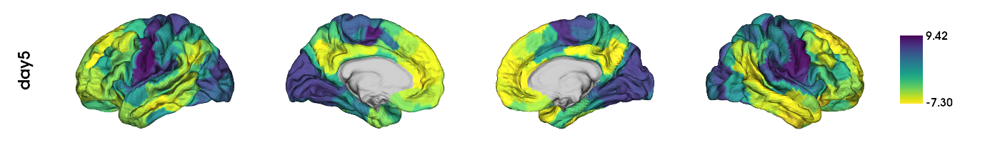

...

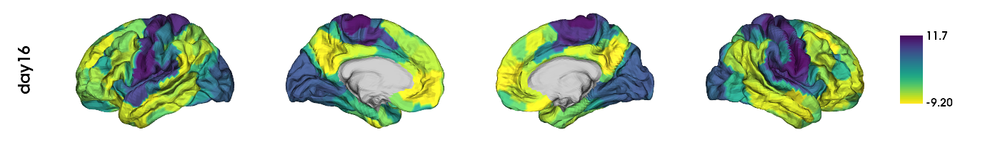

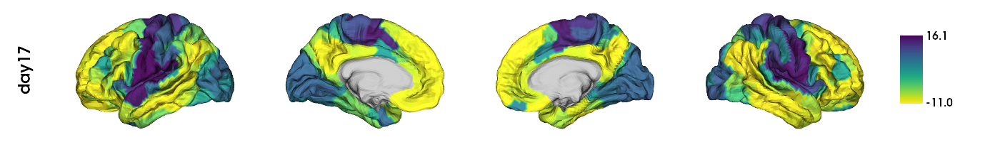

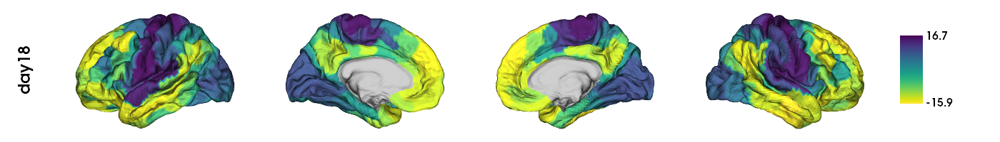

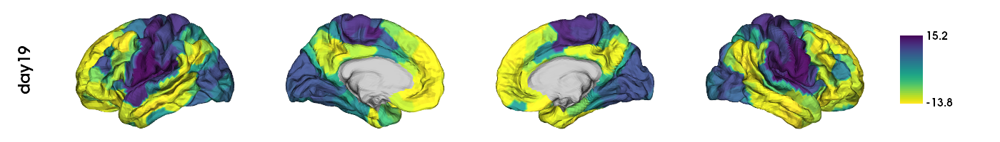

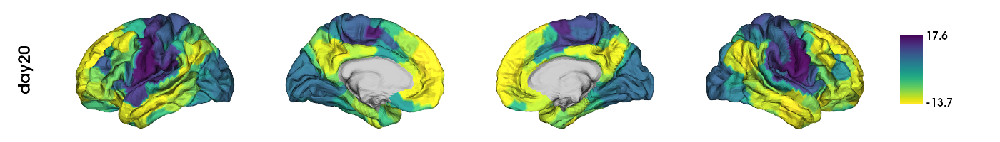

In [50]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_He_AM_G1)):
    
    # transform to fs5 for plotting
    fc_He_AM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_He_AM_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_He_AM_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

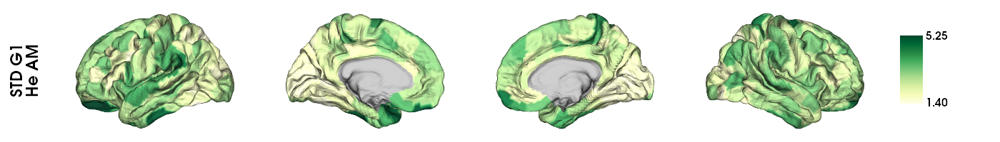

In [51]:
# compute the standard deviation across days per parcel
std_fc_He_AM_G1 = np.std(array_aligned_fc_He_AM_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_He_AM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_He_AM_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_He_AM_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nHe AM"],
    zoom = 1.45)

plotted_hemispheres

2024-04-10 17:04:13,710 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


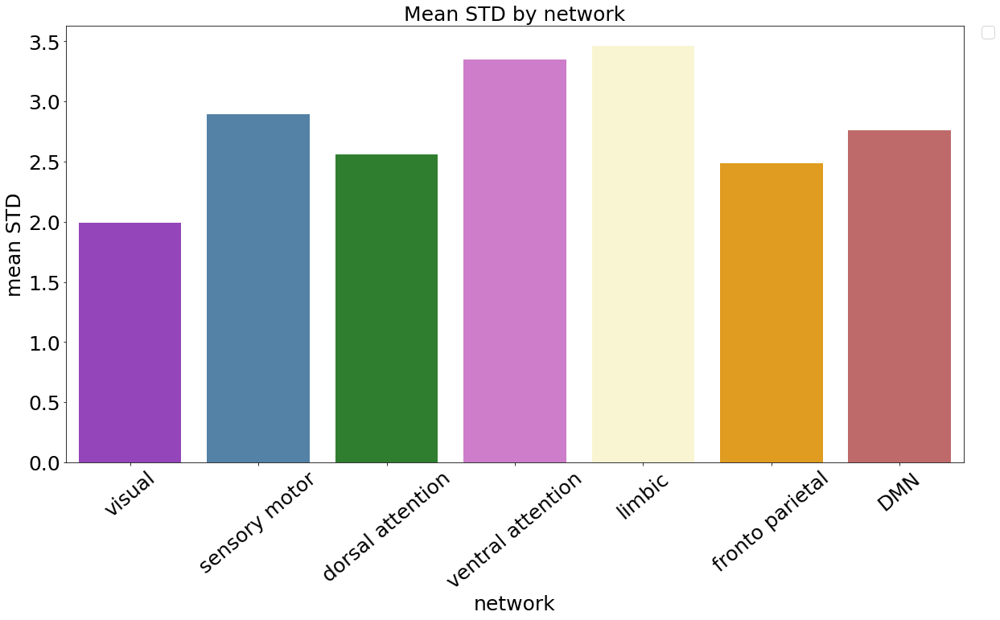

In [52]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_He_AM_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_He_AM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_He_AM_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Correlation mean gradients by sample

Me vs He (AM)

In [53]:
stats.spearmanr(mean_fc_G1_excl26, mean_fc_G1_He_AM)

SignificanceResult(statistic=0.8626938293364332, pvalue=6.667628688774034e-120)

He (AM) vs He (PM)

In [ ]:
stats.spearmanr(mean_fc_G1_He_AM, mean_fc_G1_He_PM)

Me (excluding day 26) vs OC

Me vs He (PM) -> I would have expected r(Me(AM), He(AM)) > r(Me(AM), PM)) given possible other biological/environmental factors making the connectome more similar at the same time of the day...

In [227]:
stats.spearmanr(mean_fc_G1_excl26, mean_fc_G1_He_PM)

SpearmanrResult(correlation=0.8799615622597641, pvalue=9.938886725491869e-131)

OC and He (AM)

OC and He (PM)

#
#
# Differences in variability

## Me vs He (AM)

Number of parcels for which there males have a statistically significant larger variance than females: 100
Number of parcels for which there females have a statistically significant larger variance than males: 2
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 19
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.399; Females = 1.421
Maximum SD: Males = 5.247; Females = 4.916


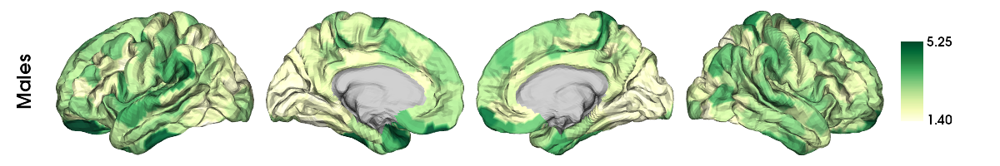

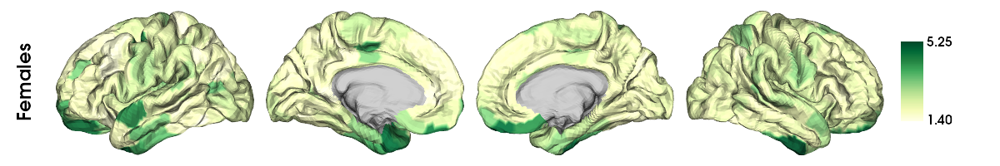

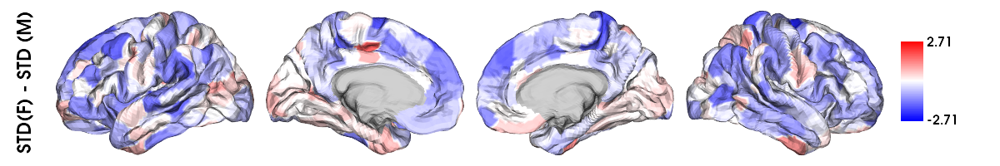

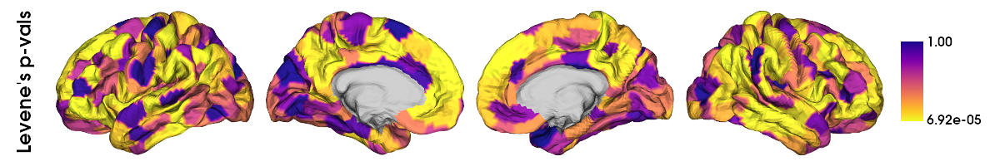

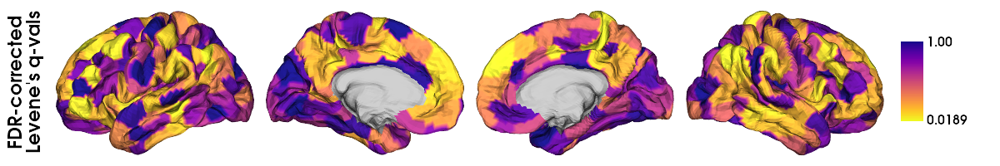

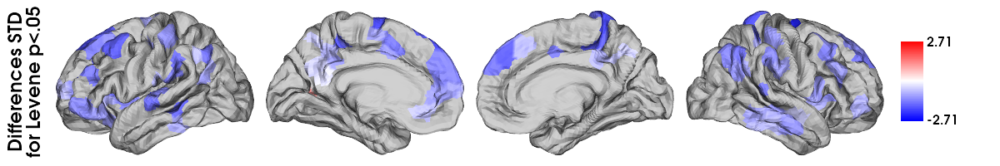

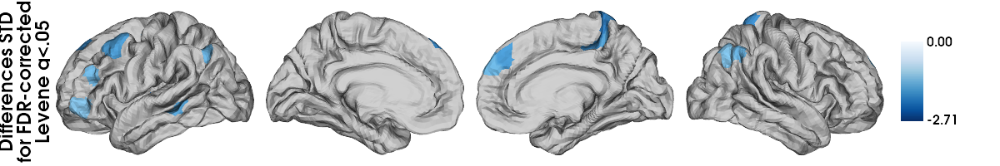

Number of significant parcels: 19

Number of significant parcels for males: 19
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 3 out of 77 (3.9%) -> 15.79% of overall significance
- DMN: 8 out of 46 (17.39%) -> 42.11% of overall significance
- dorsal attention: 2 out of 47 (4.26%) -> 10.53% of overall significance
- ventral attention: 3 out of 26 (11.54%) -> 15.79% of overall significance
- limbic: 0 out of 53 (0.0%) -> 0.0% of overall significance
- fronto parietal: 3 out of 90 (3.33%) -> 15.79% of overall significance





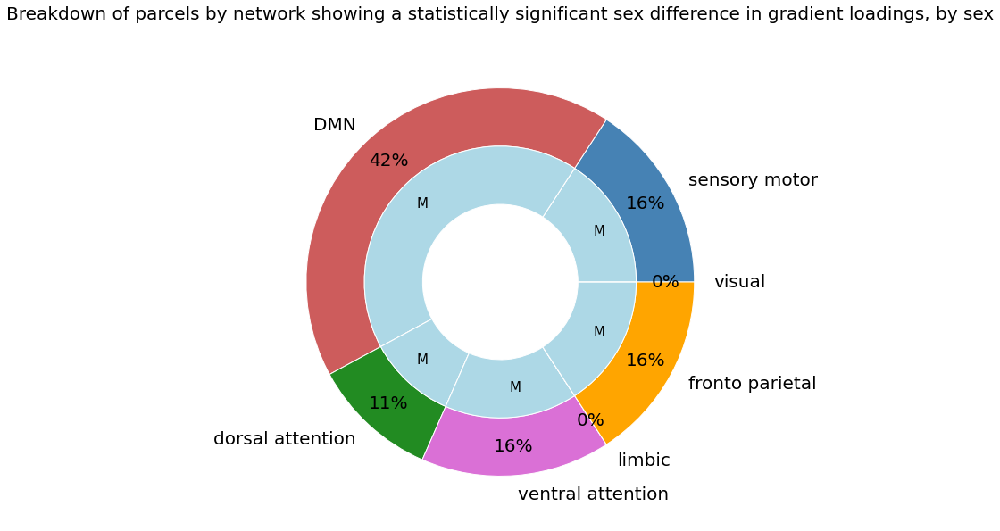

Number of significant parcels by sex:
visual - Male: 0, Female: 0
sensory motor - Male: 3, Female: 0
DMN - Male: 8, Female: 0
dorsal attention - Male: 2, Female: 0
ventral attention - Male: 3, Female: 0
limbic - Male: 0, Female: 0
fronto parietal - Male: 3, Female: 0





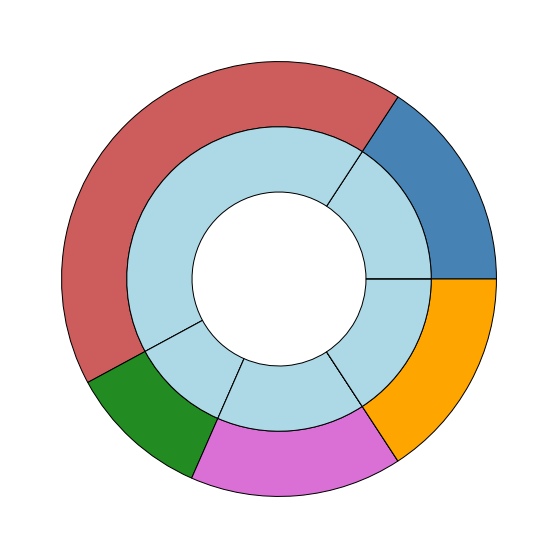

In [61]:
diff_std_Me_He_AM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_AM_G1, subject_grad_F=array_aligned_fc_G1_excl26, sample_modality='Me_HeAM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


### Mean inter-subject variability by network (by sex)

In [113]:
mean_std_per_network = {'M': [], 'F': []}

for network in network_names:
    mean_std_per_network['M'].append(np.mean(np.std(array_aligned_fc_He_AM_G1, axis=0)[yeo_17_2_7_networks_array_labels==network]))
    mean_std_per_network['F'].append(np.mean(np.std(array_aligned_fc_G1_excl26, axis=0)[yeo_17_2_7_networks_array_labels==network]))
    
mean_std_per_network = pd.DataFrame(mean_std_per_network)

mean_std_per_network['networks'] = network_names

mean_std_per_network = pd.melt(mean_std_per_network, id_vars='networks', value_vars=['M', 'F'], var_name='subject', value_name = 'mean std')

mean_std_per_network

,networks,subject,mean std
0,visual,M,1.993538
1,sensory motor,M,2.896508
2,dorsal attention,M,2.558656
3,ventral attention,M,3.346124
4,limbic,M,3.459462
5,fronto parietal,M,2.489286
6,DMN,M,2.759595
7,visual,F,2.113257
8,sensory motor,F,2.412419
9,dorsal attention,F,2.305102


<Figure size 1080x720 with 0 Axes>

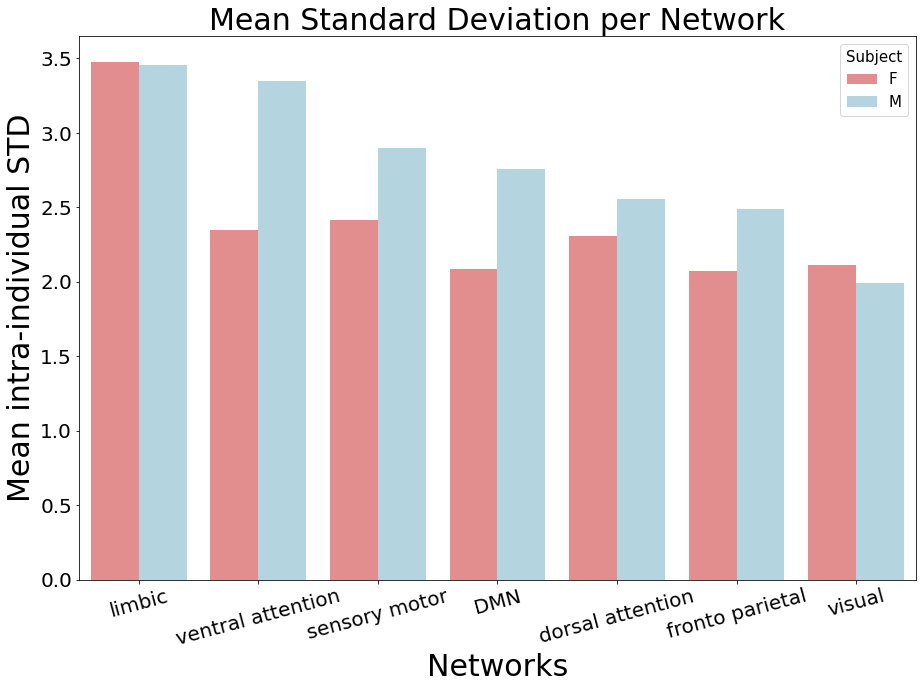

In [138]:
plt.figure(figsize=(15, 10))

# Sort the DataFrame by mean std for the "M" subject in descending order
mean_std_per_network_sorted = mean_std_per_network.sort_values(by='mean std', ascending=False)

# Define custom colors for M and F subjects
colors = {'M': 'lightblue', 'F': 'lightcoral'}

# Plotting using Seaborn barplot
plt.figure(figsize=(15, 10))
sns.barplot(data=mean_std_per_network_sorted, x="networks", y="mean std", hue="subject", palette=colors)

plt.title('Mean Standard Deviation per Network', fontsize=30)
plt.xlabel('Networks', fontsize=30)
plt.ylabel('Mean intra-individual STD', fontsize=30)
plt.xticks(rotation=15, fontsize=20)
plt.yticks(rotation=0, fontsize=20)

# Accessing the legend object and setting the font size
legend = plt.legend(title='Subject', fontsize=15)
legend.get_title().set_fontsize(15)

plt.show()

<Figure size 1080x720 with 0 Axes>

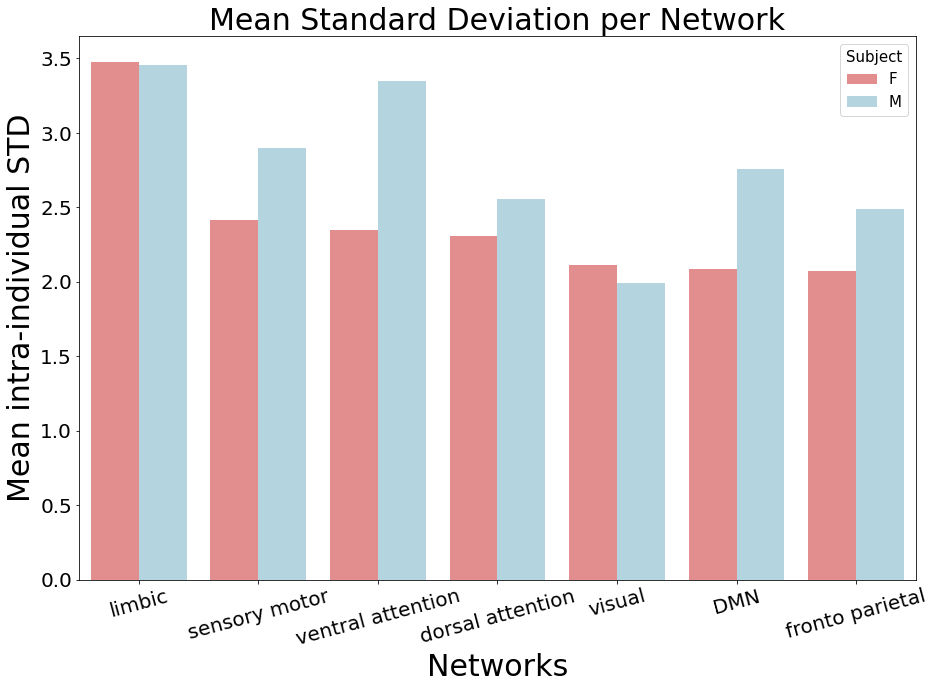

In [140]:
plt.figure(figsize=(15, 10))

# Sort the DataFrame by mean std for the "F" subject in descending order
mean_std_per_network['sort_column'] = mean_std_per_network['mean std'].where(mean_std_per_network['subject'] == 'F')
mean_std_per_network_sorted = mean_std_per_network.sort_values(by='sort_column', ascending=False).drop(columns='sort_column')

# Define custom colors for M and F subjects
colors = {'M': 'lightblue', 'F': 'lightcoral'}

# Plotting using Seaborn barplot
plt.figure(figsize=(15, 10))
sns.barplot(data=mean_std_per_network_sorted, x="networks", y="mean std", hue="subject", palette=colors)

plt.title('Mean Standard Deviation per Network', fontsize=30)
plt.xlabel('Networks', fontsize=30)
plt.ylabel('Mean intra-individual STD', fontsize=30)
plt.xticks(rotation=15, fontsize=20)
plt.yticks(rotation=0, fontsize=20)

# Accessing the legend object and setting the font size
legend = plt.legend(title='Subject', fontsize=15)
legend.get_title().set_fontsize(15)

plt.show()

### Correlation between male and female intrasubject variability

In [70]:
stats.spearmanr(np.std(array_aligned_fc_He_AM_G1, axis=0), np.std(array_aligned_fc_G1_excl26, axis=0))

SpearmanrResult(correlation=0.2901635010218814, pvalue=3.3635218586147074e-09)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0005


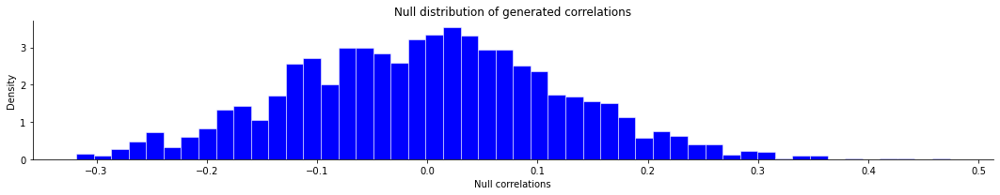

{'spin_test_p': 0.0005,
 'spin_test_d': array([-0.11500444,  0.10411056,  0.03939375, ..., -0.05158556,
        -0.06786915, -0.09784764])}

In [71]:
SpinPermutationTest_Schaefer400(x = np.std(array_aligned_fc_He_AM_G1, axis=0), y = np.std(array_aligned_fc_G1_excl26, axis=0), correlation_type = 'spearman')

#
#
# Linear Mixed Model

using statsmodels package https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.html#statsmodels.regression.mixed_linear_model.MixedLM

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

## MixedLM (Me) with Exclusion day 26

### Run model - hormones

In [39]:
lmer_res_excl26 = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model   
    model = sm.MixedLM(
        endog = array_aligned_fc_G1_excl26.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'progesterone': hormones_28Me_excl26.z_progesterone}),  # fixed effects (covariate)
        groups = hormones_28Me_excl26.Experiment, 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_excl26['parcel'].append(i)
    lmer_res_excl26['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_excl26['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_excl26['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res_excl26['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res_excl26['estradiol_q_val'] = fdrcorrection(lmer_res_excl26['estradiol_p_val'], alpha=0.05)[1]
lmer_res_excl26['progesterone_q_val'] = fdrcorrection(lmer_res_excl26['progesterone_p_val'], alpha=0.05)[1]

lmer_res_excl26 = pd.DataFrame(lmer_res_excl26)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [40]:
lmer_res_excl26

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,1.009706,0.312636,-0.210594,0.833204,0.991361,0.925783
1,1,1.030593,0.302732,-0.414142,0.678770,0.991361,0.835409
2,2,0.358343,0.720087,0.702620,0.482292,0.991361,0.696203
3,3,-0.167756,0.866776,0.078117,0.937735,0.991361,0.993373
4,4,-0.452989,0.650556,0.355857,0.721947,0.991361,0.864680
...,...,...,...,...,...,...,...
395,395,-0.868175,0.385299,2.566308,0.010279,0.991361,0.152278
396,396,-0.260687,0.794334,2.960132,0.003075,0.991361,0.089028
397,397,-0.837294,0.402427,2.278254,0.022711,0.991361,0.162830
398,398,-0.141164,0.887741,2.507142,0.012171,0.991361,0.153442


In [41]:
np.where(np.array(lmer_res_excl26.estradiol_q_val) < 0.05)[0].shape

(0,)

In [42]:
np.where(np.array(lmer_res_excl26.progesterone_q_val) < 0.05)[0].shape

(0,)

In [43]:
np.isnan(lmer_res_excl26.estradiol_q_val).any()

False

In [44]:
np.isnan(lmer_res_excl26.progesterone_q_val).any()

False

### Plotted hemispheres

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [45]:
estradiol_t_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.estradiol_t_val, seven_networks=False)
progesterone_t_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.progesterone_t_val, seven_networks=False)
estradiol_q_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.estradiol_q_val, seven_networks=False)
progesterone_q_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.progesterone_q_val, seven_networks=False)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


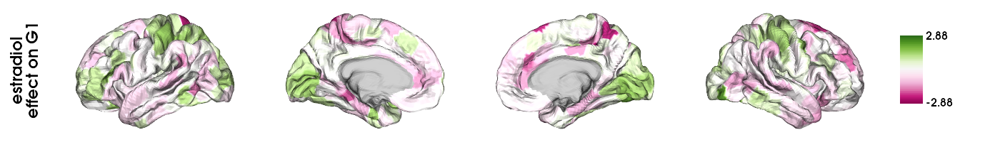

In [46]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_t_val_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_estr_on_G1.png')

plotted_hemispheres

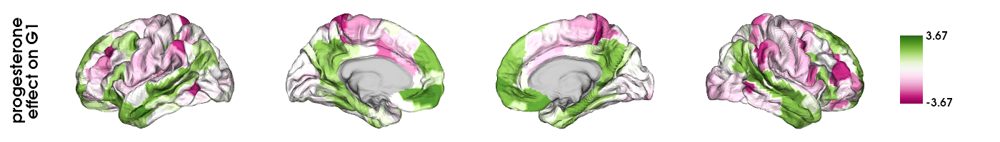

In [47]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_t_val_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_prog_on_G1.png')

plotted_hemispheres

#### t-values for q < 0.05

In [69]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_excl26_fs5 = []

for i in range(len(estradiol_q_val_excl26_fs5)):
    if estradiol_q_val_excl26_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_excl26_fs5.append(estradiol_t_val_excl26_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_excl26_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_excl26_fs5 = np.array(estradiol_fdr_corrected_tvals_excl26_fs5)



# progesterone

progesterone_fdr_corrected_tvals_excl26_fs5 = []

for i in range(len(progesterone_q_val_excl26_fs5)):
    if progesterone_q_val_excl26_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_excl26_fs5.append(progesterone_t_val_excl26_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_excl26_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_excl26_fs5 = np.array(progesterone_fdr_corrected_tvals_excl26_fs5)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


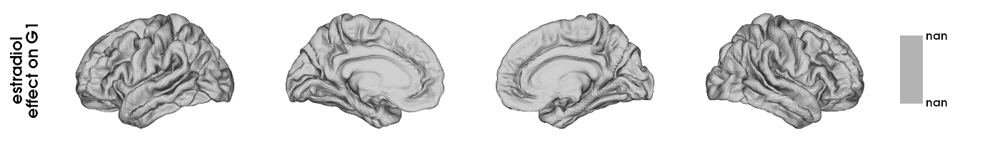

In [70]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_estr_on_G1.png')

plotted_hemispheres

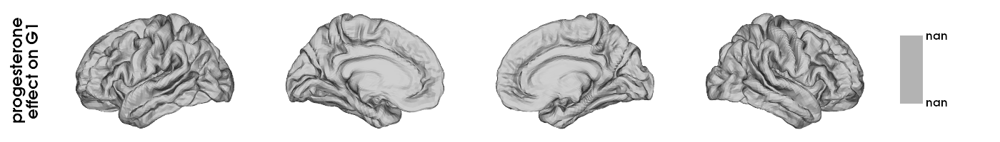

In [71]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_excl26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_prog_on_G1.png')

plotted_hemispheres

### Run model - perceived stress

In [107]:
lmer_res_excl26_stress = {'parcel' : [], 'PSS_t_val': [], 'PSS_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_G1_excl26.T[i],  # dependent variable
        exog = pd.DataFrame({'PSS': behavior_28Me_excl26.z_PSS}),  # fixed effects (covariate)
        groups = behavior_28Me_excl26.Experiment,  # the same across timepoint
        exog_re = None,  # covariates random effects (should be hormones_28He_AM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results 
    lmer_res_excl26_stress['parcel'].append(i)
    lmer_res_excl26_stress['PSS_t_val'].append(results.tvalues['PSS'])
    lmer_res_excl26_stress['PSS_p_val'].append(results.pvalues['PSS'])

lmer_res_excl26_stress['PSS_q_val'] = fdrcorrection(lmer_res_excl26_stress['PSS_p_val'], alpha=0.05)[1]

lmer_res_excl26_stress = pd.DataFrame(lmer_res_excl26_stress)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [108]:
lmer_res_excl26_stress

,parcel,PSS_t_val,PSS_p_val,PSS_q_val
0,0,-0.380526,0.703555,0.792738
1,1,-0.962813,0.335641,0.499095
2,2,-0.949736,0.342246,0.507031
3,3,-0.428300,0.668433,0.761747
4,4,-0.828669,0.407292,0.561078
...,...,...,...,...
395,395,0.549496,0.582665,0.685488
396,396,-0.564114,0.572676,0.675724
397,397,0.286515,0.774484,0.851081
398,398,0.540642,0.588755,0.690621


In [109]:
np.where(np.array(lmer_res_excl26_stress.PSS_q_val) < 0.05)[0].shape

(0,)

In [110]:
np.isnan(lmer_res_excl26_stress.PSS_p_val).any()

False

In [73]:
np.where(np.isnan(lmer_res_excl26_stress.PSS_p_val))

(array([], dtype=int64),)

### Plotted hemispheres

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [74]:
Me_PSS_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26_stress.PSS_t_val, seven_networks=False)
Me_PSS_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26_stress.PSS_q_val, seven_networks=False)

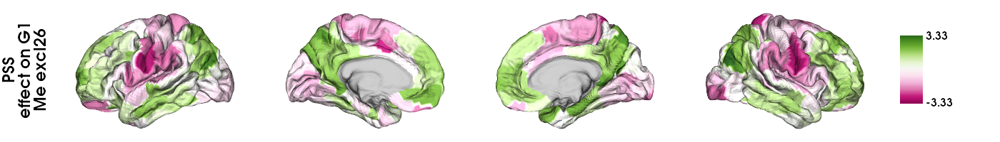

In [80]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = Me_PSS_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["PSS\neffect on G1\nMe excl26"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_PSS_on_G1.png')

plotted_hemispheres

#### t-values for q < 0.05

In [169]:
## find t-values

# PSS

Me_PSS_fdr_corrected_tvals_fs5 = []

for i in range(len(Me_PSS_q_val_fs5)):
    if Me_PSS_q_val_fs5[i] <= 0.05:
        Me_PSS_fdr_corrected_tvals_fs5.append(Me_PSS_t_val_fs5[i])
    else:
        Me_PSS_fdr_corrected_tvals_fs5.append(float('nan'))
        
Me_PSS_fdr_corrected_tvals_fs5 = np.array(Me_PSS_fdr_corrected_tvals_fs5)

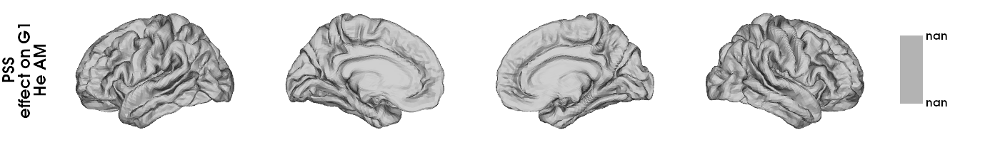

In [170]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = Me_PSS_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["PSS\neffect on G1\nMe excl26"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_excl26_PSS_on_G1.png')

plotted_hemispheres

## MixedLM (He AM)

### Run model - hormones

In [75]:
lmer_res_He_AM = {'parcel' : [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_AM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'testosterone': hormones_28He_AM.z_total_testosterone_saliva, 'cortisol': hormones_28He_AM.z_cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time,  # the same across timepoints
        exog_re = None,  # covariates random effects (should be hormones_28He_AM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results 
    lmer_res_He_AM['parcel'].append(i)
    lmer_res_He_AM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He_AM['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He_AM['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He_AM['cortisol_p_val'].append(results.pvalues['cortisol']) 

lmer_res_He_AM['testosterone_q_val'] = fdrcorrection(lmer_res_He_AM['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He_AM['cortisol_q_val'] = fdrcorrection(lmer_res_He_AM['cortisol_p_val'], alpha=0.05)[1]

lmer_res_He_AM = pd.DataFrame(lmer_res_He_AM)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimi

In [76]:
lmer_res_He_AM

,parcel,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_q_val,cortisol_q_val
0,0,0.205375,0.837279,-1.559688,0.118834,0.881346,0.787815
1,1,0.132921,0.894256,-1.263485,0.206415,0.919543,0.787815
2,2,-0.214066,0.830496,0.965796,0.334146,0.876513,0.848822
3,3,-0.489633,0.624394,-0.078839,0.937160,0.715638,0.972368
4,4,1.296380,0.194845,0.401192,0.688279,0.269681,0.911234
...,...,...,...,...,...,...,...
395,395,-1.404070,0.160298,0.522520,0.601309,0.228182,0.911234
396,396,-0.875109,0.381515,-0.886754,0.375211,0.466685,0.888446
397,397,0.235662,0.813695,-0.353521,0.723698,0.862091,0.924268
398,398,-1.123944,0.261037,-0.103421,0.917629,0.348049,0.967333


In [77]:
np.where(np.array(lmer_res_He_AM.testosterone_q_val) < 0.05)[0].shape

(54,)

In [84]:
np.where(np.array(lmer_res_He_AM.cortisol_q_val) < 0.05)[0].shape

(0,)

In [85]:
np.isnan(lmer_res_He_AM.testosterone_p_val).any()

False

In [86]:
np.isnan(lmer_res_He_AM.cortisol_p_val).any()

False

In [87]:
np.where(np.isnan(lmer_res_He_AM.cortisol_p_val))

(array([], dtype=int64),)

### Plotted hemispheres

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [88]:
testosterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.testosterone_t_val, seven_networks=False)
cortisol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.cortisol_t_val, seven_networks=False)
testosterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.testosterone_q_val, seven_networks=False)
cortisol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.cortisol_q_val, seven_networks=False)

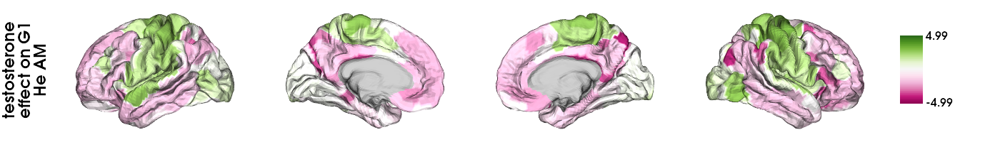

In [91]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HeAM_test_on_G1.png')

plotted_hemispheres

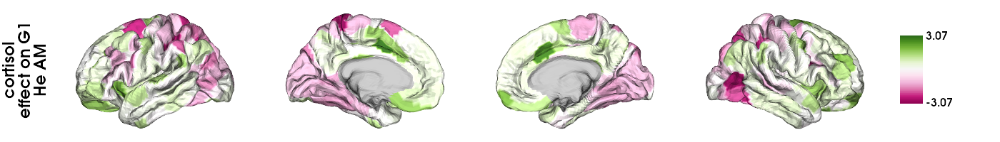

In [94]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortisol_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["cortisol\neffect on G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HeAM_cort_on_G1.png')

plotted_hemispheres

#### t-values for q < 0.05

In [95]:
## find t-values

# testosterone

testosterone_fdr_corrected_tvals_fs5 = []

for i in range(len(testosterone_q_val_fs5)):
    if testosterone_q_val_fs5[i] <= 0.05:
        testosterone_fdr_corrected_tvals_fs5.append(testosterone_t_val_fs5[i])
    else:
        testosterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
testosterone_fdr_corrected_tvals_fs5 = np.array(testosterone_fdr_corrected_tvals_fs5)



# cortisol

cortisol_fdr_corrected_tvals_fs5 = []

for i in range(len(cortisol_q_val_fs5)):
    if cortisol_q_val_fs5[i] <= 0.05:
        cortisol_fdr_corrected_tvals_fs5.append(cortisol_t_val_fs5[i])
    else:
        cortisol_fdr_corrected_tvals_fs5.append(float('nan'))
        
cortisol_fdr_corrected_tvals_fs5 = np.array(cortisol_fdr_corrected_tvals_fs5)

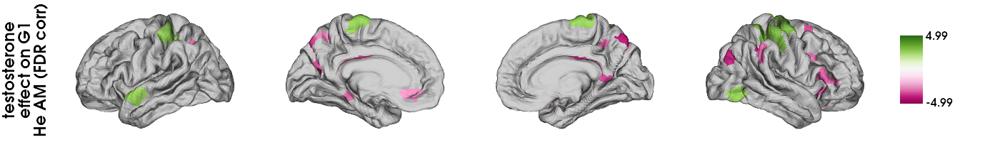

In [98]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1\nHe AM (FDR corr)"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HeAM_test_on_G1_FDR_corrected.png')

plotted_hemispheres

Number of significant parcels: 54

Number of significant parcels for positive t-vals: 23
Number of significant parcels for negative-tvals: 31

Number of significant parcels in each Yeo network:
- visual: 3 out of 61 (4.92%) -> 5.56% of overall significance
- sensory motor: 14 out of 77 (18.18%) -> 25.93% of overall significance
- DMN: 10 out of 46 (21.74%) -> 18.52% of overall significance
- dorsal attention: 10 out of 47 (21.28%) -> 18.52% of overall significance
- ventral attention: 2 out of 26 (7.69%) -> 3.7% of overall significance
- limbic: 1 out of 53 (1.89%) -> 1.85% of overall significance
- fronto parietal: 14 out of 90 (15.56%) -> 25.93% of overall significance





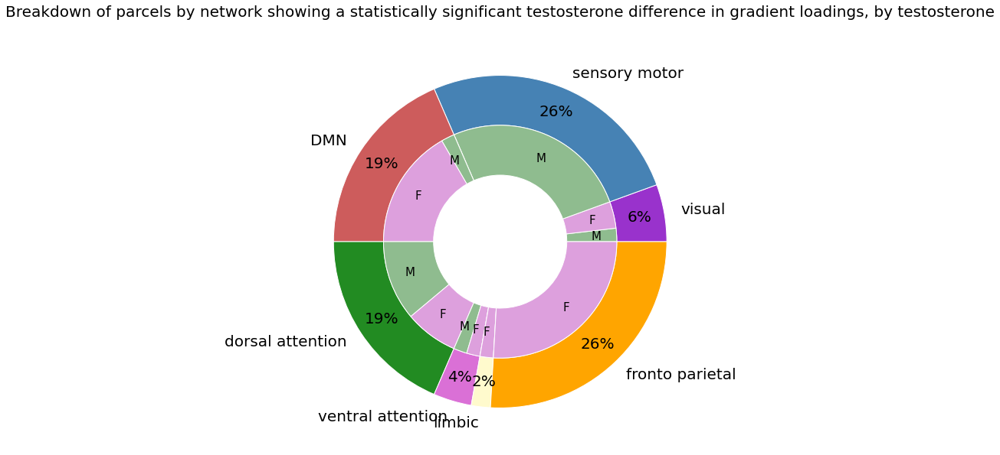

Number of significant parcels by sex:
visual - Male: 1, Female: 2
sensory motor - Male: 14, Female: 0
DMN - Male: 1, Female: 9
dorsal attention - Male: 6, Female: 4
ventral attention - Male: 1, Female: 1
limbic - Male: 0, Female: 1
fronto parietal - Male: 0, Female: 14





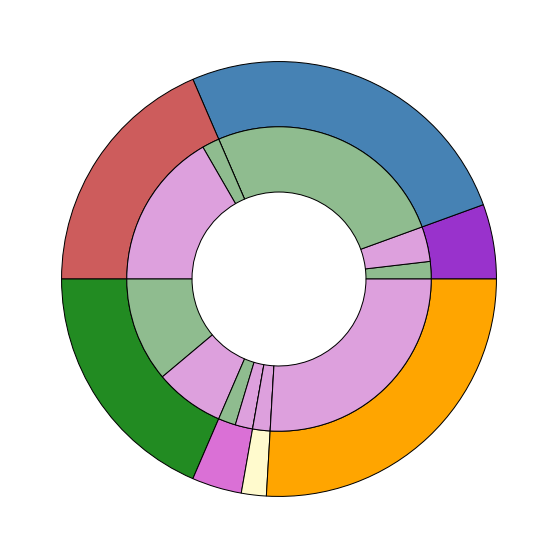

In [116]:
contrast_type = 'testosterone'
categorical_contrast = False

### written breakdown

# counting number of significant parcels
# storing the Q values in a list (where non significant Q values are marked as 1 -> for later potential scatterplot visualization)
# making a dictionary that counts the number of significant parcels per yeo network
# making dictionaries that count the number of significant parcels per yeo network by sex

sig_Q_vals_slm = []
count_sig = 0
count_sig_M = 0
count_sig_F = 0
count_sig_per_network = {"visual": 0, "sensory motor": 0, "DMN": 0, "dorsal attention": 0, "ventral attention": 0, "limbic": 0, "fronto parietal": 0}
count_sig_per_network_bysex = {"visual": [0,0], "sensory motor": [0,0], "DMN": [0,0], "dorsal attention": [0,0], "ventral attention": [0,0], "limbic": [0,0], "fronto parietal": [0,0]} # M: [0], F: [1]

for i in range(len(lmer_res_He_AM.testosterone_q_val)):

    if lmer_res_He_AM.testosterone_q_val[i] < 0.05:
        count_sig += 1
        count_sig_per_network[yeo_17_2_7_networks_array_labels[i]] += 1
        sig_Q_vals_slm.append(1)

        # positive t-values mean male > female: increment the first item of the list fort given label
        if lmer_res_He_AM.testosterone_t_val[i] > 0:
            count_sig_M += 1
            count_sig_per_network_bysex[yeo_17_2_7_networks_array_labels[i]][0] += 1

        # negative t-values mean female > male: increment the second item of the list for the given label
        else:
            count_sig_F += 1
            count_sig_per_network_bysex[yeo_17_2_7_networks_array_labels[i]][1] += 1

    else:
        sig_Q_vals_slm.append(0)

print(f"Number of significant parcels: {count_sig}\n")
print(f"Number of significant parcels for positive t-vals: {count_sig_M}")
print(f"Number of significant parcels for negative-tvals: {count_sig_F}\n")
print("Number of significant parcels in each Yeo network:")

# using ANSI escape sequences to underline -> bold: \033[1m ; underline: \033[4m ; end: \033[0m
for i in range(len(count_sig_per_network)):
    print(f"- {list(count_sig_per_network.keys())[i]}: \033[4m{count_sig_per_network[list(count_sig_per_network.keys())[i]]}\033[0m out of {yeo_17_2_7_networks_array_labels.tolist().count(network_names[i])} ({round(count_sig_per_network[list(count_sig_per_network.keys())[i]] / yeo_17_2_7_networks_array_labels.tolist().count(network_names[i]) * 100, 2)}%) -> \033[1m{round(count_sig_per_network[list(count_sig_per_network.keys())[i]]*100/count_sig,2)}%\033[0m of overall significance")

print("\n\n")




### Nested pie chart

## make data plottable
list_count_sig_per_network_bysex = []

for label in count_sig_per_network_bysex:
    list_count_sig_per_network_bysex.append(count_sig_per_network_bysex[label])

vals = np.array(list_count_sig_per_network_bysex)

outer_colors = ["darkorchid",  # visual
                "steelblue",  # sensorimotor
                "indianred",  # dmn
                "forestgreen",  # dorsal attention
                "orchid",  # ventral attention
                "lemonchiffon",  # limbic
                "orange"]  # frontoparietal


if categorical_contrast: 
    inner_color_plus = 'lightblue'
    inner_color_minus = 'lightcoral'
else:
    inner_color_plus = 'darkseagreen'
    inner_color_minus =  'plum'


inner_colors = [inner_color_plus, inner_color_minus,  # visual
                inner_color_plus, inner_color_minus,  # sensorimotor
                inner_color_plus, inner_color_minus,  # dmn
                inner_color_plus, inner_color_minus,  # dorsal attention
                inner_color_plus, inner_color_minus,  # ventral attention
                inner_color_plus, inner_color_minus,  # limbic
                inner_color_plus, inner_color_minus]  #frontoparietal

fig, ax = plt.subplots(figsize=(15, 10))

size = 0.3

## plot outer pie
ax.pie(vals.sum(axis=1), radius=1, labels=count_sig_per_network_bysex.keys(), colors=outer_colors, autopct='%.0f%%', pctdistance=0.85,
       wedgeprops=dict(width=size, edgecolor='white'),  textprops={'fontsize': 20})

## plot inner pie

# make a list (in order) containing the labels (sex - hardcoded) only for sections that have more than 1 count (otherwise label is placeholder: blank)

labels_only_show_non_null = []

for network in list_count_sig_per_network_bysex:

    # males
    if network[0] > 0:
        labels_only_show_non_null.append('M')
    else:
        labels_only_show_non_null.append('')

    # females
    if network[1] > 0:
        labels_only_show_non_null.append('F')
    else:
        labels_only_show_non_null.append('')

ax.pie(vals.flatten(), radius=1-size, labels=labels_only_show_non_null, colors=inner_colors,
       wedgeprops=dict(width=size, edgecolor='white'),  textprops={'fontsize': 15},  labeldistance=0.78)

ax.set(aspect="equal")
ax.set_title(f'Breakdown of parcels by network showing a statistically significant {contrast_type} difference in gradient loadings, by {contrast_type}', y=1.03, fontsize=20)

plt.show()

print('Number of significant parcels by sex:')
for network in count_sig_per_network_bysex:
    print(f"{network} - Male: {count_sig_per_network_bysex[network][0]}, Female: {count_sig_per_network_bysex[network][1]}")

print("\n\n")



### plot outer and inner pie (without labels)

fig, disp = plt.subplots(figsize=(15, 10))
size = 0.3

disp.pie(vals.sum(axis=1), radius=1, colors=outer_colors, pctdistance=0.85,
       wedgeprops=dict(width=size, edgecolor='black'),  textprops={'fontsize': 20})

disp.pie(vals.flatten(), radius=1-size, colors=inner_colors,
       wedgeprops=dict(width=size, edgecolor='blacK'),  textprops={'fontsize': 15},  labeldistance=0.78)

disp.set(aspect="equal")

plt.show()


## save figure in directory 
fig.savefig(resdir_fig+'testosterone_effects_G1_He_AM_pie_chart_diff_netw.png', dpi=300)

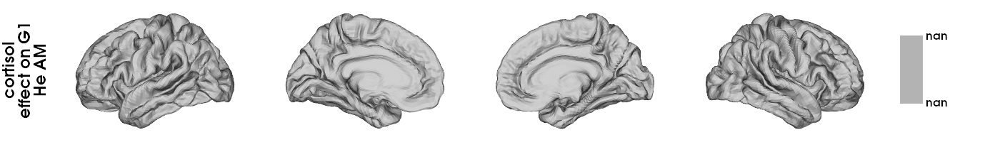

In [117]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortisol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["cortisol\neffect on G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HeAM_cort_on_G1.png')

plotted_hemispheres

### Run model - perceived stress

In [111]:
lmer_res_He_AM_stress = {'parcel' : [], 'PSS_t_val': [], 'PSS_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_AM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'PSS': hormones_28He_AM.z_PSS}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time,  # the same across timepoint
        exog_re = None,  # covariates random effects (should be hormones_28He_AM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results 
    lmer_res_He_AM_stress['parcel'].append(i)
    lmer_res_He_AM_stress['PSS_t_val'].append(results.tvalues['PSS'])
    lmer_res_He_AM_stress['PSS_p_val'].append(results.pvalues['PSS'])

lmer_res_He_AM_stress['PSS_q_val'] = fdrcorrection(lmer_res_He_AM_stress['PSS_p_val'], alpha=0.05)[1]

lmer_res_He_AM_stress = pd.DataFrame(lmer_res_He_AM_stress)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on th

In [112]:
lmer_res_He_AM_stress

,parcel,PSS_t_val,PSS_p_val,PSS_q_val
0,0,-1.288906,0.197431,0.998407
1,1,-1.393585,0.163443,0.998407
2,2,-0.765444,0.444007,0.998407
3,3,0.253367,0.799985,0.998407
4,4,-0.127273,0.898724,0.998407
...,...,...,...,...
395,395,0.297440,0.766131,0.998407
396,396,1.150815,0.249808,0.998407
397,397,-1.107359,0.268139,0.998407
398,398,0.814400,0.415416,0.998407


In [101]:
np.where(np.array(lmer_res_He_AM_stress.PSS_q_val) < 0.05)[0].shape

(0,)

In [102]:
np.isnan(lmer_res_He_AM_stress.PSS_p_val).any()

False

In [103]:
np.where(np.isnan(lmer_res_He_AM_stress.PSS_p_val))

(array([], dtype=int64),)

### Plotted hemispheres

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [105]:
He_AM_PSS_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM_stress.PSS_t_val, seven_networks=False)
He_AM_PSS_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM_stress.PSS_q_val, seven_networks=False)

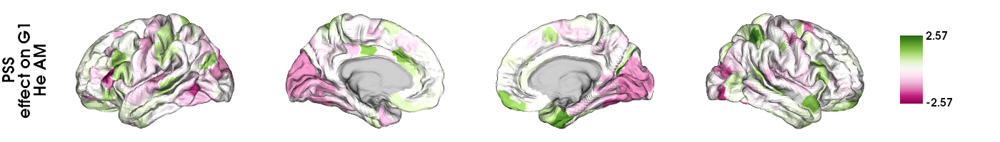

In [108]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = He_AM_PSS_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["PSS\neffect on G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_AM_PSS_on_G1.png')

plotted_hemispheres

#### t-values for q < 0.05

In [162]:
## find t-values

# PSS

He_AM_PSS_fdr_corrected_tvals_fs5 = []

for i in range(len(He_AM_PSS_q_val_fs5)):
    if He_AM_PSS_q_val_fs5[i] <= 0.05:
        He_AM_PSS_fdr_corrected_tvals_fs5.append(He_AM_PSS_t_val_fs5[i])
    else:
        He_AM_PSS_fdr_corrected_tvals_fs5.append(float('nan'))
        
He_AM_PSS_fdr_corrected_tvals_fs5 = np.array(He_AM_PSS_fdr_corrected_tvals_fs5)

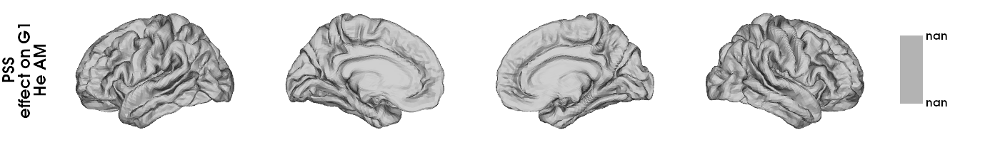

In [163]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = He_AM_PSS_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["PSS\neffect on G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HeAM_PSS_on_G1.png')

plotted_hemispheres

## Comparison stress local effects (given that models are the same)

In [113]:
stats.spearmanr(lmer_res_excl26_stress.PSS_p_val, lmer_res_He_AM_stress.PSS_p_val)

SpearmanrResult(correlation=-0.0832405827536422, pvalue=0.09641498555470517)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0775


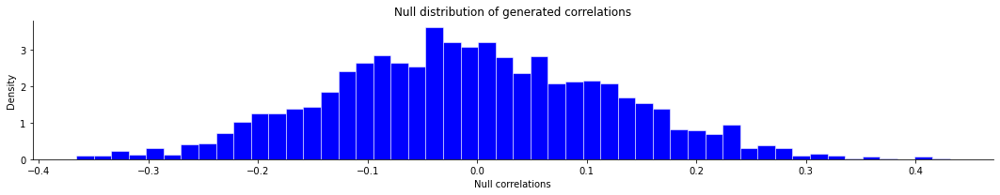

{'spin_test_p': 0.0775,
 'spin_test_d': array([-0.03513497,  0.11702938, -0.01121062, ...,  0.06661656,
        -0.13433958,  0.00498946])}

In [114]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26_stress.PSS_p_val, y = lmer_res_He_AM_stress.PSS_p_val, correlation_type = 'spearman')

#
#
# Dispersion Analyses (Me) (excluding day 26) - hormonal effects

Definitions
- Within network dispersion was quantified as sum squared Euclidean distance of network nodes to the network centroid at individual level (higher value = wider distribution = more dispersion/less integration)
- Between network dispersion was calculated as the Euclidean distance between network centroids. 

Steps
- These metrics were calculated for each subject within the individualised, aligned gradient space. 
- We used linear models, correcting for head motion and sex, to estimate the association of age with network centroid position, within network dispersion and between network dispersion. 
- For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 
- To explore whether age related differences in dispersion were driven by a particular gradient, we examined the correlation between dispersion and subjects individual principal component loadings for the principal component of each gradient (e.g. the first principal component of a principal component analysis of the subject*gradient matrix for the first 3 gradients).

## Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

### Computing within dispersion metric

In [188]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_G1_excl26.T  # transpose to obtain shape (400 x 29) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_net = np.median(G1_net, axis=0)  
    yeo_cog.append(yeo_cog_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion.append(sum_of_squares)
    
    
yeo_cog = np.array(yeo_cog)
WN_dispersion = np.array(WN_dispersion)

In [189]:
WN_dispersion.shape

(7, 29)

### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [190]:
lmer_WN_dispersion_hormonal_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'progesterone': hormones_28Me_excl26.z_progesterone}),  # fixed effects (covariate)
        groups = hormones_28Me_excl26.Experiment, 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_WN_dispersion_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_WN_dispersion_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


lmer_WN_dispersion_hormonal_contrast_res = pd.DataFrame(lmer_WN_dispersion_hormonal_contrast_res)
lmer_WN_dispersion_hormonal_contrast_res = lmer_WN_dispersion_hormonal_contrast_res.set_index('yeo_network')

In [191]:
lmer_WN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
yeo_network,,,,
visual,1.296768,0.194711,-1.489271,0.136416
sensory motor,1.295975,0.194984,-0.576800,0.564075
dorsal attention,-0.085010,0.932253,0.439309,0.660437
ventral attention,-0.395172,0.692716,-1.071862,0.283782
limbic,-0.196354,0.844333,-0.619906,0.535320
fronto parietal,-0.620890,0.534672,-2.625388,0.008655
DMN,-0.696176,0.486319,-1.299200,0.193875


## Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [192]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_hormonal_contrast_res = {'pairwise_comparison' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_hormonal_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_hormonal_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_hormonal_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog[n1] - yeo_cog[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'progesterone': hormones_28Me_excl26.z_progesterone}),  # fixed effects (covariate)
                groups = hormones_28Me_excl26.Experiment, 
                exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
            BN_dispersion_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
            BN_dispersion_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


BN_dispersion_hormonal_contrast_res = pd.DataFrame(BN_dispersion_hormonal_contrast_res)
BN_dispersion_hormonal_contrast_res = BN_dispersion_hormonal_contrast_res.set_index('pairwise_comparison')

In [193]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_hormonal_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_hormonal_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_hormonal_contrast_res = BN_dispersion_hormonal_contrast_res.set_index('new_comparison_names')
BN_dispersion_hormonal_contrast_res.index.name = 'pairwise_comparisons'

In [194]:
BN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
pairwise_comparisons,,,,
visual - sensory motor,0.299015,0.764929,0.429647,0.667453
visual - dorsal attention,1.345782,0.178373,-0.310743,0.755996
visual - ventral attention,1.377875,0.168242,0.696533,0.486095
visual - limbic,0.187219,0.851489,-1.462556,0.143589
visual - fronto parietal,0.382195,0.702317,0.257894,0.796489
visual - DMN,0.865578,0.386722,-1.655931,0.097736
sensory motor - dorsal attention,0.539231,0.589727,-0.643769,0.519725
sensory motor - ventral attention,2.560783,0.010444,0.658783,0.510035
sensory motor - limbic,-0.132471,0.894612,-1.423627,0.154555


## Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_Me.py

### Load null distributions of t-values

In [195]:
WN_dispersion_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me.csv')
WN_dispersion_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_progesterone_contrast_null_distr_Me.csv')

BN_dispersion_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me.csv')
BN_dispersion_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_progesterone_contrast_null_distr_Me.csv')

### Compute the spin p-values 

#### Within Network dispersion

##### Estradiol

In [196]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_hormonal_contrast_res.loc[network,'estradiol_p_val'] < 0.025/7:
        
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_estradiol_contrast_null_distr[network], score = lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'estradiol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'estradiol_t_val'] < np.median(WN_dispersion_perm_tval_estradiol_contrast_null_distr[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
                    
                    
           
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res['estradiol significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


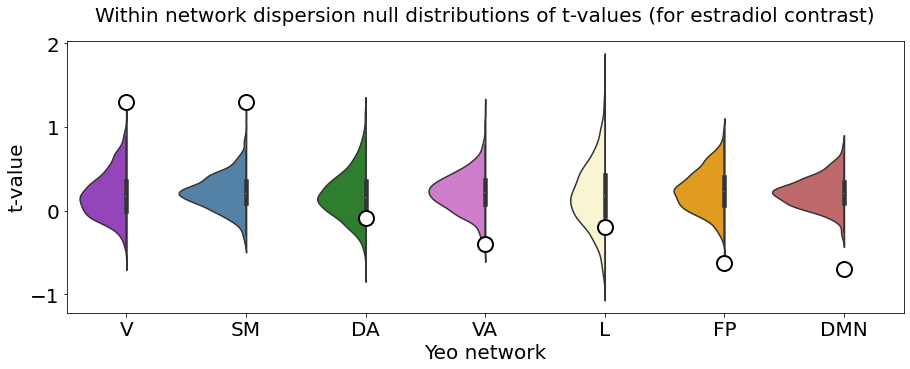

In [197]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_estradiol_contrast_null_distr_long = pd.melt(WN_dispersion_perm_tval_estradiol_contrast_null_distr, 
                                                               value_vars = WN_dispersion_perm_tval_estradiol_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_estradiol_contrast_null_distr_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_hormonal_contrast_res.estradiol_t_val, color='white', edgecolor='black',  size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for estradiol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_estradiol.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Progesterone

In [198]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res.index:
    
    # first determine if given network t-value passes significance post bonferroni (before running spin)
    if lmer_WN_dispersion_hormonal_contrast_res.loc[network,'progesterone_p_val'] < 0.025/7:
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_progesterone_contrast_null_distr[network], score = lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'progesterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_hormonal_contrast_res.loc[network, 'progesterone_t_val'] < np.median(WN_dispersion_perm_tval_progesterone_contrast_null_distr[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
        
        
# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res['progesterone significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


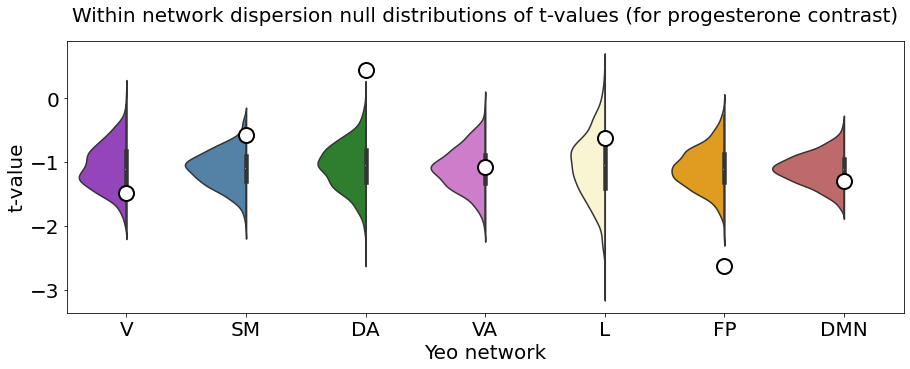

In [199]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_progesterone_contrast_null_distr_long = pd.melt(WN_dispersion_perm_tval_progesterone_contrast_null_distr, 
                                                               value_vars = WN_dispersion_perm_tval_progesterone_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_progesterone_contrast_null_distr_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_hormonal_contrast_res.progesterone_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for progesterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_progesterone.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Results

In [200]:
lmer_WN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol significance post Bonferroni (alpha=0.0036) and spin test,progesterone_spin_p_val,progesterone significance post Bonferroni (alpha=0.0036) and spin test
yeo_network,,,,,,,,
visual,1.296768,0.194711,-1.489271,0.136416,NaN,not sig,NaN,not sig
sensory motor,1.295975,0.194984,-0.576800,0.564075,NaN,not sig,NaN,not sig
dorsal attention,-0.085010,0.932253,0.439309,0.660437,NaN,not sig,NaN,not sig
ventral attention,-0.395172,0.692716,-1.071862,0.283782,NaN,not sig,NaN,not sig
limbic,-0.196354,0.844333,-0.619906,0.535320,NaN,not sig,NaN,not sig
fronto parietal,-0.620890,0.534672,-2.625388,0.008655,NaN,not sig,NaN,not sig
DMN,-0.696176,0.486319,-1.299200,0.193875,NaN,not sig,NaN,not sig


##### Export the results table

In [201]:
lmer_WN_dispersion_hormonal_contrast_res.to_csv(resdir+'lmer_WN_dispersion_hormonal_contrast_res.csv', header = True, index = True)

#### Between Network dispersion

In [202]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_estradiol_contrast_null_distr.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_estradiol_contrast_null_distr.columns = new_col_names
BN_dispersion_perm_tval_progesterone_contrast_null_distr.columns = new_col_names

##### Estradiol

In [203]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison,'estradiol_p_val'] < 0.025/21:
        
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_estradiol_contrast_null_distr[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'] < np.median(BN_dispersion_perm_tval_estradiol_contrast_null_distr[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')    
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res['estradiol significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

##### Progesterone

In [204]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison,'progesterone_p_val'] < 0.025/21:
    
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_progesterone_contrast_null_distr[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'] < np.median(BN_dispersion_perm_tval_progesterone_contrast_null_distr[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')    

        
# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res['progesterone significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

In [205]:
BN_dispersion_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol significance post Bonferroni (alpha= 0.001) and spin test,progesterone_spin_p_val,progesterone significance post Bonferroni (alpha= 0.001) and spin test
pairwise_comparisons,,,,,,,,
visual - sensory motor,0.299015,0.764929,0.429647,0.667453,NaN,not sig,NaN,not sig
visual - dorsal attention,1.345782,0.178373,-0.310743,0.755996,NaN,not sig,NaN,not sig
visual - ventral attention,1.377875,0.168242,0.696533,0.486095,NaN,not sig,NaN,not sig
visual - limbic,0.187219,0.851489,-1.462556,0.143589,NaN,not sig,NaN,not sig
visual - fronto parietal,0.382195,0.702317,0.257894,0.796489,NaN,not sig,NaN,not sig
visual - DMN,0.865578,0.386722,-1.655931,0.097736,NaN,not sig,NaN,not sig
sensory motor - dorsal attention,0.539231,0.589727,-0.643769,0.519725,NaN,not sig,NaN,not sig
sensory motor - ventral attention,2.560783,0.010444,0.658783,0.510035,NaN,not sig,NaN,not sig
sensory motor - limbic,-0.132471,0.894612,-1.423627,0.154555,NaN,not sig,NaN,not sig


##### Export the results table

In [206]:
BN_dispersion_hormonal_contrast_res.to_csv(resdir+'lmer_BN_dispersion_hormonal_contrast_res.csv', header = True, index = True)

##### Plot pairwise t-vals for estradiol

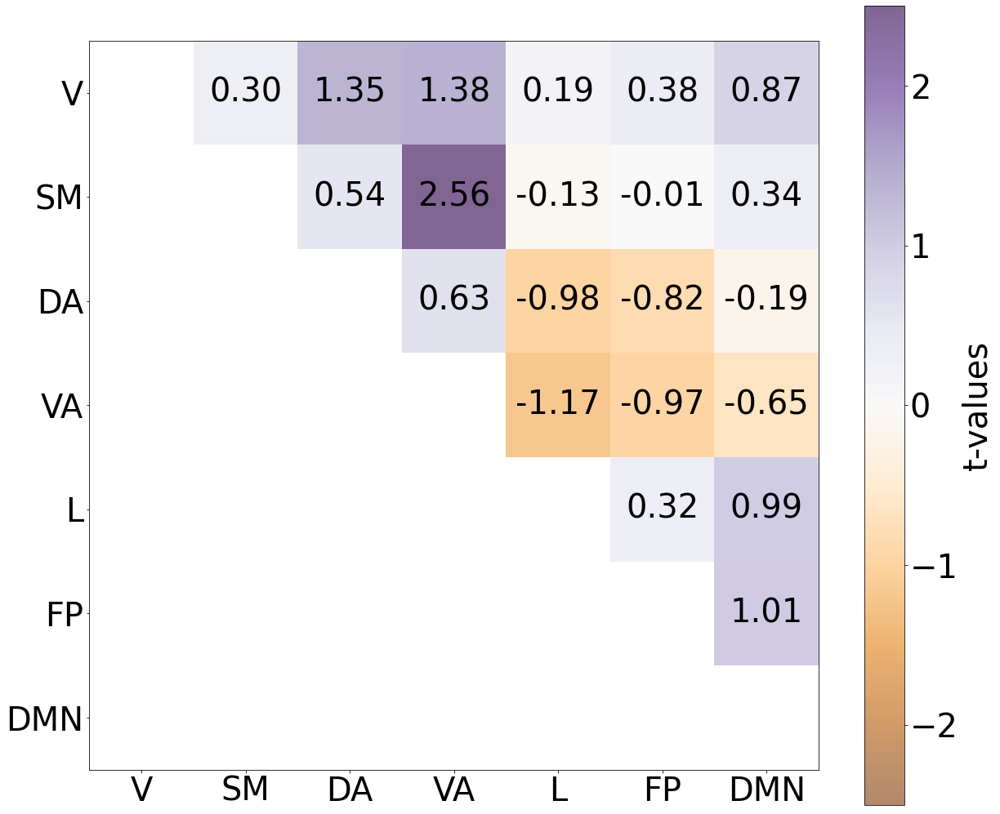

In [207]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_hormonal_contrast_res, df_column_index_with_tvals=0, df_column_index_with_sigs=5, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='estr', save_plot = True, output_dir = resdir_fig)

##### Plot pairwise t-vals for progesterone

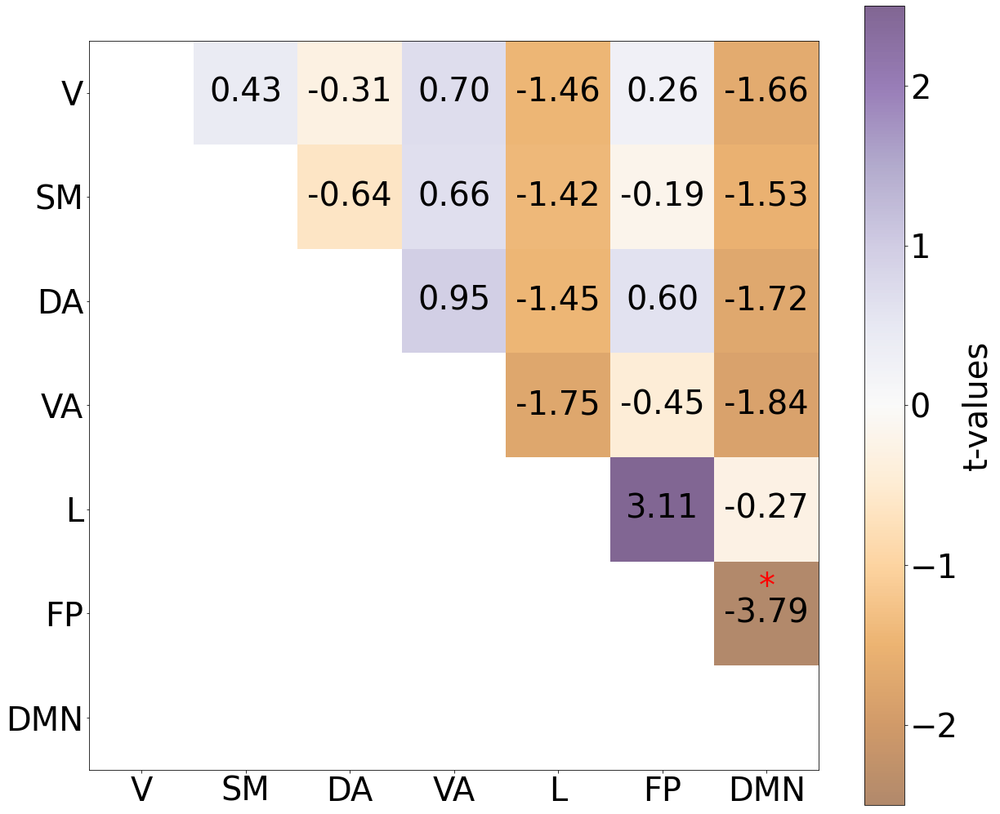

In [208]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_hormonal_contrast_res, df_column_index_with_tvals=2, df_column_index_with_sigs=7, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='prog', save_plot = True, output_dir = resdir_fig)

# Dispersion Analyses (He AM) - hormonal effects

## Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

### Computing within dispersion metric

In [209]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog_He_AM = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 20)
WN_dispersion_He_AM = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 20)


# gradient values
g1 = array_aligned_fc_He_AM_G1.T  # transpose to obtain shape (400 x 20) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_He_AM_net = np.median(G1_net, axis=0)  
    yeo_cog_He_AM.append(yeo_cog_He_AM_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_He_AM_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion_He_AM.append(sum_of_squares)
    
    
yeo_cog_He_AM = np.array(yeo_cog_He_AM)
WN_dispersion_He_AM = np.array(WN_dispersion_He_AM)

In [210]:
WN_dispersion_He_AM.shape

(7, 20)

### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [211]:
lmer_WN_dispersion_He_AM_hormonal_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion_He_AM[i],  # dependent variable
        exog = pd.DataFrame({'testosterone': hormones_28He_AM.z_total_testosterone_saliva, 'cortisol': hormones_28He_AM.z_cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time, 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of testosterone, cortisol (via indices) 
    lmer_WN_dispersion_He_AM_hormonal_contrast_res['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_WN_dispersion_He_AM_hormonal_contrast_res['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_WN_dispersion_He_AM_hormonal_contrast_res['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_WN_dispersion_He_AM_hormonal_contrast_res['cortisol_p_val'].append(results.pvalues['cortisol']) 


lmer_WN_dispersion_He_AM_hormonal_contrast_res = pd.DataFrame(lmer_WN_dispersion_He_AM_hormonal_contrast_res)
lmer_WN_dispersion_He_AM_hormonal_contrast_res = lmer_WN_dispersion_He_AM_hormonal_contrast_res.set_index('yeo_network')

In [212]:
lmer_WN_dispersion_He_AM_hormonal_contrast_res

,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val
yeo_network,,,,
visual,1.321650,0.186285,0.146312,0.883675
sensory motor,-0.738485,0.460220,0.942699,0.345835
dorsal attention,2.942622,0.003254,-0.627298,0.530464
ventral attention,2.083645,0.037192,0.110076,0.912349
limbic,1.078348,0.280878,-0.339638,0.734129
fronto parietal,1.488454,0.136631,-0.731675,0.464367
DMN,1.184349,0.236275,-0.571752,0.567490


## Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [213]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_He_AM_hormonal_contrast_res = {'pairwise_comparison' : [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_He_AM_hormonal_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_He_AM_hormonal_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_He_AM_hormonal_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog_He_AM[n1] - yeo_cog_He_AM[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'testosterone': hormones_28He_AM.z_total_testosterone_saliva, 'cortisol': hormones_28He_AM.z_cortisol_saliva}),  # fixed effects (covariate)
                groups = hormones_28He_AM.time, 
                exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of testosterone, cortisol (via indices) 
            BN_dispersion_He_AM_hormonal_contrast_res['testosterone_t_val'].append(results.tvalues['testosterone'])
            BN_dispersion_He_AM_hormonal_contrast_res['testosterone_p_val'].append(results.pvalues['testosterone'])
            BN_dispersion_He_AM_hormonal_contrast_res['cortisol_t_val'].append(results.tvalues['cortisol'])
            BN_dispersion_He_AM_hormonal_contrast_res['cortisol_p_val'].append(results.pvalues['cortisol']) 


BN_dispersion_He_AM_hormonal_contrast_res = pd.DataFrame(BN_dispersion_He_AM_hormonal_contrast_res)
BN_dispersion_He_AM_hormonal_contrast_res = BN_dispersion_He_AM_hormonal_contrast_res.set_index('pairwise_comparison')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [214]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_He_AM_hormonal_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_He_AM_hormonal_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_He_AM_hormonal_contrast_res = BN_dispersion_He_AM_hormonal_contrast_res.set_index('new_comparison_names')
BN_dispersion_He_AM_hormonal_contrast_res.index.name = 'pairwise_comparisons'

In [215]:
BN_dispersion_He_AM_hormonal_contrast_res

,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val
pairwise_comparisons,,,,
visual - sensory motor,-2.860570,0.004229,-1.446479,0.148043
visual - dorsal attention,-1.113239,0.265606,1.454796,0.145726
visual - ventral attention,-2.594543,0.009472,-2.210867,0.027045
visual - limbic,1.312406,0.189383,-1.212411,0.225355
visual - fronto parietal,1.903010,0.057039,-0.777053,0.437127
visual - DMN,1.446391,0.148068,-0.815225,0.414943
sensory motor - dorsal attention,0.923047,0.355983,2.030196,0.042337
sensory motor - ventral attention,-0.731010,0.464773,-1.398097,0.162084
sensory motor - limbic,2.106913,0.035125,-0.579570,0.562205


## Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_He_AM.py

### Load null distributions of t-values

In [216]:
WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM = pd.read_csv(resdir+'WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM.csv')
WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM = pd.read_csv(resdir+'WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM.csv')

BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM = pd.read_csv(resdir+'BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM.csv')
BN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM = pd.read_csv(resdir+'BN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM.csv')

### Compute the spin p-values 

#### Within Network dispersion

##### Testosterone

In [217]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_He_AM_hormonal_contrast_res.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_He_AM_hormonal_contrast_res.loc[network,'testosterone_p_val'] < 0.025/7:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM[network], score = lmer_WN_dispersion_He_AM_hormonal_contrast_res.loc[network, 'testosterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_He_AM_hormonal_contrast_res.loc[network, 'testosterone_t_val'] < np.median(WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:    
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_He_AM_hormonal_contrast_res['testosterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_He_AM_hormonal_contrast_res['testosterone significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


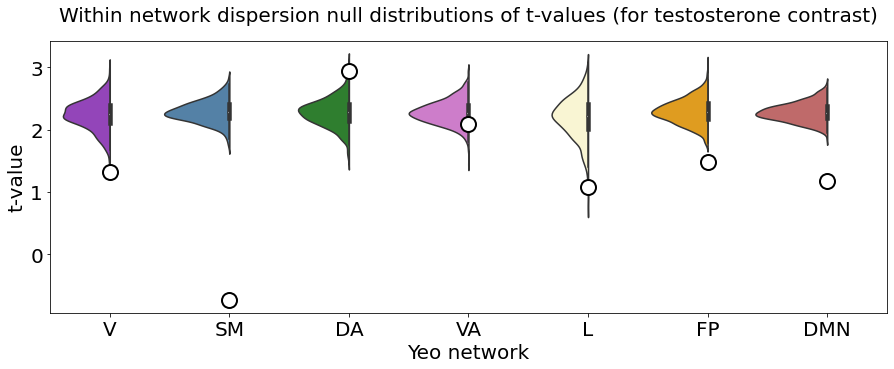

In [218]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_long = pd.melt(WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM, 
                                                               value_vars = WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_He_AM_hormonal_contrast_res.testosterone_t_val, color='white', edgecolor='black',  size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for testosterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_testosterone_He_AM.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Cortisol

In [219]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_He_AM_hormonal_contrast_res.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_He_AM_hormonal_contrast_res.loc[network,'cortisol_p_val'] < 0.025/7:
        
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM[network], score = lmer_WN_dispersion_He_AM_hormonal_contrast_res.loc[network, 'cortisol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:
            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_He_AM_hormonal_contrast_res.loc[network, 'cortisol_t_val'] < np.median(WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:    
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
        
        

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_He_AM_hormonal_contrast_res['cortisol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_He_AM_hormonal_contrast_res['cortisol significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


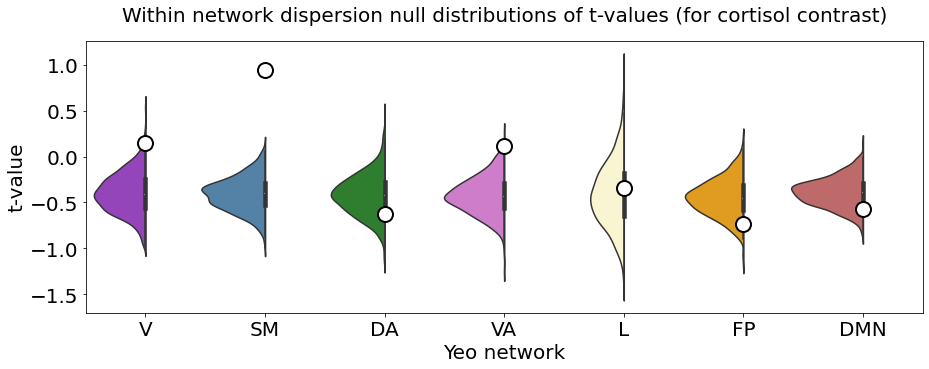

In [220]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM_long = pd.melt(WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM, 
                                                               value_vars = WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_He_AM_hormonal_contrast_res.cortisol_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for cortisol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_cortisol_He_AM.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Results

In [221]:
lmer_WN_dispersion_He_AM_hormonal_contrast_res

,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_spin_p_val,testosterone significance post Bonferroni (alpha=0.0036) and spin test,cortisol_spin_p_val,cortisol significance post Bonferroni (alpha=0.0036) and spin test
yeo_network,,,,,,,,
visual,1.321650,0.186285,0.146312,0.883675,NaN,not sig,NaN,not sig
sensory motor,-0.738485,0.460220,0.942699,0.345835,NaN,not sig,NaN,not sig
dorsal attention,2.942622,0.003254,-0.627298,0.530464,0.005,sig,NaN,not sig
ventral attention,2.083645,0.037192,0.110076,0.912349,NaN,not sig,NaN,not sig
limbic,1.078348,0.280878,-0.339638,0.734129,NaN,not sig,NaN,not sig
fronto parietal,1.488454,0.136631,-0.731675,0.464367,NaN,not sig,NaN,not sig
DMN,1.184349,0.236275,-0.571752,0.567490,NaN,not sig,NaN,not sig


##### Export the results table

In [222]:
lmer_WN_dispersion_He_AM_hormonal_contrast_res.to_csv(resdir+'lmer_WN_dispersion_He_AM_hormonal_contrast_res.csv', header = True, index = True)

#### Between Network dispersion

In [223]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM.columns = new_col_names
BN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM.columns = new_col_names

##### Testosterone

In [224]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_He_AM_hormonal_contrast_res.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_He_AM_hormonal_contrast_res.loc[pairwise_comparison,'testosterone_p_val'] < 0.025/21:
        
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM[pairwise_comparison], score = BN_dispersion_He_AM_hormonal_contrast_res.loc[pairwise_comparison, 'testosterone_t_val'], kind='mean')/100

        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_He_AM_hormonal_contrast_res.loc[pairwise_comparison, 'testosterone_t_val'] < np.median(BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')

    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')    
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_He_AM_hormonal_contrast_res['testosterone_spin_p_val'] = spin_p_val
BN_dispersion_He_AM_hormonal_contrast_res['testosterone significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

##### Cortisol

In [225]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_He_AM_hormonal_contrast_res.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_He_AM_hormonal_contrast_res.loc[pairwise_comparison,'cortisol_p_val'] < 0.025/21:
        
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM[pairwise_comparison], score = BN_dispersion_He_AM_hormonal_contrast_res.loc[pairwise_comparison, 'cortisol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_He_AM_hormonal_contrast_res.loc[pairwise_comparison, 'cortisol_t_val'] < np.median(BN_dispersion_perm_tval_cortisol_contrast_null_distr_He_AM[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')

    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')    
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_He_AM_hormonal_contrast_res['cortisol_spin_p_val'] = spin_p_val
BN_dispersion_He_AM_hormonal_contrast_res['cortisol significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

In [226]:
BN_dispersion_He_AM_hormonal_contrast_res

,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_spin_p_val,testosterone significance post Bonferroni (alpha= 0.001) and spin test,cortisol_spin_p_val,cortisol significance post Bonferroni (alpha= 0.001) and spin test
pairwise_comparisons,,,,,,,,
visual - sensory motor,-2.860570,0.004229,-1.446479,0.148043,NaN,not sig,NaN,not sig
visual - dorsal attention,-1.113239,0.265606,1.454796,0.145726,NaN,not sig,NaN,not sig
visual - ventral attention,-2.594543,0.009472,-2.210867,0.027045,NaN,not sig,NaN,not sig
visual - limbic,1.312406,0.189383,-1.212411,0.225355,NaN,not sig,NaN,not sig
visual - fronto parietal,1.903010,0.057039,-0.777053,0.437127,NaN,not sig,NaN,not sig
visual - DMN,1.446391,0.148068,-0.815225,0.414943,NaN,not sig,NaN,not sig
sensory motor - dorsal attention,0.923047,0.355983,2.030196,0.042337,NaN,not sig,NaN,not sig
sensory motor - ventral attention,-0.731010,0.464773,-1.398097,0.162084,NaN,not sig,NaN,not sig
sensory motor - limbic,2.106913,0.035125,-0.579570,0.562205,NaN,not sig,NaN,not sig


##### Export the results table

In [227]:
BN_dispersion_He_AM_hormonal_contrast_res.to_csv(resdir+'lmer_BN_dispersion_He_AM_hormonal_contrast_res.csv', header = True, index = True)

##### Plot pairwise t-vals for testosterone

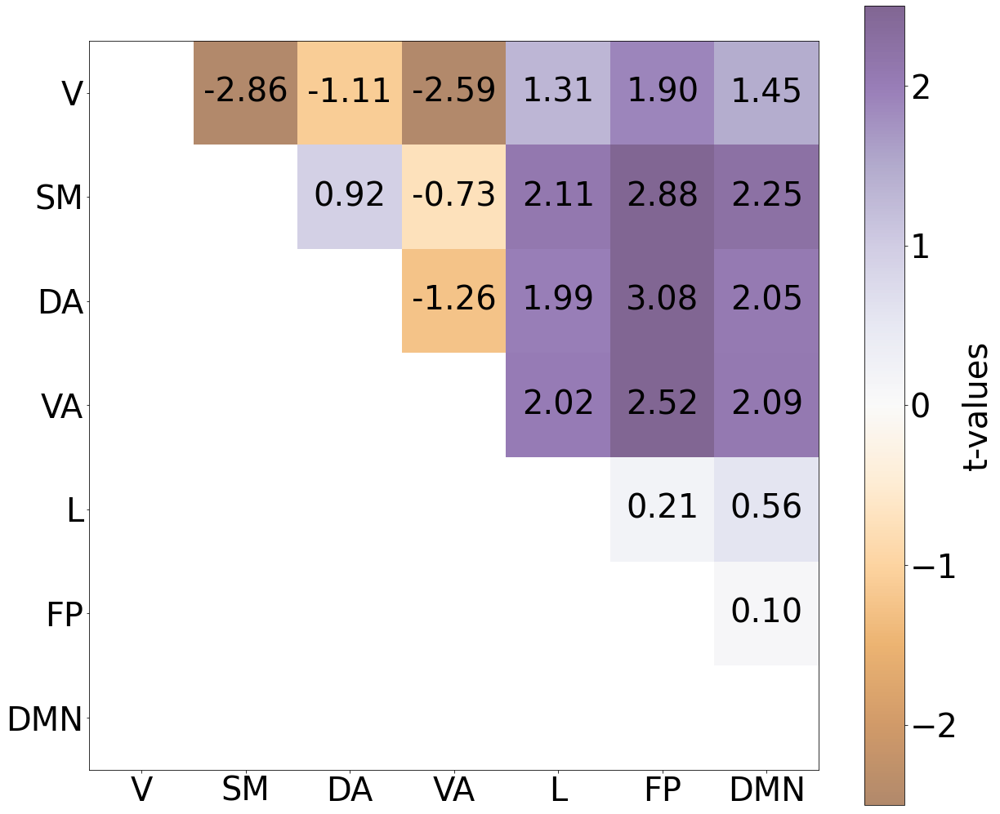

In [228]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_He_AM_hormonal_contrast_res, df_column_index_with_tvals=0, df_column_index_with_sigs=5, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='test', save_plot = True, output_dir = resdir_fig)

##### Plot pairwise t-vals for cortisol

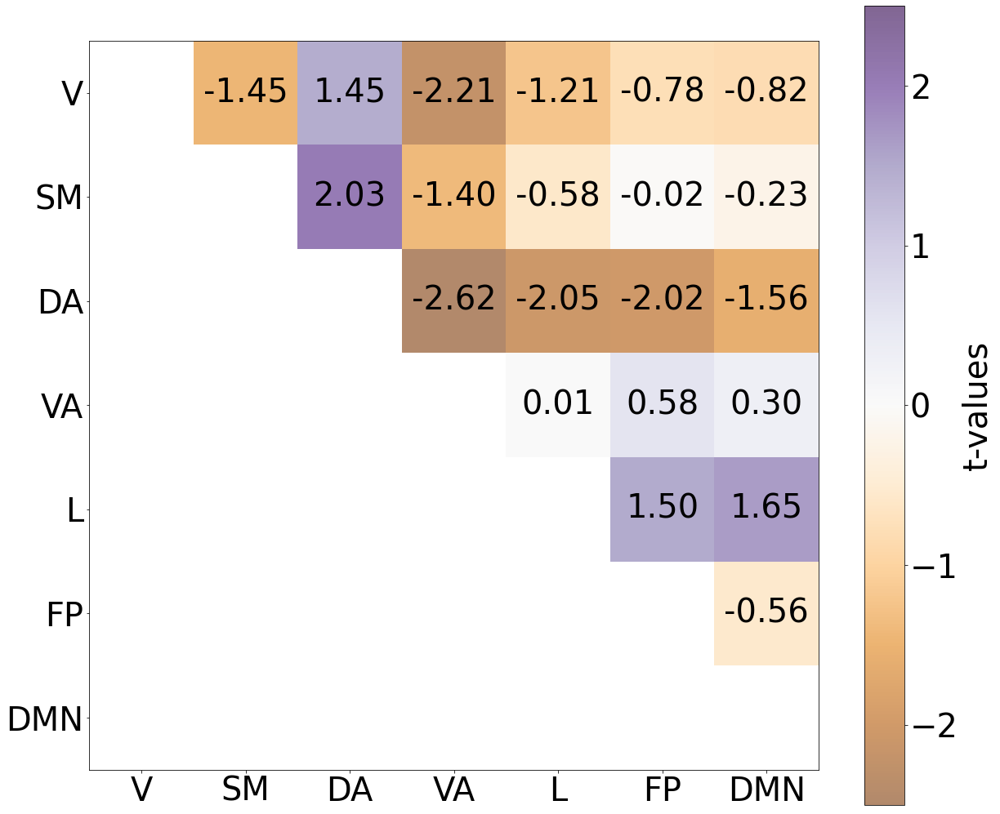

In [229]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_He_AM_hormonal_contrast_res, df_column_index_with_tvals=2, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='cort', df_column_index_with_sigs=7, save_plot = True, output_dir = resdir_fig)

# Dispersion Analyses (Me) (excluding day 26) - perceived stress effects

Definitions
- Within network dispersion was quantified as sum squared Euclidean distance of network nodes to the network centroid at individual level (higher value = wider distribution = more dispersion/less integration)
- Between network dispersion was calculated as the Euclidean distance between network centroids. 

Steps
- These metrics were calculated for each subject within the individualised, aligned gradient space. 
- We used linear models, correcting for head motion and sex, to estimate the association of age with network centroid position, within network dispersion and between network dispersion. 
- For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 
- To explore whether age related differences in dispersion were driven by a particular gradient, we examined the correlation between dispersion and subjects individual principal component loadings for the principal component of each gradient (e.g. the first principal component of a principal component analysis of the subject*gradient matrix for the first 3 gradients).

## Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

### Computing within dispersion metric

In [230]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog_stress = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion_stress = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_G1_excl26.T  # transpose to obtain shape (400 x 29) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_stress_net = np.median(G1_net, axis=0)  
    yeo_cog_stress.append(yeo_cog_stress_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_stress_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion_stress.append(sum_of_squares)
    
    
yeo_cog_stress = np.array(yeo_cog_stress)
WN_dispersion_stress = np.array(WN_dispersion_stress)

In [231]:
WN_dispersion_stress.shape

(7, 29)

### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [232]:
lmer_WN_dispersion_stress_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'PSS_t_val': [], 'PSS_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion_stress[i],  # dependent variable
        exog = pd.DataFrame({'PSS': behavior_28Me_excl26.z_PSS}),  # fixed effects (covariate)
        groups = behavior_28Me_excl26.Experiment, 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of PSS effects (via indices) 
    lmer_WN_dispersion_stress_contrast_res['PSS_t_val'].append(results.tvalues['PSS'])
    lmer_WN_dispersion_stress_contrast_res['PSS_p_val'].append(results.pvalues['PSS'])

lmer_WN_dispersion_stress_contrast_res = pd.DataFrame(lmer_WN_dispersion_stress_contrast_res)
lmer_WN_dispersion_stress_contrast_res = lmer_WN_dispersion_stress_contrast_res.set_index('yeo_network')

In [233]:
lmer_WN_dispersion_stress_contrast_res

,PSS_t_val,PSS_p_val
yeo_network,,
visual,-2.085112,0.037059
sensory motor,-0.143113,0.886201
dorsal attention,-1.627420,0.103648
ventral attention,-1.189730,0.234153
limbic,-0.591522,0.554171
fronto parietal,-0.969119,0.332486
DMN,-1.945040,0.051770


## Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [234]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_stress_contrast_res = {'pairwise_comparison' : [], 'PSS_t_val': [], 'PSS_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_stress_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_stress_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_stress_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog_stress[n1] - yeo_cog_stress[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'PSS': behavior_28Me_excl26.z_PSS}),  # fixed effects (covariate)
                groups = behavior_28Me_excl26.Experiment, 
                exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of PSS (via indices) 
            BN_dispersion_stress_contrast_res['PSS_t_val'].append(results.tvalues['PSS'])
            BN_dispersion_stress_contrast_res['PSS_p_val'].append(results.pvalues['PSS'])


BN_dispersion_stress_contrast_res = pd.DataFrame(BN_dispersion_stress_contrast_res)
BN_dispersion_stress_contrast_res = BN_dispersion_stress_contrast_res.set_index('pairwise_comparison')

In [235]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_stress_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_stress_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_stress_contrast_res = BN_dispersion_stress_contrast_res.set_index('new_comparison_names')
BN_dispersion_stress_contrast_res.index.name = 'pairwise_comparisons'

In [236]:
BN_dispersion_stress_contrast_res

,PSS_t_val,PSS_p_val
pairwise_comparisons,,
visual - sensory motor,0.713470,0.475555
visual - dorsal attention,-2.167926,0.030164
visual - ventral attention,0.561608,0.574383
visual - limbic,-1.779964,0.075082
visual - fronto parietal,-1.696037,0.089879
visual - DMN,-1.621630,0.104883
sensory motor - dorsal attention,-2.192790,0.028322
sensory motor - ventral attention,-0.221353,0.824818
sensory motor - limbic,-1.922438,0.054551


## Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_Me_stress.py

### Load null distributions of t-values

In [237]:
WN_dispersion_perm_tval_stress_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_stress_contrast_null_distr_Me.csv')

BN_dispersion_perm_tval_stress_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_stress_contrast_null_distr_Me.csv')

### Compute the spin p-values 

#### Within Network dispersion

In [238]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_stress_contrast_res.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_stress_contrast_res.loc[network,'PSS_p_val'] < 0.025/7:
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_stress_contrast_null_distr[network], score = lmer_WN_dispersion_stress_contrast_res.loc[network, 'PSS_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_stress_contrast_res.loc[network, 'PSS_t_val'] < np.median(WN_dispersion_perm_tval_stress_contrast_null_distr[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
                
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:    
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')

    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_stress_contrast_res['PSS_spin_p_val'] = spin_p_val
lmer_WN_dispersion_stress_contrast_res['PSS significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


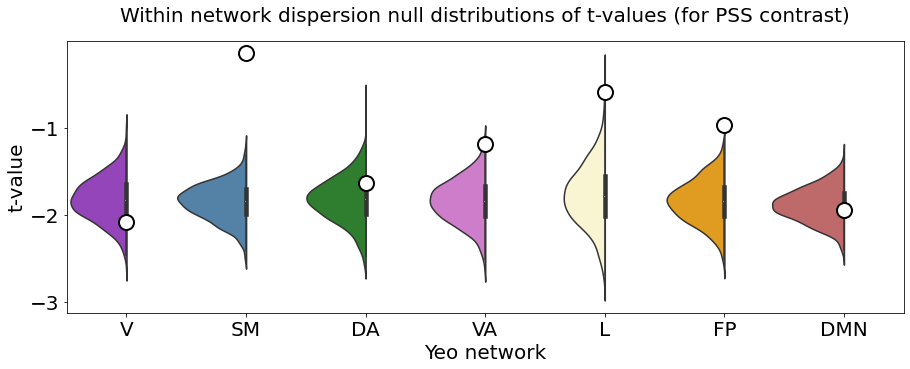

In [239]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_stress_contrast_null_distr_long = pd.melt(WN_dispersion_perm_tval_stress_contrast_null_distr, 
                                                               value_vars = WN_dispersion_perm_tval_stress_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_stress_contrast_null_distr_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_stress_contrast_res.PSS_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for PSS contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_PSS_Me.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

##### Results

In [240]:
lmer_WN_dispersion_stress_contrast_res

,PSS_t_val,PSS_p_val,PSS_spin_p_val,PSS significance post Bonferroni (alpha=0.0036) and spin test
yeo_network,,,,
visual,-2.085112,0.037059,NaN,not sig
sensory motor,-0.143113,0.886201,NaN,not sig
dorsal attention,-1.627420,0.103648,NaN,not sig
ventral attention,-1.189730,0.234153,NaN,not sig
limbic,-0.591522,0.554171,NaN,not sig
fronto parietal,-0.969119,0.332486,NaN,not sig
DMN,-1.945040,0.051770,NaN,not sig


##### Export the results table

In [241]:
lmer_WN_dispersion_stress_contrast_res.to_csv(resdir+'lmer_WN_dispersion_stress_contrast_res.csv', header = True, index = True)

#### Between Network dispersion

In [242]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_stress_contrast_null_distr.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_stress_contrast_null_distr.columns = new_col_names

In [243]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_stress_contrast_res.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_stress_contrast_res.loc[pairwise_comparison,'PSS_p_val'] < 0.025/21:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_stress_contrast_null_distr[pairwise_comparison], score = BN_dispersion_stress_contrast_res.loc[pairwise_comparison, 'PSS_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_stress_contrast_res.loc[pairwise_comparison, 'PSS_t_val'] < np.median(BN_dispersion_perm_tval_stress_contrast_null_distr[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_stress_contrast_res['PSS_spin_p_val'] = spin_p_val
BN_dispersion_stress_contrast_res['PSS significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

In [244]:
BN_dispersion_stress_contrast_res

,PSS_t_val,PSS_p_val,PSS_spin_p_val,PSS significance post Bonferroni (alpha= 0.001) and spin test
pairwise_comparisons,,,,
visual - sensory motor,0.713470,0.475555,NaN,not sig
visual - dorsal attention,-2.167926,0.030164,NaN,not sig
visual - ventral attention,0.561608,0.574383,NaN,not sig
visual - limbic,-1.779964,0.075082,NaN,not sig
visual - fronto parietal,-1.696037,0.089879,NaN,not sig
visual - DMN,-1.621630,0.104883,NaN,not sig
sensory motor - dorsal attention,-2.192790,0.028322,NaN,not sig
sensory motor - ventral attention,-0.221353,0.824818,NaN,not sig
sensory motor - limbic,-1.922438,0.054551,NaN,not sig


##### Export the results table

In [245]:
BN_dispersion_stress_contrast_res.to_csv(resdir+'lmer_BN_dispersion_stress_contrast_res.csv', header = True, index = True)

##### Plot pairwise t-vals for PSS

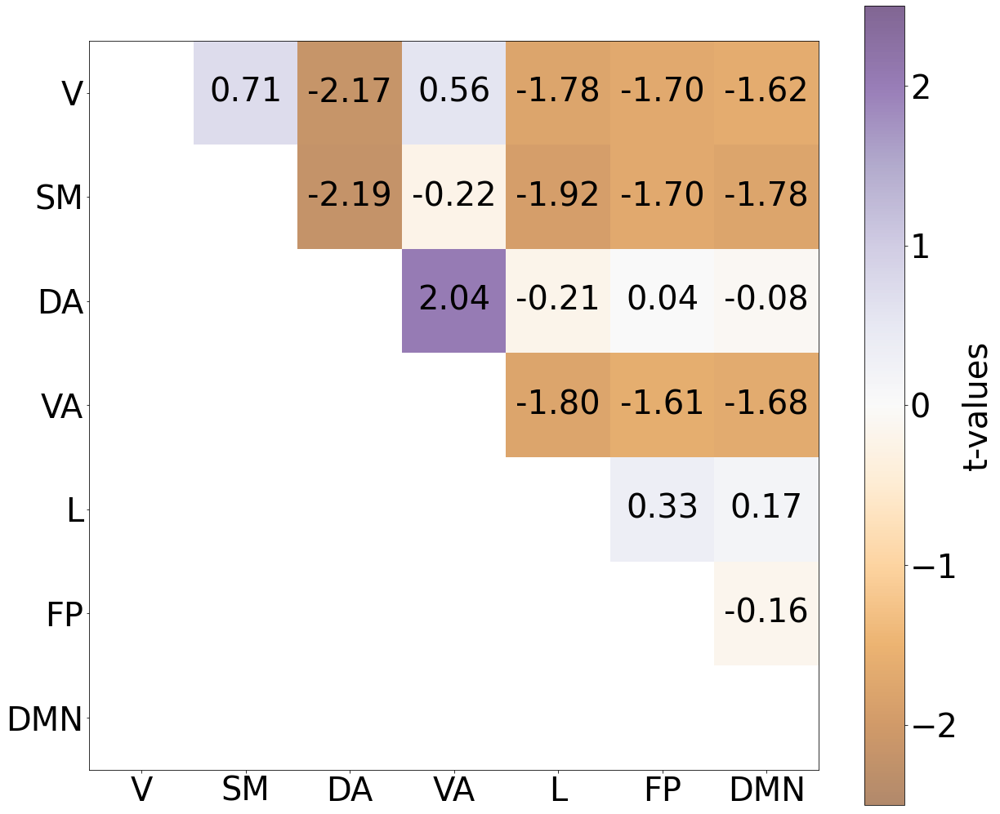

In [246]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_stress_contrast_res, df_column_index_with_tvals=0, df_column_index_with_sigs=3, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='PSS_Me', save_plot = True, output_dir = resdir_fig)

# Dispersion Analyses (He AM) - perceived stress effects

## Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

### Computing within dispersion metric

In [247]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog_stress_He_AM = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion_stress_He_AM = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_He_AM_G1.T  # transpose to obtain shape (400 x 20) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_stress_He_AM_net = np.median(G1_net, axis=0)  
    yeo_cog_stress_He_AM.append(yeo_cog_stress_He_AM_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_stress_He_AM_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion_stress_He_AM.append(sum_of_squares)
    
    
yeo_cog_stress_He_AM = np.array(yeo_cog_stress_He_AM)
WN_dispersion_stress_He_AM = np.array(WN_dispersion_stress_He_AM)

In [248]:
WN_dispersion_stress_He_AM.shape

(7, 20)

### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [249]:
lmer_WN_dispersion_stress_He_AM_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'PSS_t_val': [], 'PSS_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion_stress_He_AM[i],  # dependent variable
        exog = pd.DataFrame({'PSS': hormones_28He_AM.z_PSS}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time, 
        exog_re = None,  # covariates random effects (should be hormones_28He.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of PSS effects (via indices) 
    lmer_WN_dispersion_stress_He_AM_contrast_res['PSS_t_val'].append(results.tvalues['PSS'])
    lmer_WN_dispersion_stress_He_AM_contrast_res['PSS_p_val'].append(results.pvalues['PSS'])

lmer_WN_dispersion_stress_He_AM_contrast_res = pd.DataFrame(lmer_WN_dispersion_stress_He_AM_contrast_res)
lmer_WN_dispersion_stress_He_AM_contrast_res = lmer_WN_dispersion_stress_He_AM_contrast_res.set_index('yeo_network')

In [250]:
lmer_WN_dispersion_stress_He_AM_contrast_res

,PSS_t_val,PSS_p_val
yeo_network,,
visual,-1.011297,0.311874
sensory motor,-1.081146,0.279632
dorsal attention,0.345617,0.729631
ventral attention,-0.499902,0.617144
limbic,-0.157403,0.874927
fronto parietal,-0.120682,0.903943
DMN,-0.102809,0.918115


## Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [251]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_stress_He_AM_contrast_res = {'pairwise_comparison' : [], 'PSS_t_val': [], 'PSS_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_stress_He_AM_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_stress_He_AM_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_stress_He_AM_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog_stress_He_AM[n1] - yeo_cog_stress_He_AM[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'PSS': hormones_28He_AM.z_PSS}),  # fixed effects (covariate)
                groups = hormones_28He_AM.time, 
                exog_re = None,  # covariates random effects (should be hormones_28He_AM.ExperimentDay
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of PSS (via indices) 
            BN_dispersion_stress_He_AM_contrast_res['PSS_t_val'].append(results.tvalues['PSS'])
            BN_dispersion_stress_He_AM_contrast_res['PSS_p_val'].append(results.pvalues['PSS'])


BN_dispersion_stress_He_AM_contrast_res = pd.DataFrame(BN_dispersion_stress_He_AM_contrast_res)
BN_dispersion_stress_He_AM_contrast_res = BN_dispersion_stress_He_AM_contrast_res.set_index('pairwise_comparison')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [252]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_stress_He_AM_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_stress_He_AM_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_stress_He_AM_contrast_res = BN_dispersion_stress_He_AM_contrast_res.set_index('new_comparison_names')
BN_dispersion_stress_He_AM_contrast_res.index.name = 'pairwise_comparisons'

In [253]:
BN_dispersion_stress_He_AM_contrast_res

,PSS_t_val,PSS_p_val
pairwise_comparisons,,
visual - sensory motor,0.042569,0.966045
visual - dorsal attention,-1.963682,0.049567
visual - ventral attention,-0.624741,0.532141
visual - limbic,-0.857043,0.391421
visual - fronto parietal,-0.541375,0.588249
visual - DMN,-0.455908,0.648456
sensory motor - dorsal attention,-1.445259,0.148385
sensory motor - ventral attention,-0.902962,0.366546
sensory motor - limbic,-0.736617,0.461355


## Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_He_AM_stress.py

### Load null distributions of t-values

In [254]:
WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM = pd.read_csv(resdir+'WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM.csv')

BN_dispersion_perm_tval_stress_contrast_null_distr_He_AM = pd.read_csv(resdir+'BN_dispersion_perm_tval_stress_contrast_null_distr_He_AM.csv')

### Compute the spin p-values 

#### Within Network dispersion

In [255]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_stress_He_AM_contrast_res.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_stress_He_AM_contrast_res.loc[network,'PSS_p_val'] < 0.025/7:

        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM[network], score = lmer_WN_dispersion_stress_He_AM_contrast_res.loc[network, 'PSS_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_stress_He_AM_contrast_res.loc[network, 'PSS_t_val'] < np.median(WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')

    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:    
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
        
        

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_stress_He_AM_contrast_res['PSS_spin_p_val'] = spin_p_val
lmer_WN_dispersion_stress_He_AM_contrast_res['PSS significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


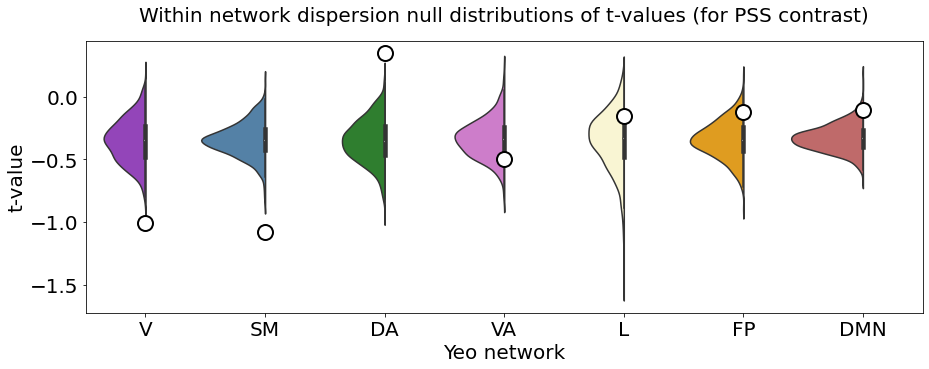

In [256]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM_long = pd.melt(WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM, 
                                                               value_vars = WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_stress_contrast_null_distr_He_AM_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_stress_He_AM_contrast_res.PSS_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for PSS contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_null_distr_tvals_PSS_He_AM.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Results

In [257]:
lmer_WN_dispersion_stress_He_AM_contrast_res

,PSS_t_val,PSS_p_val,PSS_spin_p_val,PSS significance post Bonferroni (alpha=0.0036) and spin test
yeo_network,,,,
visual,-1.011297,0.311874,NaN,not sig
sensory motor,-1.081146,0.279632,NaN,not sig
dorsal attention,0.345617,0.729631,NaN,not sig
ventral attention,-0.499902,0.617144,NaN,not sig
limbic,-0.157403,0.874927,NaN,not sig
fronto parietal,-0.120682,0.903943,NaN,not sig
DMN,-0.102809,0.918115,NaN,not sig


##### Export the results table

In [258]:
lmer_WN_dispersion_stress_He_AM_contrast_res.to_csv(resdir+'lmer_WN_dispersion_stress_He_AM_contrast_res.csv', header = True, index = True)

#### Between Network dispersion

In [259]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_stress_contrast_null_distr_He_AM.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_stress_contrast_null_distr_He_AM.columns = new_col_names

In [260]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_stress_He_AM_contrast_res.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_stress_He_AM_contrast_res.loc[pairwise_comparison,'PSS_p_val'] < 0.025/21:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_stress_contrast_null_distr_He_AM[pairwise_comparison], score = BN_dispersion_stress_He_AM_contrast_res.loc[pairwise_comparison, 'PSS_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_stress_He_AM_contrast_res.loc[pairwise_comparison, 'PSS_t_val'] < np.median(BN_dispersion_perm_tval_stress_contrast_null_distr_He_AM[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')

    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')    
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_stress_He_AM_contrast_res['PSS_spin_p_val'] = spin_p_val
BN_dispersion_stress_He_AM_contrast_res['PSS significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

In [261]:
BN_dispersion_stress_He_AM_contrast_res

,PSS_t_val,PSS_p_val,PSS_spin_p_val,PSS significance post Bonferroni (alpha= 0.001) and spin test
pairwise_comparisons,,,,
visual - sensory motor,0.042569,0.966045,NaN,not sig
visual - dorsal attention,-1.963682,0.049567,NaN,not sig
visual - ventral attention,-0.624741,0.532141,NaN,not sig
visual - limbic,-0.857043,0.391421,NaN,not sig
visual - fronto parietal,-0.541375,0.588249,NaN,not sig
visual - DMN,-0.455908,0.648456,NaN,not sig
sensory motor - dorsal attention,-1.445259,0.148385,NaN,not sig
sensory motor - ventral attention,-0.902962,0.366546,NaN,not sig
sensory motor - limbic,-0.736617,0.461355,NaN,not sig


##### Export the results table

In [262]:
BN_dispersion_stress_He_AM_contrast_res.to_csv(resdir+'lmer_BN_dispersion_stress_He_AM_contrast_res.csv', header = True, index = True)

##### Plot pairwise t-vals for PSS

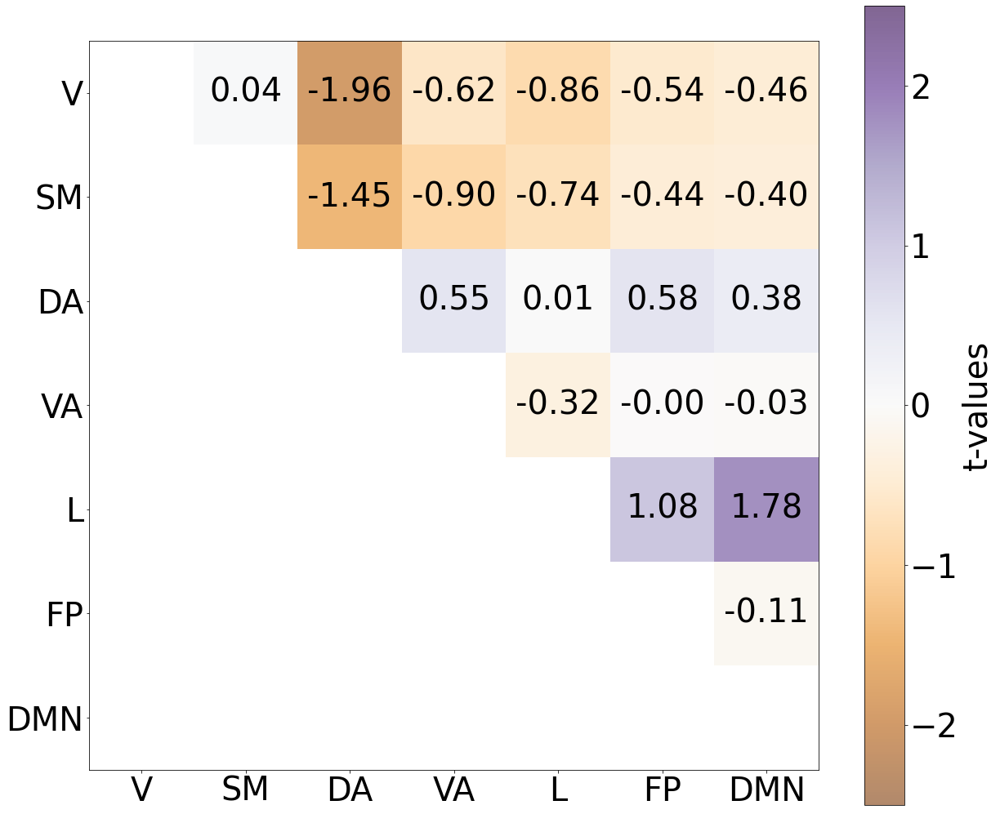

In [263]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_stress_He_AM_contrast_res, df_column_index_with_tvals=0, df_column_index_with_sigs=3, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='PSS_HeAM', save_plot = True, output_dir = resdir_fig)

# Heatmap plots for directionality of integration segregation effects

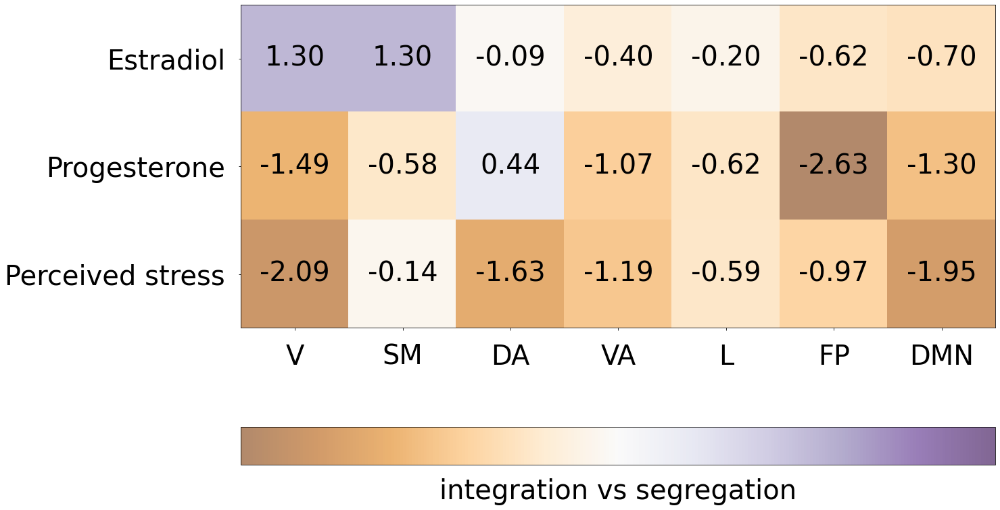

In [264]:
WN_results_to_plot_F = np.array([lmer_WN_dispersion_hormonal_contrast_res.estradiol_t_val.tolist(),lmer_WN_dispersion_hormonal_contrast_res.progesterone_t_val.tolist(),lmer_WN_dispersion_stress_contrast_res.PSS_t_val.tolist()])
WN_results_to_plot_corresp_spinp_val_F = np.array([lmer_WN_dispersion_hormonal_contrast_res.estradiol_spin_p_val.tolist(),lmer_WN_dispersion_hormonal_contrast_res.progesterone_spin_p_val.tolist(), lmer_WN_dispersion_stress_contrast_res.PSS_spin_p_val.tolist()])


plt.figure(figsize=(20, 18))

## If I want to plot the colormap with limits defined by min and max t values:
# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
#max_abs_value = np.max(np.abs(WN_results_to_plot_F))

# Give those min and max absolute values
#plt.imshow(WN_results_to_plot_F, cmap='PiYG', interpolation='none', vmin=-max_abs_value, vmax=max_abs_value)

# However, given that the null distributions aren't centered, using min and max abs values is leading to some very lightly colored significant t vals because close to 0 (where you cannot infer the direction clearly) 
# so specify vmin and vmax parameters in imshow to values that make the plot interpretation clearer (NEEDS TO BE THE SAME FOR MALE HEATMAP BECAUSE THEY WILL GO IN SAME FIGURE IN PAPER AND I WILL ONLY USE 1 COLORBAR LEGEND)
plt.imshow(WN_results_to_plot_F, cmap='PuOr', interpolation='none', vmin=-2.5, vmax=2.5, alpha=0.6)



colorbar = plt.colorbar(location="bottom")

# to display colorbar ticks
#colorbar.ax.tick_params(labelsize=40)  # Set the font size for the color bar ticks
#colorbar.set_label('t-values', fontsize=40)  # Set the font size for the color bar label

# to remove colorbar ticks (for plot visualization in Figure Manuscript)
colorbar.set_label('integration vs segregation', fontsize=40, labelpad=20)  # Set the font size for the color bar label
colorbar.set_ticks([])


plt.xticks(ticks=range(WN_results_to_plot_F.shape[1]), labels=np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0,  fontsize=40)
plt.yticks(ticks=range(WN_results_to_plot_F.shape[0]), labels=np.array(['Estradiol', 'Progesterone', 'Perceived stress']), rotation=0,  fontsize=40)

# Set tick pad for x and y axes
plt.tick_params(axis='x', which='both', pad=20)
plt.tick_params(axis='y', which='both', pad=20)


# Add labels to the value
for i in range(WN_results_to_plot_F.shape[0]):
    for j in range(WN_results_to_plot_F.shape[1]):
        value = WN_results_to_plot_F[i, j]
        annotation = f'{value:.2f}'
        
        plt.annotate(annotation, xy=(j, i), color='black', ha='center', va='center', fontsize=40)
        
        if WN_results_to_plot_corresp_spinp_val_F[i, j] <= 0.025: # we don't correct for multiple comparisons here because we did before running spin
            plt.annotate('*', xy=(j, i - 0.25), color='red', ha='center', va='center', fontsize=40)


plt.savefig(resdir_fig+'WN_dispersion_heatmap_matrix_tvals_F', dpi=300,  bbox_inches='tight')        


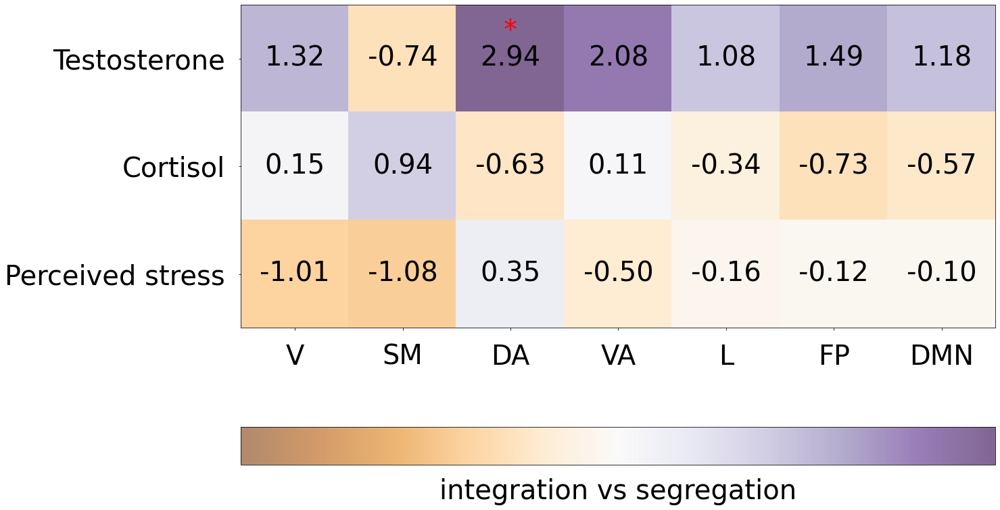

In [265]:
WN_results_to_plot_M = np.array([lmer_WN_dispersion_He_AM_hormonal_contrast_res.testosterone_t_val.tolist(),lmer_WN_dispersion_He_AM_hormonal_contrast_res.cortisol_t_val.tolist(),lmer_WN_dispersion_stress_He_AM_contrast_res.PSS_t_val.tolist()])
WN_results_to_plot_corresp_spinp_val_M = np.array([lmer_WN_dispersion_He_AM_hormonal_contrast_res.testosterone_spin_p_val.tolist(),lmer_WN_dispersion_He_AM_hormonal_contrast_res.cortisol_spin_p_val.tolist(), lmer_WN_dispersion_stress_He_AM_contrast_res.PSS_spin_p_val.tolist()])



plt.figure(figsize=(20, 18))

## If I want to plot the colormap with limits defined by min and max t values:
# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
#max_abs_value = np.max(np.abs(WN_results_to_plot_M))

# Give those min and max absolute values
#plt.imshow(WN_results_to_plot_M, cmap='PiYG', interpolation='none', vmin=-max_abs_value, vmax=max_abs_value)

# However, given that the null distributions aren't centered, using min and max abs values is leading to some very lightly colored significant t vals because close to 0 (where you cannot infer the direction clearly) 
# so specify vmin and vmax parameters in imshow to values that make the plot interpretation clearer (NEEDS TO BE THE SAME FOR MALE HEATMAP BECAUSE THEY WILL GO IN SAME FIGURE IN PAPER AND I WILL ONLY USE 1 COLORBAR LEGEND)
plt.imshow(WN_results_to_plot_M, cmap='PuOr', interpolation='none', vmin=-2.5, vmax=2.5, alpha=0.6)

colorbar = plt.colorbar(location="bottom")

# to display colorbar ticks
#colorbar.ax.tick_params(labelsize=40)  # Set the font size for the color bar ticks
#colorbar.set_label('t-values', fontsize=40)  # Set the font size for the color bar label

# to remove colorbar ticks (for plot visualization in Figure Manuscript)
colorbar.set_label('integration vs segregation', fontsize=40, labelpad=20)  # Set the font size for the color bar label
colorbar.set_ticks([])


plt.xticks(ticks=range(WN_results_to_plot_M.shape[1]), labels=np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0,  fontsize=40)
plt.yticks(ticks=range(WN_results_to_plot_M.shape[0]), labels=np.array(['Testosterone', 'Cortisol', 'Perceived stress']), rotation=0,  fontsize=40)

# Set tick pad for x and y axes
plt.tick_params(axis='x', which='both', pad=20)
plt.tick_params(axis='y', which='both', pad=20)


# Add labels to the value
for i in range(WN_results_to_plot_M.shape[0]):
    for j in range(WN_results_to_plot_M.shape[1]):
        value = WN_results_to_plot_M[i, j]
        annotation = f'{value:.2f}'
        
        plt.annotate(annotation, xy=(j, i), color='black', ha='center', va='center', fontsize=40)
        
        if WN_results_to_plot_corresp_spinp_val_M[i, j] <= 0.025: # we don't correct for multiple comparisons here because we did before running spin
            plt.annotate('*', xy=(j, i - 0.25), color='red', ha='center', va='center', fontsize=40)
        

plt.savefig(resdir_fig+'WN_dispersion_heatmap_matrix_tvals_M', dpi=300,  bbox_inches='tight')
        

#
#
#
#
# Neuromaps

## Load neuromaps datasets

In [269]:
import neuromaps
from neuromaps.datasets import available_annotations
from neuromaps.datasets import available_tags
from neuromaps.datasets import fetch_annotation
from neuromaps import transforms
from neuromaps.resampling import resample_images

## Browse available maps

In [52]:
for annotation in available_annotations():
    print(annotation)

('abagen', 'genepc1', 'fsaverage', '10k')
('aghourian2017', 'feobv', 'MNI152', '1mm')
('alarkurtti2015', 'raclopride', 'MNI152', '3mm')
('bedard2019', 'feobv', 'MNI152', '1mm')
('beliveau2017', 'az10419369', 'MNI152', '1mm')
('beliveau2017', 'az10419369', 'fsaverage', '164k')
('beliveau2017', 'cimbi36', 'MNI152', '1mm')
('beliveau2017', 'cimbi36', 'fsaverage', '164k')
('beliveau2017', 'cumi101', 'MNI152', '1mm')
('beliveau2017', 'cumi101', 'fsaverage', '164k')
('beliveau2017', 'dasb', 'MNI152', '1mm')
('beliveau2017', 'dasb', 'fsaverage', '164k')
('beliveau2017', 'sb207145', 'MNI152', '1mm')
('beliveau2017', 'sb207145', 'fsaverage', '164k')
('ding2010', 'mrb', 'MNI152', '1mm')
('dubois2015', 'abp688', 'MNI152', '1mm')
('dukart2018', 'flumazenil', 'MNI152', '3mm')
('dukart2018', 'fpcit', 'MNI152', '3mm')
('fazio2016', 'madam', 'MNI152', '3mm')
('finnema2016', 'ucbj', 'MNI152', '1mm')
('gallezot2010', 'p943', 'MNI152', '1mm')
('gallezot2017', 'gsk189254', 'MNI152', '1mm')
('hcps1200', 'm

In [53]:
print(available_tags())

['ASL', 'MEG', 'MRI', 'PET', 'fMRI', 'functional', 'genetics', 'meta-analysis', 'metabolism', 'receptors', 'structural']


In [54]:
for annotation in available_annotations(tags=['meta-analysis']):
    print(annotation)

('neurosynth', 'cogpc1', 'MNI152', '2mm')


In [55]:
for annotation in available_annotations(tags=['functional']):
    print(annotation)

('hcps1200', 'megalpha', 'fsLR', '4k')
('hcps1200', 'megbeta', 'fsLR', '4k')
('hcps1200', 'megdelta', 'fsLR', '4k')
('hcps1200', 'meggamma1', 'fsLR', '4k')
('hcps1200', 'meggamma2', 'fsLR', '4k')
('hcps1200', 'megtheta', 'fsLR', '4k')
('hcps1200', 'megtimescale', 'fsLR', '4k')
('margulies2016', 'fcgradient01', 'fsLR', '32k')
('margulies2016', 'fcgradient02', 'fsLR', '32k')
('margulies2016', 'fcgradient03', 'fsLR', '32k')
('margulies2016', 'fcgradient04', 'fsLR', '32k')
('margulies2016', 'fcgradient05', 'fsLR', '32k')
('margulies2016', 'fcgradient06', 'fsLR', '32k')
('margulies2016', 'fcgradient07', 'fsLR', '32k')
('margulies2016', 'fcgradient08', 'fsLR', '32k')
('margulies2016', 'fcgradient09', 'fsLR', '32k')
('margulies2016', 'fcgradient10', 'fsLR', '32k')
('mueller2013', 'intersubjvar', 'fsLR', '164k')
('neurosynth', 'cogpc1', 'MNI152', '2mm')
('raichle', 'cbf', 'fsLR', '164k')
('raichle', 'cbv', 'fsLR', '164k')
('raichle', 'cmr02', 'fsLR', '164k')
('raichle', 'cmrglc', 'fsLR', '164k

In [56]:
for annotation in available_annotations(tags=['genetics']):
    print(annotation)

('abagen', 'genepc1', 'fsaverage', '10k')


In [57]:
for annotation in available_annotations(tags=['ASL']):
    print(annotation)

('satterthwaite2014', 'meancbf', 'MNI152', '1mm')


In [58]:
for annotation in available_annotations(tags=['PET']):
    print(annotation)

('aghourian2017', 'feobv', 'MNI152', '1mm')
('alarkurtti2015', 'raclopride', 'MNI152', '3mm')
('bedard2019', 'feobv', 'MNI152', '1mm')
('beliveau2017', 'az10419369', 'MNI152', '1mm')
('beliveau2017', 'az10419369', 'fsaverage', '164k')
('beliveau2017', 'cimbi36', 'MNI152', '1mm')
('beliveau2017', 'cimbi36', 'fsaverage', '164k')
('beliveau2017', 'cumi101', 'MNI152', '1mm')
('beliveau2017', 'cumi101', 'fsaverage', '164k')
('beliveau2017', 'dasb', 'MNI152', '1mm')
('beliveau2017', 'dasb', 'fsaverage', '164k')
('beliveau2017', 'sb207145', 'MNI152', '1mm')
('beliveau2017', 'sb207145', 'fsaverage', '164k')
('ding2010', 'mrb', 'MNI152', '1mm')
('dubois2015', 'abp688', 'MNI152', '1mm')
('dukart2018', 'flumazenil', 'MNI152', '3mm')
('dukart2018', 'fpcit', 'MNI152', '3mm')
('fazio2016', 'madam', 'MNI152', '3mm')
('finnema2016', 'ucbj', 'MNI152', '1mm')
('gallezot2010', 'p943', 'MNI152', '1mm')
('gallezot2017', 'gsk189254', 'MNI152', '1mm')
('hesse2017', 'methylreboxetine', 'MNI152', '3mm')
('hill

In [59]:
for annotation in available_annotations(tags=['receptors']):
    print(annotation)

('aghourian2017', 'feobv', 'MNI152', '1mm')
('alarkurtti2015', 'raclopride', 'MNI152', '3mm')
('bedard2019', 'feobv', 'MNI152', '1mm')
('beliveau2017', 'az10419369', 'MNI152', '1mm')
('beliveau2017', 'az10419369', 'fsaverage', '164k')
('beliveau2017', 'cimbi36', 'MNI152', '1mm')
('beliveau2017', 'cimbi36', 'fsaverage', '164k')
('beliveau2017', 'cumi101', 'MNI152', '1mm')
('beliveau2017', 'cumi101', 'fsaverage', '164k')
('beliveau2017', 'dasb', 'MNI152', '1mm')
('beliveau2017', 'dasb', 'fsaverage', '164k')
('beliveau2017', 'sb207145', 'MNI152', '1mm')
('beliveau2017', 'sb207145', 'fsaverage', '164k')
('ding2010', 'mrb', 'MNI152', '1mm')
('dubois2015', 'abp688', 'MNI152', '1mm')
('dukart2018', 'flumazenil', 'MNI152', '3mm')
('dukart2018', 'fpcit', 'MNI152', '3mm')
('fazio2016', 'madam', 'MNI152', '3mm')
('gallezot2010', 'p943', 'MNI152', '1mm')
('gallezot2017', 'gsk189254', 'MNI152', '1mm')
('hesse2017', 'methylreboxetine', 'MNI152', '3mm')
('hillmer2016', 'flubatine', 'MNI152', '1mm')
(

In [60]:
for annotation in available_annotations(tags=['structural']):
    print(annotation)

('hcps1200', 'myelinmap', 'fsLR', '32k')
('hcps1200', 'thickness', 'fsLR', '32k')
('hill2010', 'devexp', 'fsLR', '164k')
('hill2010', 'evoexp', 'fsLR', '164k')
('neurosynth', 'cogpc1', 'MNI152', '2mm')
('reardon2018', 'scalinghcp', 'civet', '41k')
('reardon2018', 'scalingnih', 'civet', '41k')
('reardon2018', 'scalingpnc', 'civet', '41k')
('xu2020', 'evoexp', 'fsLR', '32k')


## Selecting maps of interest

In [92]:
### when there are multiple maps under the same source, fetch annotation loads all in 1 dictionary so need to index the one I want

# meta analysis
neurosynth = fetch_annotation(source='neurosynth')

# genes
abagen = fetch_annotation(source='abagen')

# metabolism
#glucose = fetch_annotation(source='raichle')[('raichle', 'cmruglu', 'fsLR', '164k')]
glucose = fetch_annotation(source='raichle')[('raichle', 'cmrglc', 'fsLR', '164k')]
oxygen = fetch_annotation(source='raichle')[('raichle', 'cmr02', 'fsLR', '164k')]
cbf = fetch_annotation(source='raichle')[('raichle', 'cbf', 'fsLR', '164k')]

# receptors
dopa = fetch_annotation(source='alarkurtti2015')
acetylcholine = fetch_annotation(source='bedard2019')
sert = fetch_annotation(source='beliveau2017')[('beliveau2017', 'dasb', 'fsaverage', '164k')]
norepinephrine = fetch_annotation(source='ding2010')
glutamate = fetch_annotation(source='dubois2015')

# structure
myelin = fetch_annotation(source='hcps1200')[('hcps1200', 'myelinmap', 'fsLR', '32k')]
cortical_thickness = fetch_annotation(source='hcps1200')[('hcps1200', 'thickness', 'fsLR', '32k')]

# MEG
meg_alpha = fetch_annotation(source='hcps1200')[('hcps1200', 'megalpha', 'fsLR', '4k')]
meg_beta = fetch_annotation(source='hcps1200')[('hcps1200', 'megbeta', 'fsLR', '4k')]
meg_delta = fetch_annotation(source='hcps1200')[('hcps1200', 'megdelta', 'fsLR', '4k')]
meg_gamma1 = fetch_annotation(source='hcps1200')[('hcps1200', 'meggamma1', 'fsLR', '4k')]
meg_gamma2 = fetch_annotation(source='hcps1200')[('hcps1200', 'meggamma2', 'fsLR', '4k')]
meg_theta = fetch_annotation(source='hcps1200')[('hcps1200', 'megtheta', 'fsLR', '4k')]

# expansion
evoexp = fetch_annotation(source='hill2010')[('hill2010', 'evoexp', 'fsLR', '164k')]  # note that map only has data for right hemisphere

/tmp/ipykernel_4616/3372071841.py:18: UserWarning: Data from beliveau2017 and norgaard2021 is best used in the provided fsaverage space (e.g. source='beliveau2017', space='fsaverage', den='164k'). MNI152 maps should only be used for subcortical data.
  sert = fetch_annotation(source='beliveau2017')[('beliveau2017', 'dasb', 'fsaverage', '164k')]


## Transforming maps to fsaverage space

### One at the time

### Resample to common space (2 at the same time)

In [93]:
neurosynth_fsaverage, abagen_fsaverage = resample_images(src=neurosynth, trg=abagen,
                                    src_space='MNI152', trg_space='fsaverage',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

glucose_fsaverage, oxygen_fsaverage = resample_images(src=glucose, trg=oxygen,
                                    src_space='fsLR', trg_space='fsLR',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

cbf_fsaverage, dopa_fsaverage = resample_images(src=cbf, trg=dopa,
                                    src_space='fsLR', trg_space='MNI152',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

acetylcholine_fsaverage, sert_fsaverage = resample_images(src=acetylcholine, trg=sert,
                                    src_space='MNI152', trg_space='fsaverage',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

norepinephrine_fsaverage, glutamate_fsaverage = resample_images(src=norepinephrine, trg=glutamate,
                                    src_space='MNI152', trg_space='MNI152',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

myelin_fsaverage, cortical_thickness_fsaverage = resample_images(src=myelin, trg=cortical_thickness,
                                    src_space='fsLR', trg_space='fsLR',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

meg_alpha_fsaverage, meg_beta_fsaverage = resample_images(src=meg_alpha, trg=meg_beta,
                                    src_space='fsLR', trg_space='fsLR',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

meg_delta_fsaverage, meg_gamma1_fsaverage = resample_images(src=meg_delta, trg=meg_gamma1,
                                    src_space='fsLR', trg_space='fsLR',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

meg_gamma2_fsaverage, meg_theta_fsaverage = resample_images(src=meg_gamma2, trg=meg_theta,
                                    src_space='fsLR', trg_space='fsLR',
                                    method='linear', resampling='transform_to_alt',
                                    alt_spec=('fsaverage', '10k'))  # specifies the target coordinate system and density

evoexp_fsaverage_rh = transforms.fslr_to_fsaverage(evoexp, '10k', hemi='R')

pixdim[0] (qfac) should be 1 (default) or -1; setting qfac to 1


2024-01-11 18:33:02,652 - nibabel.global - INFO - pixdim[0] (qfac) should be 1 (default) or -1; setting qfac to 1


pixdim[0] (qfac) should be 1 (default) or -1; setting qfac to 1


2024-01-11 18:33:13,194 - nibabel.global - INFO - pixdim[0] (qfac) should be 1 (default) or -1; setting qfac to 1


### Reshape the maps into useable format

In [94]:
# get the data loaded on left and right hemispheres (GIFTY images)
neurosynth_fsaverage_lh, neurosynth_fsaverage_rh = neurosynth_fsaverage
abagen_fsaverage_lh, abagen_fsaverage_rh = abagen_fsaverage
glucose_fsaverage_lh, glucose_fsaverage_rh = glucose_fsaverage
oxygen_fsaverage_lh, oxygen_fsaverage_rh = oxygen_fsaverage
cbf_fsaverage_lh, cbf_fsaverage_rh = cbf_fsaverage
dopa_fsaverage_lh, dopa_fsaverage_rh = dopa_fsaverage
acetylcholine_fsaverage_lh, acetylcholine_fsaverage_rh = acetylcholine_fsaverage
sert_fsaverage_lh, sert_fsaverage_rh = sert_fsaverage
norepinephrine_fsaverage_lh, norepinephrine_fsaverage_rh = norepinephrine_fsaverage
glutamate_fsaverage_lh, glutamate_fsaverage_rh = glutamate_fsaverage
myelin_fsaverage_lh, myelin_fsaverage_rh = myelin_fsaverage
cortical_thickness_fsaverage_lh, cortical_thickness_fsaverage_rh = cortical_thickness_fsaverage
meg_alpha_fsaverage_lh, meg_alpha_fsaverage_rh = meg_alpha_fsaverage
meg_beta_fsaverage_lh, meg_beta_fsaverage_rh = meg_beta_fsaverage
meg_delta_fsaverage_lh, meg_delta_fsaverage_rh = meg_delta_fsaverage
meg_gamma1_fsaverage_lh, meg_gamma1_fsaverage_rh = meg_gamma1_fsaverage
meg_gamma2_fsaverage_lh, meg_gamma2_fsaverage_rh = meg_gamma2_fsaverage
meg_theta_fsaverage_lh, meg_theta_fsaverage_rh = meg_theta_fsaverage

# concatenate left and right hemispheres (using agg_data() to obtain data values from GIFTY images in numpy array)
neurosynth_fsaverage_wb = np.concatenate((neurosynth_fsaverage_lh.agg_data(), neurosynth_fsaverage_rh.agg_data()))
abagen_fsaverage_wb = np.concatenate((abagen_fsaverage_lh.agg_data(), abagen_fsaverage_rh.agg_data()))
glucose_fsaverage_wb = np.concatenate((glucose_fsaverage_lh.agg_data(), glucose_fsaverage_rh.agg_data()))
oxygen_fsaverage_wb = np.concatenate((oxygen_fsaverage_lh.agg_data(), oxygen_fsaverage_rh.agg_data()))
cbf_fsaverage_wb = np.concatenate((cbf_fsaverage_lh.agg_data(), cbf_fsaverage_rh.agg_data()))
dopa_fsaverage_wb = np.concatenate((dopa_fsaverage_lh.agg_data(), dopa_fsaverage_rh.agg_data()))
acetylcholine_fsaverage_wb = np.concatenate((acetylcholine_fsaverage_lh.agg_data(), acetylcholine_fsaverage_rh.agg_data()))
sert_fsaverage_wb = np.concatenate((sert_fsaverage_lh.agg_data(), sert_fsaverage_rh.agg_data()))
norepinephrine_fsaverage_wb = np.concatenate((norepinephrine_fsaverage_lh.agg_data(), norepinephrine_fsaverage_rh.agg_data()))
glutamate_fsaverage_wb = np.concatenate((glutamate_fsaverage_lh.agg_data(), glutamate_fsaverage_rh.agg_data()))
myelin_fsaverage_wb = np.concatenate((myelin_fsaverage_lh.agg_data(), myelin_fsaverage_rh.agg_data()))
cortical_thickness_fsaverage_wb = np.concatenate((cortical_thickness_fsaverage_lh.agg_data(), cortical_thickness_fsaverage_rh.agg_data()))
meg_alpha_fsaverage_wb = np.concatenate((meg_alpha_fsaverage_lh.agg_data(), meg_alpha_fsaverage_rh.agg_data()))
meg_beta_fsaverage_wb = np.concatenate((meg_beta_fsaverage_lh.agg_data(), meg_beta_fsaverage_rh.agg_data()))
meg_delta_fsaverage_wb = np.concatenate((meg_delta_fsaverage_lh.agg_data(), meg_delta_fsaverage_rh.agg_data()))
meg_gamma1_fsaverage_wb = np.concatenate((meg_gamma1_fsaverage_lh.agg_data(), meg_gamma1_fsaverage_rh.agg_data()))
meg_gamma2_fsaverage_wb = np.concatenate((meg_gamma2_fsaverage_lh.agg_data(), meg_gamma2_fsaverage_rh.agg_data()))
meg_theta_fsaverage_wb = np.concatenate((meg_theta_fsaverage_lh.agg_data(), meg_theta_fsaverage_rh.agg_data()))


# only right hemispheres - still need to get the data values from GIFTY images (but no concatenation of hemispheres)
evoexp_fsaverage_rh = evoexp_fsaverage_rh[0].agg_data()


### make ordered lists (for later table and plotting) 

# names of neuromaps
neuromap_names = ['Neurosynth',
                  'Gene Expression',
                  'Glucose',
                  'Oxygen',
                  'CBF',
                  'Dopamine',
                  'Acetylcholine',
                  'Serotonin',
                  'Norepinephrine',
                  'Glutamate',
                  'Myelin',
                  'Cortical Thickness',
                  'MEG Alpha',
                  'MEG Beta',
                  'MEG Delta',
                  'MEG Gamma 1',
                  'MEG Gamma 2',
                  'MEG Theta',  
                  'Evolutionary Expansion']

# neuromaps (data)
neuromaps = [neurosynth_fsaverage_wb, 
             abagen_fsaverage_wb, 
             glucose_fsaverage_wb,
             oxygen_fsaverage_wb,
             cbf_fsaverage_wb, 
             dopa_fsaverage_wb, 
             acetylcholine_fsaverage_wb, 
             sert_fsaverage_wb, 
             norepinephrine_fsaverage_wb, 
             glutamate_fsaverage_wb, 
             myelin_fsaverage_wb,
             cortical_thickness_fsaverage_wb,
             meg_alpha_fsaverage_wb,
             meg_beta_fsaverage_wb,
             meg_delta_fsaverage_wb,
             meg_gamma1_fsaverage_wb,
             meg_gamma2_fsaverage_wb,
             meg_theta_fsaverage_wb,
             evoexp_fsaverage_rh]

## Analyses: associations of male/female intra-individual variability with neuromaps

In [64]:
print(f"Bonferroni corection threshold: {0.05/len(neuromaps)}")

Bonferroni corection threshold: 0.002631578947368421


### Prepare data to correlate

In [65]:
### variability
Me_G1_excl26_std =  np.std(array_aligned_fc_G1_excl26, axis=0)
He_AM_G1_std = np.std(array_aligned_fc_He_AM_G1, axis=0)
std_F_minus_M = Me_G1_excl26_std - He_AM_G1_std

# transform to fs5 space
Me_G1_excl26_std_fs5 = schaefer400_to_fs5(schaefer400_data = Me_G1_excl26_std, seven_networks=False)
He_AM_G1_std_fs5 = schaefer400_to_fs5(schaefer400_data = He_AM_G1_std, seven_networks=False)
std_F_minus_M_fs5 = schaefer400_to_fs5(schaefer400_data = std_F_minus_M, seven_networks=False)

### hormonal effects
#estradiol_t_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.estradiol_t_val, seven_networks=False)
#progesterone_t_val_excl26_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26.progesterone_t_val, seven_networks=False)
#testosterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.testosterone_t_val, seven_networks=False)
#cortisol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM.cortisol_t_val, seven_networks=False)

### stress effects
#Me_PSS_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_excl26_stress.PSS_t_val, seven_networks=False)
#He_AM_PSS_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_AM_stress.PSS_t_val, seven_networks=False)

### Compute correlations between data to correlate and each neuromap

#### Female variability

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0345


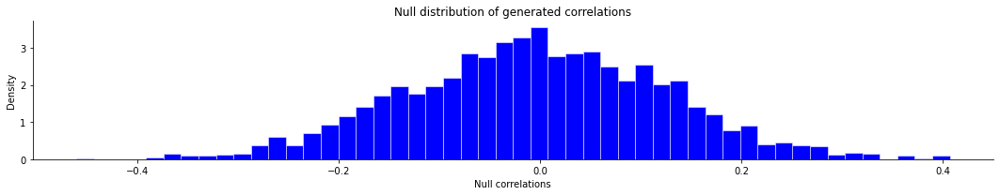

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.178


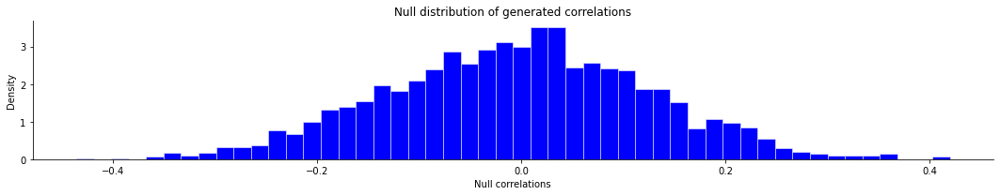

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.010499999999999999


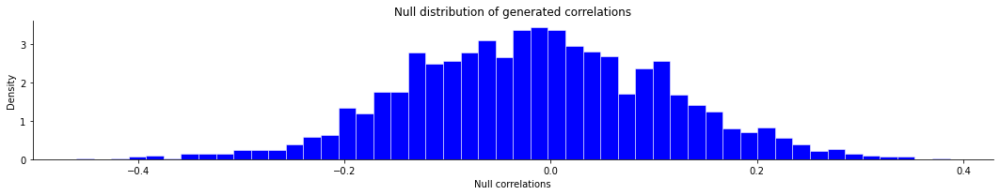

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.047


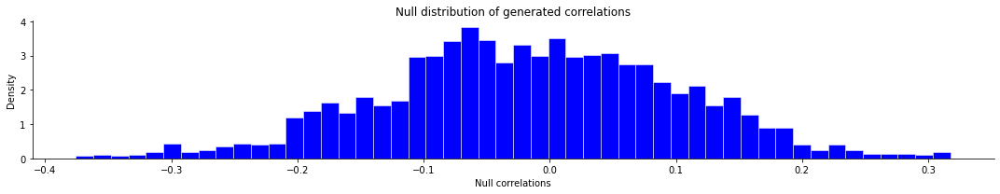

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.086


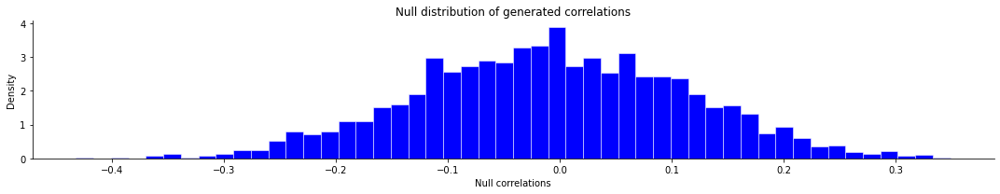

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.252


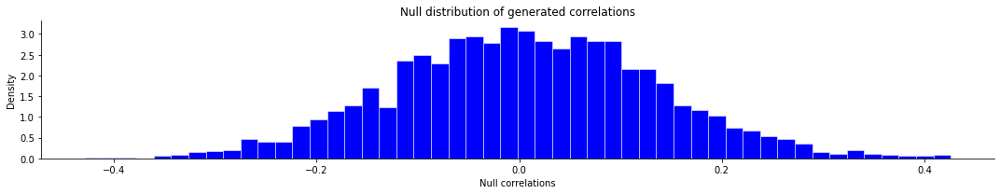

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0465


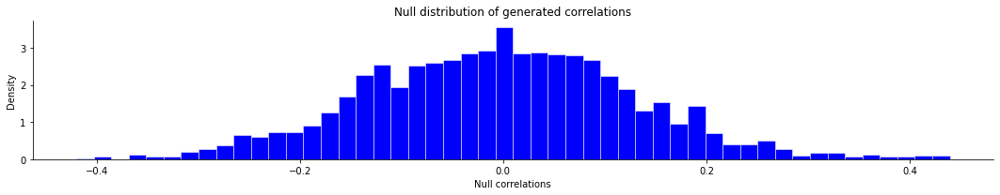

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.07200000000000001


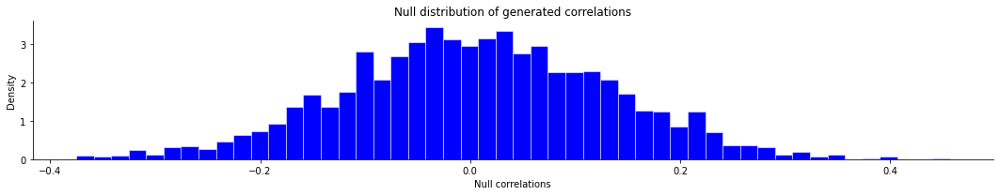

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.5105


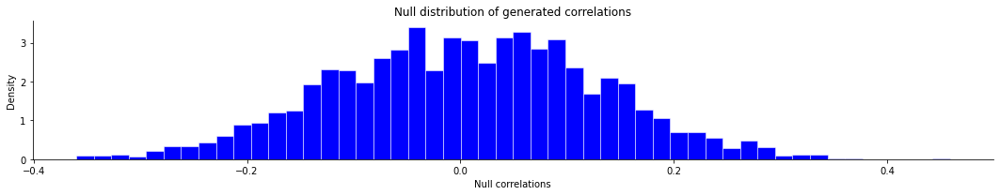

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3575


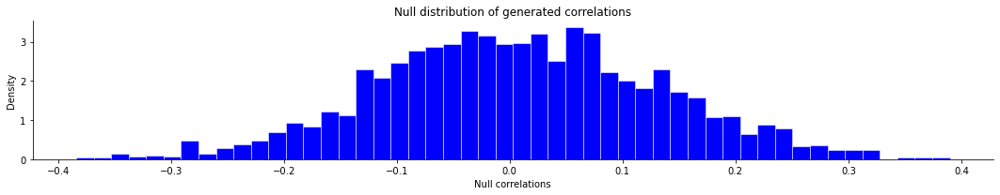

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.414


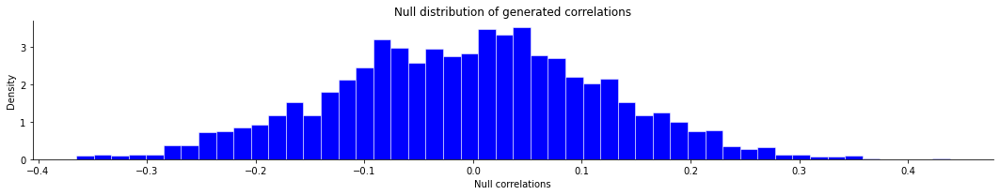

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.20350000000000001


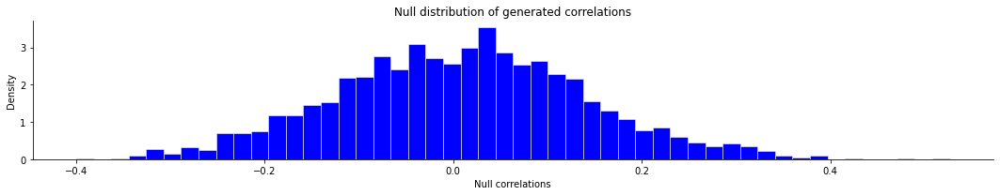

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1765


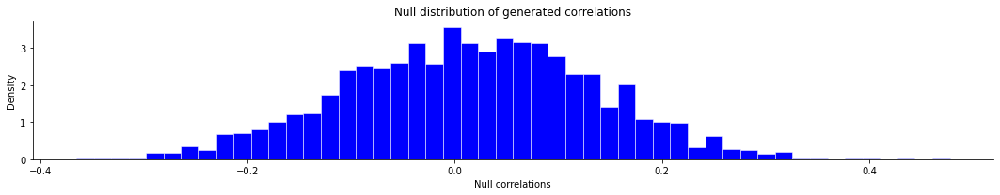

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3695


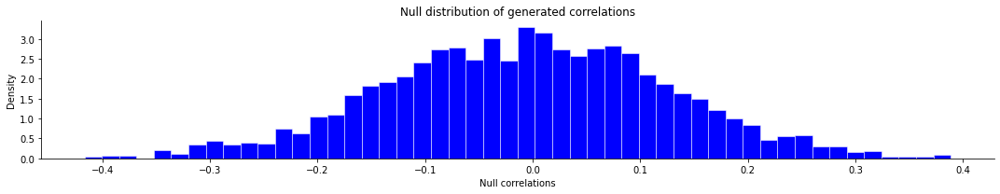

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.232


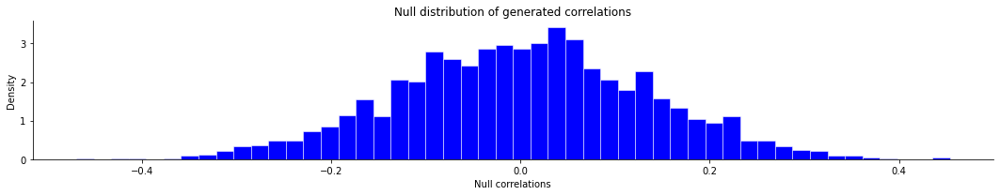

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.304


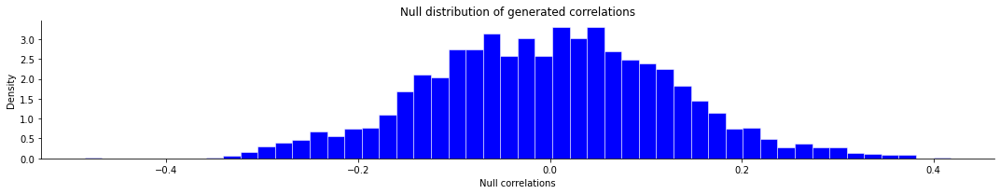

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1635


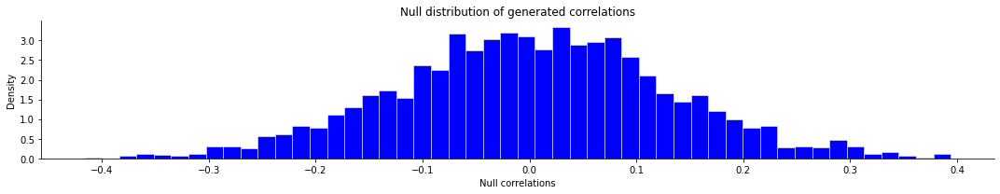

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4785


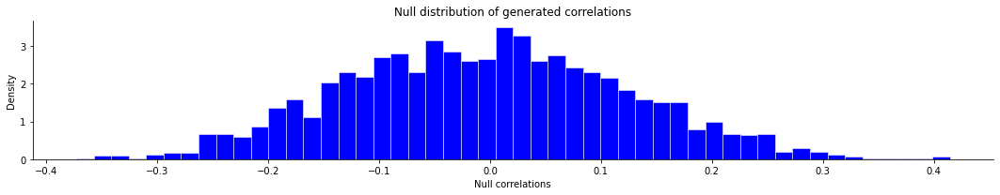

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3925


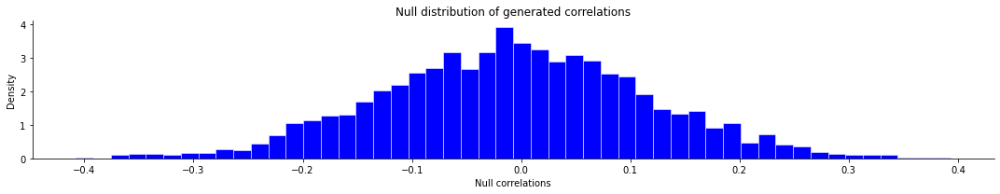

In [66]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(Me_G1_excl26_std_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(Me_G1_excl26_std_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = Me_G1_excl26_std_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(Me_G1_excl26_std_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(Me_G1_excl26_std_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = Me_G1_excl26_std_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

Me_G1_excl26_std_neuromaps_res = pd.DataFrame(neuromaps_res)

In [67]:
Me_G1_excl26_std_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,0.221610,3.209774e-207,0.0345,0.223250,False,False
1,Gene Expression,-0.125020,4.974918e-65,0.1780,0.375778,False,False
2,Glucose,-0.310777,0.000000e+00,0.0105,0.199500,False,False
3,Oxygen,-0.206020,9.285689e-179,0.0470,0.223250,False,False
4,CBF,-0.173753,6.090434e-127,0.0860,0.272333,False,False
5,Dopamine,-0.080614,2.116118e-28,0.2520,0.399000,False,False
6,Acetylcholine,0.211666,8.364014e-189,0.0465,0.223250,False,False
7,Serotonin,0.190782,4.114588e-153,0.0720,0.272333,False,False
8,Norepinephrine,0.004277,5.582154e-01,0.5105,0.510500,False,False
9,Glutamate,-0.040575,2.751950e-08,0.3575,0.462706,False,False


In [266]:
Me_G1_excl26_std_neuromaps_res = pd.read_csv(resdir+'Me_G1_excl26_std_neuromaps_res.csv', index_col = 0)

#### Male variability

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.334


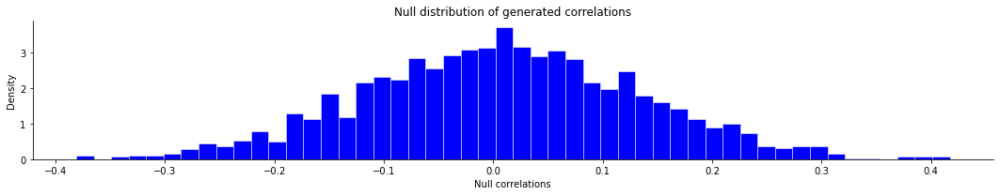

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.004


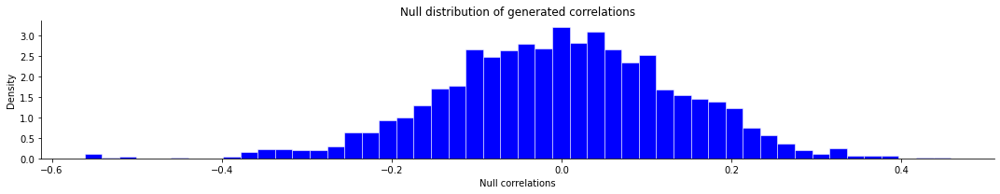

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.014499999999999999


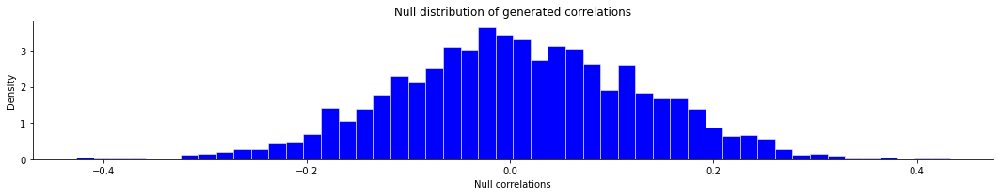

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0025


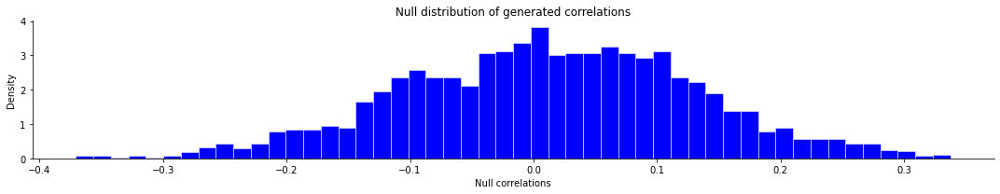

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.07600000000000001


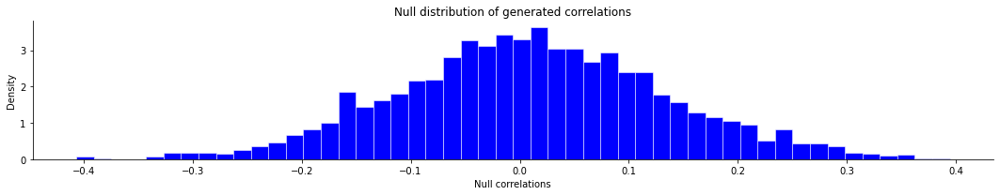

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4105


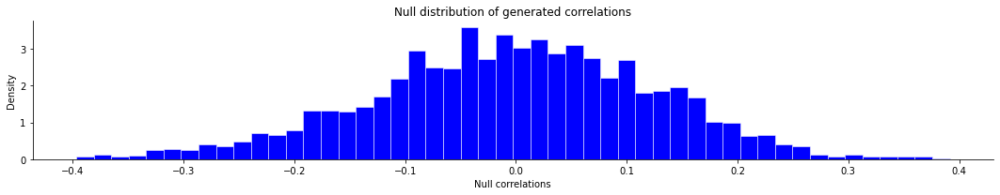

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0305


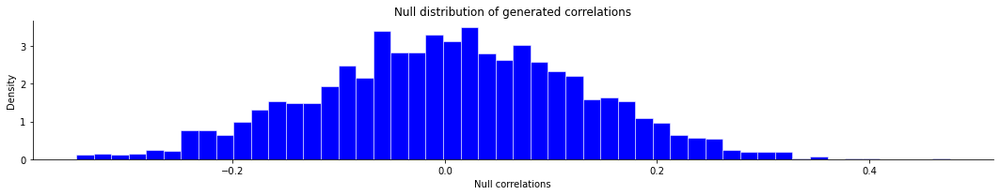

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.437


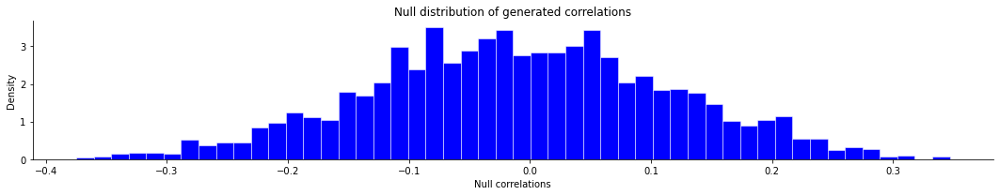

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2765


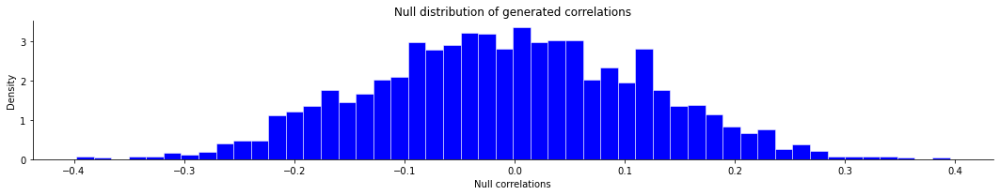

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0595


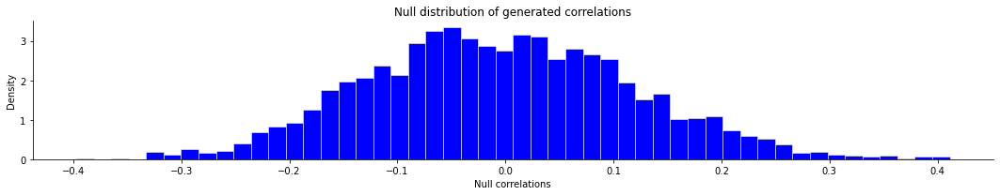

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0005


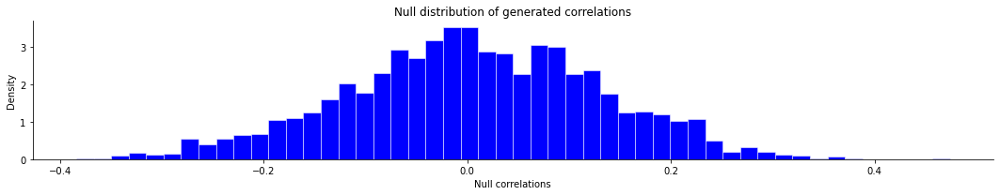

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.005


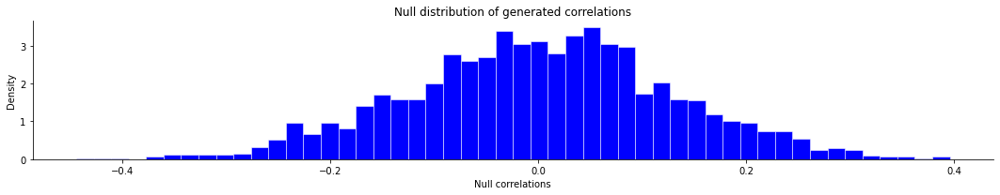

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0045000000000000005


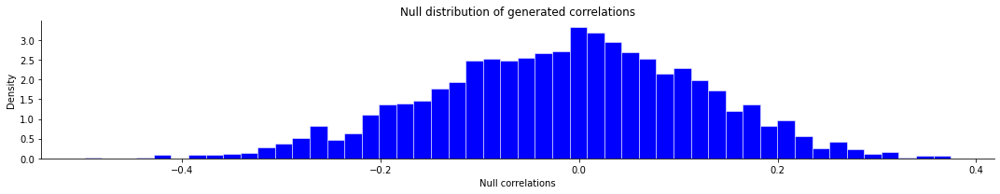

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.21350000000000002


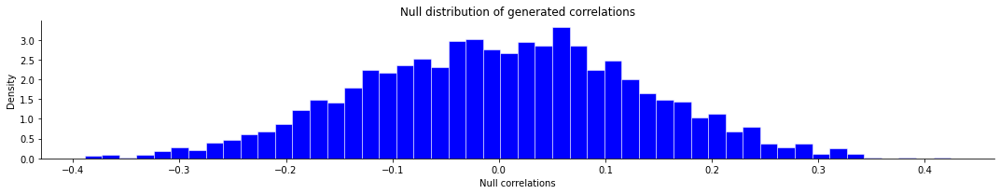

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.027


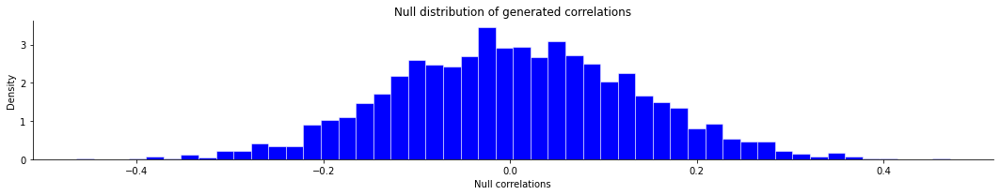

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0165


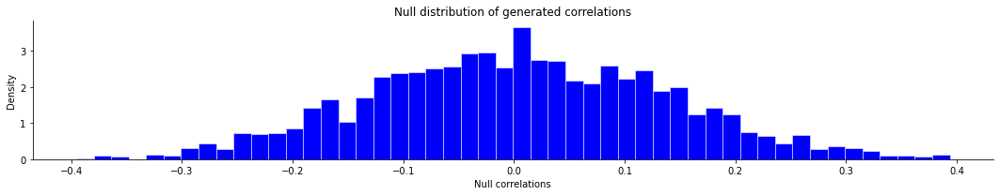

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.035


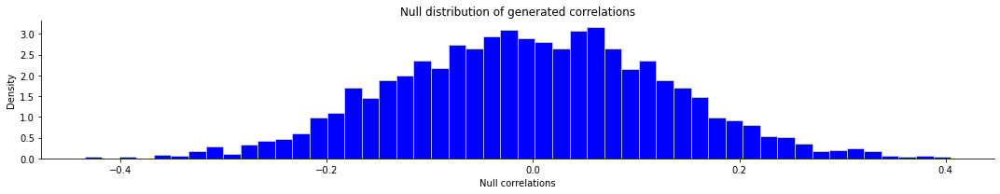

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0075


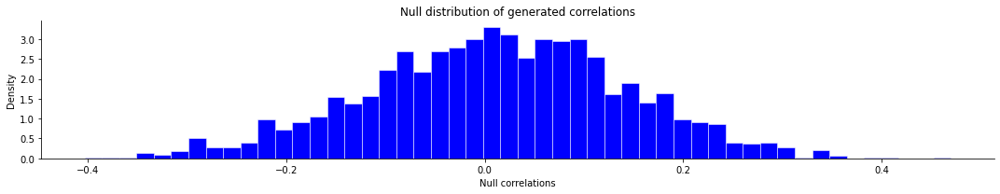

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0055


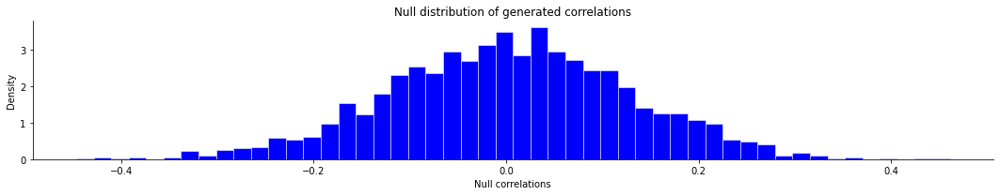

In [70]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(He_AM_G1_std_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(He_AM_G1_std_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = He_AM_G1_std_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(He_AM_G1_std_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(He_AM_G1_std_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = He_AM_G1_std_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

He_AM_G1_std_neuromaps_res = pd.DataFrame(neuromaps_res)

In [71]:
He_AM_G1_std_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,0.059634,3.072867e-16,0.3340,0.373294,False,False
1,Gene Expression,-0.404532,0.000000e+00,0.0040,0.017417,True,False
2,Glucose,-0.260078,2.294144e-287,0.0145,0.034438,True,False
3,Oxygen,-0.328990,0.000000e+00,0.0025,0.017417,True,True
4,CBF,-0.163078,7.428306e-112,0.0760,0.103143,False,False
5,Dopamine,-0.030856,2.391199e-05,0.4105,0.433306,False,False
6,Acetylcholine,0.234218,6.525804e-232,0.0305,0.052682,False,False
7,Serotonin,0.011287,1.223160e-01,0.4370,0.437000,False,False
8,Norepinephrine,0.065492,2.839006e-19,0.2765,0.328344,False,False
9,Glutamate,0.191414,3.913939e-154,0.0595,0.086962,False,False


In [267]:
He_AM_G1_std_neuromaps_res = pd.read_csv(resdir+'He_AM_G1_std_neuromaps_res.csv', index_col = 0)

#### Plot intra-individual variability results

FDR correction 

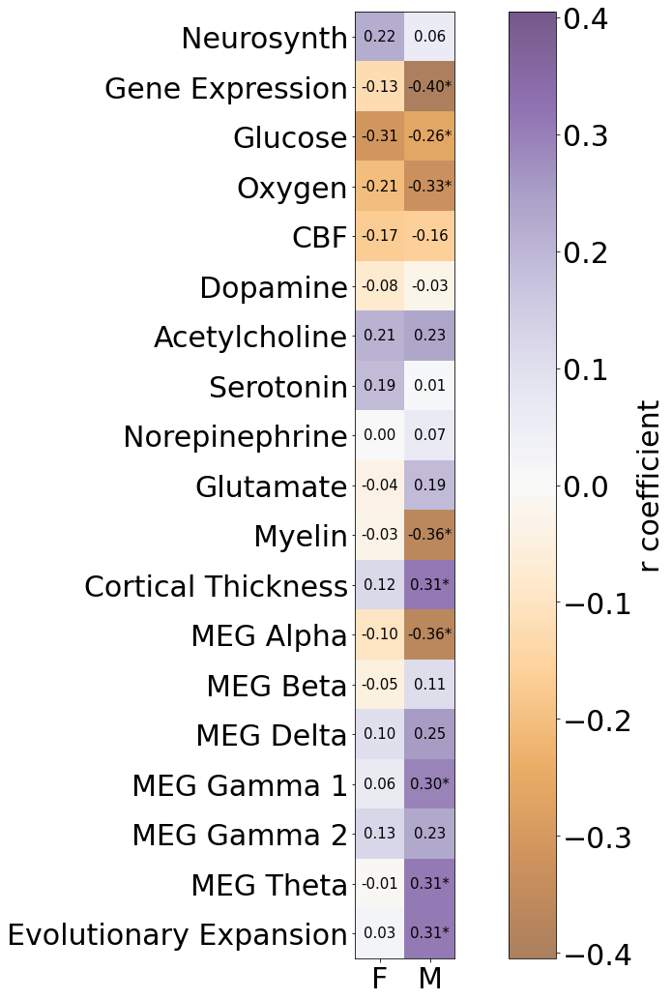

In [271]:
### shape values for plotting

r_vals_to_plot = np.stack((Me_G1_excl26_std_neuromaps_res['spearman (r)'], He_AM_G1_std_neuromaps_res['spearman (r)']), axis=1)
FDR_sig = np.stack((Me_G1_excl26_std_neuromaps_res['significance (FDR-corrected)'], He_AM_G1_std_neuromaps_res['significance (FDR-corrected)']), axis=1)


### plot

plt.figure(figsize=(20, 18))

# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
max_abs_value = np.max(np.abs(r_vals_to_plot))

plt.imshow(r_vals_to_plot, cmap='PuOr', interpolation='none', alpha=0.65, vmin=-max_abs_value, vmax=max_abs_value)

colorbar = plt.colorbar()

colorbar.ax.tick_params(labelsize=30)  # Set the font size for the color bar ticks
colorbar.set_label('r coefficient', fontsize=30)  # Set the font size for the color bar label


# Annotate the values with "*" based on the condition
for i in range(r_vals_to_plot.shape[0]):
    for j in range(r_vals_to_plot.shape[1]):
        value = r_vals_to_plot[i, j]
        annotation = f'{value:.2f}'
        if FDR_sig[i, j]:
            annotation += '*'
        plt.text(j, i, annotation, ha='center', va='center', color='k', fontsize=15)


#plt.title('Intra-individual variability correlations with Neuromaps', fontsize=30)
plt.xticks(ticks=range(r_vals_to_plot.shape[1]), labels=np.array(['F', 'M']), rotation=0,  fontsize=30)
plt.yticks(ticks=range(r_vals_to_plot.shape[0]), labels=np.array(neuromap_names), rotation=0,  fontsize=30)

plt.savefig(resdir_fig+'neuromaps_variability_male_female_FDR.png', dpi=300,  bbox_inches='tight')

plt.show()


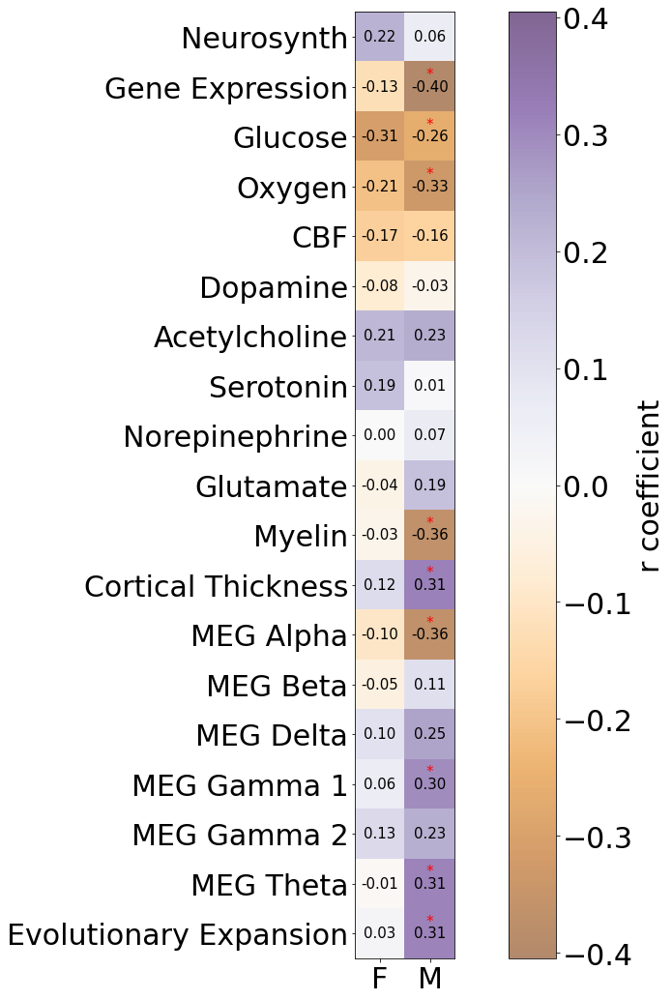

In [279]:
### shape values for plotting

r_vals_to_plot = np.stack((Me_G1_excl26_std_neuromaps_res['spearman (r)'], He_AM_G1_std_neuromaps_res['spearman (r)']), axis=1)
FDR_sig = np.stack((Me_G1_excl26_std_neuromaps_res['significance (FDR-corrected)'], He_AM_G1_std_neuromaps_res['significance (FDR-corrected)']), axis=1)


### plot

plt.figure(figsize=(20, 18))

# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
max_abs_value = np.max(np.abs(r_vals_to_plot))

plt.imshow(r_vals_to_plot, cmap='PuOr', interpolation='none', alpha=0.6, vmin=-max_abs_value, vmax=max_abs_value)

colorbar = plt.colorbar()

colorbar.ax.tick_params(labelsize=30)  # Set the font size for the color bar ticks
colorbar.set_label('r coefficient', fontsize=30)  # Set the font size for the color bar label


# Annotate the values with "*" based on the condition
for i in range(r_vals_to_plot.shape[0]):
    for j in range(r_vals_to_plot.shape[1]):
        value = r_vals_to_plot[i, j]
        annotation = f'{value:.2f}'
        
        plt.annotate(annotation, xy=(j, i), color='black', ha='center', va='center', fontsize=15)
        
        if FDR_sig[i, j]:
            plt.annotate('*', xy=(j, i - 0.25), color='red', ha='center', va='center', fontsize=15)
        
        
#plt.title('Intra-individual variability correlations with Neuromaps', fontsize=30)
plt.xticks(ticks=range(r_vals_to_plot.shape[1]), labels=np.array(['F', 'M']), rotation=0,  fontsize=30)
plt.yticks(ticks=range(r_vals_to_plot.shape[0]), labels=np.array(neuromap_names), rotation=0,  fontsize=30)

plt.savefig(resdir_fig+'neuromaps_variability_male_female_FDR.png', dpi=300,  bbox_inches='tight')

plt.show()


Bonferroni correction

#### Inter-subject differences variability

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4775


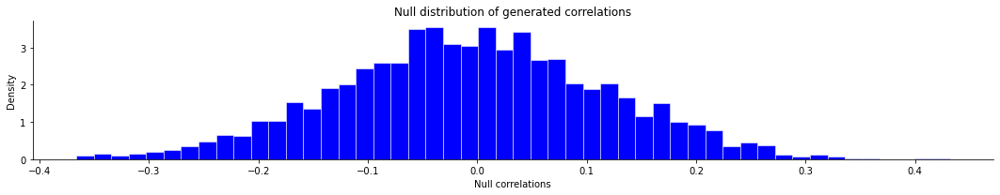

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0455


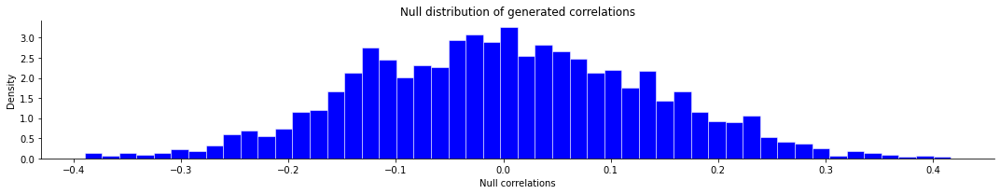

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4225


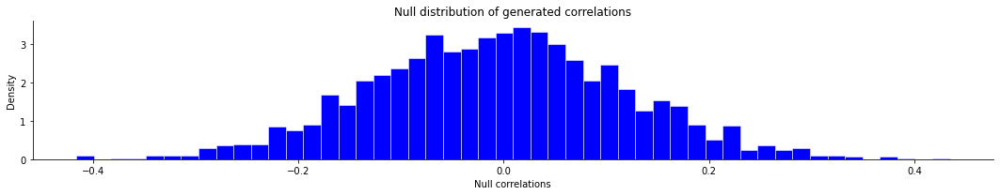

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.126


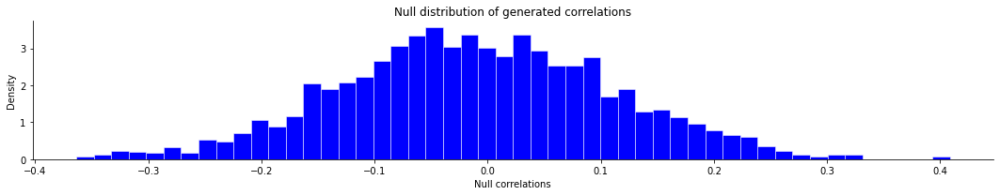

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.502


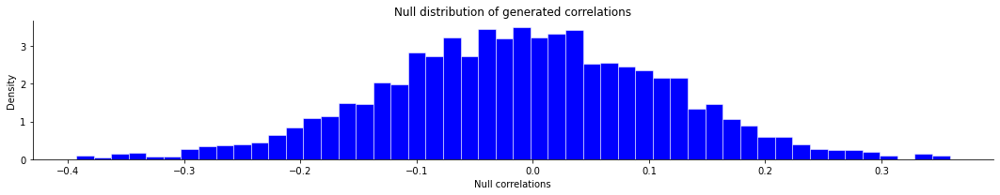

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.259


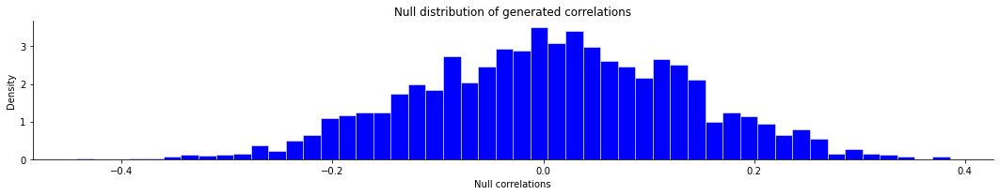

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.258


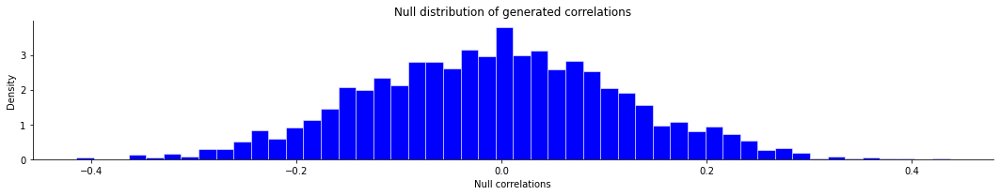

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.16599999999999998


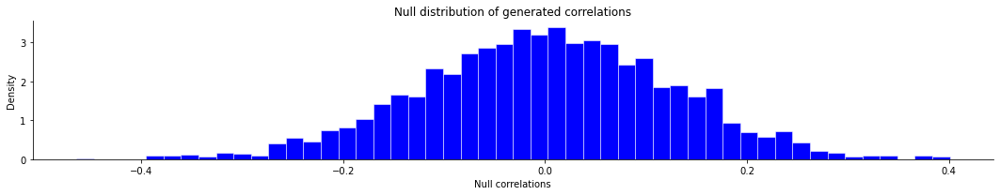

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.11549999999999999


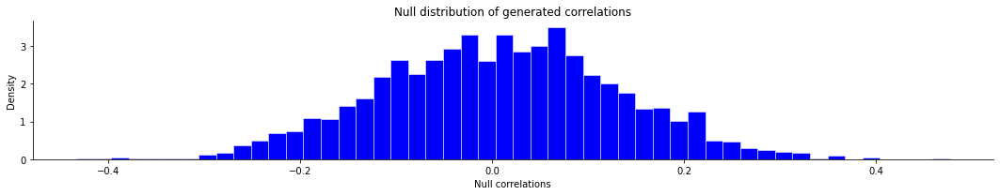

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0335


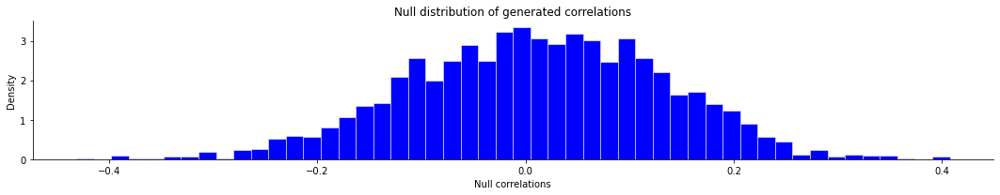

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0215


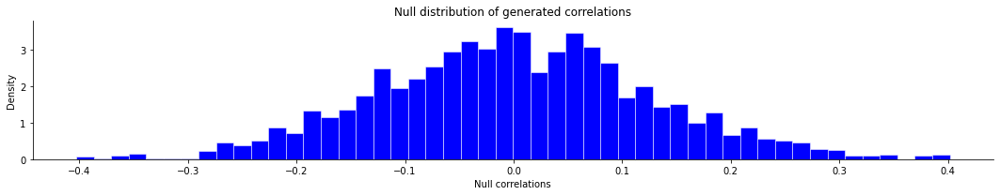

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.065


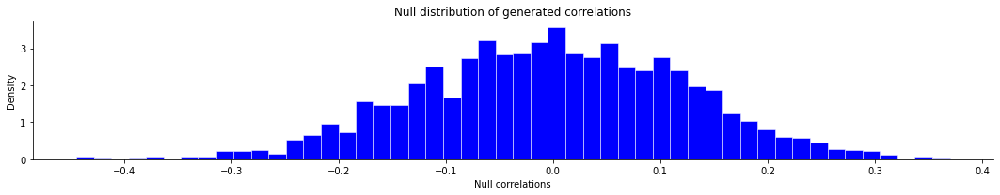

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0465


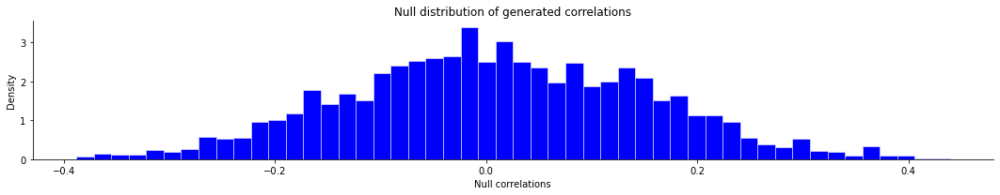

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.054


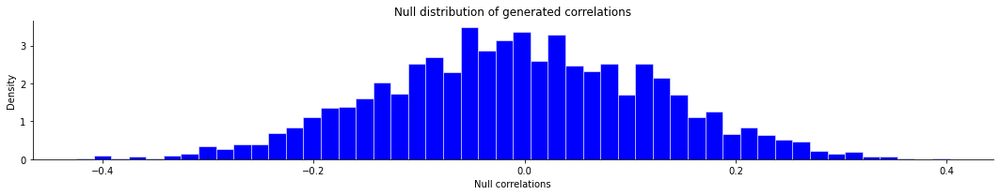

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1865


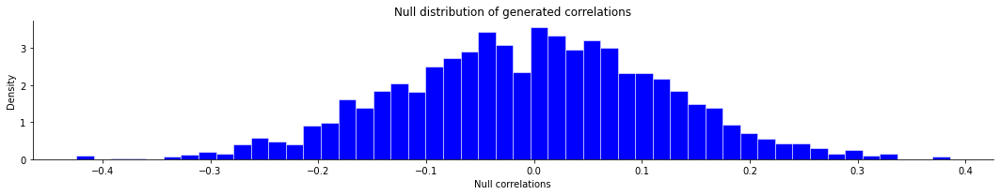

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.065


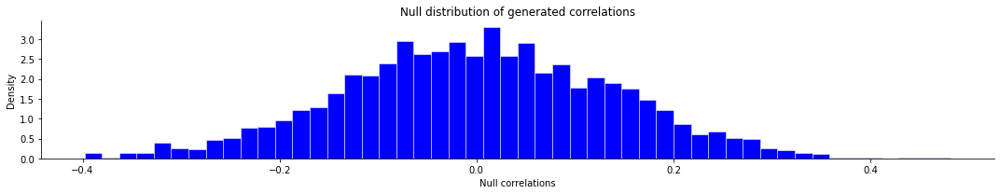

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2375


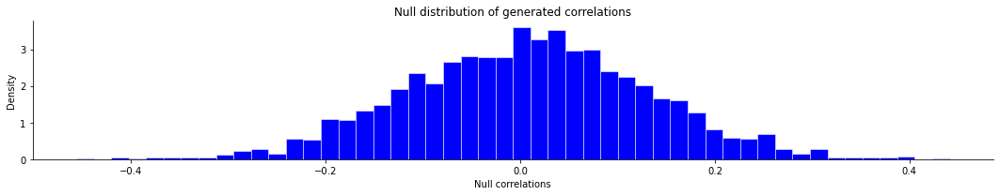

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.01


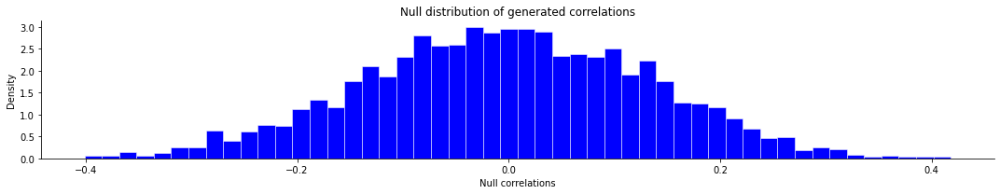

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0105


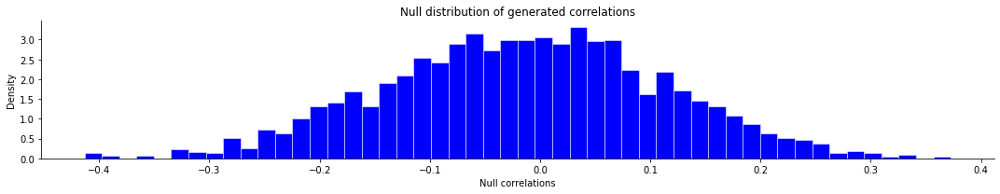

In [143]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(std_F_minus_M_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(std_F_minus_M_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = std_F_minus_M_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(std_F_minus_M_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(std_F_minus_M_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = std_F_minus_M_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

std_F_minus_M_neuromaps_res = pd.DataFrame(neuromaps_res)

In [144]:
std_F_minus_M_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,0.000765,9.166252e-01,0.4775,0.502000,False,False
1,Gene Expression,0.230470,1.687990e-220,0.0455,0.137222,False,False
2,Glucose,0.018707,1.043837e-02,0.4225,0.472206,False,False
3,Oxygen,0.128506,7.890263e-70,0.1260,0.217636,False,False
4,CBF,-0.007332,3.155294e-01,0.5020,0.502000,False,False
5,Dopamine,-0.076252,1.414854e-25,0.2590,0.307563,False,False
6,Acetylcholine,-0.089786,7.472675e-35,0.2580,0.307563,False,False
7,Serotonin,0.122748,7.914315e-64,0.1660,0.262833,False,False
8,Norepinephrine,-0.142528,1.253739e-85,0.1155,0.217636,False,False
9,Glutamate,-0.214819,1.528922e-194,0.0335,0.137222,False,False


#### Estradiol local effects Female

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0805


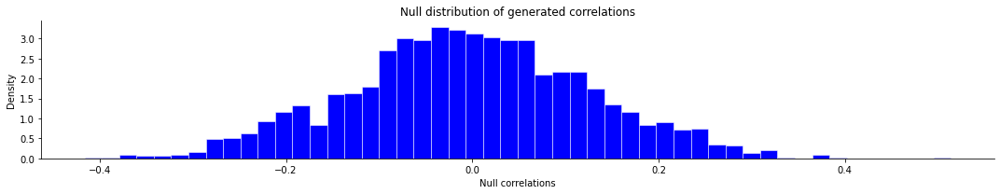

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


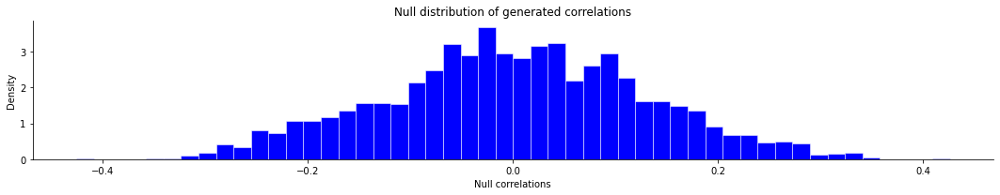

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.020999999999999998


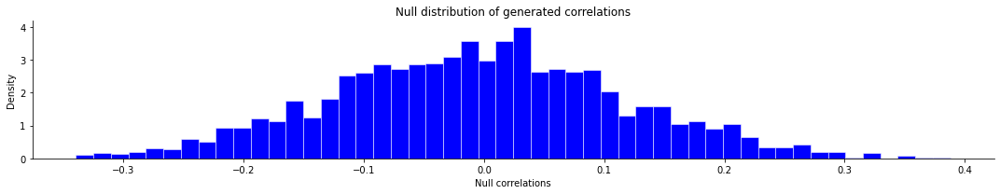

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0125


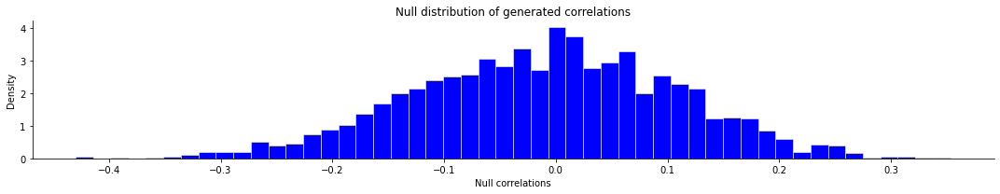

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.182


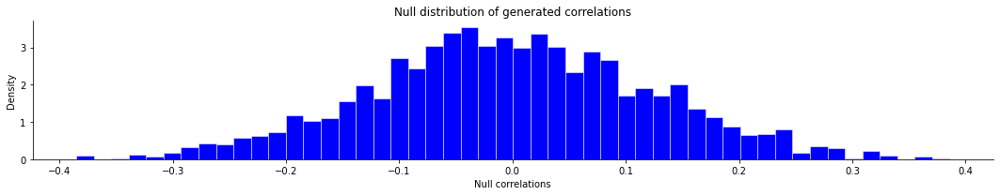

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.264


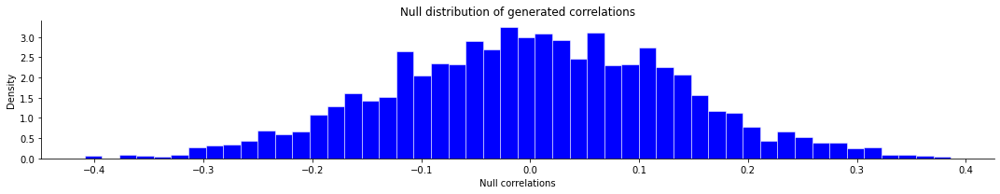

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.149


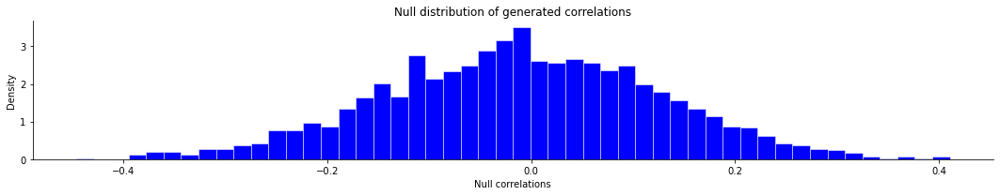

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2555


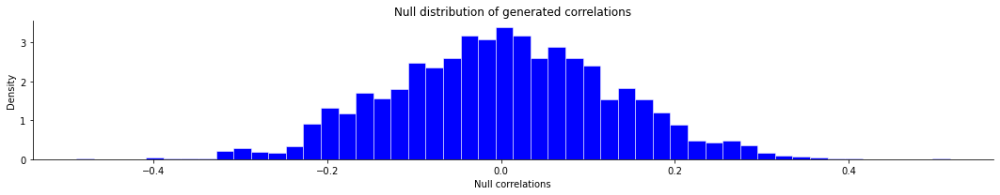

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3095


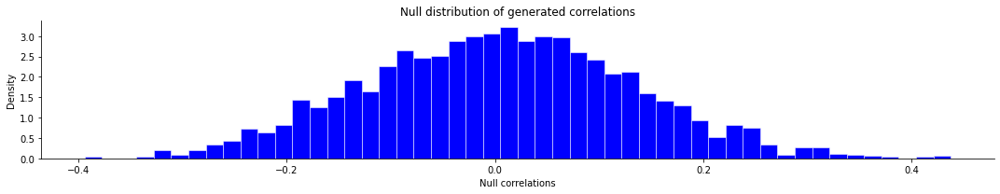

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.013


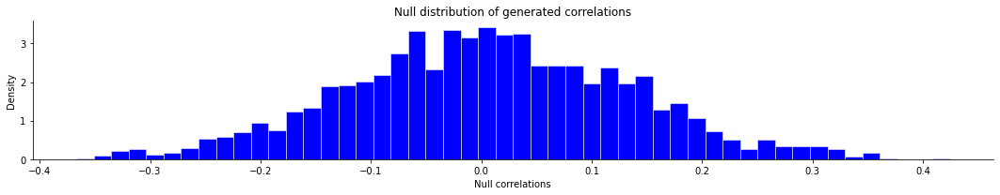

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


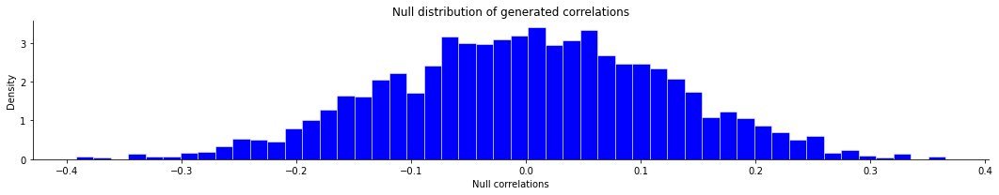

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.013999999999999999


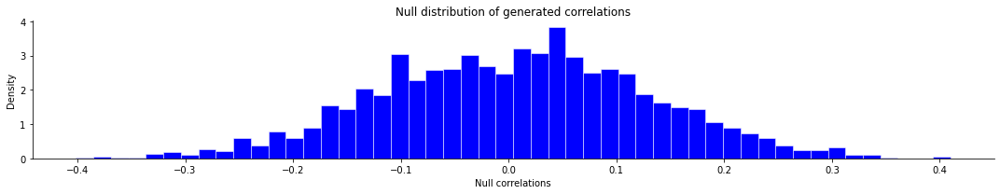

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.04


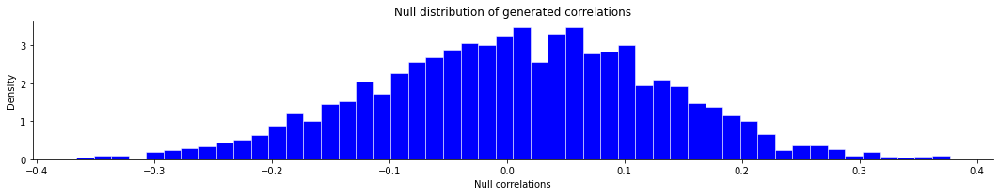

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.213


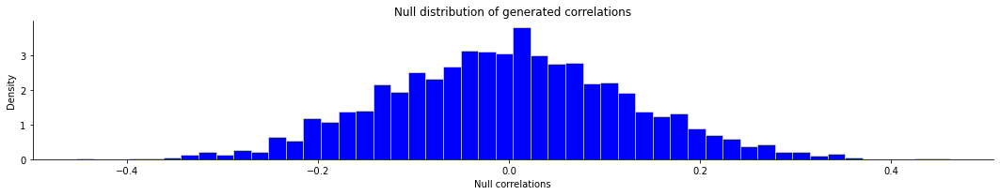

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0235


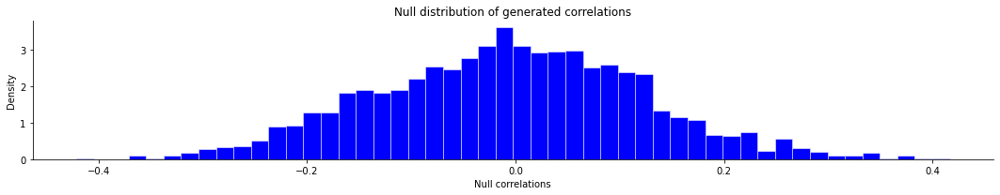

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.115


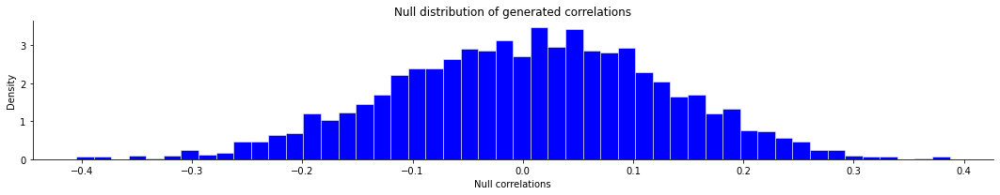

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0315


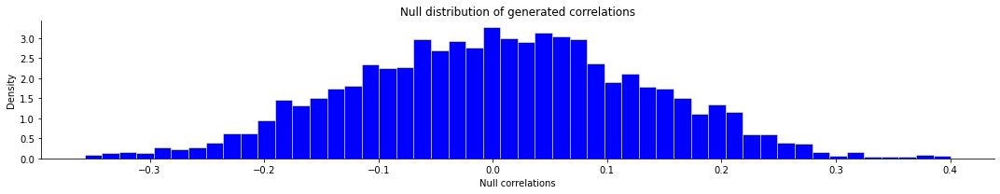

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.08049999999999999


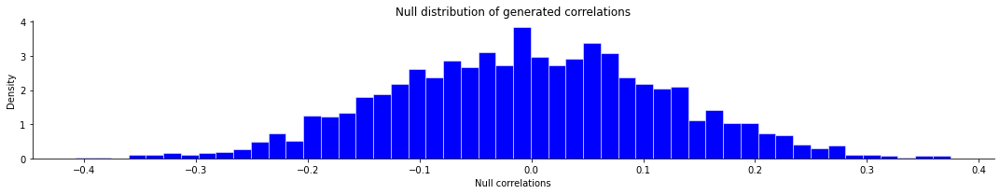

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.068


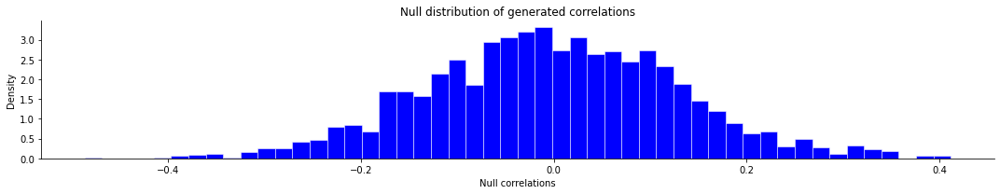

In [145]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(estradiol_t_val_excl26_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(estradiol_t_val_excl26_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = estradiol_t_val_excl26_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(estradiol_t_val_excl26_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(estradiol_t_val_excl26_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = estradiol_t_val_excl26_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

estradiol_t_val_excl26_neuromaps_res = pd.DataFrame(neuromaps_res)

In [146]:
estradiol_t_val_excl26_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,0.180667,2.976153e-137,0.0805,0.127458,False,False
1,Gene Expression,0.351817,0.000000e+00,0.0010,0.009500,True,True
2,Glucose,0.246347,4.178176e-257,0.0210,0.063786,False,False
3,Oxygen,0.240423,1.270086e-244,0.0125,0.053200,False,False
4,CBF,0.112527,7.232242e-54,0.1820,0.230533,False,False
5,Dopamine,0.088678,4.894024e-34,0.2640,0.278667,False,False
6,Acetylcholine,-0.152621,4.757050e-98,0.1490,0.202214,False,False
7,Serotonin,-0.082473,1.185194e-29,0.2555,0.278667,False,False
8,Norepinephrine,0.067451,2.378359e-20,0.3095,0.309500,False,False
9,Glutamate,-0.274677,0.000000e+00,0.0130,0.053200,False,False


#### Progesterone local effects Female

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


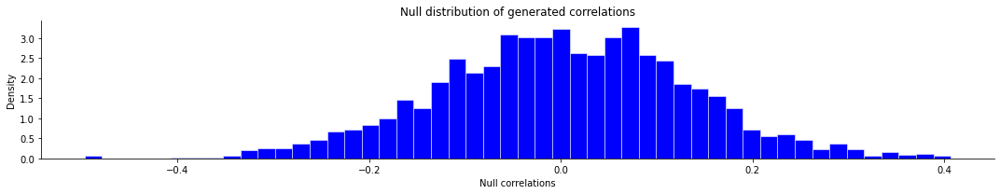

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.195


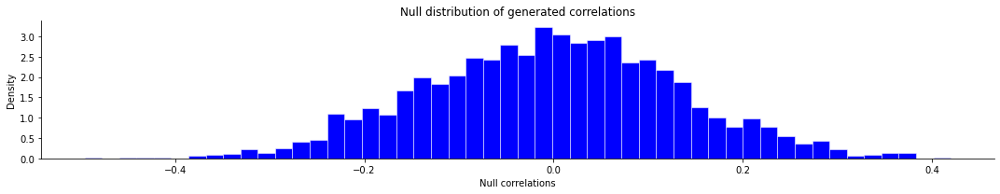

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.245


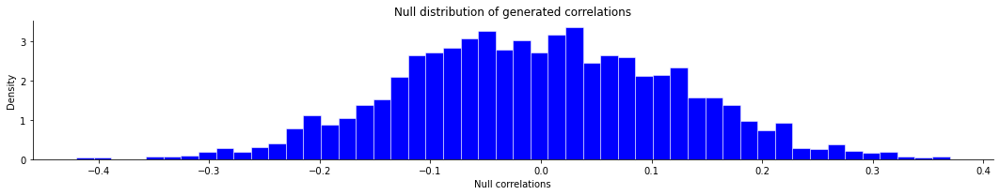

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.217


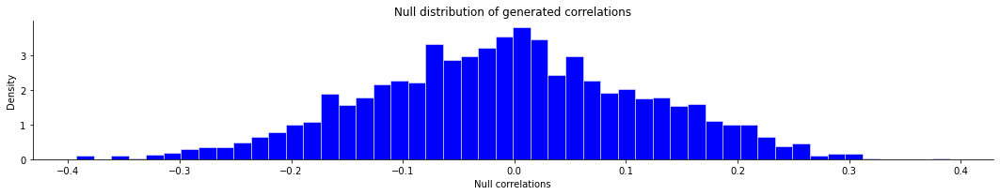

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.07


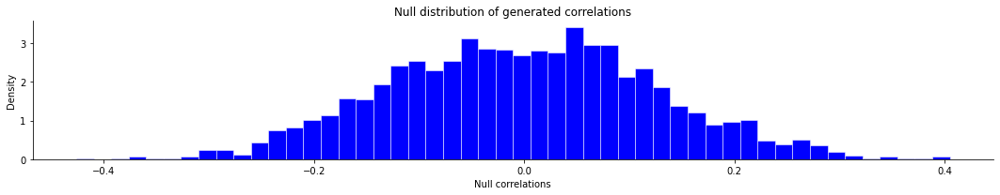

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0755


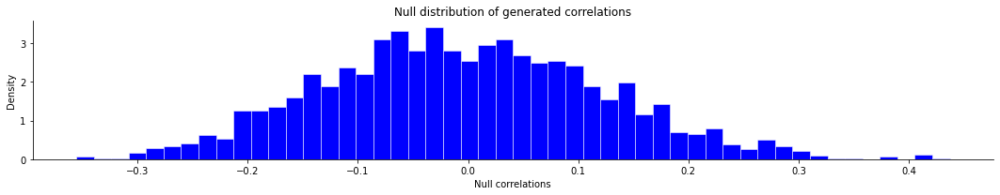

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.156


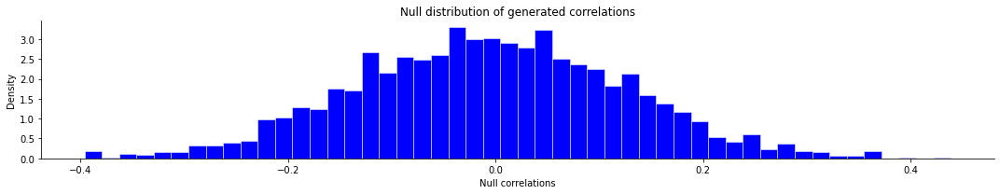

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3675


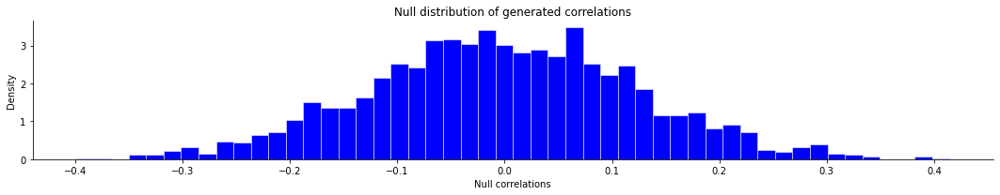

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


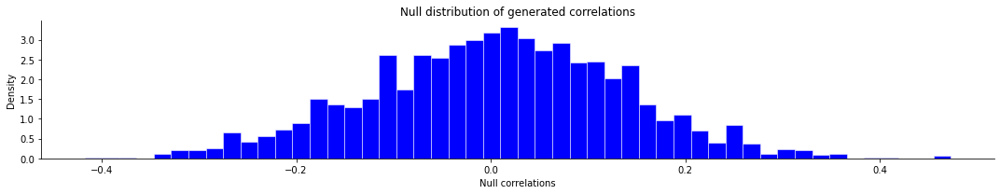

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.34099999999999997


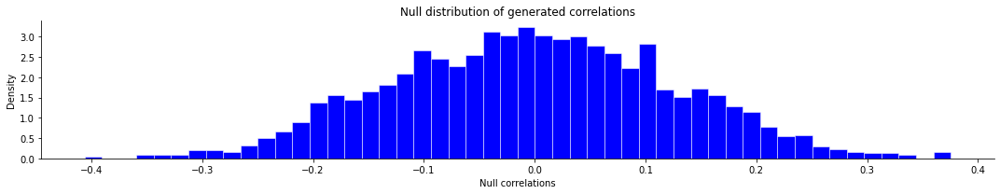

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.228


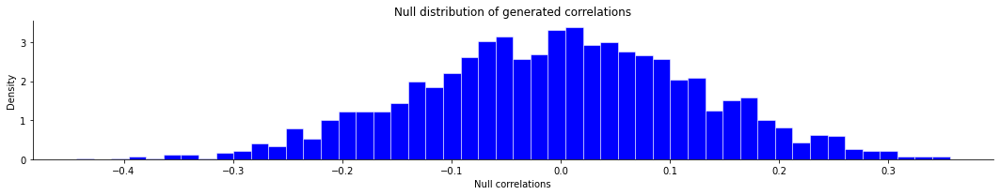

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.092


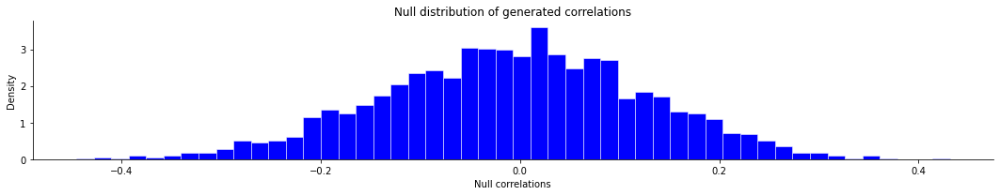

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3215


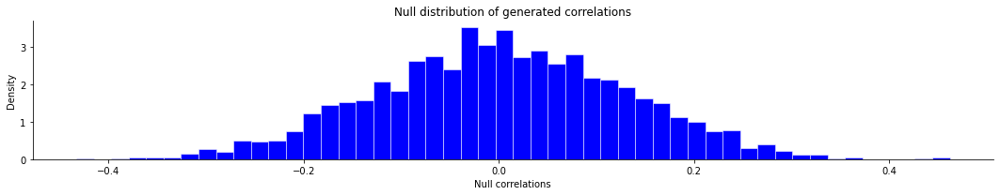

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


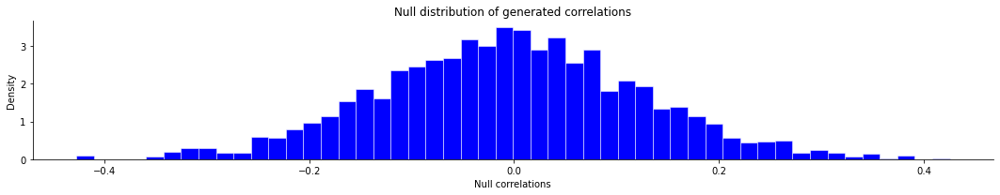

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1385


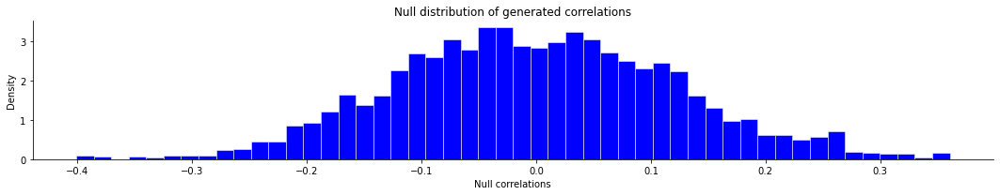

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2105


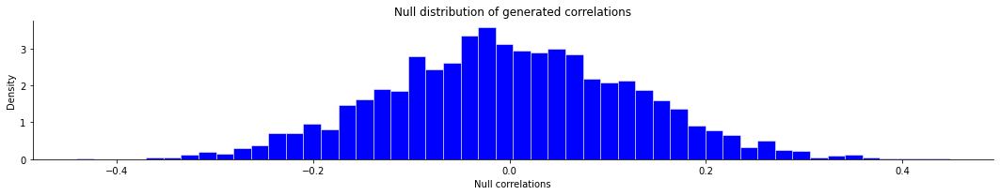

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.124


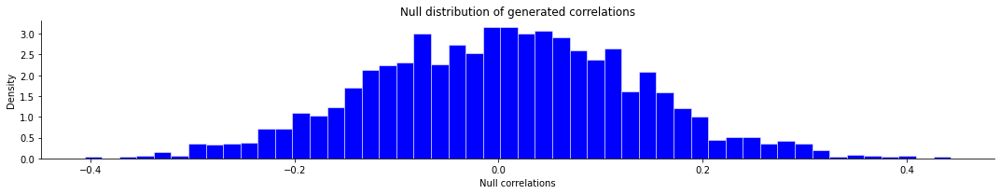

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.048


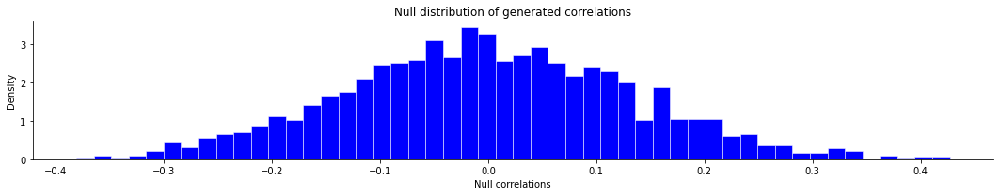

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.244


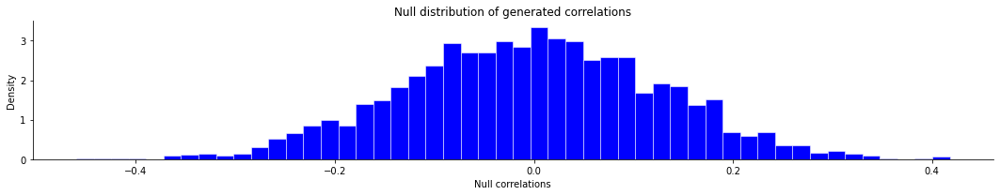

In [147]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(progesterone_t_val_excl26_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(progesterone_t_val_excl26_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = progesterone_t_val_excl26_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(progesterone_t_val_excl26_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(progesterone_t_val_excl26_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = progesterone_t_val_excl26_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

progesterone_t_val_excl26_neuromaps_res = pd.DataFrame(neuromaps_res)

In [148]:
progesterone_t_val_excl26_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,-0.531662,0.000000e+00,0.0000,0.000000,True,True
1,Gene Expression,-0.118864,6.480335e-59,0.1950,0.290938,False,False
2,Glucose,-0.090946,1.017863e-35,0.2450,0.290938,False,False
3,Oxygen,-0.102814,3.225424e-45,0.2170,0.290938,False,False
4,CBF,-0.189251,1.188406e-150,0.0700,0.239083,False,False
5,Dopamine,-0.184835,1.122139e-143,0.0755,0.239083,False,False
6,Acetylcholine,-0.137710,5.213127e-80,0.1560,0.290938,False,False
7,Serotonin,0.041016,1.943250e-08,0.3675,0.367500,False,False
8,Norepinephrine,-0.382661,0.000000e+00,0.0010,0.006333,True,True
9,Glutamate,0.050113,6.686376e-12,0.3410,0.359944,False,False


#### Stress local effects Female

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.003


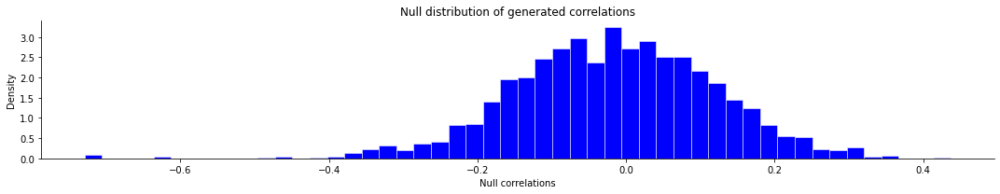

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.078


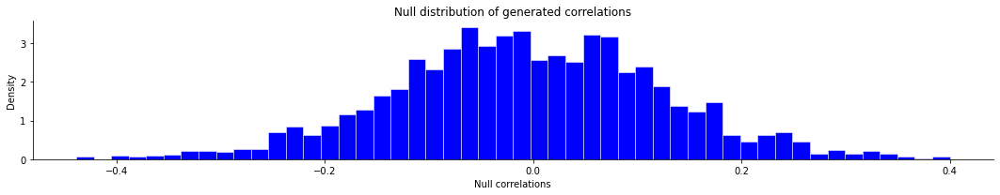

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1095


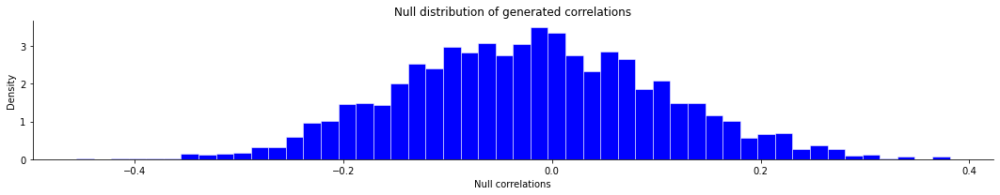

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.481


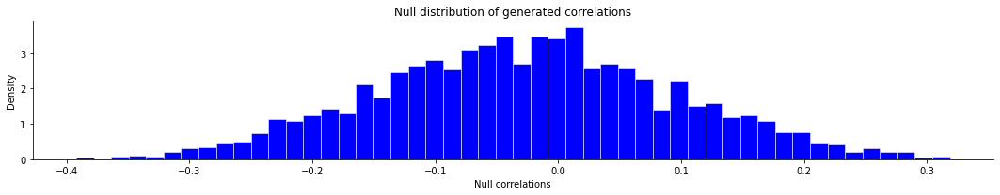

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2855


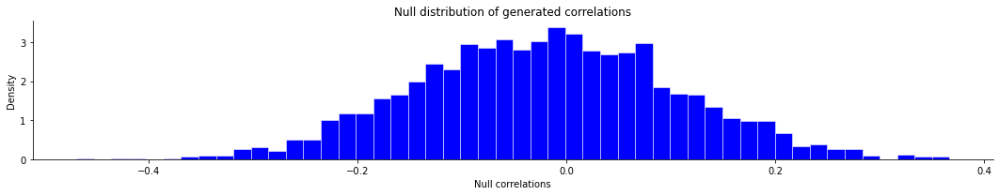

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3185


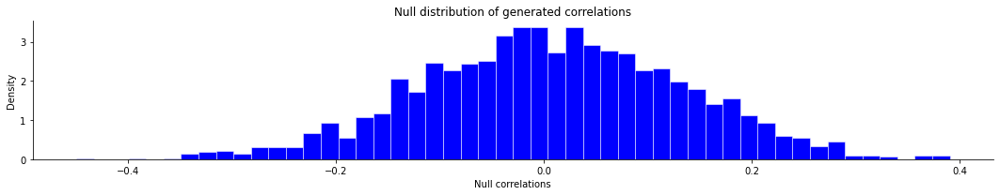

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.07300000000000001


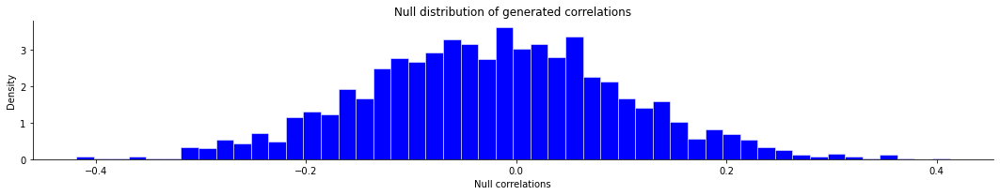

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.039


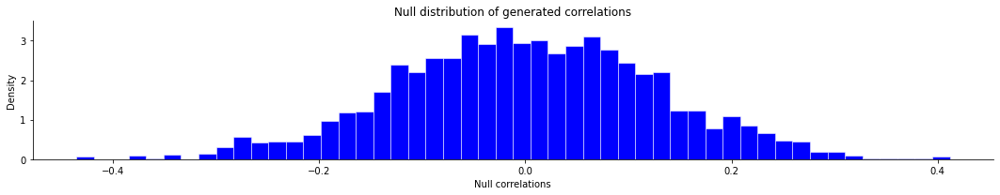

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.005


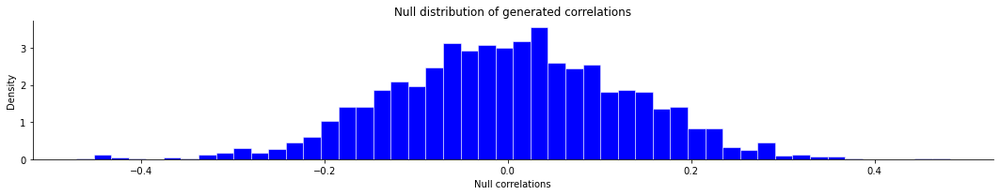

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.364


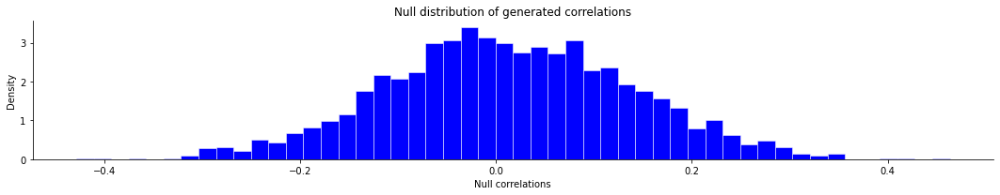

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.053


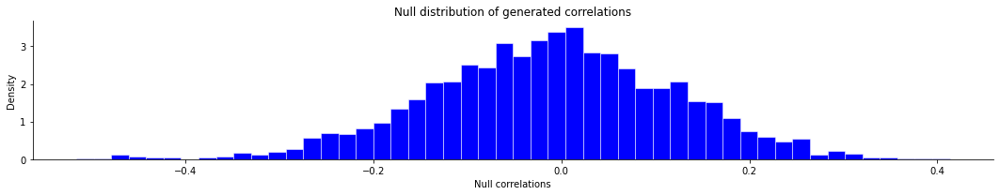

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.39049999999999996


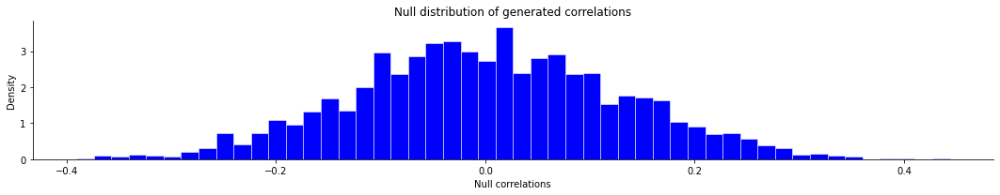

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.417


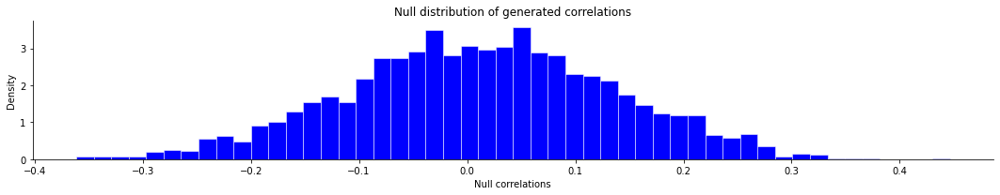

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.03


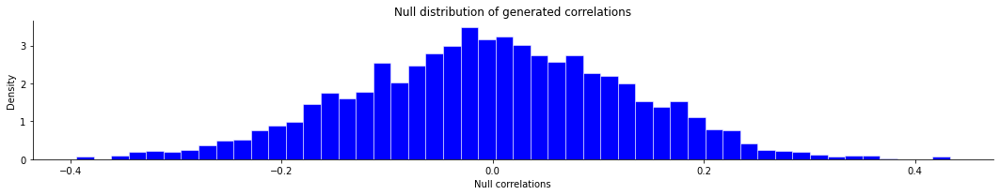

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3


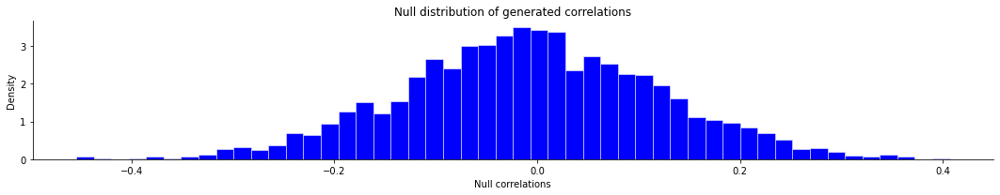

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3665


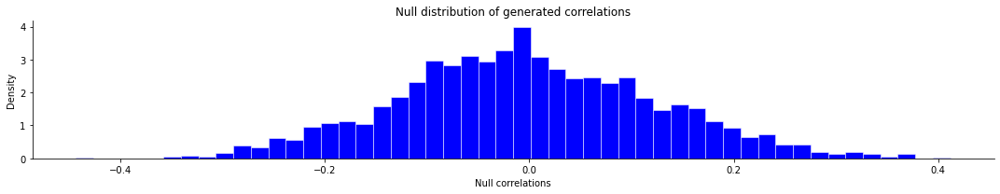

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2885


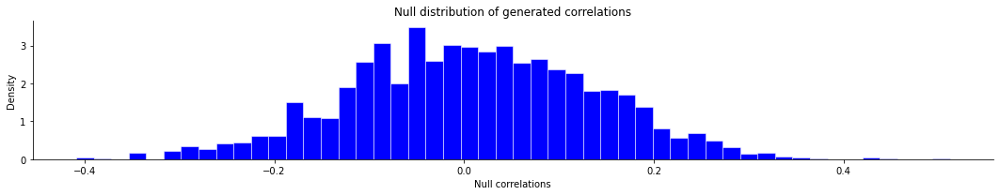

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1195


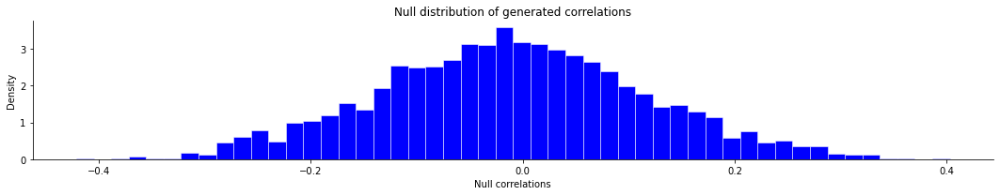

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2455


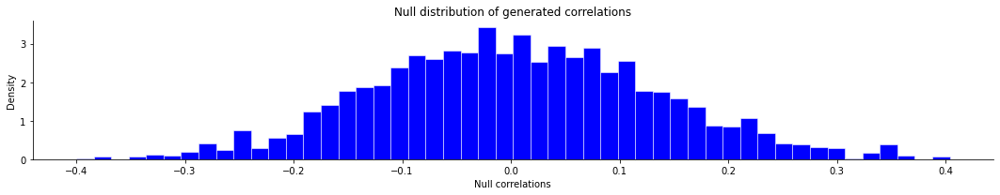

In [149]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(Me_PSS_t_val_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(Me_PSS_t_val_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = Me_PSS_t_val_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(Me_PSS_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(Me_PSS_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = Me_PSS_t_val_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

Me_PSS_t_val_neuromaps_res = pd.DataFrame(neuromaps_res)

In [150]:
Me_PSS_t_val_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,-0.548326,0.000000e+00,0.0030,0.047500,True,False
1,Gene Expression,-0.183547,3.242835e-139,0.0780,0.211714,False,False
2,Glucose,0.132554,3.230117e-74,0.1095,0.252278,False,False
3,Oxygen,-0.034297,2.649534e-06,0.4810,0.481000,False,False
4,CBF,-0.090869,1.163409e-35,0.2855,0.432250,False,False
5,Dopamine,-0.050692,3.820140e-12,0.3185,0.432250,False,False
6,Acetylcholine,-0.198244,2.095591e-165,0.0730,0.211714,False,False
7,Serotonin,-0.224085,6.020952e-212,0.0390,0.185250,False,False
8,Norepinephrine,-0.368962,0.000000e+00,0.0050,0.047500,True,False
9,Glutamate,0.058072,1.774779e-15,0.3640,0.435219,False,False


#### Testosterone local effects Male

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0005


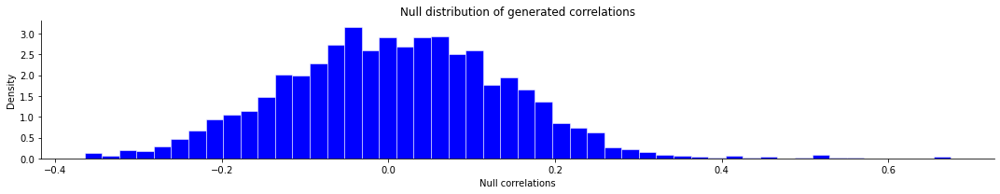

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.006500000000000001


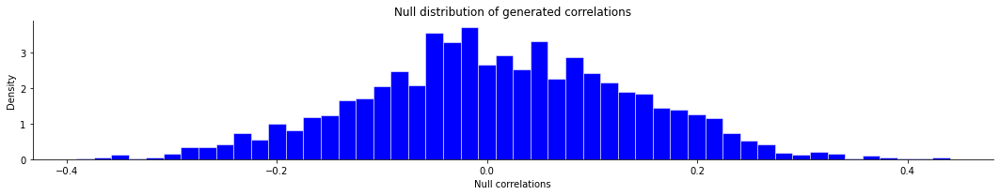

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1295


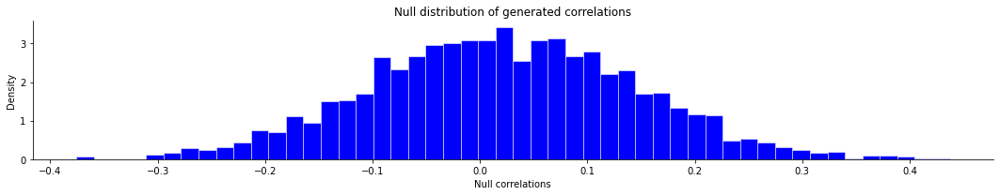

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.351


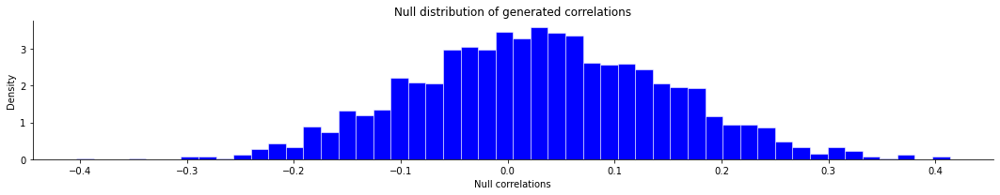

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.349


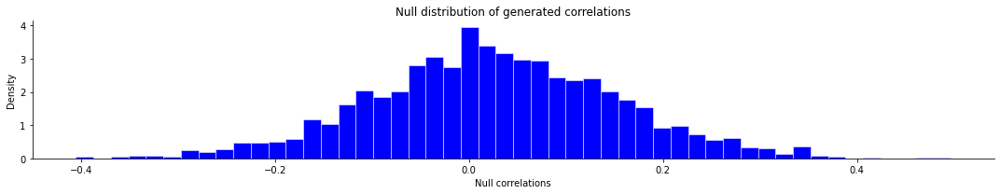

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.118


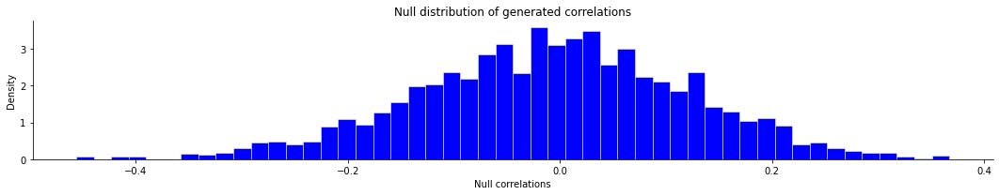

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2685


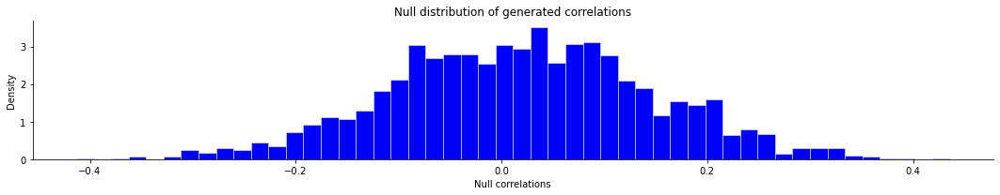

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.2025


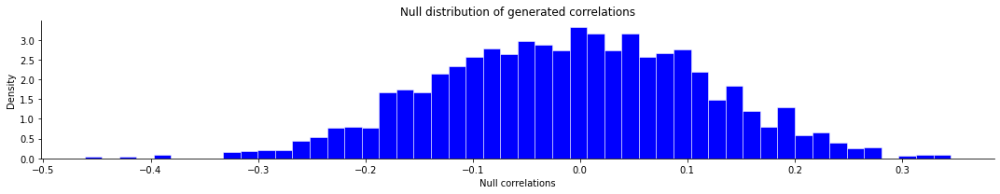

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


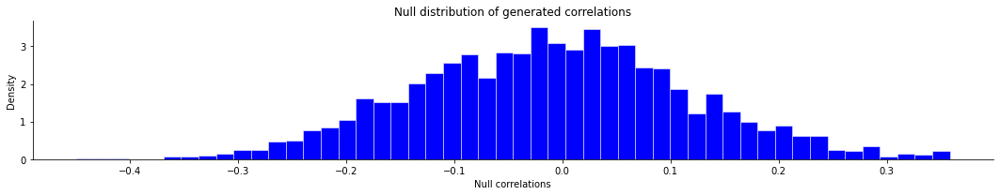

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.096


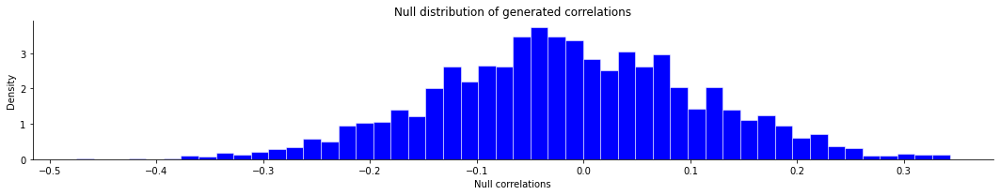

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0045000000000000005


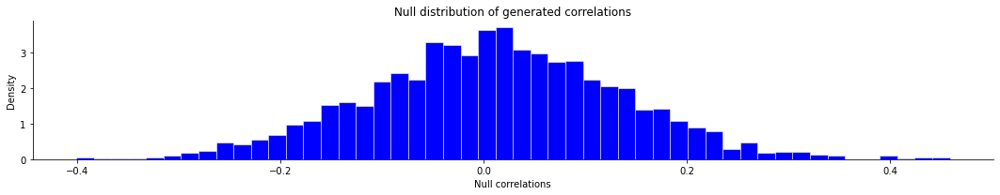

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.08399999999999999


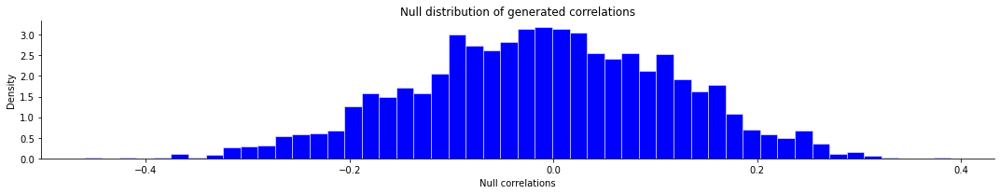

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0925


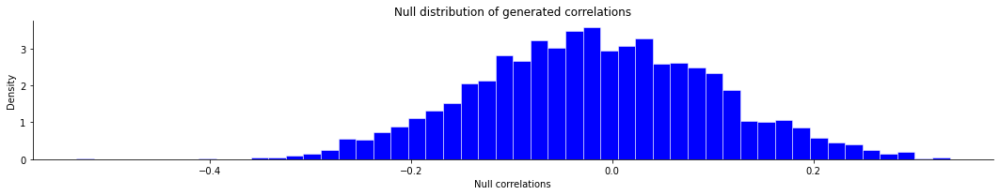

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.005


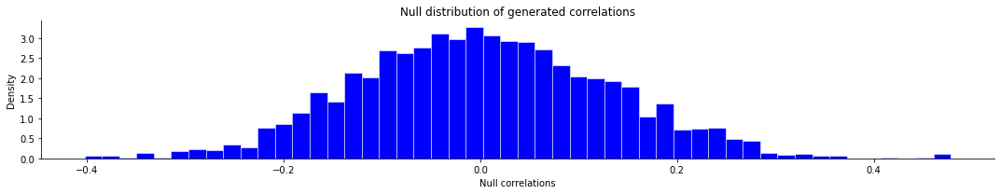

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0115


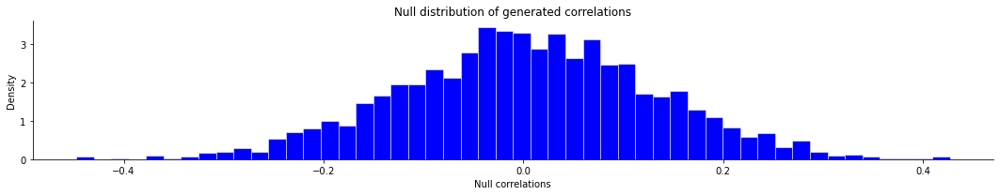

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.265


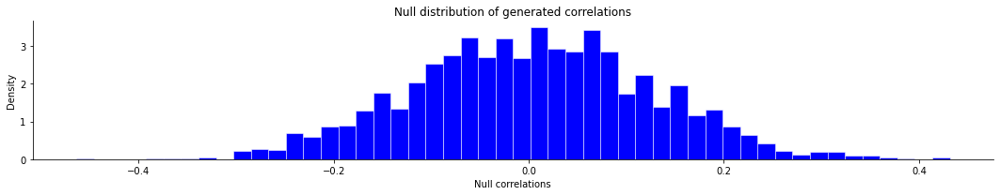

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0095


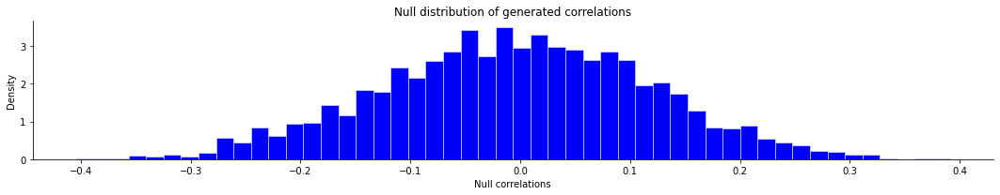

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4355


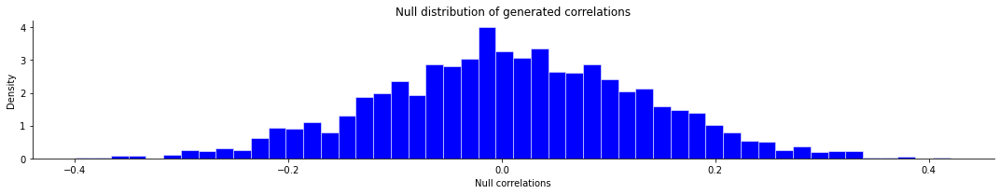

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.158


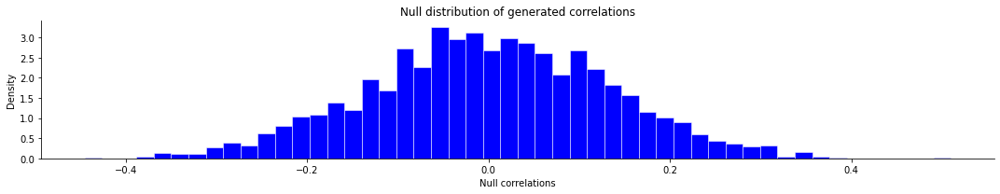

In [151]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(testosterone_t_val_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(testosterone_t_val_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = testosterone_t_val_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(testosterone_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(testosterone_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = testosterone_t_val_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

testosterone_t_val_neuromaps_res = pd.DataFrame(neuromaps_res)

In [152]:
testosterone_t_val_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,0.673672,0.000000e+00,0.0005,0.004750,True,True
1,Gene Expression,0.335295,0.000000e+00,0.0065,0.024700,True,False
2,Glucose,-0.117779,7.104578e-59,0.1295,0.205042,False,False
3,Oxygen,0.072819,1.839613e-23,0.3510,0.370500,False,False
4,CBF,-0.022571,2.000412e-03,0.3490,0.370500,False,False
5,Dopamine,0.143525,8.148512e-87,0.1180,0.203818,False,False
6,Acetylcholine,0.096218,8.562514e-40,0.2685,0.318844,False,False
7,Serotonin,0.095402,3.791402e-39,0.2025,0.274821,False,False
8,Norepinephrine,0.390699,0.000000e+00,0.0000,0.000000,True,True
9,Glutamate,-0.176101,2.143808e-130,0.0960,0.182400,False,False


#### Cortisol local effects Male

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0175


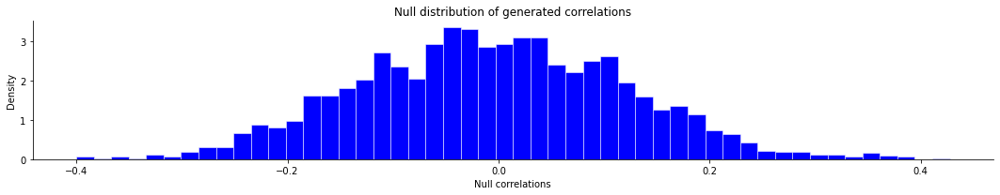

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


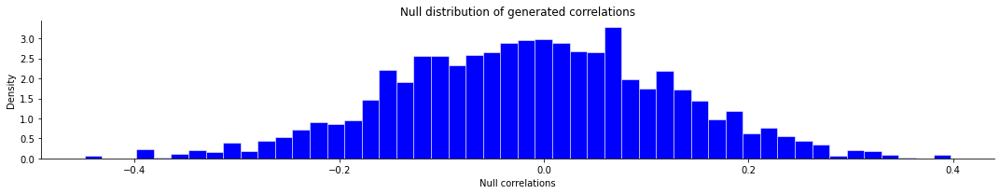

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.354


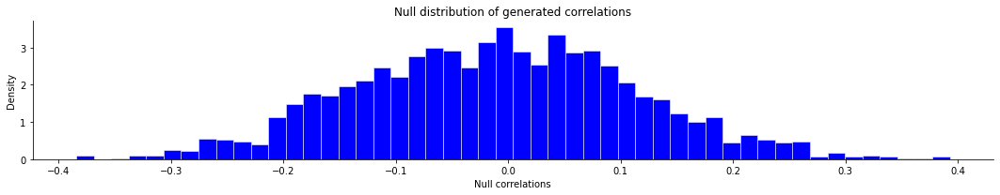

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.076


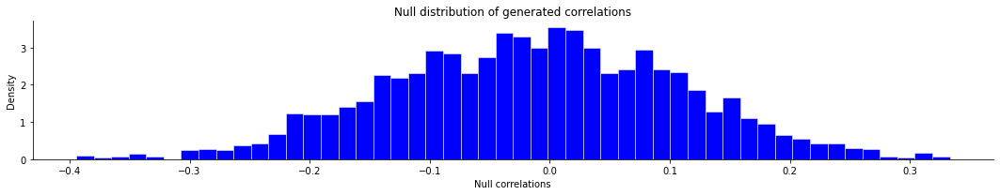

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.173


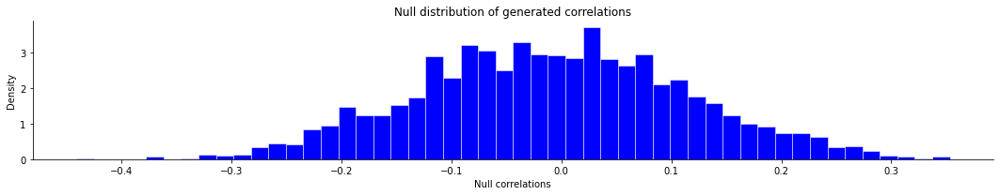

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3775


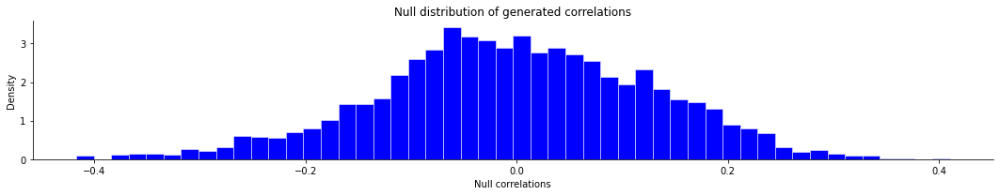

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0035


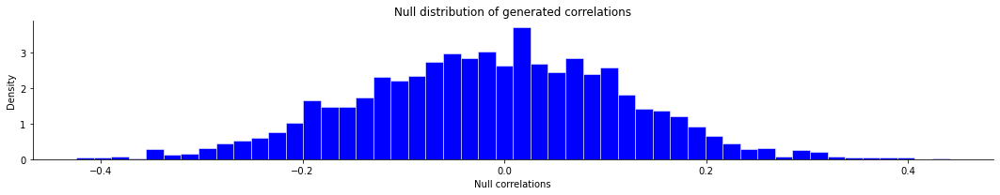

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1765


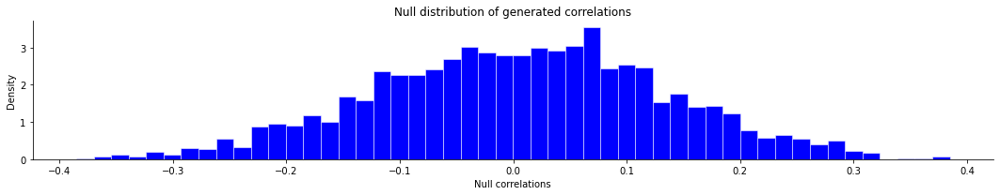

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4945


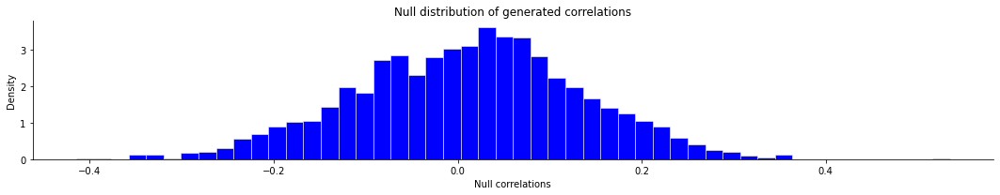

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.002


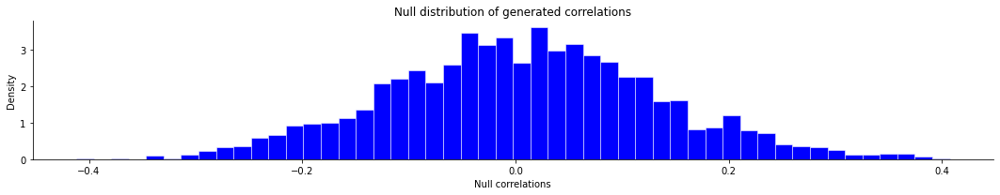

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


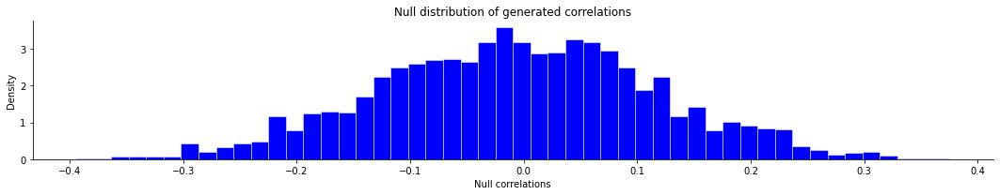

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


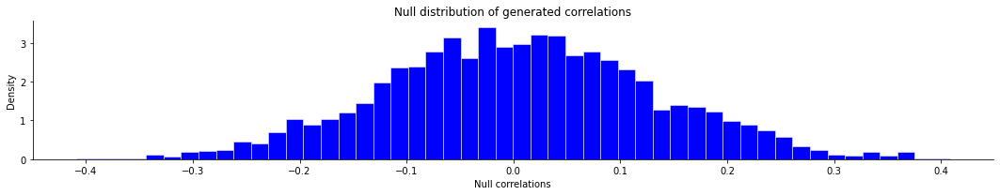

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


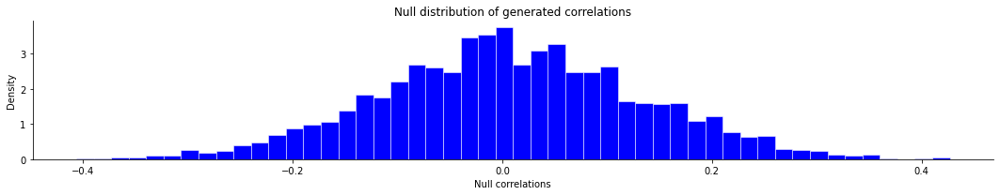

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.355


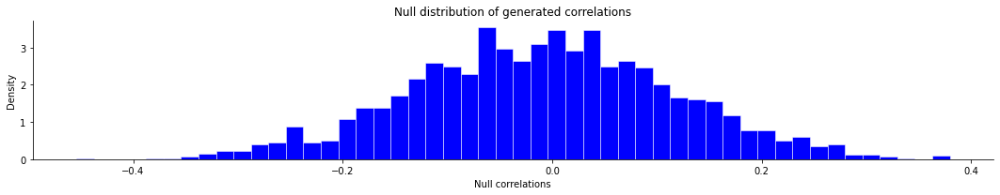

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0


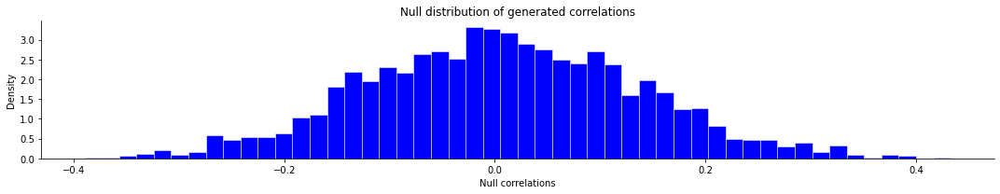

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0005


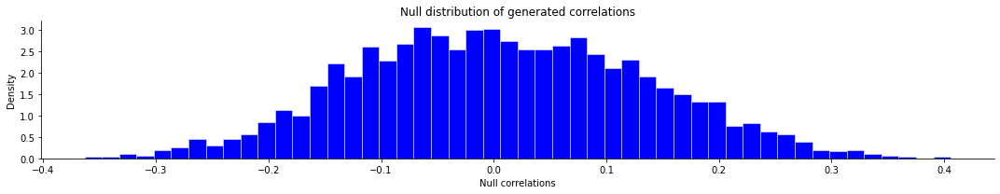

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0015


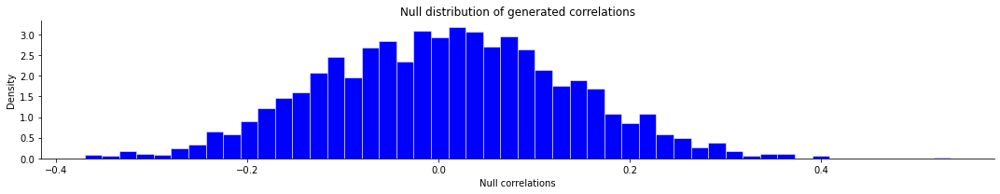

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0025


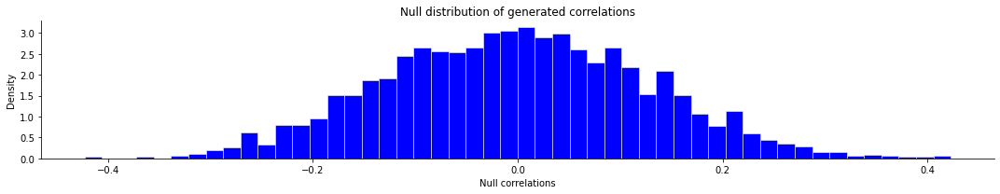

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.023


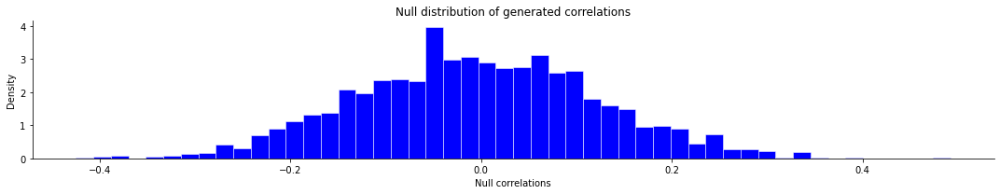

In [153]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(cortisol_t_val_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(cortisol_t_val_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = cortisol_t_val_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(cortisol_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(cortisol_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = cortisol_t_val_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

cortisol_t_val_neuromaps_res = pd.DataFrame(neuromaps_res)

In [154]:
cortisol_t_val_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,-0.261269,4.448104e-290,0.0175,0.030227,True,False
1,Gene Expression,-0.496583,0.000000e+00,0.0000,0.000000,True,True
2,Glucose,-0.060355,1.345795e-16,0.3540,0.396765,False,False
3,Oxygen,-0.186243,6.995926e-146,0.0760,0.111077,False,False
4,CBF,0.106624,1.623751e-48,0.1730,0.223567,False,False
5,Dopamine,-0.044005,1.673483e-09,0.3775,0.398472,False,False
6,Acetylcholine,0.365459,0.000000e+00,0.0035,0.006650,True,False
7,Serotonin,0.121925,5.416428e-63,0.1765,0.223567,False,False
8,Norepinephrine,0.018774,1.016463e-02,0.4945,0.494500,False,False
9,Glutamate,0.366205,0.000000e+00,0.0020,0.004750,True,True


#### Stress local effects Male

------------ Neurosynth ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3015


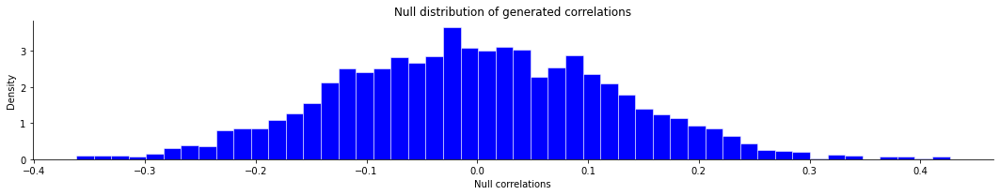

------------ Gene Expression ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.006


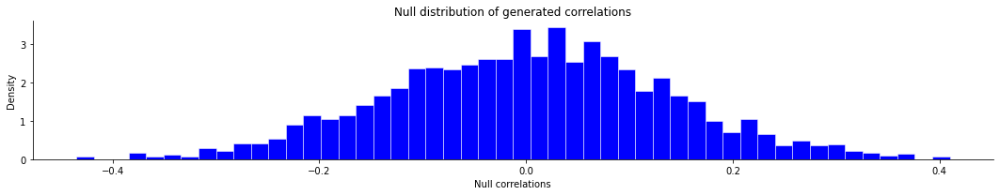

------------ Glucose ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1795


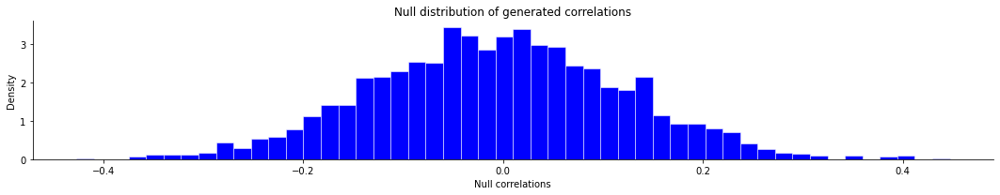

------------ Oxygen ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0275


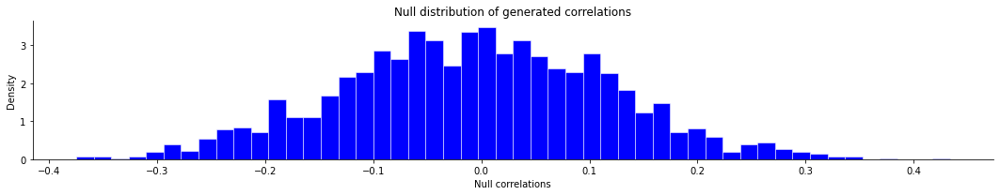

------------ CBF ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.094


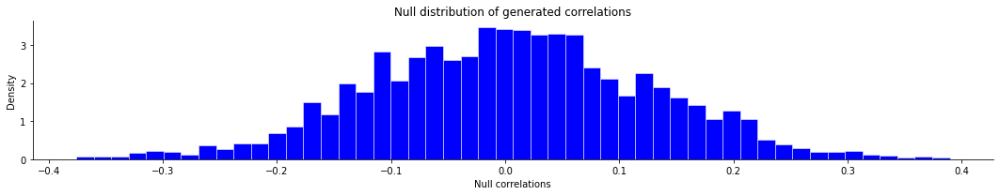

------------ Dopamine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.299


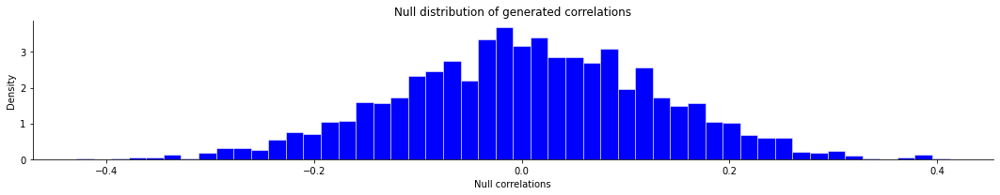

------------ Acetylcholine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.4895


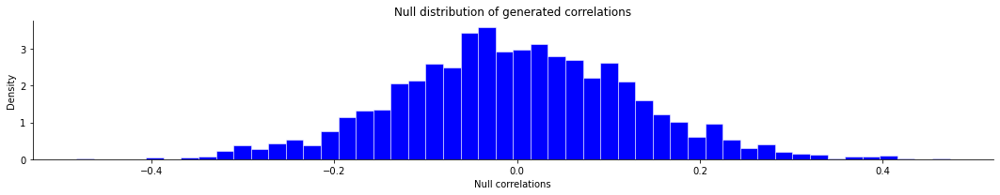

------------ Serotonin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.11099999999999999


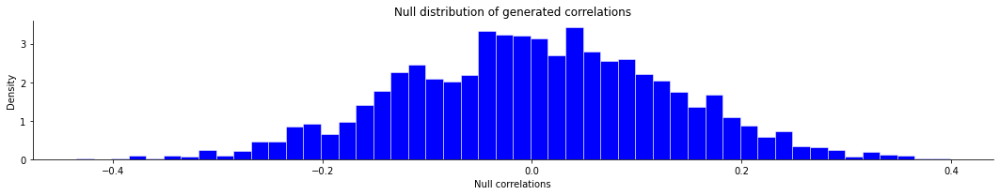

------------ Norepinephrine ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.224


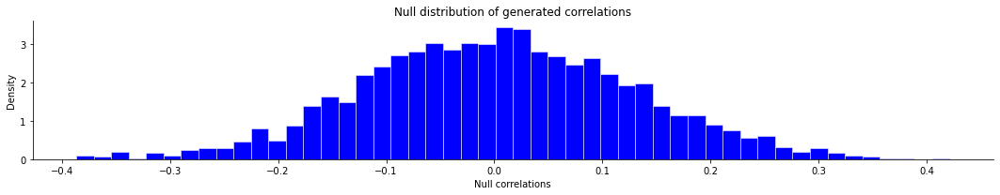

------------ Glutamate ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.324


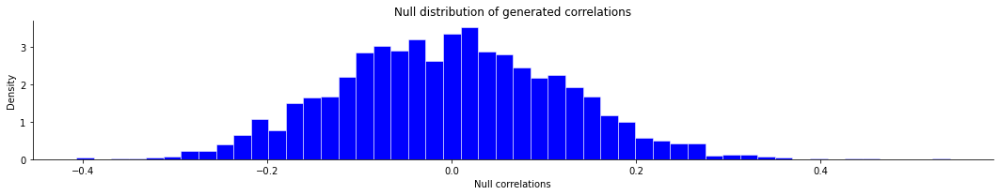

------------ Myelin ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.002


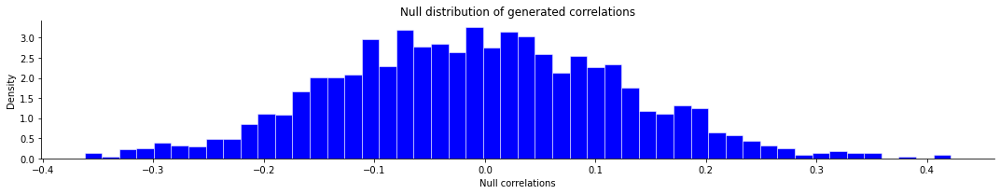

------------ Cortical Thickness ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.152


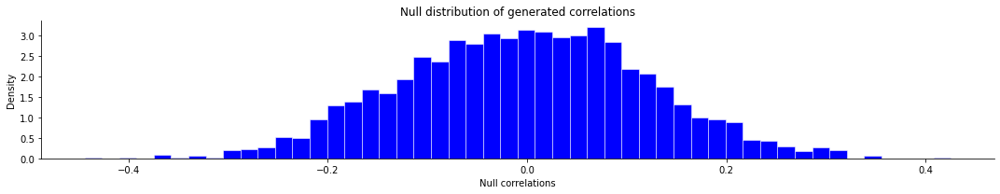

------------ MEG Alpha ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0225


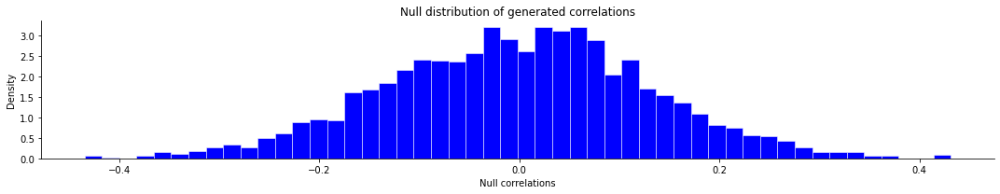

------------ MEG Beta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1105


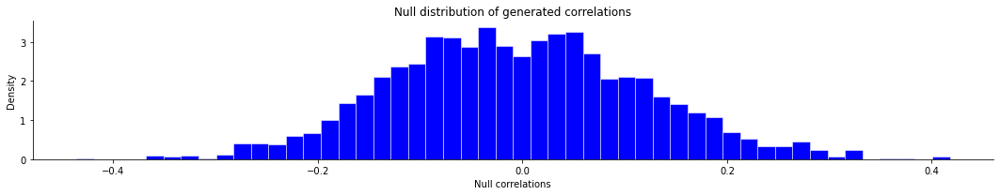

------------ MEG Delta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1085


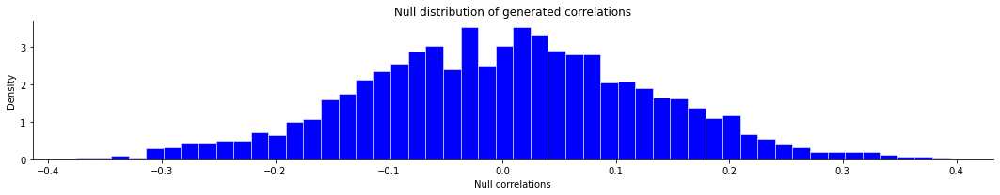

------------ MEG Gamma 1 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.025


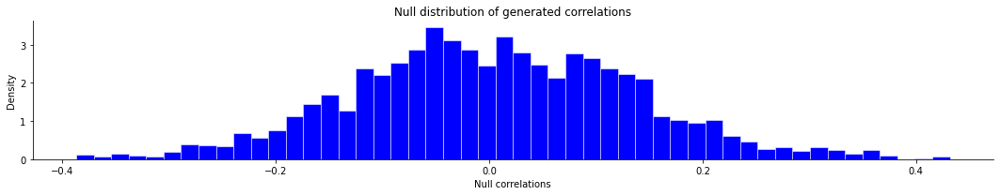

------------ MEG Gamma 2 ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.11699999999999999


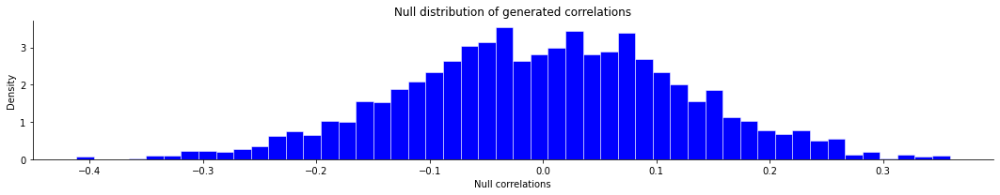

------------ MEG Theta ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.043


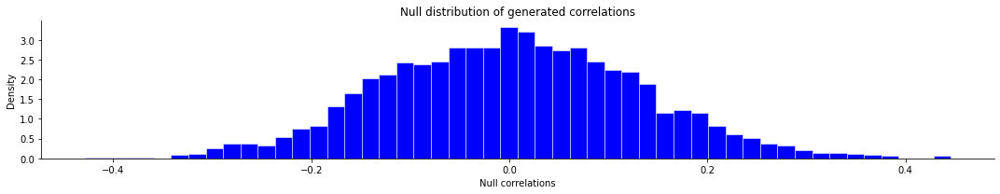

------------ Evolutionary Expansion ------------

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.003


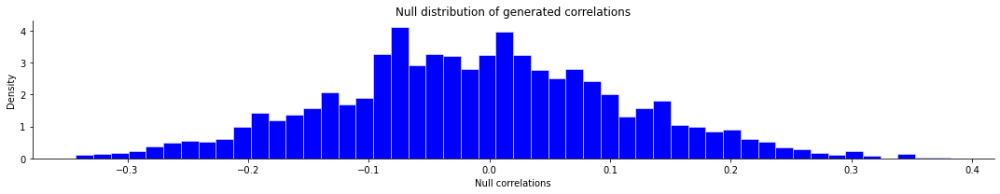

In [155]:
r_vals = []
p_vals = []
spin_p_vals = []
null_distr_rvals = []

for i in range(len(neuromap_names)):

    print(f"------------ {neuromap_names[i]} ------------\n")

    # whole brain
    if len(neuromaps[i]) == 20484:

        # r value
        r_vals.append(stats.spearmanr(He_AM_PSS_t_val_fs5, neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(He_AM_PSS_t_val_fs5, neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = He_AM_PSS_t_val_fs5, y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    # only one hemisphere -> I hard code it knowing that it's the right hemisphere
    elif len(neuromaps[i]) == 10242:

        # r value
        r_vals.append(stats.spearmanr(He_AM_PSS_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[0])

        # uncorrected p value
        p_vals.append(stats.spearmanr(He_AM_PSS_t_val_fs5[10242:], neuromaps[i], nan_policy='omit')[1])

        # spin permutation test (spin p value, null distribution of r values)
        spin_test = SpinPermutationTest_Schaefer400(x = He_AM_PSS_t_val_fs5[10242:], y = neuromaps[i], correlation_type = 'spearman', already_in_fs5_space = True)


    spin_p_vals.append(spin_test['spin_test_p'])
    null_distr_rvals.append(spin_test['spin_test_d'])


# make a dictionary to store in dataframe
neuromaps_res = {'neuromap_names': neuromap_names, 
                 'spearman (r)': r_vals,
                 'uncorrected p': p_vals,
                 'spin p': spin_p_vals,
                 'spin q': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[1],
                 'significance (FDR-corrected)': fdrcorrection(pvals = spin_p_vals, alpha=0.05)[0],
                 'significance (Bonferroni-corrected)': np.where(np.array(spin_p_vals) <= 0.05/len(spin_p_vals), True, False)}

He_AM_PSS_t_val_neuromaps_res = pd.DataFrame(neuromaps_res)

In [156]:
He_AM_PSS_t_val_neuromaps_res

,neuromap_names,spearman (r),uncorrected p,spin p,spin q,significance (FDR-corrected),significance (Bonferroni-corrected)
0,Neurosynth,-0.068906,3.600413e-21,0.3015,0.336971,False,False
1,Gene Expression,-0.346334,0.000000e+00,0.0060,0.038000,True,False
2,Glucose,-0.119715,8.844564e-61,0.1795,0.243607,False,False
3,Oxygen,-0.242024,5.820719e-248,0.0275,0.087083,False,False
4,CBF,-0.153853,1.260626e-99,0.0940,0.185250,False,False
5,Dopamine,-0.060746,8.566140e-17,0.2990,0.336971,False,False
6,Acetylcholine,-0.008732,2.319407e-01,0.4895,0.489500,False,False
7,Serotonin,-0.149938,1.163339e-94,0.1110,0.185250,False,False
8,Norepinephrine,-0.092322,9.255223e-37,0.2240,0.283733,False,False
9,Glutamate,0.054229,1.096199e-13,0.3240,0.342000,False,False


#### Plot local effects results

FDR correction 

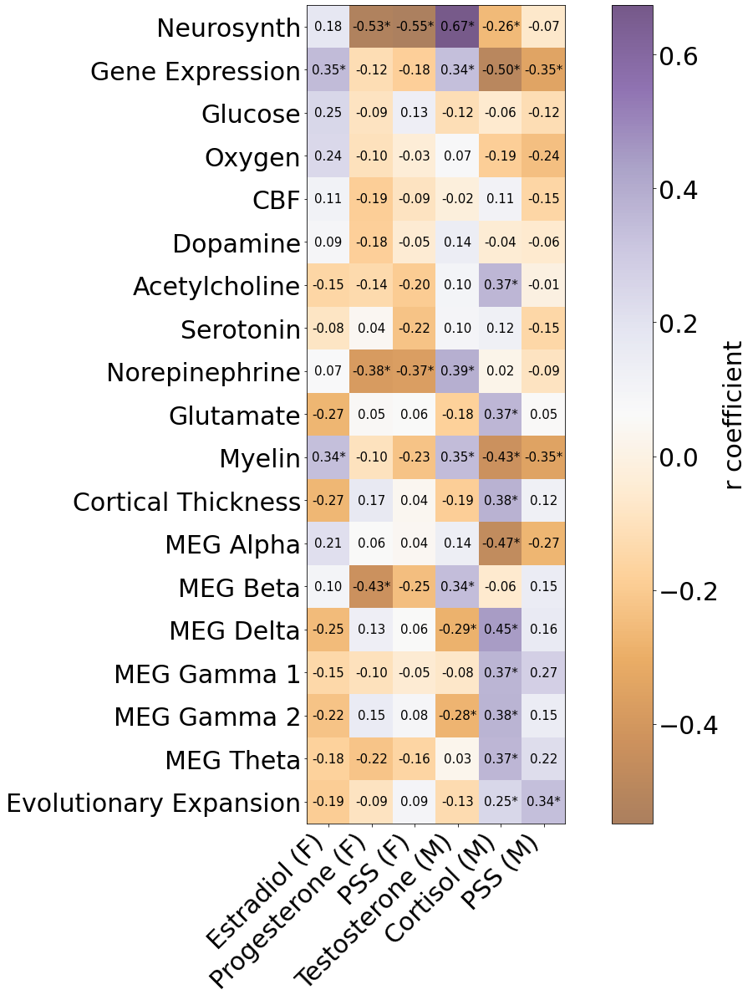

In [157]:
### shape values for plotting

r_vals_to_plot = np.stack((estradiol_t_val_excl26_neuromaps_res['spearman (r)'], progesterone_t_val_excl26_neuromaps_res['spearman (r)'], Me_PSS_t_val_neuromaps_res['spearman (r)'],
                    testosterone_t_val_neuromaps_res['spearman (r)'], cortisol_t_val_neuromaps_res['spearman (r)'], He_AM_PSS_t_val_neuromaps_res['spearman (r)']), axis=1)

FDR_sig = np.stack((estradiol_t_val_excl26_neuromaps_res['significance (FDR-corrected)'], progesterone_t_val_excl26_neuromaps_res['significance (FDR-corrected)'], Me_PSS_t_val_neuromaps_res['significance (FDR-corrected)'],
                           testosterone_t_val_neuromaps_res['significance (FDR-corrected)'], cortisol_t_val_neuromaps_res['significance (FDR-corrected)'], He_AM_PSS_t_val_neuromaps_res['significance (FDR-corrected)']), axis=1)


### plot

plt.figure(figsize=(20, 18))

# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
max_abs_value = np.max(np.abs(r_vals_to_plot))

plt.imshow(r_vals_to_plot, cmap='PuOr', interpolation='none', alpha=0.65, vmin=-max_abs_value, vmax=max_abs_value)

colorbar = plt.colorbar()

colorbar.ax.tick_params(labelsize=30)  # Set the font size for the color bar ticks
colorbar.set_label('r coefficient', fontsize=30)  # Set the font size for the color bar label


# Annotate the values with "*" based on the condition
for i in range(r_vals_to_plot.shape[0]):
    for j in range(r_vals_to_plot.shape[1]):
        value = r_vals_to_plot[i, j]
        annotation = f'{value:.2f}'
        if FDR_sig[i, j]:
            annotation += '*'
        plt.text(j, i, annotation, ha='center', va='center', color='k', fontsize=15)


#plt.title('Local effects correlations with Neuromaps', fontsize=30)
plt.xticks(ticks=range(r_vals_to_plot.shape[1]), labels=np.array(['Estradiol (F)', 'Progesterone (F)','PSS (F)', 'Testosterone (M)', 'Cortisol (M)', 'PSS (M)']), ha='right', rotation=45,  fontsize=30)
plt.yticks(ticks=range(r_vals_to_plot.shape[0]), labels=np.array(neuromap_names), rotation=0,  fontsize=30)

plt.savefig(resdir_fig+'neuromaps_local_effects_male_female_FDR.png', dpi=300,  bbox_inches='tight')

plt.show()

Bonferroni correction

## Plot relevant Neuromaps on hemispheres

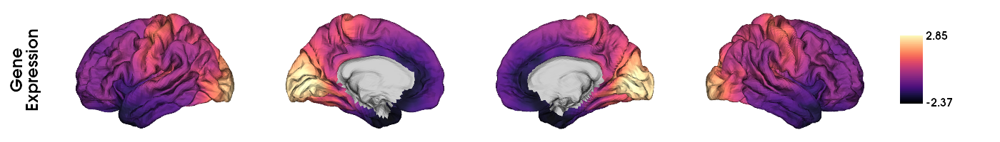

In [361]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = abagen_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'magma', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Gene\nExpression"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_abagen_plotted_hemispheres.png')

plotted_hemispheres

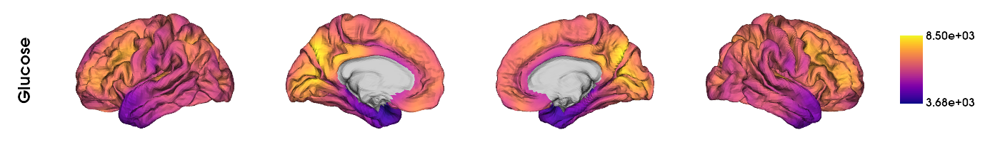

In [354]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
glucose_fsaverage_wb[glucose_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = glucose_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'plasma', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Glucose"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_glucose_plotted_hemispheres.png')

plotted_hemispheres

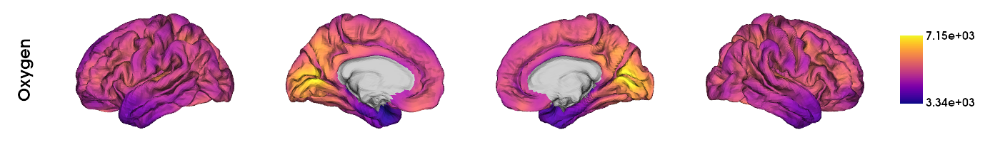

In [358]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
oxygen_fsaverage_wb[oxygen_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = oxygen_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'plasma', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Oxygen"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_oxygen_plotted_hemispheres.png')

plotted_hemispheres

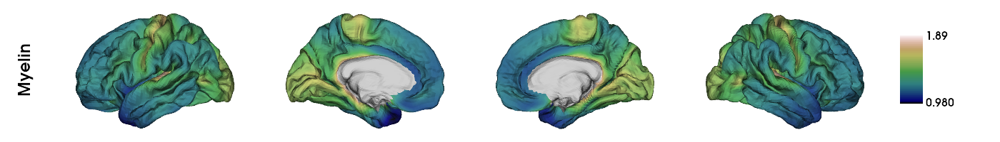

In [368]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
myelin_fsaverage_wb[myelin_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = myelin_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'gist_earth', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Myelin"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_myelin_plotted_hemispheres.png')

plotted_hemispheres

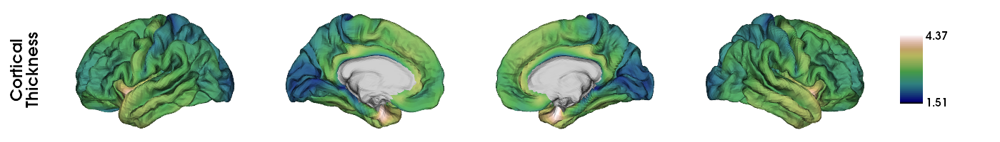

In [372]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
cortical_thickness_fsaverage_wb[cortical_thickness_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortical_thickness_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'gist_earth', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Cortical\nThickness"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_cortical_thickness_plotted_hemispheres.png')

plotted_hemispheres

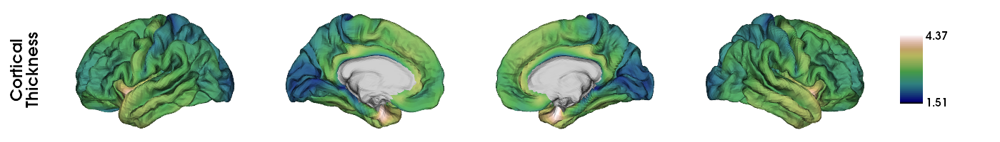

In [372]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
cortical_thickness_fsaverage_wb[cortical_thickness_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortical_thickness_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'gist_earth', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Cortical\nThickness"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_cortical_thickness_plotted_hemispheres.png')

plotted_hemispheres

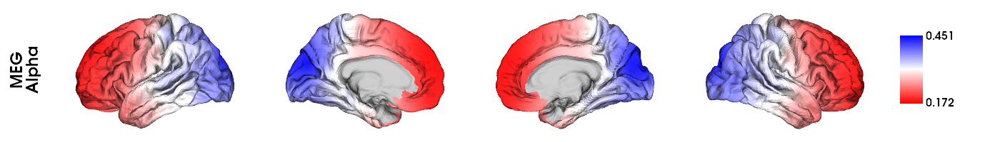

In [379]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
meg_alpha_fsaverage_wb[meg_alpha_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = meg_alpha_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'bwr_r', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["MEG\nAlpha"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_meg_alpha_plotted_hemispheres.png')

plotted_hemispheres

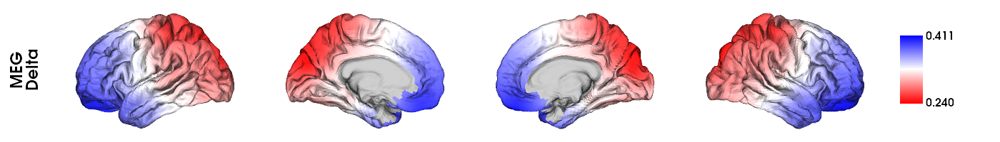

In [384]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
meg_delta_fsaverage_wb[meg_delta_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = meg_delta_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'bwr_r', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["MEG\nDelta"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_meg_delta_plotted_hemispheres.png')

plotted_hemispheres

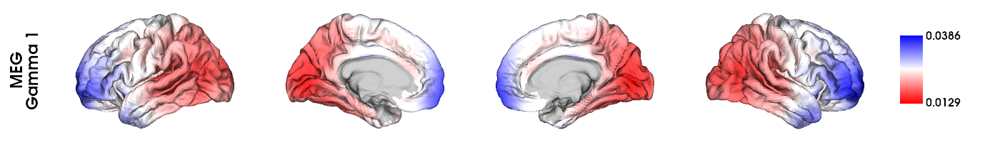

In [389]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
meg_gamma1_fsaverage_wb[meg_gamma1_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = meg_gamma1_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'bwr_r', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["MEG\nGamma 1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_meg_gamma1_plotted_hemispheres.png')

plotted_hemispheres

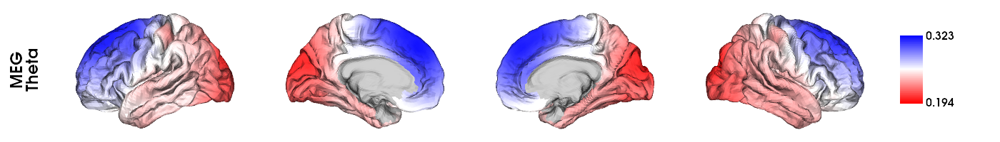

In [392]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# replace zeros with nan for plotting (grey midwall)
meg_theta_fsaverage_wb[meg_theta_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = meg_theta_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'bwr_r', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["MEG\nTheta"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_meg_theta_plotted_hemispheres.png')

plotted_hemispheres

In [396]:
evoexp_fsaverage_rh.shape

(10242,)

In [401]:
np.concatenate(([float('nan')]*10242, evoexp_fsaverage_rh))

array([       nan,        nan,        nan, ..., 1.35173726, 1.16533053,
       0.99199647])

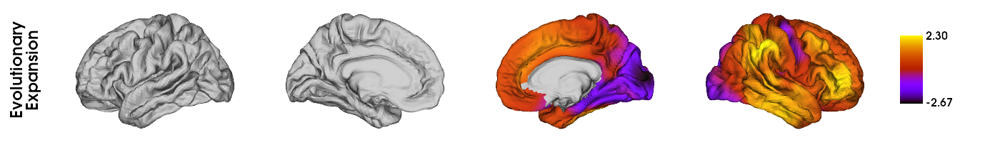

In [406]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

# making a left hemisphere nan
evoexp_fsaverage_wb = np.concatenate(([float('nan')]*10242, evoexp_fsaverage_rh))

# replace zeros with nan for plotting (grey midwall)
evoexp_fsaverage_wb[evoexp_fsaverage_wb == 0] = 'nan'

plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = evoexp_fsaverage_wb, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'gnuplot', 
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Evolutionary\nExpansion"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'neuromap_evoexp_plotted_hemispheres.png')

plotted_hemispheres

#
#
#
#
# Extra Analyses

# Supplement estradiol and testosterone in model for both sexes

## Building gradients (He; AM; 15 datapoints)

### Mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


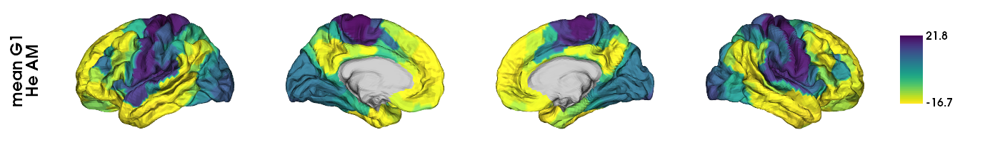

In [280]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_AM_15 = sum(fc_matrices_He_AM[:15])/len(fc_matrices_He_AM[:15])


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad_He_AM_15 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_He_AM_15.fit(mean_fc_matrix_He_AM_15)

# mean G1
mean_fc_G1_He_AM_15 = mean_fc_grad_He_AM_15.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_AM_15_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He_AM_15, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_AM_15_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe AM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_AM_mean_G1.png')

plotted_hemispheres

In [281]:
print(f"Total amount of variance explained by the {len(mean_fc_grad_He_AM_15.lambdas_)} gradients (uncorrected sum lambdas): {sum(mean_fc_grad_He_AM_15.lambdas_):.2f}\n")

# Scaled variance explained by individual gradients: lambda / total(i.e., sum lambdas) * 100 %
print(f"Scaled variance explained by individual gradients:\nG1: {mean_fc_grad_He_AM_15.lambdas_[0]/sum(mean_fc_grad_He_AM_15.lambdas_)*100:.2f}%\nG2: {mean_fc_grad_He_AM_15.lambdas_[1]/sum(mean_fc_grad_He_AM_15.lambdas_)*100:.2f}%\nG3: {mean_fc_grad_He_AM_15.lambdas_[2]/sum(mean_fc_grad_He_AM_15.lambdas_)*100:.2f}%\n")

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 37.82

Scaled variance explained by individual gradients:
G1: 33.42%
G2: 25.55%
G3: 9.51%



## Aligned gradients

In [282]:
compute_aligned_grad_He_AM_15 = compute_aligned_gradients(fc_matrices_He_AM[:15], mean_fc_grad_He_AM_15.gradients_) 

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_AM_15_G1 = compute_aligned_grad_He_AM_15['array_aligned_G1']

### Export gradient to csv for dispersion analyses

In [283]:
# fmt = decimals, 
# header = str(list(range(1,401)))[1:-1] ->header = 1 to 400 (without the first and last string letter because it's the [] of the list -> only use for R export, np.genfromtxt will read it as an additional line which is wrong
# comments = empty because otherwise gives a #

np.savetxt(resdir+'array_aligned_fc_He_AM_15_G1.csv', array_aligned_fc_He_AM_15_G1, delimiter=',', fmt = '%.16g', comments = '')

## Linear Model (Me)

In [284]:
lmer_res_suppl_Me = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}

for i in range(400):
    
    # define model   
    model = sm.MixedLM(
        endog = array_aligned_fc_G1_excl26.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'testosterone': hormones_28Me_excl26.z_testosterone}),  # fixed effects (covariate)
        groups = hormones_28Me_excl26.Experiment, 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_suppl_Me['parcel'].append(i)
    lmer_res_suppl_Me['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_suppl_Me['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_suppl_Me['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_suppl_Me['testosterone_p_val'].append(results.pvalues['testosterone']) 

lmer_res_suppl_Me['estradiol_q_val'] = fdrcorrection(lmer_res_suppl_Me['estradiol_p_val'], alpha=0.05)[1]
lmer_res_suppl_Me['testosterone_q_val'] = fdrcorrection(lmer_res_suppl_Me['testosterone_p_val'], alpha=0.05)[1]

lmer_res_suppl_Me = pd.DataFrame(lmer_res_suppl_Me)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimi

In [55]:
lmer_res_suppl_Me

,parcel,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val,estradiol_q_val,testosterone_q_val
0,0,0.986787,0.323747,-0.816168,0.414404,0.994344,0.622139
1,1,1.005569,0.314623,-1.822506,0.068378,0.994344,0.329534
2,2,0.454264,0.649639,-0.560547,0.575106,0.994344,0.735054
3,3,-0.194525,0.845765,-1.608764,0.107668,0.994344,0.388847
4,4,-0.414705,0.678358,-0.478772,0.632101,0.994344,0.766183
...,...,...,...,...,...,...,...
395,395,-0.437155,0.661999,1.104772,0.269258,0.994344,0.522832
396,396,0.155725,0.876250,0.393024,0.694302,0.994344,0.820197
397,397,-0.457618,0.647227,1.054492,0.291658,0.994344,0.535440
398,398,0.221787,0.824479,0.882872,0.377306,0.994344,0.609725


In [56]:
np.where(np.array(lmer_res_suppl_Me.estradiol_q_val) < 0.05)[0].shape

(0,)

In [57]:
np.where(np.array(lmer_res_suppl_Me.testosterone_q_val) < 0.05)[0].shape

(0,)

In [58]:
np.isnan(lmer_res_suppl_Me.estradiol_q_val).any()

False

In [59]:
np.isnan(lmer_res_suppl_Me.testosterone_q_val).any()

False

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [60]:
estradiol_suppl_Me_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_Me.estradiol_t_val, seven_networks=False)
testosterone_suppl_Me_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_Me.testosterone_t_val, seven_networks=False)
estradiol_suppl_Me_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_Me.estradiol_q_val, seven_networks=False)
testosterone_suppl_Me_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_Me.testosterone_q_val, seven_networks=False)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


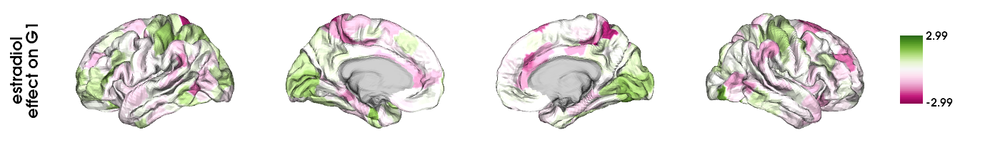

In [61]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_suppl_Me_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_suppl_estr_on_G1.png')

plotted_hemispheres

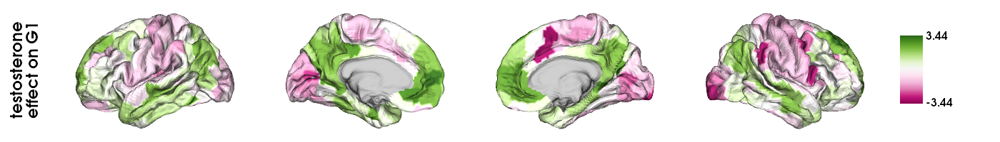

In [62]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_suppl_Me_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_suppl_test_on_G1.png')

plotted_hemispheres

## Linear Model (He AM) - 15 timepoints (only serum levels for higher comparability with female)

In [63]:
lmer_res_suppl_He_AM = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}

for i in range(400):
    
    # define model   
    model = sm.MixedLM(
        endog = array_aligned_fc_He_AM_15_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28He_AM.z_estradiol_serum[:15], 'testosterone': hormones_28He_AM.z_total_testosterone_serum[:15]}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time[:15], 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_suppl_He_AM['parcel'].append(i)
    lmer_res_suppl_He_AM['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_suppl_He_AM['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_suppl_He_AM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_suppl_He_AM['testosterone_p_val'].append(results.pvalues['testosterone']) 

lmer_res_suppl_He_AM['estradiol_q_val'] = fdrcorrection(lmer_res_suppl_He_AM['estradiol_p_val'], alpha=0.05)[1]
lmer_res_suppl_He_AM['testosterone_q_val'] = fdrcorrection(lmer_res_suppl_He_AM['testosterone_p_val'], alpha=0.05)[1]

lmer_res_suppl_He_AM = pd.DataFrame(lmer_res_suppl_He_AM)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at t

In [64]:
lmer_res_suppl_He_AM

,parcel,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val,estradiol_q_val,testosterone_q_val
0,0,-0.586813,0.557329,0.061545,0.950926,0.998377,0.996325
1,1,-0.781828,0.434315,-0.106847,0.914910,0.998377,0.996325
2,2,-1.186728,0.235335,0.942026,0.346179,0.998377,0.996325
3,3,0.040401,0.967773,-0.466974,0.640518,0.998377,0.996325
4,4,-0.260496,0.794481,0.499421,0.617483,0.998377,0.996325
...,...,...,...,...,...,...,...
395,395,-0.004684,0.996263,0.222365,0.824030,0.998377,0.996325
396,396,0.502313,0.615448,-0.775407,0.438099,0.998377,0.996325
397,397,-1.520595,0.128361,1.746584,0.080709,0.998377,0.996325
398,398,0.456132,0.648295,-0.344792,0.730251,0.998377,0.996325


In [65]:
np.where(np.array(lmer_res_suppl_He_AM.estradiol_q_val) < 0.05)[0].shape

(0,)

In [66]:
np.where(np.array(lmer_res_suppl_He_AM.testosterone_q_val) < 0.05)[0].shape

(0,)

In [67]:
np.isnan(lmer_res_suppl_He_AM.estradiol_q_val).any()

False

In [68]:
np.isnan(lmer_res_suppl_He_AM.testosterone_q_val).any()

False

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [69]:
estradiol_suppl_He_AM_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_He_AM.estradiol_t_val, seven_networks=False)
testosterone_suppl_He_AM_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_He_AM.testosterone_t_val, seven_networks=False)
estradiol_suppl_He_AM_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_He_AM.estradiol_q_val, seven_networks=False)
testosterone_suppl_He_AM_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_suppl_He_AM.testosterone_q_val, seven_networks=False)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


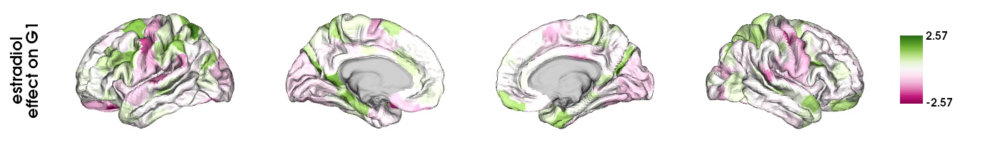

In [70]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_suppl_He_AM_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_AM_suppl_estr_on_G1.png')

plotted_hemispheres

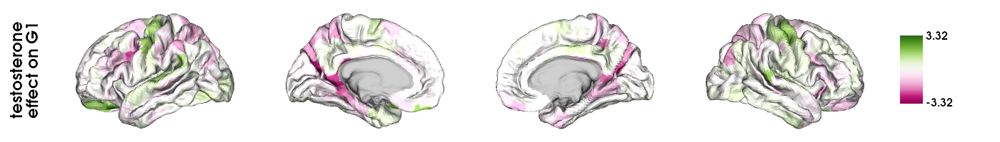

In [71]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_suppl_He_AM_t_val_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_AM_suppl_test_on_G1.png')

plotted_hemispheres

## Comparison male-female hormonal patterns -> patterns are inverse (in S-A regions) despite the gradients being aligned)

### Correlations whole-brain

#### Estradiol

In [202]:
stats.spearmanr(lmer_res_suppl_Me.estradiol_t_val, lmer_res_suppl_He_AM.estradiol_t_val)

SignificanceResult(statistic=-0.15237132732079575, pvalue=0.0022449735793311975)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.106


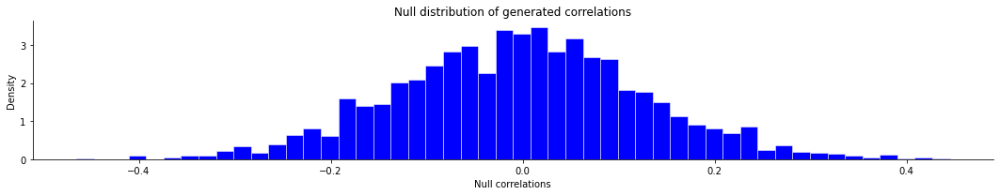

{'spin_test_p': 0.106,
 'spin_test_d': array([ 0.04169015, -0.04010355, -0.15458967, ..., -0.17475627,
         0.02640863,  0.10077034])}

In [203]:
SpinPermutationTest_Schaefer400(x = lmer_res_suppl_Me.estradiol_t_val, y = lmer_res_suppl_He_AM.estradiol_t_val, correlation_type = 'spearman')

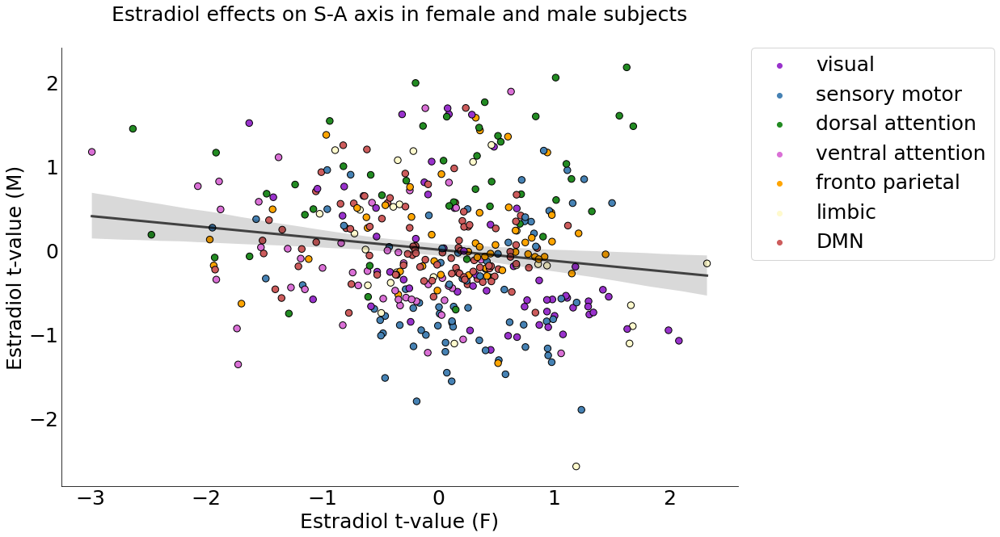

In [204]:
df = pd.DataFrame({'Estradiol t-value (F)':  lmer_res_suppl_Me.estradiol_t_val, 'Estradiol t-value (M)': lmer_res_suppl_He_AM.estradiol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Estradiol t-value (F)', y = 'Estradiol t-value (M)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Estradiol t-value (F)', y = 'Estradiol t-value (M)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Estradiol effects on S-A axis in female and male subjects", y=1.05, fontsize=25)
ax.set_xlabel("Estradiol t-value (F)",fontsize=25)
ax.set_ylabel("Estradiol t-value (M)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
plt.savefig(resdir_fig+'suppl_scatter_estr_female_male_AM.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Testosterone

In [205]:
stats.spearmanr(lmer_res_suppl_Me.testosterone_t_val, lmer_res_suppl_He_AM.testosterone_t_val)

SignificanceResult(statistic=-0.23353795961224758, pvalue=2.340083710315125e-06)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.041999999999999996


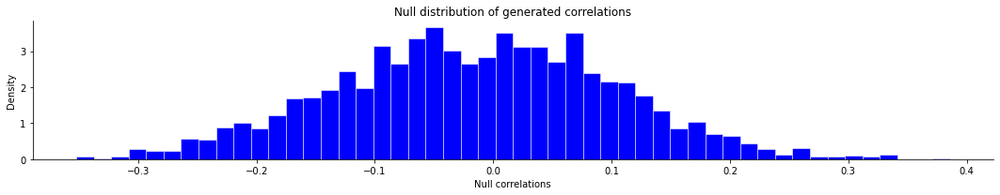

{'spin_test_p': 0.041999999999999996,
 'spin_test_d': array([-0.14335818, -0.08047849, -0.09154297, ..., -0.03187825,
         0.00160748, -0.09805641])}

In [206]:
SpinPermutationTest_Schaefer400(x = lmer_res_suppl_Me.testosterone_t_val, y = lmer_res_suppl_He_AM.testosterone_t_val, correlation_type = 'spearman')

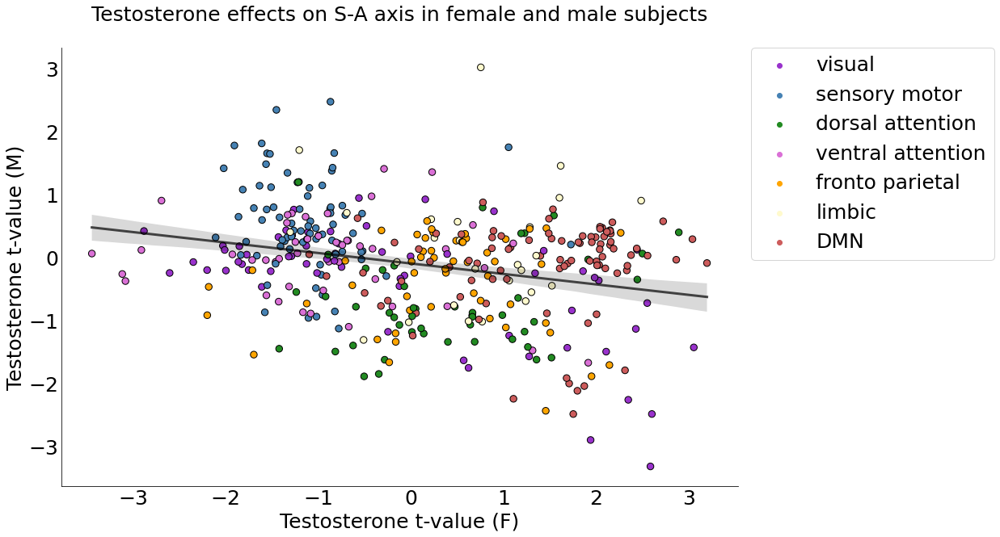

In [207]:
df = pd.DataFrame({'Testosterone t-value (F)':  lmer_res_suppl_Me.testosterone_t_val, 'Testosterone t-value (M)': lmer_res_suppl_He_AM.testosterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Testosterone t-value (F)', y = 'Testosterone t-value (M)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Testosterone t-value (F)', y = 'Testosterone t-value (M)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Testosterone effects on S-A axis in female and male subjects", y=1.05, fontsize=25)
ax.set_xlabel("Testosterone t-value (F)",fontsize=25)
ax.set_ylabel("Testosterone t-value (M)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
plt.savefig(resdir_fig+'suppl_scatter_test_female_male_AM.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

Negative correlations above (only testosterone significant, low) despite the gradients being in the same direction for male and female

In [208]:
stats.spearmanr(np.mean(array_aligned_fc_He_AM_G1, axis=0), np.mean(array_aligned_fc_G1_excl26, axis=0))

SignificanceResult(statistic=0.8658860367877298, pvalue=8.656981812907669e-122)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


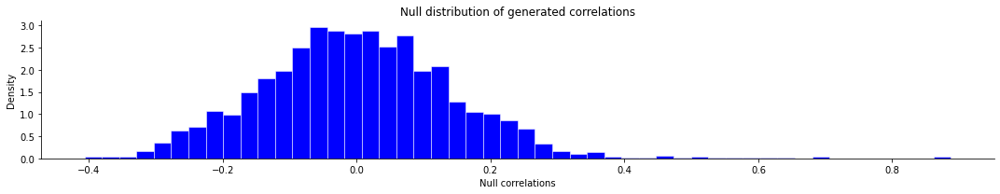

{'spin_test_p': 0.001,
 'spin_test_d': array([ 0.06381913, -0.02941483, -0.12206426, ..., -0.05500929,
        -0.23337717, -0.1039018 ])}

In [209]:
SpinPermutationTest_Schaefer400(x = np.mean(array_aligned_fc_He_AM_G1, axis=0), y = np.mean(array_aligned_fc_G1_excl26, axis=0), correlation_type = 'spearman')

### Checking specificity of networks / regions in having effects across sexes regardless of their directionalityChecking

Note that the correlation p-values below have not undergone permutation testing! so here the correlations (r coefficients) are only indicative of effect sizes


Overall Pearson correlation between Estradiol effects (F) and Estradiol effects (M): r = -0.15; p = 0.003

visual: r = -0.61, p = 0.0
sensory motor: r = 0.07, p = 0.544
dorsal attention: r = 0.3, p = 0.041
ventral attention: r = -0.24, p = 0.102
limbic: r = -0.38, p = 0.056
fronto parietal: r = 0.03, p = 0.805
DMN: r = -0.17, p = 0.103




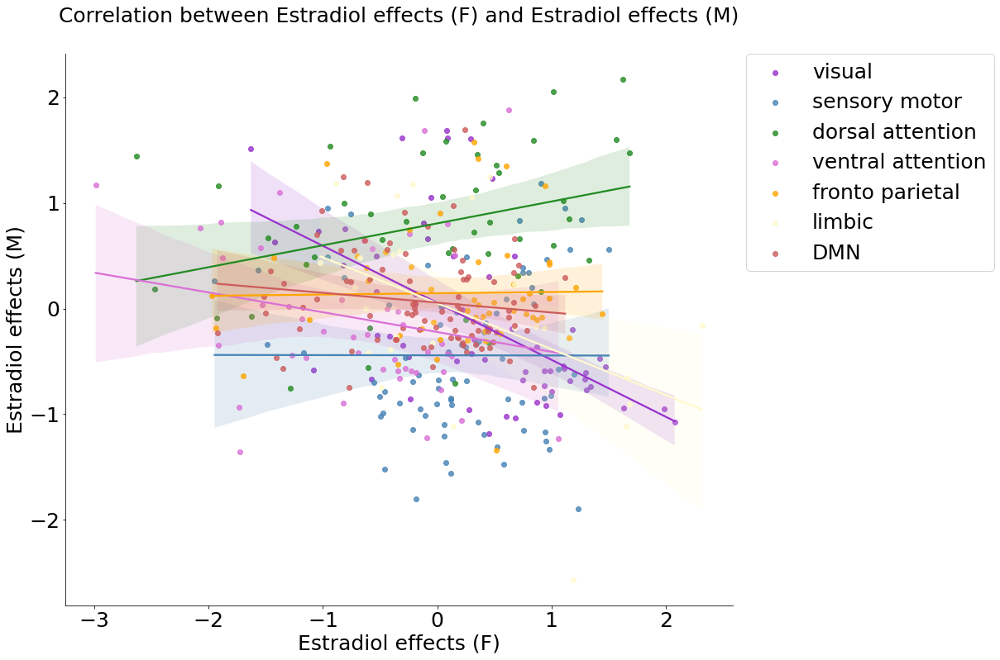

In [81]:
print_plot_corr_networks(x=lmer_res_suppl_Me.estradiol_t_val, y=lmer_res_suppl_He_AM.estradiol_t_val, x_label='Estradiol effects (F)', y_label='Estradiol effects (M)', seven_networks=False, corr_type='spearman')

Note that the correlation p-values below have not undergone permutation testing! so here the correlations (r coefficients) are only indicative of effect sizes


Overall Pearson correlation between Testosterone effects (F) and Testosterone effects (M): r = -0.27; p = 0.0

visual: r = -0.53, p = 0.0
sensory motor: r = -0.2, p = 0.076
dorsal attention: r = 0.16, p = 0.294
ventral attention: r = -0.02, p = 0.909
limbic: r = 0.07, p = 0.726
fronto parietal: r = 0.06, p = 0.654
DMN: r = 0.22, p = 0.034




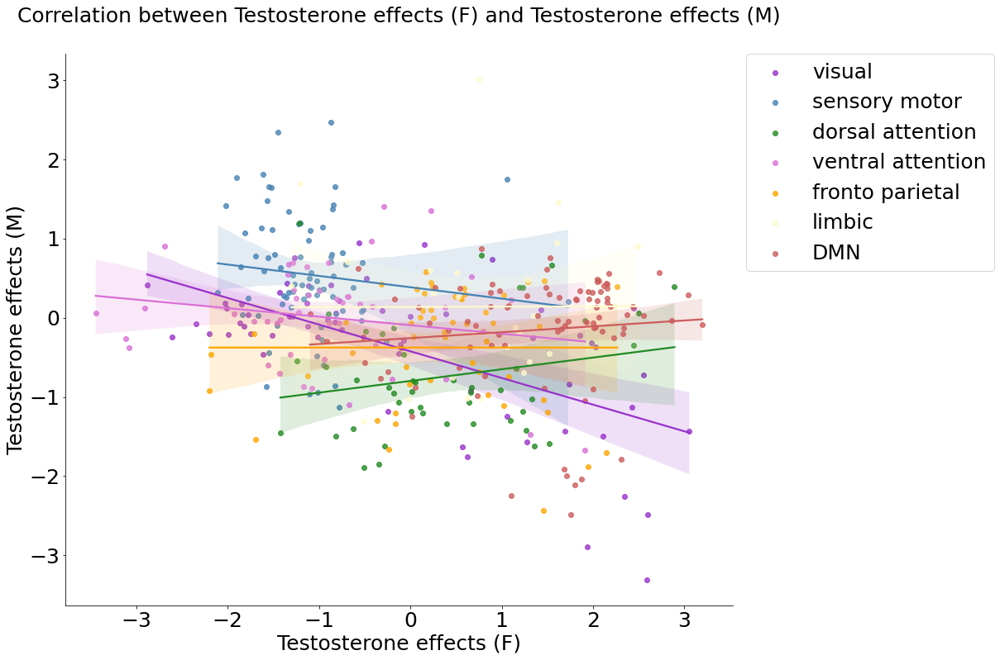

In [82]:
print_plot_corr_networks(x=lmer_res_suppl_Me.testosterone_t_val, y=lmer_res_suppl_He_AM.testosterone_t_val, x_label='Testosterone effects (F)', y_label='Testosterone effects (M)', seven_networks=False, corr_type='spearman')

## Dispersion Analyses (Me) (excluding day 26) - hormonal effects

Definitions
- Within network dispersion was quantified as sum squared Euclidean distance of network nodes to the network centroid at individual level (higher value = wider distribution = more dispersion/less integration)
- Between network dispersion was calculated as the Euclidean distance between network centroids. 

Steps
- These metrics were calculated for each subject within the individualised, aligned gradient space. 
- We used linear models, correcting for head motion and sex, to estimate the association of age with network centroid position, within network dispersion and between network dispersion. 
- For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 
- To explore whether age related differences in dispersion were driven by a particular gradient, we examined the correlation between dispersion and subjects individual principal component loadings for the principal component of each gradient (e.g. the first principal component of a principal component analysis of the subject*gradient matrix for the first 3 gradients).

### Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

#### Computing within dispersion metric

In [285]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_G1_excl26.T  # transpose to obtain shape (400 x 29) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_net = np.median(G1_net, axis=0)  
    yeo_cog.append(yeo_cog_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion.append(sum_of_squares)
    
    
yeo_cog = np.array(yeo_cog)
WN_dispersion = np.array(WN_dispersion)

In [286]:
WN_dispersion.shape

(7, 29)

##### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [287]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'testosterone': hormones_28Me_excl26.z_testosterone}),  # fixed effects (covariate)
        groups = hormones_28Me_excl26.Experiment, 
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol and testosterone 
    lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['testosterone_p_val'].append(results.pvalues['testosterone']) 


lmer_WN_dispersion_hormonal_contrast_res_suppl_Me = pd.DataFrame(lmer_WN_dispersion_hormonal_contrast_res_suppl_Me)
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me = lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.set_index('yeo_network')

In [288]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val
yeo_network,,,,
visual,1.137288,0.255418,-2.698975,0.006955
sensory motor,1.222726,0.221433,-1.004396,0.315188
dorsal attention,-0.033883,0.972970,-0.709198,0.478202
ventral attention,-0.546572,0.584673,-0.073616,0.941316
limbic,-0.304999,0.760367,-0.787966,0.430717
fronto parietal,-0.953678,0.340247,-1.307346,0.191095
DMN,-0.926701,0.354082,-1.440078,0.149845


### Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [289]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_hormonal_contrast_res_suppl_Me = {'pairwise_comparison' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_hormonal_contrast_res_suppl_Me['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_hormonal_contrast_res_suppl_Me['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_hormonal_contrast_res_suppl_Me['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog[n1] - yeo_cog[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'testosterone': hormones_28Me_excl26.z_testosterone}),  # fixed effects (covariate)
                groups = hormones_28Me_excl26.Experiment, 
                exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of estradiol and testosterone 
            BN_dispersion_hormonal_contrast_res_suppl_Me['estradiol_t_val'].append(results.tvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res_suppl_Me['estradiol_p_val'].append(results.pvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res_suppl_Me['testosterone_t_val'].append(results.tvalues['testosterone'])
            BN_dispersion_hormonal_contrast_res_suppl_Me['testosterone_p_val'].append(results.pvalues['testosterone']) 


BN_dispersion_hormonal_contrast_res_suppl_Me = pd.DataFrame(BN_dispersion_hormonal_contrast_res_suppl_Me)
BN_dispersion_hormonal_contrast_res_suppl_Me = BN_dispersion_hormonal_contrast_res_suppl_Me.set_index('pairwise_comparison')


In [290]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_hormonal_contrast_res_suppl_Me.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_hormonal_contrast_res_suppl_Me['new_comparison_names'] = new_comparison_names
BN_dispersion_hormonal_contrast_res_suppl_Me = BN_dispersion_hormonal_contrast_res_suppl_Me.set_index('new_comparison_names')
BN_dispersion_hormonal_contrast_res_suppl_Me.index.name = 'pairwise_comparisons'

In [291]:
BN_dispersion_hormonal_contrast_res_suppl_Me

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val
pairwise_comparisons,,,,
visual - sensory motor,0.367105,0.713541,0.156228,0.875853
visual - dorsal attention,1.464138,0.143156,-2.961032,0.003066
visual - ventral attention,1.478460,0.139285,-0.316592,0.751553
visual - limbic,-0.059764,0.952344,-1.861487,0.062675
visual - fronto parietal,0.414718,0.678348,-1.420775,0.155382
visual - DMN,0.614635,0.538796,-2.199984,0.027808
sensory motor - dorsal attention,0.442876,0.657856,-1.893488,0.058293
sensory motor - ventral attention,2.706775,0.006794,-1.118939,0.263166
sensory motor - limbic,-0.369238,0.711951,-1.438687,0.150239


### EXPLORATORY gradient dispersion analysis

New metric of wholebrain gradient dispersion -> like WN but not per network - to assess effects on overall gradient expansion/contraction

In [292]:
# compute for each experimental day, across all networks / parcels a) gradient centroid position; b) gradient dispersion metric (higher value = wider distribution = more dispersion)

grad_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (N)


### identify the centroid / center of gravity (= median) gradient loading across all parcels for each experimental day (shape: N)
grad_cog = np.median(array_aligned_fc_G1_excl26, axis=1)

### gradient dispersion: 1 value per experimental day
# compute (per experimental day) the Eucledian distance between each gradient loading and the gradient centroid
dist_nodes_to_cog = array_aligned_fc_G1_excl26.T - grad_cog  # shape: number of parcels (400) x N

# take the sum of squares of this Eucledian distance 
gradient_dispersion = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N

gradient_dispersion = np.array(gradient_dispersion)

In [265]:
gradient_dispersion.shape

(29,)

In [266]:
print(f"Female\nMean = {np.mean(gradient_dispersion)}\nSD = {np.std(gradient_dispersion)}")

Female
Mean = 26919.58164718871
SD = 8075.356171428019


In [267]:
lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me = {'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}


# define model
model = sm.MixedLM(
    endog = gradient_dispersion,  # dependent variable
    exog = pd.DataFrame({'estradiol': hormones_28Me_excl26.z_estradiol, 'testosterone': hormones_28Me_excl26.z_testosterone}),  # fixed effects (covariate)
    groups = hormones_28Me_excl26.Experiment, 
    exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
    exog_vc=None)

# fit model
results = model.fit()
#results.summary()

# save results of estradiol and testosterone 
lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me['estradiol_t_val'].append(results.tvalues['estradiol'])
lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me['estradiol_p_val'].append(results.pvalues['estradiol'])
lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me['testosterone_t_val'].append(results.tvalues['testosterone'])
lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me['testosterone_p_val'].append(results.pvalues['testosterone']) 


lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me = pd.DataFrame(lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me)

In [268]:
lmer_gradient_dispersion_hormonal_contrast_res_suppl_Me

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val
0,0.087959,0.929909,-1.419718,0.15569


In [269]:
## Making female gradient dispersion value ordered according to MC day --> for plot (see after computing gradient dispersion for male)

# re-indexing order in menstrual cycle order (IN DATA EXCLUDING DAY 26)-> from experimental day 11 -> (index 10)
gradient_dispersion_MC_reindexed = np.concatenate((gradient_dispersion[10:], gradient_dispersion[:10]), axis=0)


## Making the labels for MC day usable for plotting (removing the nan value)

# Create a boolean mask for NaN values
nan_mask = np.isnan(np.array(hormones_28Me_MCreindexed_excl26['MC day']))

# Use boolean indexing to get non-NaN values
MC_day_no_nan = np.array(hormones_28Me_MCreindexed_excl26['MC day'])[~nan_mask]

### Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

#### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_suppl_Me_estr_test.py
(when conda activated)

#### Load null distributions of t-values

In [293]:
WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl = pd.read_csv(resdir+'WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl.csv')
WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl = pd.read_csv(resdir+'WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl.csv')

BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl = pd.read_csv(resdir+'BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl.csv')
BN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl = pd.read_csv(resdir+'BN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl.csv')

#### Compute the spin p-values 

##### Within Network dispersion

Estradiol

In [294]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.loc[network,'estradiol_p_val'] < 0.025/7:
        
        
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl[network], score = lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.loc[network, 'estradiol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.loc[network, 'estradiol_t_val'] < np.median(WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['estradiol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['estradiol significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


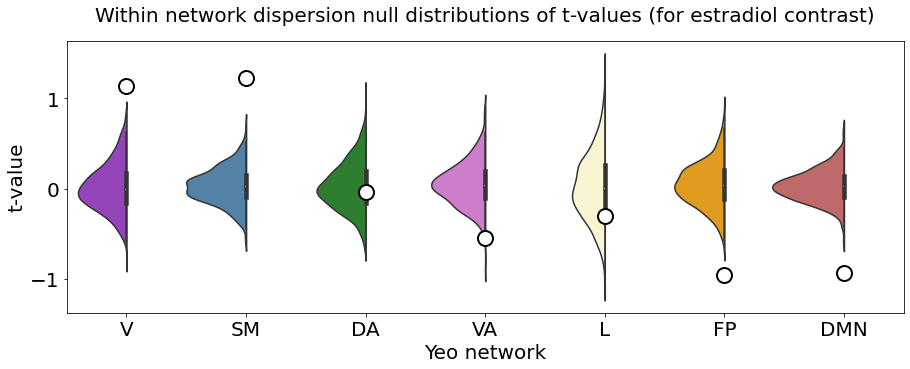

In [295]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl_long = pd.melt(WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl, 
                                                               value_vars = WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.estradiol_t_val, color='white', edgecolor='black',  size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for estradiol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'suppl_violin_WN_dispersion_null_distr_tvals_estradiol_Me.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

Testosterone

In [296]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.loc[network,'testosterone_p_val'] < 0.025/7:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl[network], score = lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.loc[network, 'testosterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.loc[network, 'testosterone_t_val'] < np.median(WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
        
        

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['testosterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me['testosterone significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


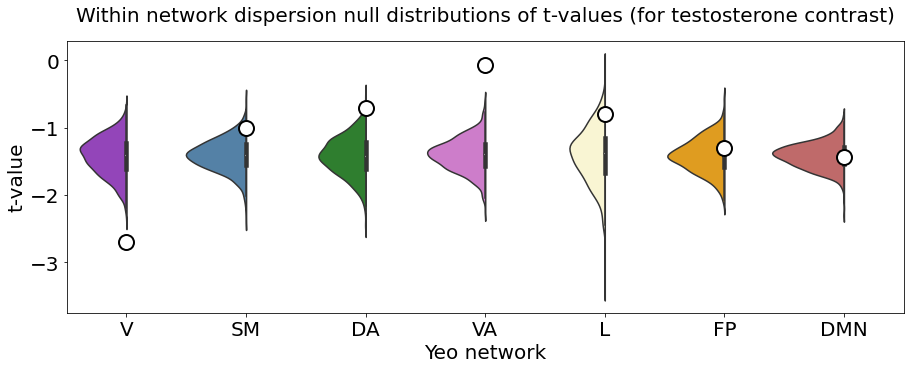

In [297]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl_long = pd.melt(WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl, 
                                                               value_vars = WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.testosterone_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for testosterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'suppl_violin_WN_dispersion_null_distr_tvals_testosterone_Me.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

##### Results

In [298]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val,estradiol_spin_p_val,estradiol significance post Bonferroni (alpha=0.0036) and spin test,testosterone_spin_p_val,testosterone significance post Bonferroni (alpha=0.0036) and spin test
yeo_network,,,,,,,,
visual,1.137288,0.255418,-2.698975,0.006955,NaN,not sig,NaN,not sig
sensory motor,1.222726,0.221433,-1.004396,0.315188,NaN,not sig,NaN,not sig
dorsal attention,-0.033883,0.972970,-0.709198,0.478202,NaN,not sig,NaN,not sig
ventral attention,-0.546572,0.584673,-0.073616,0.941316,NaN,not sig,NaN,not sig
limbic,-0.304999,0.760367,-0.787966,0.430717,NaN,not sig,NaN,not sig
fronto parietal,-0.953678,0.340247,-1.307346,0.191095,NaN,not sig,NaN,not sig
DMN,-0.926701,0.354082,-1.440078,0.149845,NaN,not sig,NaN,not sig


##### Export the results table

In [299]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.to_csv(resdir+'lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.csv', header = True, index = True)

##### Between Network dispersion

In [300]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl.columns = new_col_names
BN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl.columns = new_col_names

Estradiol

In [301]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res_suppl_Me.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_hormonal_contrast_res_suppl_Me.loc[pairwise_comparison,'estradiol_p_val'] < 0.025/21:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res_suppl_Me.loc[pairwise_comparison, 'estradiol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_hormonal_contrast_res_suppl_Me.loc[pairwise_comparison, 'estradiol_t_val'] < np.median(BN_dispersion_perm_tval_estradiol_contrast_null_distr_Me_suppl[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')

    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')   
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res_suppl_Me['estradiol_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res_suppl_Me['estradiol significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

 Testosterone

In [302]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res_suppl_Me.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_hormonal_contrast_res_suppl_Me.loc[pairwise_comparison,'estradiol_p_val'] < 0.025/21:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res_suppl_Me.loc[pairwise_comparison, 'testosterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_hormonal_contrast_res_suppl_Me.loc[pairwise_comparison, 'testosterone_t_val'] < np.median(BN_dispersion_perm_tval_testosterone_contrast_null_distr_Me_suppl[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')   
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res_suppl_Me['testosterone_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res_suppl_Me['testosterone significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

In [303]:
BN_dispersion_hormonal_contrast_res_suppl_Me

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val,estradiol_spin_p_val,estradiol significance post Bonferroni (alpha= 0.001) and spin test,testosterone_spin_p_val,testosterone significance post Bonferroni (alpha= 0.001) and spin test
pairwise_comparisons,,,,,,,,
visual - sensory motor,0.367105,0.713541,0.156228,0.875853,NaN,not sig,NaN,not sig
visual - dorsal attention,1.464138,0.143156,-2.961032,0.003066,NaN,not sig,NaN,not sig
visual - ventral attention,1.478460,0.139285,-0.316592,0.751553,NaN,not sig,NaN,not sig
visual - limbic,-0.059764,0.952344,-1.861487,0.062675,NaN,not sig,NaN,not sig
visual - fronto parietal,0.414718,0.678348,-1.420775,0.155382,NaN,not sig,NaN,not sig
visual - DMN,0.614635,0.538796,-2.199984,0.027808,NaN,not sig,NaN,not sig
sensory motor - dorsal attention,0.442876,0.657856,-1.893488,0.058293,NaN,not sig,NaN,not sig
sensory motor - ventral attention,2.706775,0.006794,-1.118939,0.263166,NaN,not sig,NaN,not sig
sensory motor - limbic,-0.369238,0.711951,-1.438687,0.150239,NaN,not sig,NaN,not sig


##### Export the results table

In [304]:
BN_dispersion_hormonal_contrast_res_suppl_Me.to_csv(resdir+'lmer_BN_dispersion_hormonal_contrast_res_suppl_Me.csv', header = True, index = True)

 Plot pairwise t-vals for estradiol

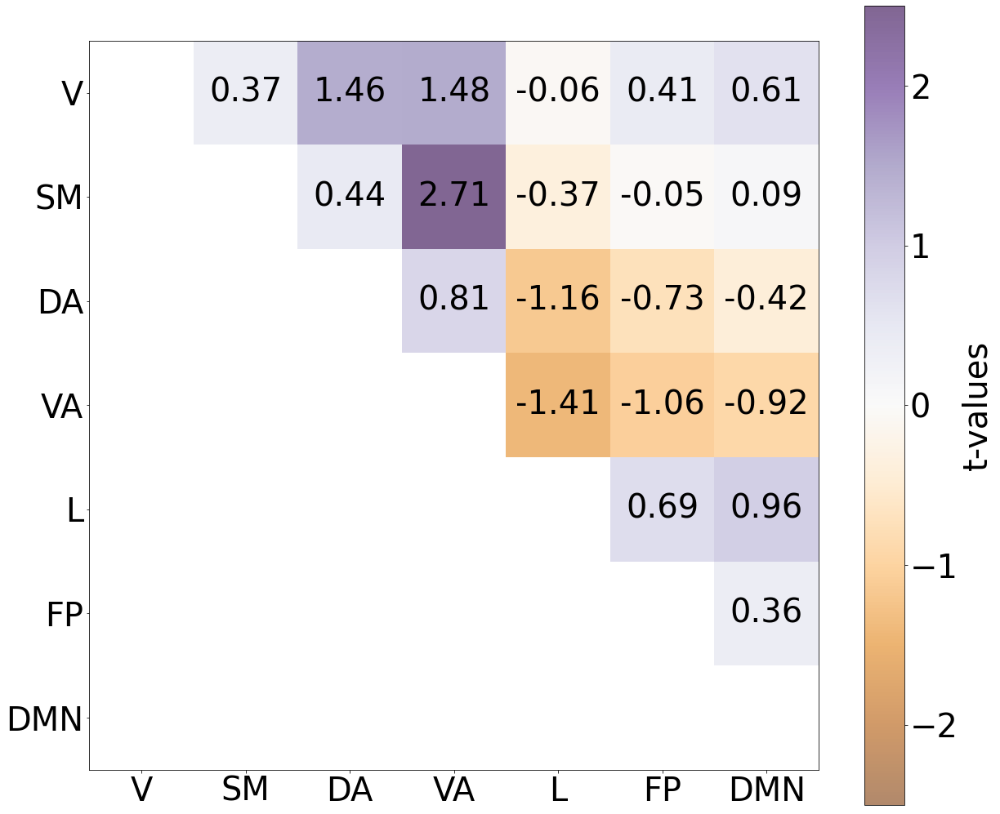

In [305]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_hormonal_contrast_res_suppl_Me, df_column_index_with_tvals=0, df_column_index_with_sigs=5, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='estr_suppl_Me', save_plot = True, output_dir = resdir_fig)

 Plot pairwise t-vals for testosterone

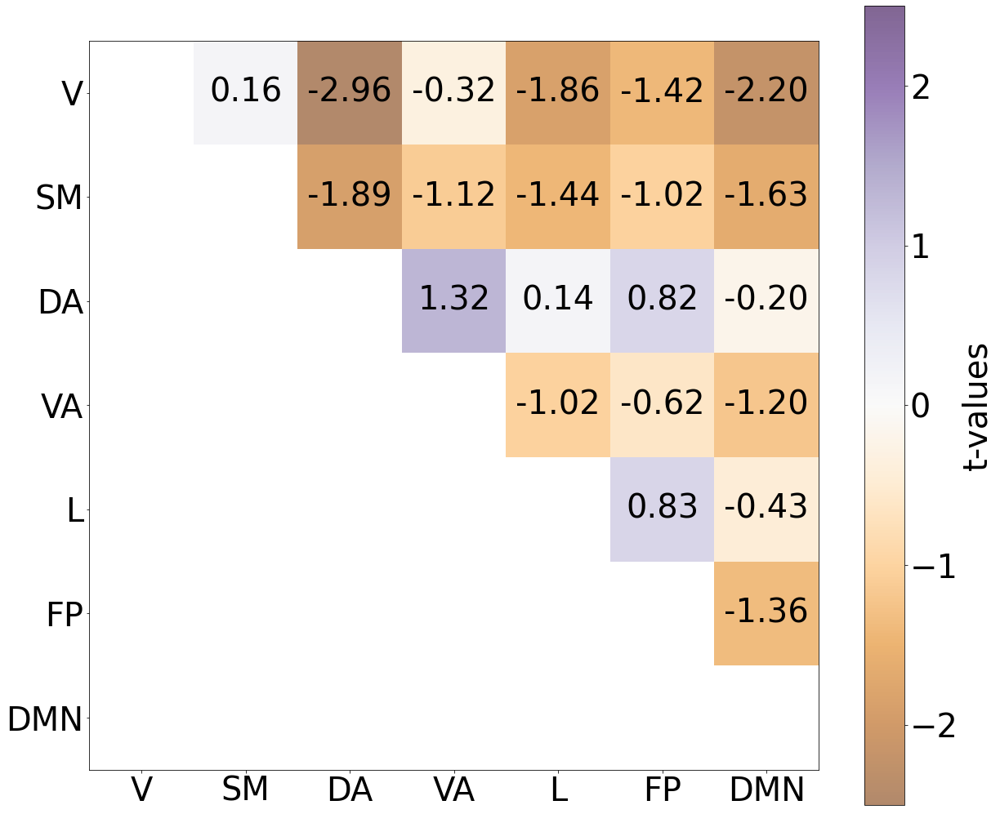

In [306]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_hormonal_contrast_res_suppl_Me, df_column_index_with_tvals=2, df_column_index_with_sigs=7, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='test_suppl_Me', save_plot = True, output_dir = resdir_fig)

## Dispersion Analyses (He AM) - hormonal effects

### Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

#### Computing within dispersion metric

In [307]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog_He_AM = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 20)
WN_dispersion_He_AM = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 20)


# gradient values
g1 = array_aligned_fc_He_AM_15_G1.T  # transpose to obtain shape (400 x 15) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_He_AM_net = np.median(G1_net, axis=0)  
    yeo_cog_He_AM.append(yeo_cog_He_AM_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_He_AM_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion_He_AM.append(sum_of_squares)
    
    
yeo_cog_He_AM = np.array(yeo_cog_He_AM)
WN_dispersion_He_AM = np.array(WN_dispersion_He_AM)

In [308]:
WN_dispersion_He_AM.shape

(7, 15)

#### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [309]:
WN_dispersion_He_AM.shape

(7, 15)

In [310]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion_He_AM[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28He_AM.z_estradiol_serum[:15], 'testosterone': hormones_28He_AM.z_total_testosterone_serum[:15]}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time[:15],
        exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol and testosterone 
    lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_p_val'].append(results.pvalues['testosterone']) 


lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM = pd.DataFrame(lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM)
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM = lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.set_index('yeo_network')

In [311]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val
yeo_network,,,,
visual,-1.154118,0.248452,0.906674,0.364579
sensory motor,-1.478383,0.139305,0.661001,0.508612
dorsal attention,0.122751,0.902304,0.121968,0.902924
ventral attention,-0.317298,0.751018,0.057457,0.954181
limbic,0.082485,0.934261,-0.227457,0.820068
fronto parietal,0.393882,0.693668,-0.656907,0.511240
DMN,0.278860,0.780352,-0.602686,0.546718


### Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [312]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_hormonal_contrast_res_suppl_He_AM = {'pairwise_comparison' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}



# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_hormonal_contrast_res_suppl_He_AM['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_hormonal_contrast_res_suppl_He_AM['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_hormonal_contrast_res_suppl_He_AM['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog_He_AM[n1] - yeo_cog_He_AM[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'estradiol': hormones_28He_AM.z_estradiol_serum[:15], 'testosterone': hormones_28He_AM.z_total_testosterone_serum[:15]}),  # fixed effects (covariate)
                groups = hormones_28He_AM.time[:15],
                exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of testosterone, cortisol (via indices) 
            BN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_t_val'].append(results.tvalues['estradiol'])
            BN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_p_val'].append(results.pvalues['estradiol']) 
            BN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_t_val'].append(results.tvalues['testosterone'])
            BN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_p_val'].append(results.pvalues['testosterone'])


BN_dispersion_hormonal_contrast_res_suppl_He_AM = pd.DataFrame(BN_dispersion_hormonal_contrast_res_suppl_He_AM)
BN_dispersion_hormonal_contrast_res_suppl_He_AM = BN_dispersion_hormonal_contrast_res_suppl_He_AM.set_index('pairwise_comparison')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


In [313]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_hormonal_contrast_res_suppl_He_AM.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_hormonal_contrast_res_suppl_He_AM['new_comparison_names'] = new_comparison_names
BN_dispersion_hormonal_contrast_res_suppl_He_AM = BN_dispersion_hormonal_contrast_res_suppl_He_AM.set_index('new_comparison_names')
BN_dispersion_hormonal_contrast_res_suppl_He_AM.index.name = 'pairwise_comparisons'

In [314]:
BN_dispersion_hormonal_contrast_res_suppl_He_AM

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val
pairwise_comparisons,,,,
visual - sensory motor,0.463362,0.643105,-1.121262,0.262177
visual - dorsal attention,-2.258977,0.023885,0.983960,0.325135
visual - ventral attention,-0.108231,0.913812,-0.108344,0.913723
visual - limbic,-0.156740,0.875450,-0.334820,0.737761
visual - fronto parietal,-0.212695,0.831565,0.013587,0.989160
visual - DMN,-0.098152,0.921812,-0.212370,0.831819
sensory motor - dorsal attention,-1.903477,0.056978,1.577960,0.114575
sensory motor - ventral attention,-0.606983,0.543862,0.897693,0.369349
sensory motor - limbic,-0.338176,0.735230,0.198088,0.842976


### EXPLORATORY gradient dispersion analysis

New metric of wholebrain gradient dispersion -> like WN but not per network - to assess effects on overall gradient expansion/contraction

In [315]:
# compute for each experimental day, across all networks / parcels a) gradient centroid position; b) gradient dispersion metric (higher value = wider distribution = more dispersion)

grad_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (N)


### identify the centroid / center of gravity (= median) gradient loading across all parcels for each experimental day (shape: N)
grad_cog = np.median(array_aligned_fc_He_AM_15_G1, axis=1)

### gradient dispersion: 1 value per experimental day
# compute (per experimental day) the Eucledian distance between each gradient loading and the gradient centroid
dist_nodes_to_cog = array_aligned_fc_He_AM_15_G1.T - grad_cog  # shape: number of parcels (400) x N

# take the sum of squares of this Eucledian distance 
gradient_dispersion_He_AM = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N

gradient_dispersion_He_AM = np.array(gradient_dispersion_He_AM)

In [215]:
gradient_dispersion_He_AM.shape

(15,)

In [222]:
print(f"Male\nMean = {np.mean(gradient_dispersion_He_AM)}\nSD = {np.std(gradient_dispersion_He_AM)}")

Male
Mean = 19086.706004921092
SD = 9755.848403086047


In [216]:
lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM = {'estradiol_t_val': [], 'estradiol_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': []}


# define model
model = sm.MixedLM(
    endog = gradient_dispersion_He_AM,  # dependent variable
    exog = pd.DataFrame({'estradiol': hormones_28He_AM.z_estradiol_serum[:15], 'testosterone': hormones_28He_AM.z_total_testosterone_serum[:15]}),  # fixed effects (covariate)
        groups = hormones_28He_AM.time[:15],
    exog_re = None,  # covariates random effects (should be hormones_28Me_excl26.ExperimentDay)
    exog_vc=None)

# fit model
results = model.fit()
#results.summary()

# save results of estradiol and testosterone 
lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_t_val'].append(results.tvalues['estradiol'])
lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_p_val'].append(results.pvalues['estradiol'])
lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_t_val'].append(results.tvalues['testosterone'])
lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_p_val'].append(results.pvalues['testosterone']) 


lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM = pd.DataFrame(lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM)

In [217]:
lmer_gradient_dispersion_hormonal_contrast_res_suppl_He_AM

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val
0,-0.307326,0.758596,0.172466,0.863071


#### Plotting variation in gradient dispersion (male vs female)

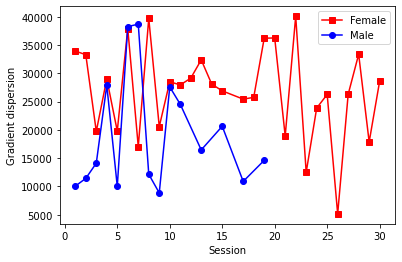

In [270]:
# Plotting the line graph
plt.plot(MC_day_no_nan, gradient_dispersion_MC_reindexed, marker='s', linestyle='-', color='r', label='Female')
plt.plot(np.array(hormones_28He_AM.session[:15]), gradient_dispersion_He_AM, marker='o', linestyle='-', color='b', label='Male')

plt.xlabel('Session')
plt.ylabel('Gradient dispersion')

plt.legend()

plt.show()


# considering ovulatory window being day 12-14

### Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

#### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_suppl_He_AM_estr_test.py

#### Load null distributions of t-values

In [316]:
WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl = pd.read_csv(resdir+'WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl.csv')
WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl = pd.read_csv(resdir+'WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl.csv')

BN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl = pd.read_csv(resdir+'BN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl.csv')
BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl = pd.read_csv(resdir+'BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl.csv')

#### Compute the spin p-values 

##### Within Network dispersion

Estradiol

In [317]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[network,'estradiol_p_val'] < 0.025/7:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl[network], score = lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[network, 'estradiol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[network, 'estradiol_t_val'] < np.median(WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
        
        

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


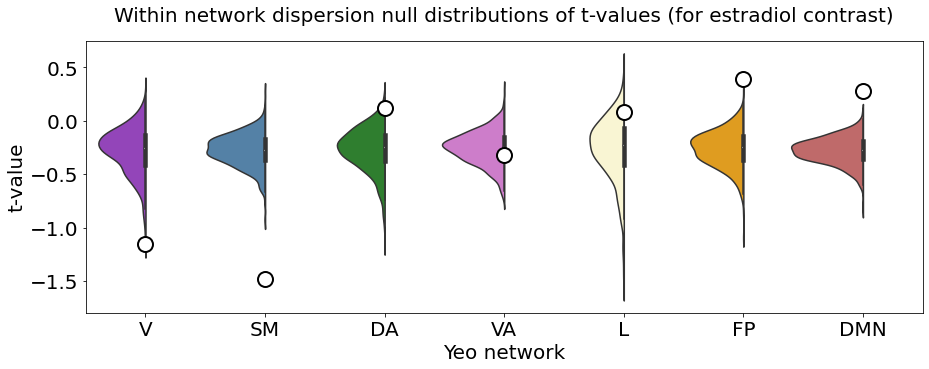

In [318]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl_long = pd.melt(WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl, 
                                                               value_vars = WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


violin = sns.violinplot(data = WN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl_long,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False,
                    width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))
               
               

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.estradiol_t_val, color='white', edgecolor='black',  size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for estradiol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

# save figure in directory 
plt.savefig(resdir_fig+'suppl_violin_WN_dispersion_null_distr_tvals_estradiol_He_AM.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

plt.show()

Testosterone

In [319]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.index:
    
    # first determine if given network passes significance post bonferroni
    if lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[network,'estradiol_p_val'] < 0.025/7:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl[network], score = lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[network, 'testosterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[network, 'testosterone_t_val'] < np.median(WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl[network]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected) - but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    
    # if the given network t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')
        

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone significance post Bonferroni (alpha=0.0036) and spin test'] = sig_post_bonferroni

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/seaborn/_core.py:1485: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


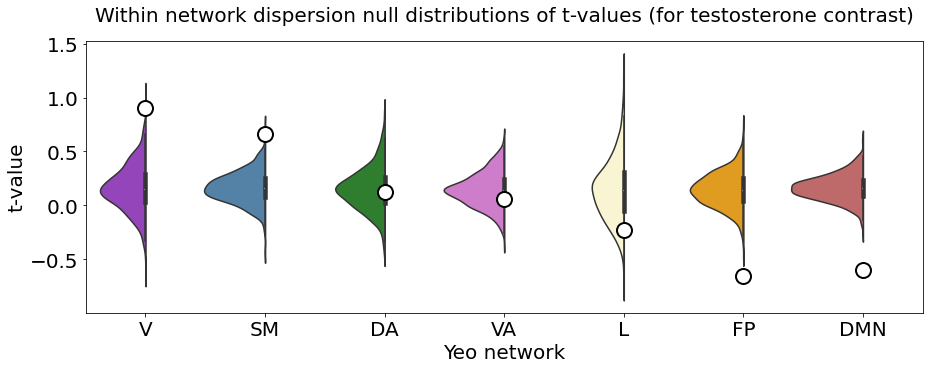

In [320]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl_long = pd.melt(WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl, 
                                                               value_vars = WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

# Create the violin plot
fig, ax = plt.subplots(figsize=(15, 5))

violin = sns.violinplot(data=WN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl_long,
                        x="yeo_network",
                        y="t_vals",
                        palette=palette_labeled_networks,
                        split=False,
                        width=1.2)


# Manually adjust violins to show only the left half
for b in violin.collections:
    path = b.get_paths()[0]
    path.vertices[:, 0] = np.clip(path.vertices[:, 0], -np.inf, np.median(path.vertices[:, 0]))


# Add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'],
              y=lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.testosterone_t_val,
              color='white', edgecolor='black', size=15, linewidth=2, jitter=False)    
    
ax.set_title("Within network dispersion null distributions of t-values (for testosterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network", fontsize=20)
ax.set_ylabel("t-value", fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels(np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0, ha="center")

# Save the figure in the directory
plt.savefig(resdir_fig+'suppl_violin_WN_dispersion_null_distr_tvals_testosterone_He_AM.png', dpi=300, bbox_inches="tight")

# Show the plot
plt.show()


##### Results

In [321]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val,estradiol_spin_p_val,estradiol significance post Bonferroni (alpha=0.0036) and spin test,testosterone_spin_p_val,testosterone significance post Bonferroni (alpha=0.0036) and spin test
yeo_network,,,,,,,,
visual,-1.154118,0.248452,0.906674,0.364579,NaN,not sig,NaN,not sig
sensory motor,-1.478383,0.139305,0.661001,0.508612,NaN,not sig,NaN,not sig
dorsal attention,0.122751,0.902304,0.121968,0.902924,NaN,not sig,NaN,not sig
ventral attention,-0.317298,0.751018,0.057457,0.954181,NaN,not sig,NaN,not sig
limbic,0.082485,0.934261,-0.227457,0.820068,NaN,not sig,NaN,not sig
fronto parietal,0.393882,0.693668,-0.656907,0.511240,NaN,not sig,NaN,not sig
DMN,0.278860,0.780352,-0.602686,0.546718,NaN,not sig,NaN,not sig


##### Export the results table

In [322]:
lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.to_csv(resdir+'lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.csv', header = True, index = True)

##### Between Network dispersion

In [323]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl.columns = new_col_names
BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl.columns = new_col_names

Estradiol

In [324]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res_suppl_He_AM.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[pairwise_comparison,'estradiol_p_val'] < 0.025/21:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[pairwise_comparison, 'estradiol_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[pairwise_comparison, 'estradiol_t_val'] < np.median(BN_dispersion_perm_tval_estradiol_contrast_null_distr_He_AM_suppl[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')   
        
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res_suppl_He_AM['estradiol significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

 Testosterone

In [325]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_hormonal_contrast_res_suppl_He_AM.index:
    
    # first determine if given network-pair t-value passes significance post bonferroni (before running spin)
    if BN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[pairwise_comparison,'estradiol_p_val'] < 0.025/21:
    
        # compute the percentile of our empirical t-value
        percentile_of_tval = stats.percentileofscore(a = BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl[pairwise_comparison], score = BN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[pairwise_comparison, 'testosterone_t_val'], kind='mean')/100


        # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
        if percentile_of_tval == 0 or percentile_of_tval == 1:
            spin_p_val.append(0.0001)
            sig_post_bonferroni.append('sig')


        else:

            # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
            # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
            if BN_dispersion_hormonal_contrast_res_suppl_He_AM.loc[pairwise_comparison, 'testosterone_t_val'] < np.median(BN_dispersion_perm_tval_testosterone_contrast_null_distr_He_AM_suppl[pairwise_comparison]):
                spin_p_val.append(round(percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if percentile_of_tval < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')



            # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
            else:
                spin_p_val.append(round(1 - percentile_of_tval, 3))

                # here we don't control for multiple comparisons becase we did at the step before (true p-value before spin test was bonferroni corrected)- but test is two tailed so significance level is 0.025
                if (1 - percentile_of_tval) < 0.025:
                    sig_post_bonferroni.append('sig')

                else:
                    sig_post_bonferroni.append('not sig')
    
    # if the given network-pair t-value does not pass significance post bonferroni (before running spin) -> don't even run spin
    else:
        spin_p_val.append(float('nan'))
        sig_post_bonferroni.append('not sig')   
        

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone_spin_p_val'] = spin_p_val
BN_dispersion_hormonal_contrast_res_suppl_He_AM['testosterone significance post Bonferroni (alpha= 0.001) and spin test'] = sig_post_bonferroni

In [326]:
BN_dispersion_hormonal_contrast_res_suppl_He_AM

,estradiol_t_val,estradiol_p_val,testosterone_t_val,testosterone_p_val,estradiol_spin_p_val,estradiol significance post Bonferroni (alpha= 0.001) and spin test,testosterone_spin_p_val,testosterone significance post Bonferroni (alpha= 0.001) and spin test
pairwise_comparisons,,,,,,,,
visual - sensory motor,0.463362,0.643105,-1.121262,0.262177,NaN,not sig,NaN,not sig
visual - dorsal attention,-2.258977,0.023885,0.983960,0.325135,NaN,not sig,NaN,not sig
visual - ventral attention,-0.108231,0.913812,-0.108344,0.913723,NaN,not sig,NaN,not sig
visual - limbic,-0.156740,0.875450,-0.334820,0.737761,NaN,not sig,NaN,not sig
visual - fronto parietal,-0.212695,0.831565,0.013587,0.989160,NaN,not sig,NaN,not sig
visual - DMN,-0.098152,0.921812,-0.212370,0.831819,NaN,not sig,NaN,not sig
sensory motor - dorsal attention,-1.903477,0.056978,1.577960,0.114575,NaN,not sig,NaN,not sig
sensory motor - ventral attention,-0.606983,0.543862,0.897693,0.369349,NaN,not sig,NaN,not sig
sensory motor - limbic,-0.338176,0.735230,0.198088,0.842976,NaN,not sig,NaN,not sig


##### Export the results table

In [327]:
BN_dispersion_hormonal_contrast_res_suppl_He_AM.to_csv(resdir+'lmer_BN_dispersion_hormonal_contrast_res_suppl_He_AM.csv', header = True, index = True)

 Plot pairwise t-vals for estradiol

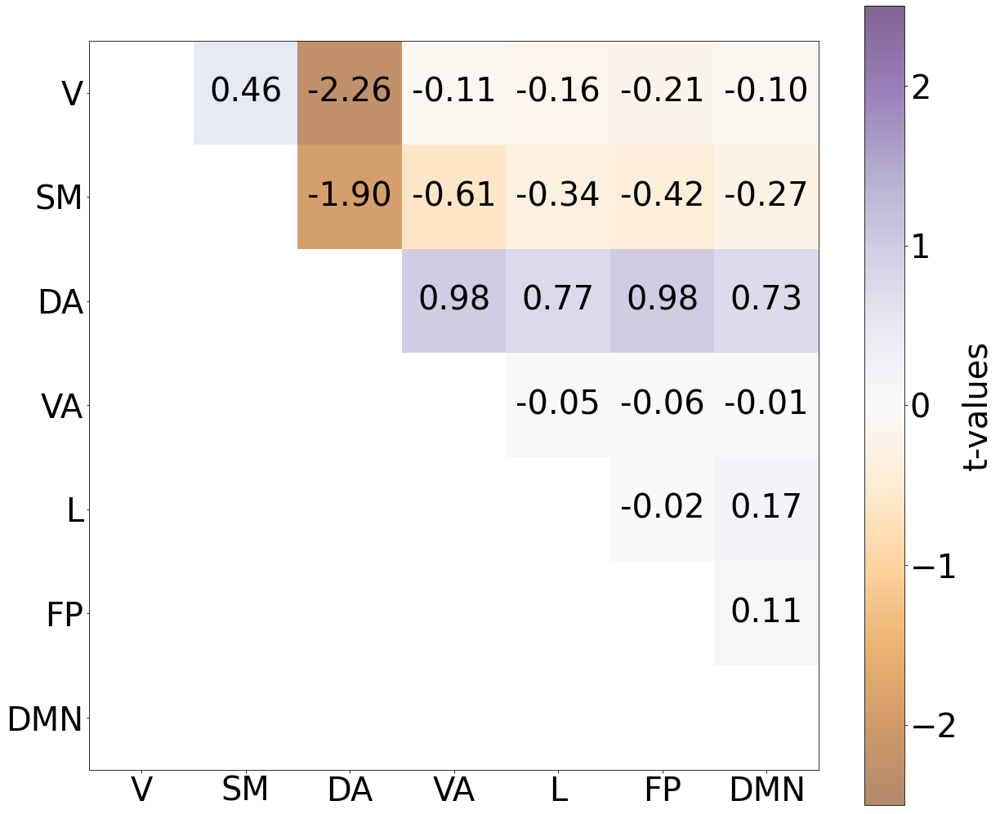

In [328]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_hormonal_contrast_res_suppl_He_AM, df_column_index_with_tvals=0, df_column_index_with_sigs=5, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='estr_suppl_He_AM', save_plot = True, output_dir = resdir_fig)

 Plot pairwise t-vals for testosterone

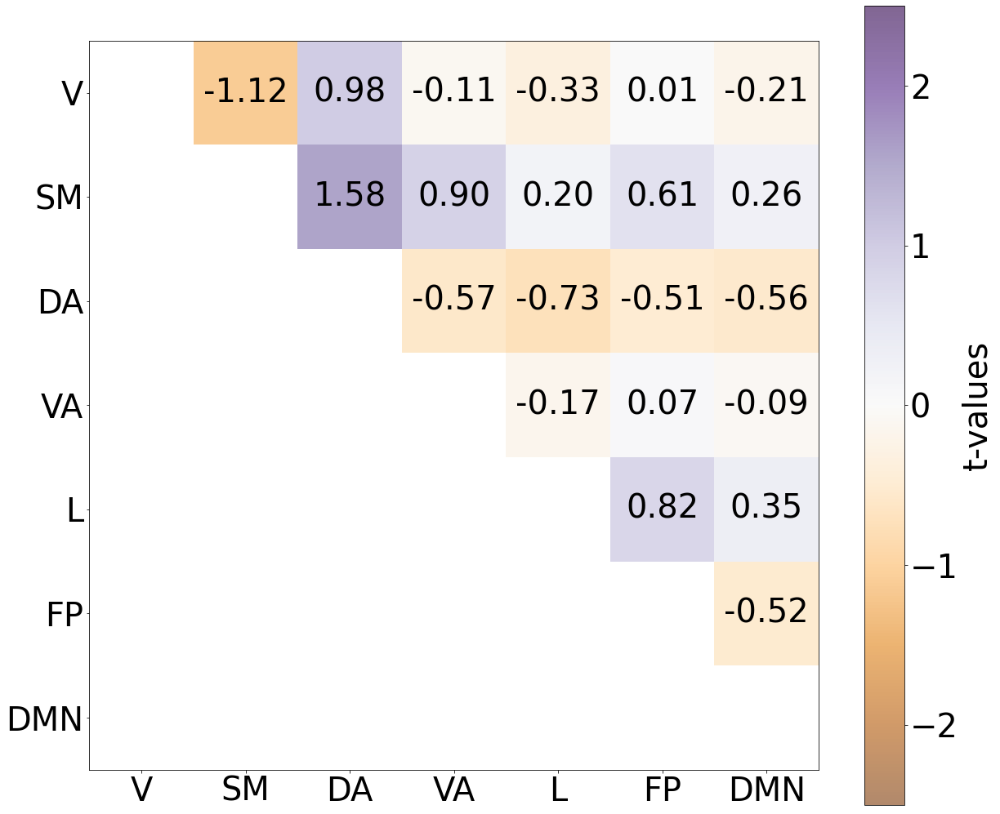

In [329]:
BN_dispersion_heatmap_matrix(BN_dispersion_contrast_res=BN_dispersion_hormonal_contrast_res_suppl_He_AM, df_column_index_with_tvals=2, df_column_index_with_sigs=7, colormap_vmin=-2.5, colormap_vmax=2.5, contrast_type='test_suppl_He_AM', save_plot = True, output_dir = resdir_fig)

## Heatmap plots for directionality of integration segregation effects

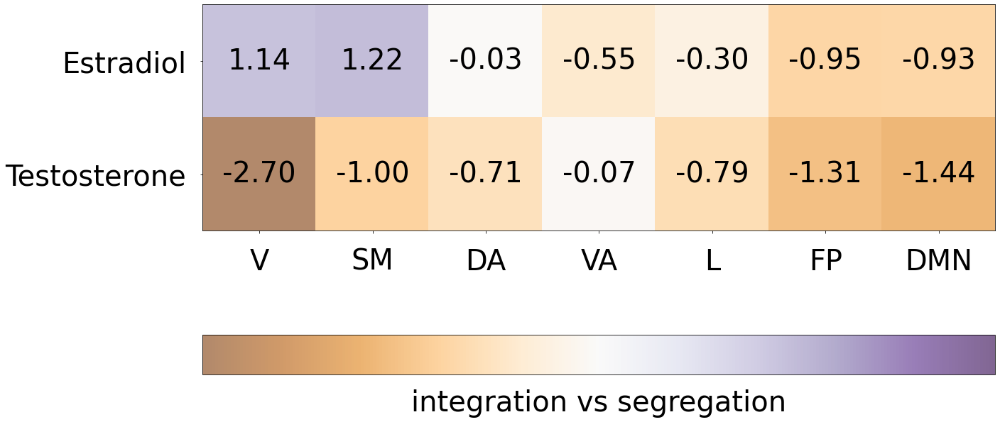

In [331]:
WN_results_to_plot_F_suppl = np.array([lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.estradiol_t_val.tolist(),lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.testosterone_t_val.tolist()])
WN_results_to_plot_corresp_spinp_val_F_suppl = np.array([lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.estradiol_spin_p_val.tolist(),lmer_WN_dispersion_hormonal_contrast_res_suppl_Me.testosterone_spin_p_val.tolist()])



plt.figure(figsize=(20, 18))

## If I want to plot the colormap with limits defined by min and max t values:
# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
#max_abs_value = np.max(np.abs(WN_results_to_plot_F_suppl))

# Give those min and max absolute values
#plt.imshow(WN_results_to_plot_F_suppl, cmap='PiYG', interpolation='none', vmin=-max_abs_value, vmax=max_abs_value)

# However, given that the null distributions aren't centered, using min and max abs values is leading to some very lightly colored significant t vals because close to 0 (where you cannot infer the direction clearly) 
# so specify vmin and vmax parameters in imshow to values that make the plot interpretation clearer (NEEDS TO BE THE SAME FOR MALE HEATMAP BECAUSE THEY WILL GO IN SAME FIGURE IN PAPER AND I WILL ONLY USE 1 COLORBAR LEGEND)
plt.imshow(WN_results_to_plot_F_suppl, cmap='PuOr', interpolation='none', vmin=-2.5, vmax=2.5, alpha=0.6)

colorbar = plt.colorbar(location="bottom")

# to display colorbar ticks
#colorbar.ax.tick_params(labelsize=40)  # Set the font size for the color bar ticks
#colorbar.set_label('t-values', fontsize=40)  # Set the font size for the color bar label

# to remove colorbar ticks (for plot visualization in Figure Manuscript)
colorbar.set_label('integration vs segregation', fontsize=40, labelpad=20)  # Set the font size for the color bar label
colorbar.set_ticks([])


plt.xticks(ticks=range(WN_results_to_plot_F_suppl.shape[1]), labels=np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0,  fontsize=40)
plt.yticks(ticks=range(WN_results_to_plot_F_suppl.shape[0]), labels=np.array(['Estradiol', 'Testosterone']), rotation=0,  fontsize=40)

# Set tick pad for x and y axes
plt.tick_params(axis='x', which='both', pad=20)
plt.tick_params(axis='y', which='both', pad=20)


# Add labels to the value
for i in range(WN_results_to_plot_F_suppl.shape[0]):
    for j in range(WN_results_to_plot_F_suppl.shape[1]):
        value = WN_results_to_plot_F_suppl[i, j]
        annotation = f'{value:.2f}'
        
        plt.annotate(annotation, xy=(j, i), color='black', ha='center', va='center', fontsize=40)
        
        if WN_results_to_plot_corresp_spinp_val_F_suppl[i, j] <= 0.025: # we don't correct for multiple comparisons here because we did before running spin
            plt.annotate('*', xy=(j, i - 0.25), color='red', ha='center', va='center', fontsize=40)
            
        

plt.savefig(resdir_fig+'suppl_WN_dispersion_heatmap_matrix_tvals_F_estr_test', dpi=300,  bbox_inches='tight')

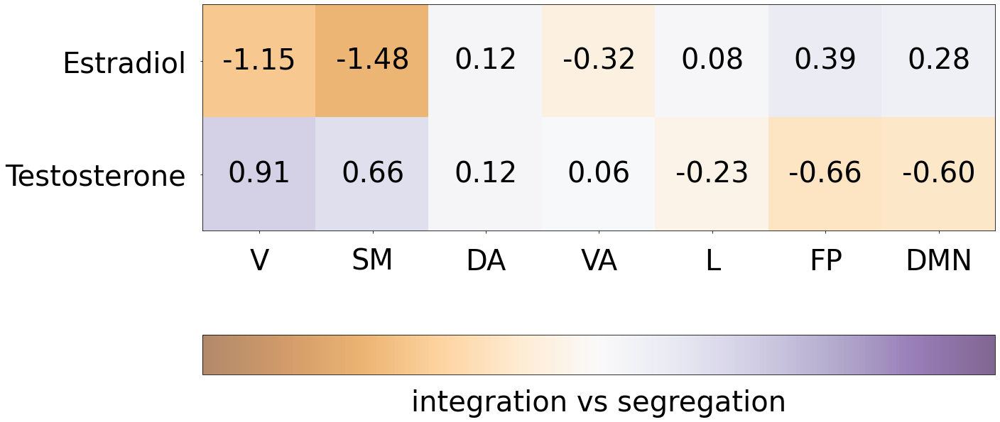

In [332]:
WN_results_to_plot_M_suppl = np.array([lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.estradiol_t_val.tolist(),lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.testosterone_t_val.tolist()])
WN_results_to_plot_corresp_spinp_val_M_suppl = np.array([lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.estradiol_spin_p_val.tolist(),lmer_WN_dispersion_hormonal_contrast_res_suppl_He_AM.testosterone_spin_p_val.tolist()])



plt.figure(figsize=(20, 18))

## If I want to plot the colormap with limits defined by min and max t values:
# Find the maximum absolute value in the data in order to center the colormap at zero using the max abs value as max and min
#max_abs_value = np.max(np.abs(WN_results_to_plot_M_suppl))

# Give those min and max absolute values
#plt.imshow(WN_results_to_plot_M_suppl, cmap='PiYG', interpolation='none', vmin=-max_abs_value, vmax=max_abs_value)

# However, given that the null distributions aren't centered, using min and max abs values is leading to some very lightly colored significant t vals because close to 0 (where you cannot infer the direction clearly) 
# so specify vmin and vmax parameters in imshow to values that make the plot interpretation clearer (NEEDS TO BE THE SAME FOR MALE HEATMAP BECAUSE THEY WILL GO IN SAME FIGURE IN PAPER AND I WILL ONLY USE 1 COLORBAR LEGEND)
plt.imshow(WN_results_to_plot_M_suppl, cmap='PuOr', interpolation='none', vmin=-2.5, vmax=2.5, alpha=0.6)

colorbar = plt.colorbar(location="bottom")

# to display colorbar ticks
#colorbar.ax.tick_params(labelsize=40)  # Set the font size for the color bar ticks
#colorbar.set_label('t-values', fontsize=40)  # Set the font size for the color bar label

# to remove colorbar ticks (for plot visualization in Figure Manuscript)
colorbar.set_label('integration vs segregation', fontsize=40, labelpad=20)  # Set the font size for the color bar label
colorbar.set_ticks([])


plt.xticks(ticks=range(WN_results_to_plot_M_suppl.shape[1]), labels=np.array(['V', 'SM', 'DA', 'VA', 'L', 'FP', 'DMN']), rotation=0,  fontsize=40)
plt.yticks(ticks=range(WN_results_to_plot_M_suppl.shape[0]), labels=np.array(['Estradiol', 'Testosterone']), rotation=0,  fontsize=40)

# Set tick pad for x and y axes
plt.tick_params(axis='x', which='both', pad=20)
plt.tick_params(axis='y', which='both', pad=20)


# Add labels to the value
for i in range(WN_results_to_plot_M_suppl.shape[0]):
    for j in range(WN_results_to_plot_M_suppl.shape[1]):
        value = WN_results_to_plot_M_suppl[i, j]
        annotation = f'{value:.2f}'
        
        plt.annotate(annotation, xy=(j, i), color='black', ha='center', va='center', fontsize=40)
        
        if WN_results_to_plot_corresp_spinp_val_M_suppl[i, j] <= 0.025: # we don't correct for multiple comparisons here because we did before running spin
            plt.annotate('*', xy=(j, i - 0.25), color='red', ha='center', va='center', fontsize=40)
            

plt.savefig(resdir_fig+'suppl_WN_dispersion_heatmap_matrix_tvals_M_estr_test', dpi=300,  bbox_inches='tight')

#
# He AM&PM -> effect time of the day

## Building gradients (He; AM & PM)

### Mean gradient

#### Reorder to have AM timepoints first, and PM timempoints second

In [121]:
hormones_28He_ordered = pd.concat([hormones_28He_AM, hormones_28He_PM], axis=0)

In [122]:
fc_matrices_He_ordered = np.concatenate((fc_matrices_He_AM, fc_matrices_He_PM), axis = 0)

In [123]:
fc_matrices_He_ordered.shape

(40, 400, 400)

#### Build mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


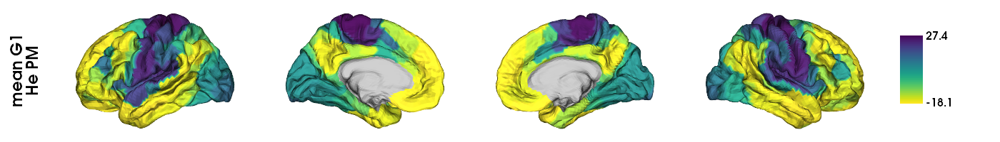

In [124]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_ordered = sum(fc_matrices_He_ordered)/len(fc_matrices_He_ordered)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_He = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_He = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_He.fit(mean_fc_matrix_He_ordered)

# mean G1
mean_fc_G1_He = mean_fc_grad_He.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range =,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_mean_G1.png')

plotted_hemispheres

### Aligned gradients

In [125]:
compute_aligned_grad_He = compute_aligned_gradients(fc_matrices_He_ordered, mean_fc_grad_He.gradients_) 

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_G1 = compute_aligned_grad_He['array_aligned_G1']

#### Export gradient to csv for R and dispersion analyses

## MixedLM (He AM&PM) -> taking saliva hormone levels to have full 40 data points

In [126]:
# add column to do the grouping by
hormones_28He_ordered['group'] = 1

# add column with numerical time of the day in order to include time of the day as fixed effect (model won't take str values)
hormones_28He_ordered['time_num'] = np.where(hormones_28He_ordered['time']== 'Morning', 0, 1)

In [143]:
lmer_res_He = {'parcel' : [], 'time_t_val' : [], 'time_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'time': hormones_28He_ordered.time_num, 'testosterone': hormones_28He_ordered.z_total_testosterone_saliva, 'cortisol': hormones_28He_ordered.z_cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_ordered.group,  # the same across timepoints 
        exog_re = hormones_28He_ordered.day,  # covariates random effects: the day of sampling 
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results via indices
    lmer_res_He['parcel'].append(i)
    lmer_res_He['time_t_val'].append(results.tvalues['time'])
    lmer_res_He['time_p_val'].append(results.pvalues['time'])
    lmer_res_He['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He['cortisol_p_val'].append(results.pvalues['cortisol']) 
    
    
lmer_res_He['time_q_val'] = fdrcorrection(lmer_res_He['time_p_val'], alpha=0.05)[1]   
lmer_res_He['testosterone_q_val'] = fdrcorrection(lmer_res_He['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He['cortisol_q_val'] = fdrcorrection(lmer_res_He['cortisol_p_val'], alpha=0.05)[1]


lmer_res_He = pd.DataFrame(lmer_res_He)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimi

In [144]:
lmer_res_He

,parcel,time_t_val,time_p_val,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,time_q_val,testosterone_q_val,cortisol_q_val
0,0,-0.988722,0.322799,-0.141763,0.887267,-1.045679,0.295709,NaN,0.998909,0.722404
1,1,-1.251681,0.210686,-0.481503,0.630159,-0.084766,0.932447,NaN,0.998909,0.989065
2,2,0.230665,0.817575,-0.471417,0.637343,2.797253,0.005154,NaN,0.998909,0.137438
3,3,-0.571473,0.567679,-0.108588,0.913529,0.260013,0.794853,NaN,0.998909,0.944541
4,4,-0.196268,0.844400,-0.095358,0.924030,1.740614,0.081751,NaN,0.998909,0.545009
...,...,...,...,...,...,...,...,...,...,...
395,395,0.640643,0.521755,0.397742,0.690821,-0.293969,0.768782,NaN,0.998909,0.937538
396,396,0.040998,0.967298,0.494936,0.620645,-0.915549,0.359904,NaN,0.998909,0.780199
397,397,2.164888,0.030396,-1.266400,0.205370,-0.386052,0.699458,NaN,0.998909,0.920339
398,398,0.382891,0.701800,0.202063,0.839867,-0.526648,0.598438,NaN,0.998909,0.904519


In [145]:
np.where(np.array(lmer_res_He.time_q_val) < 0.05)[0].shape

(0,)

In [146]:
np.where(np.array(lmer_res_He.testosterone_q_val) < 0.05)[0].shape

(5,)

In [147]:
np.where(np.array(lmer_res_He.cortisol_q_val) < 0.05)[0].shape

(5,)

In [148]:
np.isnan(lmer_res_He.time_p_val).any()

True

In [149]:
np.isnan(lmer_res_He.testosterone_p_val).any()

False

In [150]:
np.isnan(lmer_res_He.cortisol_p_val).any()

False

In [151]:
np.argwhere(np.isnan(np.array(lmer_res_He['time_p_val'])))

array([[ 78],
       [314]])

In [152]:
np.argwhere(np.isnan(np.array(lmer_res_He['testosterone_p_val'])))

array([], shape=(0, 1), dtype=int64)

In [153]:
lmer_res_He = {'parcel' : [], 'time_t_val' : [], 'time_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'time': hormones_28He_ordered.time_num}),  # fixed effects (covariate)
        groups = hormones_28He_ordered.group,  # the same across timepoints
        exog_re = hormones_28He_ordered.day,  # covariates random effects: the day of sampling 
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_He['parcel'].append(i)
    lmer_res_He['time_t_val'].append(results.tvalues['time'])
    lmer_res_He['time_p_val'].append(results.pvalues['time'])
    
lmer_res_He['time_q_val'] = fdrcorrection(lmer_res_He['time_p_val'], alpha=0.05)[1]   

lmer_res_He = pd.DataFrame(lmer_res_He)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random ef

In [154]:
lmer_res_He

,parcel,time_t_val,time_p_val,time_q_val
0,0,-1.070564,0.284365,0.708379
1,1,-1.233687,0.217320,0.708379
2,2,0.533708,0.593544,0.830534
3,3,-0.549057,0.582966,0.830534
4,4,-0.278314,0.780771,0.902591
...,...,...,...,...
395,395,0.579637,0.562159,0.826705
396,396,-0.117428,0.906521,0.980022
397,397,1.339583,0.180381,0.708379
398,398,0.326814,0.743809,0.902591


In [155]:
np.where(np.array(lmer_res_He.time_q_val) < 0.05)[0].shape

(2,)

In [156]:
np.isnan(lmer_res_He.time_p_val).any()

False

#
# Correlations (inter- and intra-) individual differences in variability and hormonal effects

## Associations with INTER-individual differences

### Hormonal effects on female G1

#### Estradiol

In [111]:
stats.spearmanr(lmer_res_excl26.estradiol_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=0.1298940618378865, pvalue=0.009301253250183869)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1445


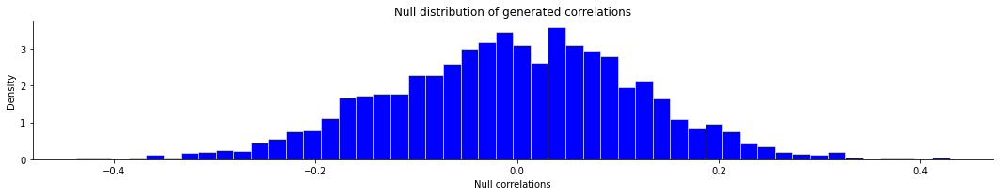

{'spin_test_p': 0.1445,
 'spin_test_d': array([ 0.07033256,  0.14097827, -0.15346235, ...,  0.1151333 ,
         0.06018663, -0.1627055 ])}

In [99]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.estradiol_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

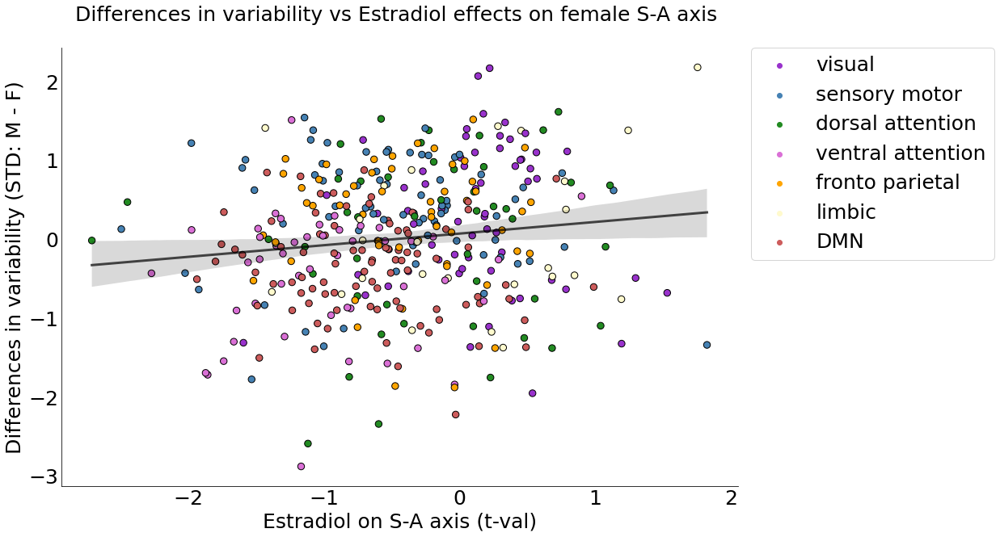

In [407]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Estradiol on S-A axis (t-val)': lmer_res_excl26.estradiol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Estradiol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Estradiol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Estradiol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Estradiol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_estr_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Progesterone

In [101]:
stats.spearmanr(lmer_res_excl26.progesterone_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=0.03853486584291151, pvalue=0.4421480743559699)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3255


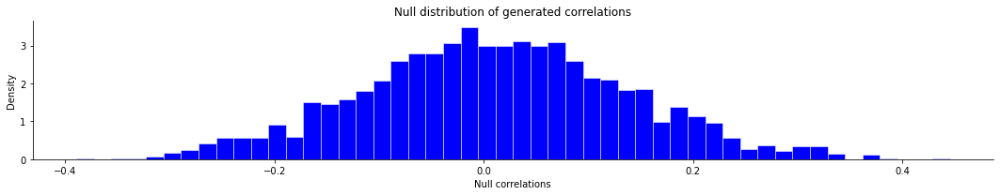

{'spin_test_p': 0.3255,
 'spin_test_d': array([-0.01672199, -0.02845452, -0.00041751, ...,  0.15070667,
         0.06035365,  0.00323584])}

In [102]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.progesterone_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

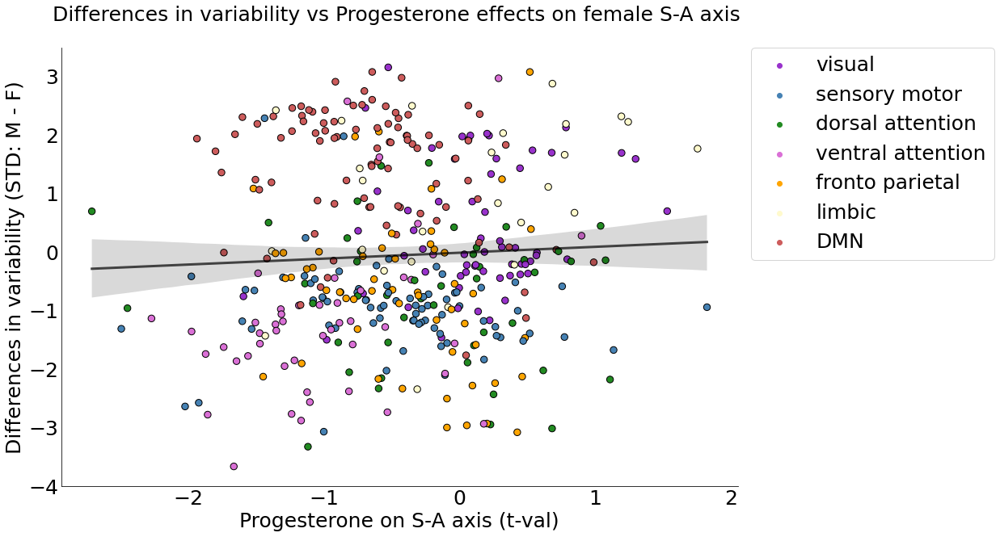

In [408]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Progesterone on S-A axis (t-val)': lmer_res_excl26.progesterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Progesterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Progesterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Progesterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Progesterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_prog_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

### Hormonal effects on male G1

#### Testosterone

In [114]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=-0.11393489959312245, pvalue=0.022667508477198627)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.291


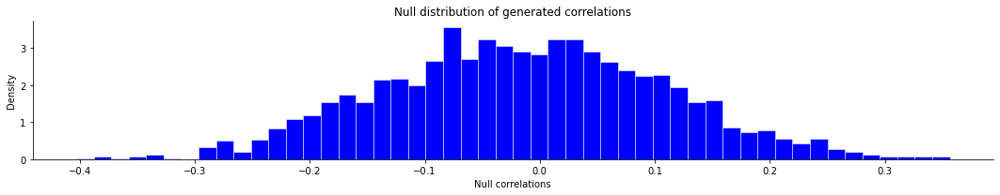

{'spin_test_p': 0.291,
 'spin_test_d': array([ 0.07028257,  0.03463393, -0.11717551, ...,  0.01613745,
        -0.02857978,  0.10482036])}

In [115]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.testosterone_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

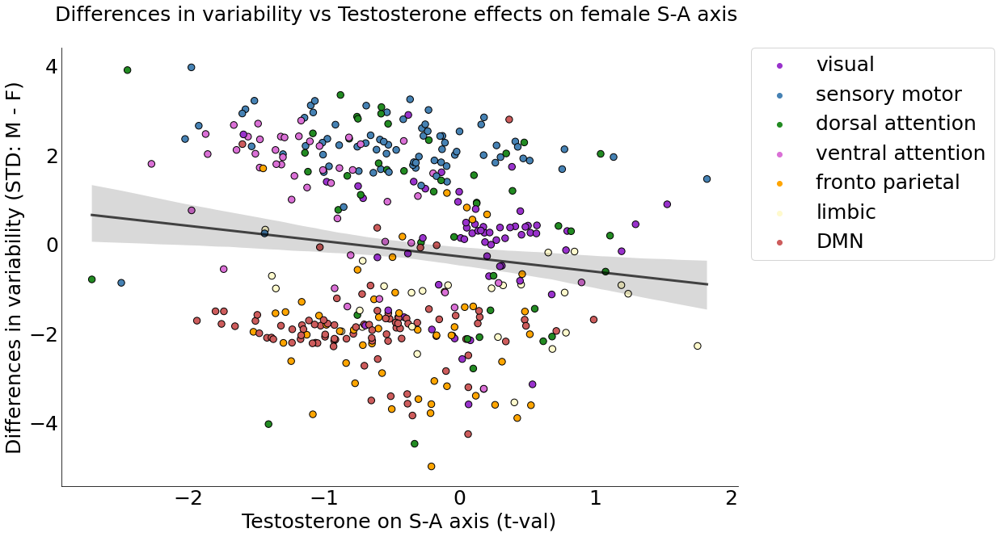

In [116]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Testosterone on S-A axis (t-val)': lmer_res_He_AM.testosterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Testosterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Testosterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Testosterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Testosterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_test_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Cortisol

In [117]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=-0.3244353402208764, pvalue=2.9488354678778704e-11)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0045000000000000005


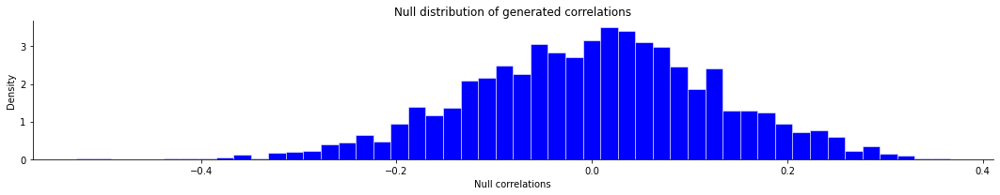

{'spin_test_p': 0.0045000000000000005,
 'spin_test_d': array([-0.10077034, -0.05375502,  0.02411223, ..., -0.00202501,
         0.08256613,  0.15922423])}

In [118]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.cortisol_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

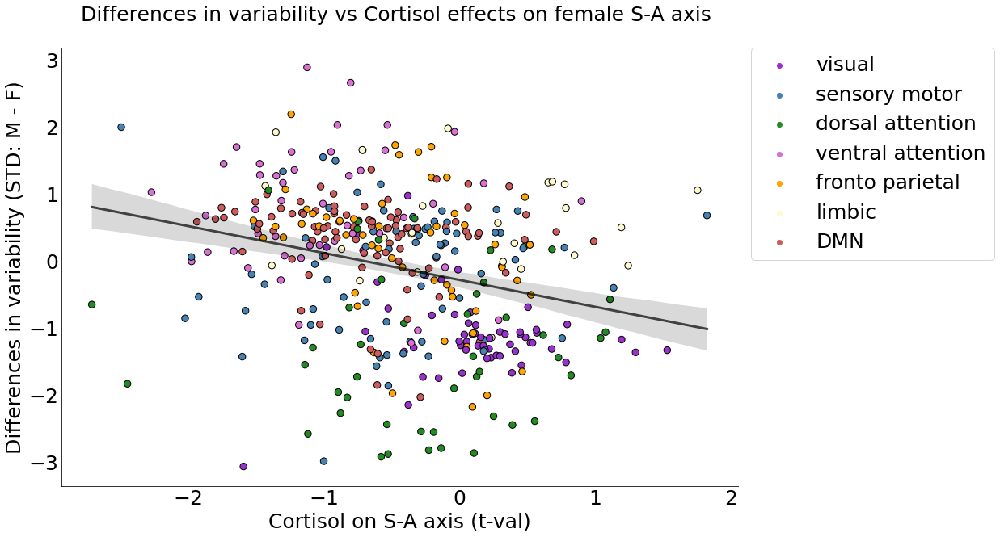

In [119]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Cortisol on S-A axis (t-val)': lmer_res_He_AM.cortisol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Cortisol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Cortisol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Cortisol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Cortisol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_cort_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

## Associations with INTRA-individual differences

In [112]:
Me_G1_excl26_std =  np.std(array_aligned_fc_G1_excl26, axis=0)
He_AM_G1_std = np.std(array_aligned_fc_He_AM_G1, axis=0)

### Hormonal effects on female G1

#### Estradiol

In [111]:
stats.spearmanr(lmer_res_excl26.estradiol_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=0.1298940618378865, pvalue=0.009301253250183869)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.22


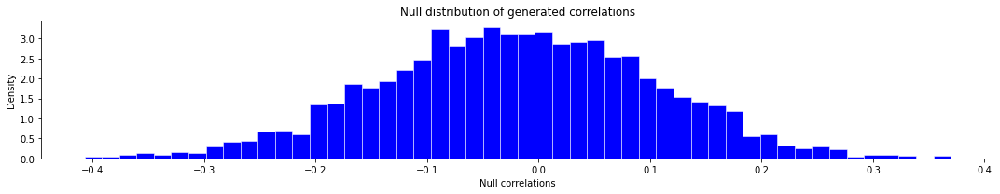

{'spin_test_p': 0.22,
 'spin_test_d': array([-0.16857686, -0.00277656, -0.12507046, ..., -0.14185508,
         0.04711801,  0.17116553])}

In [120]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.estradiol_t_val, y = Me_G1_excl26_std, correlation_type = 'spearman')

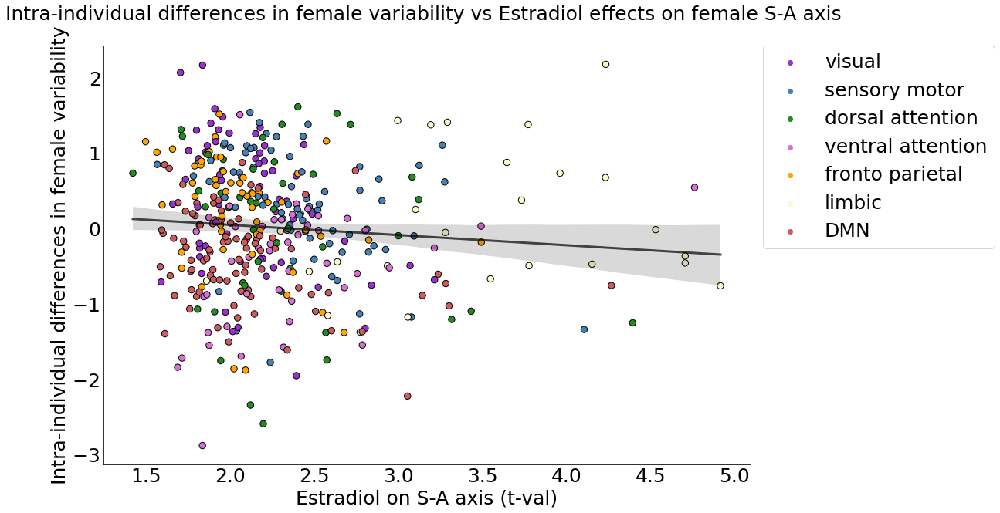

In [121]:
df = pd.DataFrame({'Intra-individual differences in female variability':  Me_G1_excl26_std, 'Estradiol on S-A axis (t-val)': lmer_res_excl26.estradiol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in female variability', y = 'Estradiol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in female variability', y = 'Estradiol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Intra-individual differences in female variability vs Estradiol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Estradiol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in female variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_Me_vs_estr_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Progesterone

In [122]:
stats.spearmanr(lmer_res_excl26.progesterone_t_val, Me_G1_excl26_std)

SpearmanrResult(correlation=-0.1730272064200401, pvalue=0.0005090149843001901)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.052500000000000005


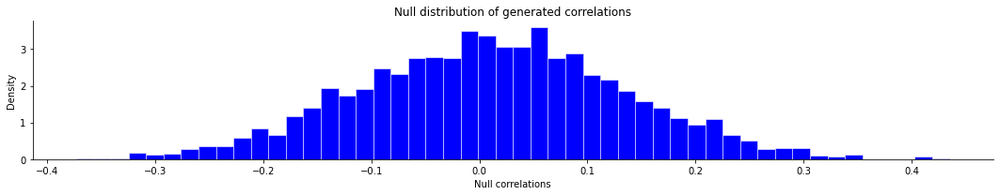

{'spin_test_p': 0.052500000000000005,
 'spin_test_d': array([-0.05951859,  0.04617656, -0.21095593, ..., -0.08786873,
        -0.04824534, -0.14995512])}

In [123]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.progesterone_t_val, y = Me_G1_excl26_std, correlation_type = 'spearman')

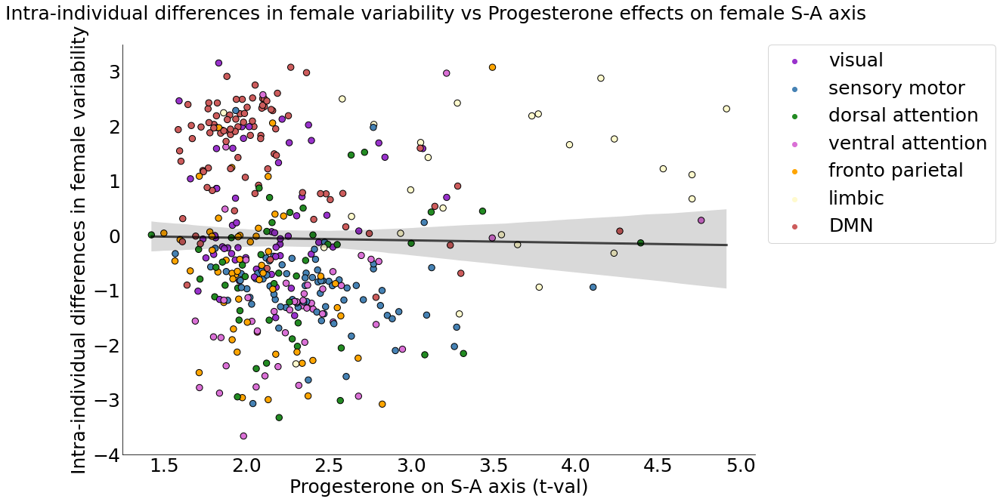

In [124]:
df = pd.DataFrame({'Intra-individual differences in female variability':  Me_G1_excl26_std, 'Progesterone on S-A axis (t-val)': lmer_res_excl26.progesterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in female variability', y = 'Progesterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in female variability', y = 'Progesterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Intra-individual differences in female variability vs Progesterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Progesterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in female variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_Me_vs_prog_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

### Hormonal effects on male G1

#### Testosterone

In [125]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, He_AM_G1_std)

SpearmanrResult(correlation=0.2578292989331183, pvalue=1.7032129877284123e-07)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0645


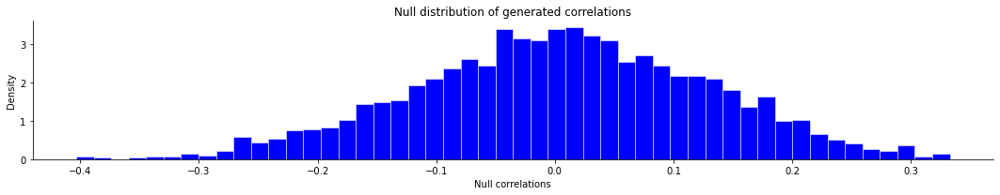

{'spin_test_p': 0.0645,
 'spin_test_d': array([ 0.04624121, -0.16465209,  0.17099852, ..., -0.08277489,
         0.01004154, -0.05233711])}

In [126]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.testosterone_t_val, y = He_AM_G1_std, correlation_type = 'spearman')

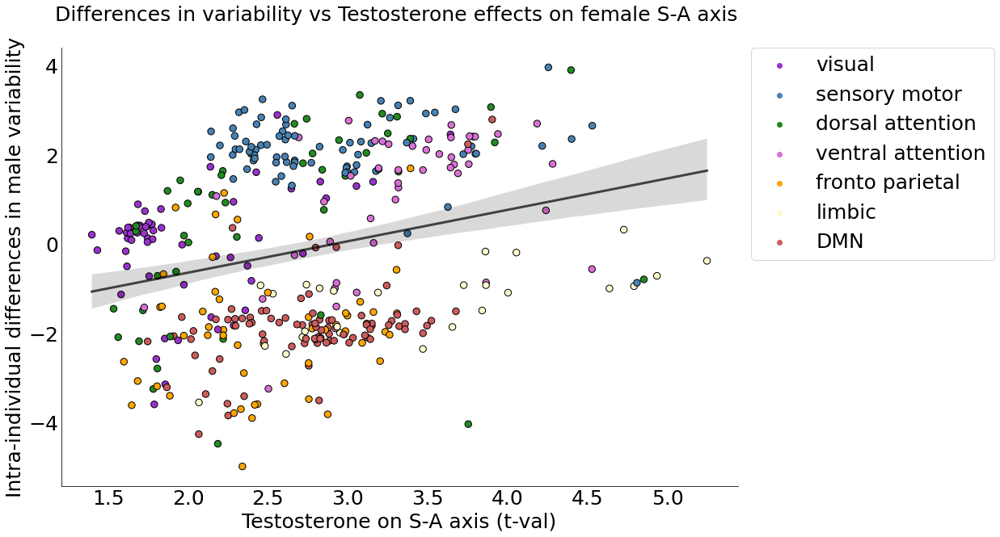

In [127]:
df = pd.DataFrame({'Intra-individual differences in male variability':  He_AM_G1_std, 'Testosterone on S-A axis (t-val)': lmer_res_He_AM.testosterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in male variability', y = 'Testosterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in male variability', y = 'Testosterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Testosterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Testosterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in male variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_He_AM_vs_test_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Cortisol

In [129]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, He_AM_G1_std)

SpearmanrResult(correlation=0.4557714735717098, pvalue=6.530679100196468e-22)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


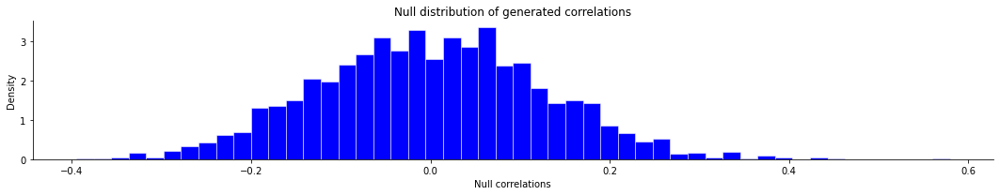

{'spin_test_p': 0.001,
 'spin_test_d': array([ 0.10502912,  0.03133546,  0.02469677, ...,  0.09743012,
        -0.07341997, -0.20314816])}

In [130]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.cortisol_t_val, y = He_AM_G1_std, correlation_type = 'spearman')

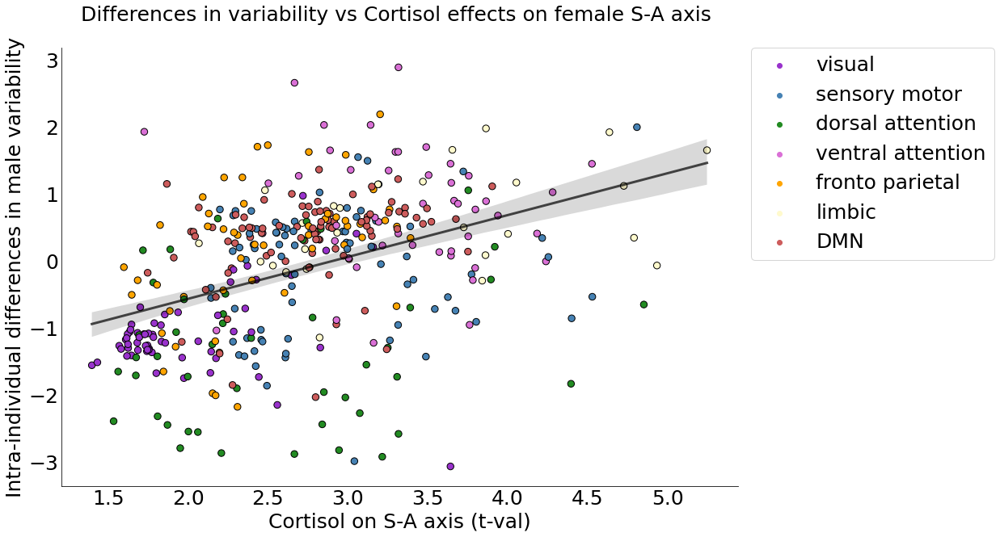

In [128]:
df = pd.DataFrame({'Intra-individual differences in male variability':  He_AM_G1_std, 'Cortisol on S-A axis (t-val)': lmer_res_He_AM.cortisol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in male variability', y = 'Cortisol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in male variability', y = 'Cortisol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Cortisol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Cortisol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in male variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_He_AM_vs_cort_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#
# He; PM

## Mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


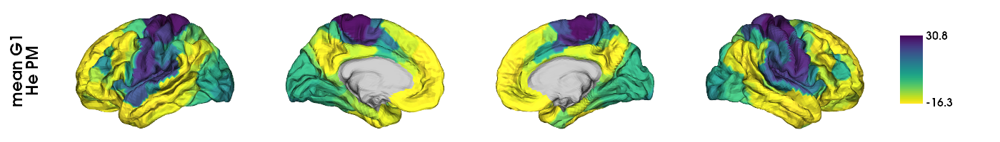

In [ ]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_PM = sum(fc_matrices_He_PM)/len(fc_matrices_He_PM)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_He_PM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_He_PM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_He_PM.fit(mean_fc_matrix_He_PM)

# mean G1
mean_fc_G1_He_PM = mean_fc_grad_He_PM.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_PM_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He_PM, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_PM_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range =,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_PM_mean_G1.png')

plotted_hemispheres

## Aligned gradients

In [ ]:
compute_aligned_grad_He_PM = compute_aligned_gradients(fc_matrices_He_PM, mean_fc_grad_He_PM.gradients_) 

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_PM_G1 = compute_aligned_grad_He_PM['array_aligned_G1']

### Export gradient to csv for R and dispersion analyses

In [ ]:
# fmt = decimals, 
# header = str(list(range(1,401)))[1:-1] ->header = 1 to 400 (without the first and last string letter because it's the [] of the list -> only use for R export, np.genfromtxt will read it as an additional line which is wrong
# comments = empty because otherwise gives a #


np.savetxt(resdir+'array_aligned_fc_He_PM_G1.csv', array_aligned_fc_He_PM_G1, delimiter=',', fmt = '%.16g', comments = '')

## Variability in gradients

### Visualize daily gradients

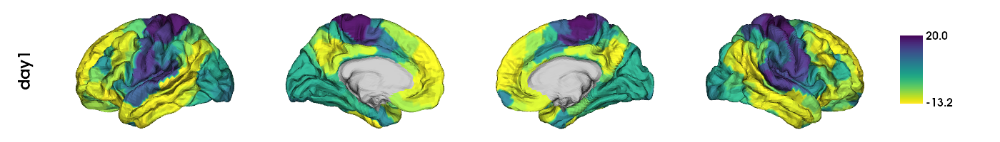

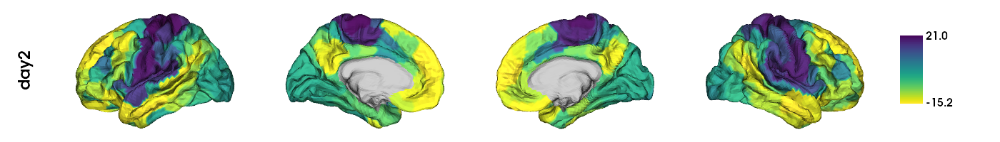

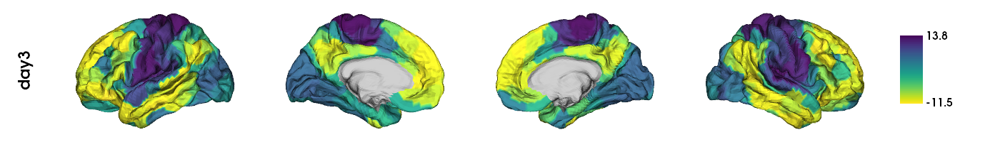

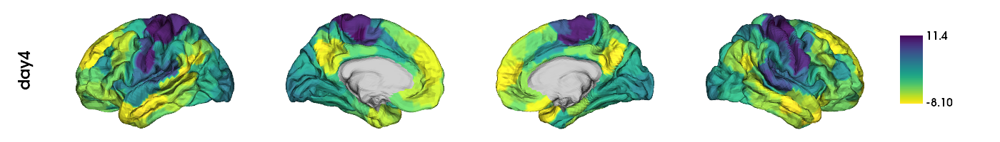

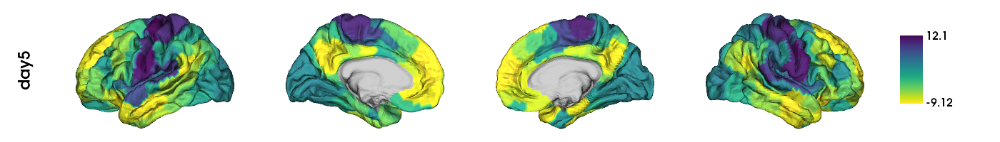

...

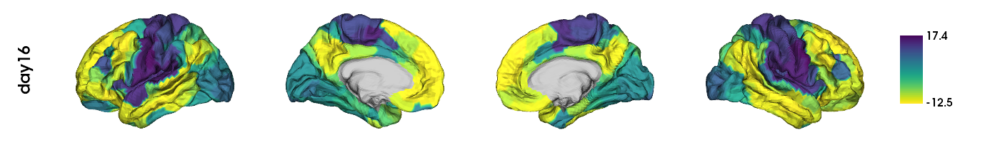

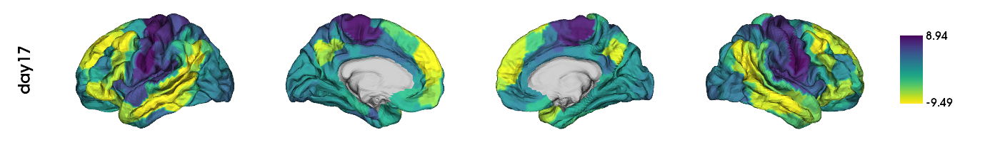

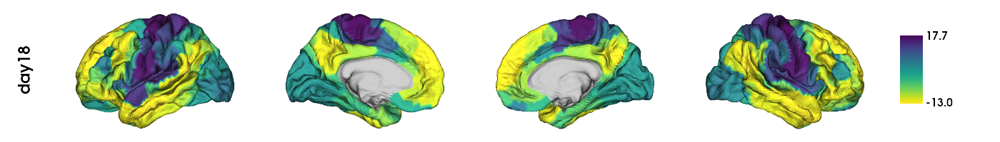

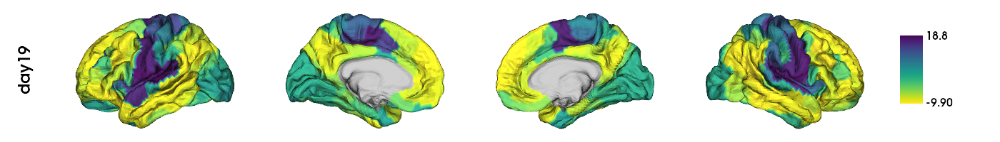

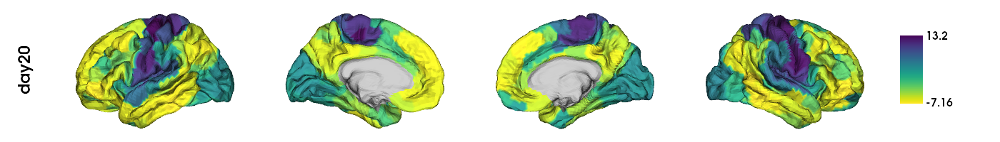

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_He_PM_G1)):
    
    # transform to fs5 for plotting
    fc_He_PM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_He_PM_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_He_PM_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

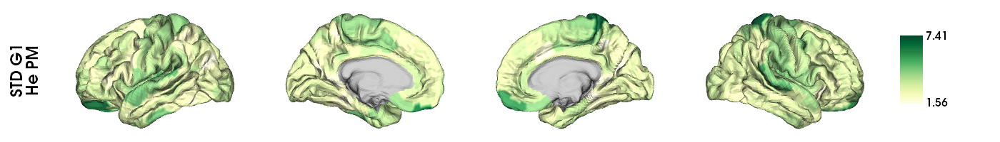

In [ ]:
# compute the standard deviation across days per parcel
std_fc_He_PM_G1 = np.std(array_aligned_fc_He_PM_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_He_PM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_He_PM_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_He_PM_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nHe PM"],
    zoom = 1.45)

plotted_hemispheres

2023-10-04 23:58:18,623 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


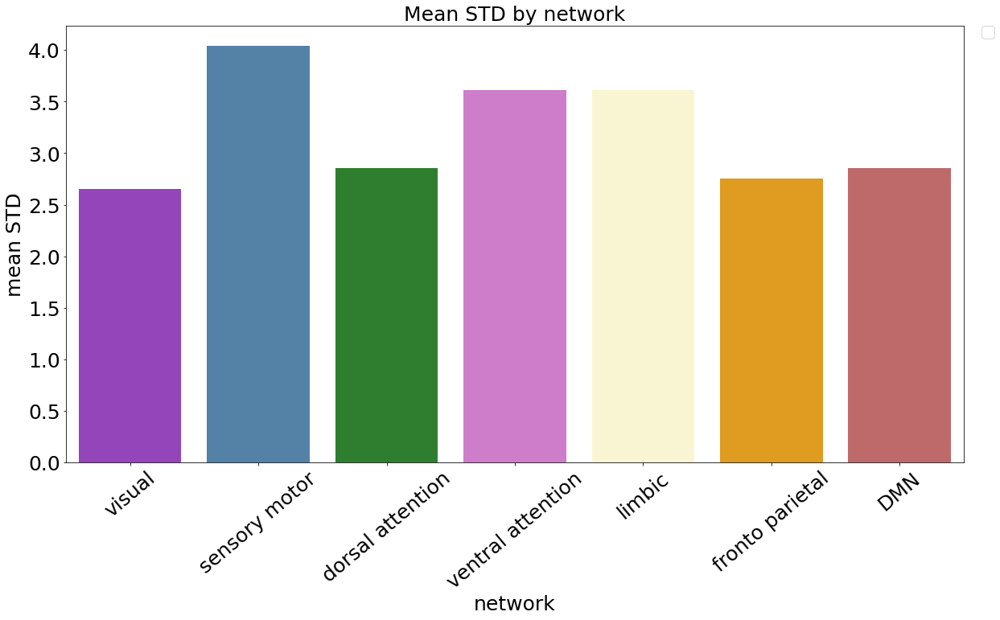

In [ ]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_He_PM_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_He_PM_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


## MixedLM (He PM)

### Run model - hormones

In [ ]:
lmer_res_He_PM = {'parcel' : [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_PM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'testosterone': hormones_28He_PM.z_total_testosterone_saliva, 'cortisol': hormones_28He_PM.z_cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_PM.time,  # the same across timepoints
        exog_re = None,  # covariates random effects (should be hormones_28He_PM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_He_PM['parcel'].append(i)
    lmer_res_He_PM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He_PM['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He_PM['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He_PM['cortisol_p_val'].append(results.pvalues['cortisol']) 

lmer_res_He_PM['testosterone_q_val'] = fdrcorrection(lmer_res_He_PM['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He_PM['cortisol_q_val'] = fdrcorrection(lmer_res_He_PM['cortisol_p_val'], alpha=0.05)[1]

lmer_res_He_PM = pd.DataFrame(lmer_res_He_PM)

In [ ]:
lmer_res_He_PM

,parcel,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_q_val,cortisol_q_val
0,0,0.439118,0.660576,-1.113989,0.265284,0.996003,0.996804
1,1,0.029405,0.976542,-0.025561,0.979607,0.996003,0.996804
2,2,-0.408628,0.682813,3.204407,0.001353,0.996003,0.457021
3,3,0.729201,0.465879,-0.241779,0.808952,0.996003,0.996804
4,4,-0.307105,0.758763,1.884556,0.059490,0.996003,0.996804
...,...,...,...,...,...,...,...
395,395,-0.750342,0.453049,0.472119,0.636842,0.996003,0.996804
396,396,-0.457523,0.647295,0.221244,0.824903,0.996003,0.996804
397,397,-0.939312,0.347571,-0.587740,0.556707,0.996003,0.996804
398,398,-1.376593,0.168638,0.622613,0.533539,0.996003,0.996804


In [ ]:
np.where(np.array(lmer_res_He_PM.testosterone_q_val) < 0.05)[0].shape

(0,)

In [ ]:
np.where(np.array(lmer_res_He_PM.cortisol_q_val) < 0.05)[0].shape

(0,)

In [ ]:
np.isnan(lmer_res_He_PM.testosterone_p_val).any()

False

In [ ]:
np.isnan(lmer_res_He_PM.cortisol_p_val).any()

False

In [ ]:
np.argwhere(np.isnan(np.array(lmer_res_He_PM['testosterone_p_val'])))

array([], shape=(0, 1), dtype=int64)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [ ]:
testosterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.testosterone_t_val, seven_networks=False)
cortisol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.cortisol_t_val, seven_networks=False)
testosterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.testosterone_q_val, seven_networks=False)
cortisol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.cortisol_q_val, seven_networks=False)

#### t-values for q < 0.05

In [ ]:
## find t-values

# testosterone

testosterone_fdr_corrected_tvals_fs5 = []

for i in range(len(testosterone_q_val_fs5)):
    if testosterone_q_val_fs5[i] <= 0.05:
        testosterone_fdr_corrected_tvals_fs5.append(testosterone_t_val_fs5[i])
    else:
        testosterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
testosterone_fdr_corrected_tvals_fs5 = np.array(testosterone_fdr_corrected_tvals_fs5)



# cortisol

cortisol_fdr_corrected_tvals_fs5 = []

for i in range(len(cortisol_q_val_fs5)):
    if cortisol_q_val_fs5[i] <= 0.05:
        cortisol_fdr_corrected_tvals_fs5.append(cortisol_t_val_fs5[i])
    else:
        cortisol_fdr_corrected_tvals_fs5.append(float('nan'))
        
cortisol_fdr_corrected_tvals_fs5 = np.array(cortisol_fdr_corrected_tvals_fs5)

### Plot on hemispheres

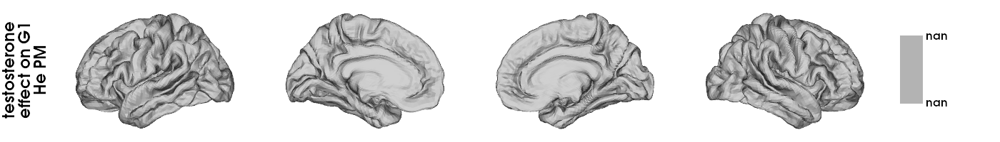

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HePM_test_on_G1.png')

plotted_hemispheres

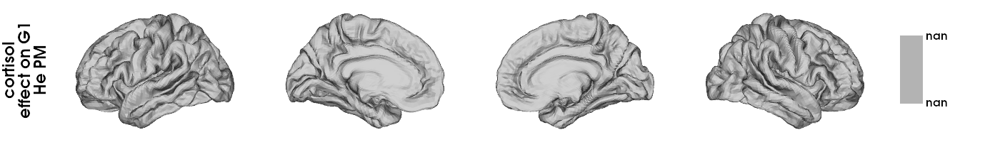

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortisol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["cortisol\neffect on G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HePM_cort_on_G1.png')

plotted_hemispheres

### Run model - perceived stress

In [ ]:
lmer_res_He_PM_stress = {'parcel' : [], 'PSS_t_val': [], 'PSS_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_PM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'PSS': hormones_28He_PM.z_PSS}),  # fixed effects (covariate)
        groups = hormones_28He_PM.time,  # the same across timepoint
        exog_re = None,  # covariates random effects (should be hormones_28He_PM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results 
    lmer_res_He_PM_stress['parcel'].append(i)
    lmer_res_He_PM_stress['PSS_t_val'].append(results.tvalues['PSS'])
    lmer_res_He_PM_stress['PSS_p_val'].append(results.pvalues['PSS'])

lmer_res_He_PM_stress['PSS_q_val'] = fdrcorrection(lmer_res_He_PM_stress['PSS_p_val'], alpha=0.05)[1]

lmer_res_He_PM_stress = pd.DataFrame(lmer_res_He_PM_stress)

In [ ]:
lmer_res_He_PM_stress

,parcel,PSS_t_val,PSS_p_val,PSS_q_val
0,0,-1.107322,0.268155,0.997175
1,1,-0.567223,0.570563,0.997175
2,2,0.947150,0.343562,0.997175
3,3,-0.239239,0.810921,0.997175
4,4,1.038767,0.298913,0.997175
...,...,...,...,...
395,395,-0.455511,0.648742,0.997175
396,396,-0.352622,0.724372,0.997175
397,397,0.623183,0.533164,0.997175
398,398,-0.455276,0.648911,0.997175


In [ ]:
np.where(np.array(lmer_res_He_PM_stress.PSS_q_val) < 0.05)[0].shape

(0,)

In [ ]:
np.isnan(lmer_res_He_PM_stress.PSS_p_val).any()

False

In [ ]:
np.where(np.isnan(lmer_res_He_PM_stress.PSS_p_val))

(array([], dtype=int64),)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [ ]:
PSS_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM_stress.PSS_t_val, seven_networks=False)
PSS_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM_stress.PSS_q_val, seven_networks=False)

#### t-values for q < 0.05

In [ ]:
## find t-values

# PSS

PSS_fdr_corrected_tvals_fs5 = []

for i in range(len(PSS_q_val_fs5)):
    if PSS_q_val_fs5[i] <= 0.05:
        PSS_fdr_corrected_tvals_fs5.append(PSS_t_val_fs5[i])
    else:
        PSS_fdr_corrected_tvals_fs5.append(float('nan'))
        
PSS_fdr_corrected_tvals_fs5 = np.array(PSS_fdr_corrected_tvals_fs5)

### Plot on hemispheres

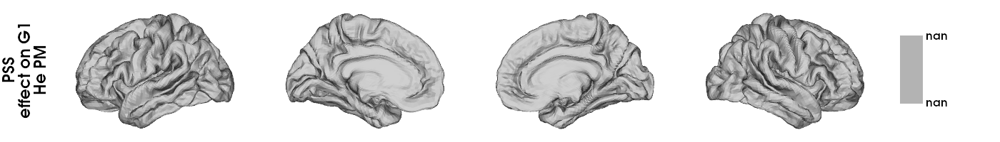

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = PSS_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["PSS\neffect on G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HePM_PSS_on_G1.png')

plotted_hemispheres

## Correlation hormone effects He AM and PM

In [ ]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, lmer_res_He_PM.testosterone_t_val)

SpearmanrResult(correlation=0.5170065437908987, pvalue=1.0141776953982248e-28)

In [ ]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, lmer_res_He_PM.cortisol_t_val)

SpearmanrResult(correlation=0.24527515796973728, pvalue=6.827276588304703e-07)

# Differences in variability

## Me vs He (PM)

### Colormap plotted hemispheres differences Levene FDR non-indicative → should be all blue

Number of parcels for which there males have a statistically significant larger variance than females: 168
Number of parcels for which there females have a statistically significant larger variance than males: 1
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 94
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.56; Females = 1.421
Maximum SD: Males = 7.412; Females = 4.916


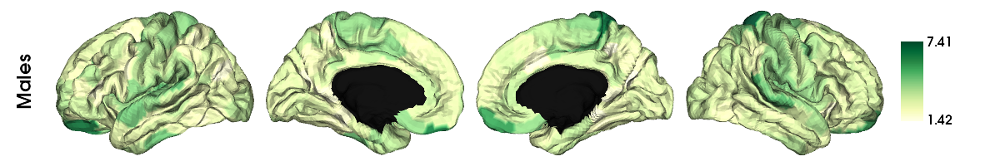

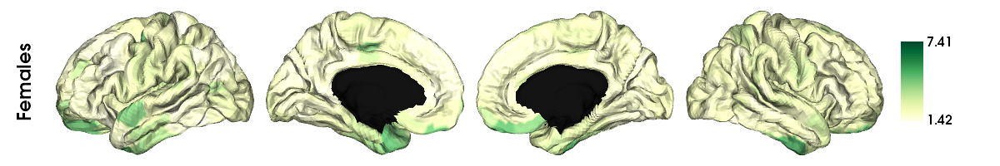

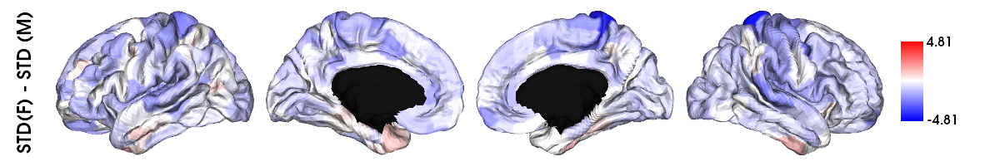

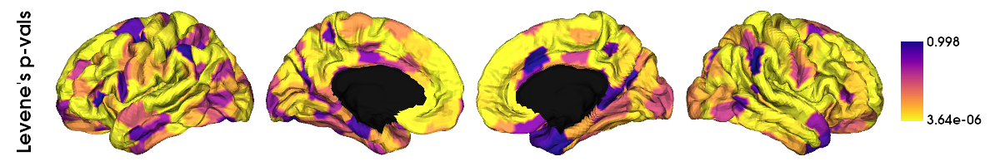

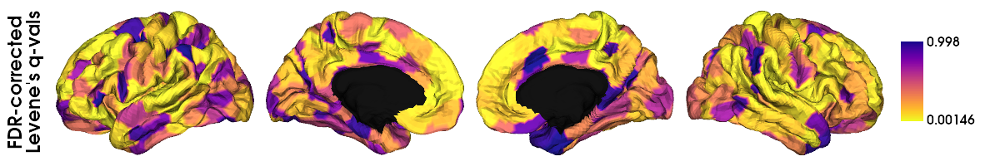

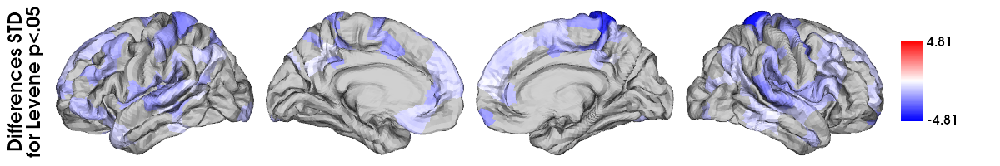

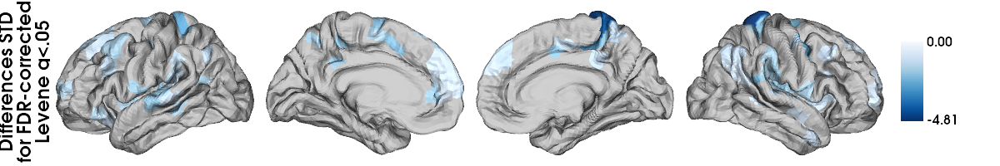

Number of significant parcels: 94

Number of significant parcels for males: 94
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 32 out of 77 (41.56%) -> 34.04% of overall significance
- DMN: 29 out of 46 (63.04%) -> 30.85% of overall significance
- dorsal attention: 4 out of 47 (8.51%) -> 4.26% of overall significance
- ventral attention: 22 out of 26 (84.62%) -> 23.4% of overall significance
- limbic: 0 out of 53 (0.0%) -> 0.0% of overall significance
- fronto parietal: 7 out of 90 (7.78%) -> 7.45% of overall significance





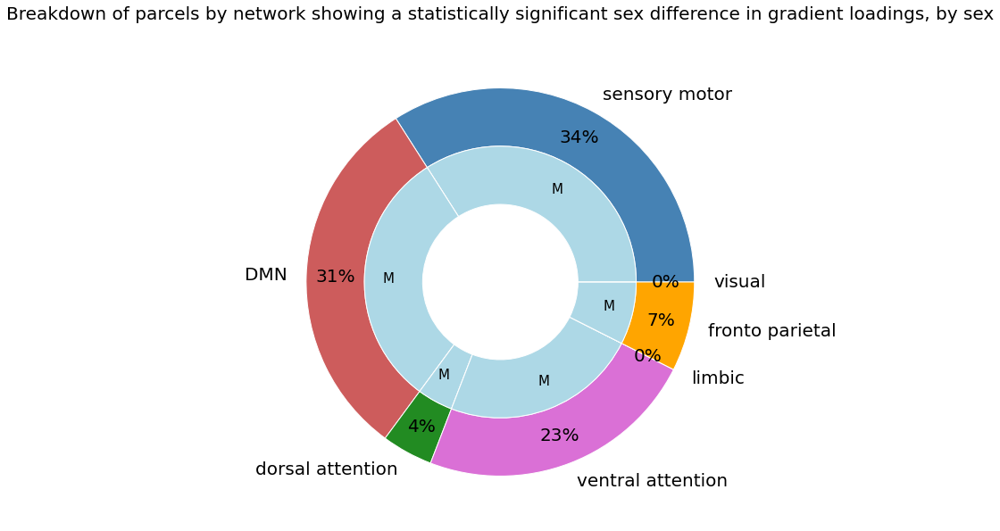

Number of significant parcels by sex:
visual - Male: 0, Female: 0
sensory motor - Male: 32, Female: 0
DMN - Male: 29, Female: 0
dorsal attention - Male: 4, Female: 0
ventral attention - Male: 22, Female: 0
limbic - Male: 0, Female: 0
fronto parietal - Male: 7, Female: 0





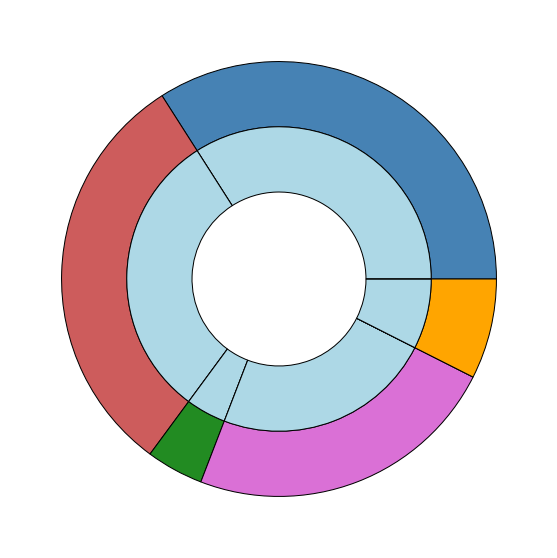

In [ ]:
diff_std_Me_He_PM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_PM_G1, subject_grad_F=array_aligned_fc_G1_excl26, sample_modality='Me_HePM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


## Me vs He (AM&PM)

### Colormap plotted hemispheres differences Levene FDR non-indicative → should be all blue

Number of parcels for which there males have a statistically significant larger variance than females: 163
Number of parcels for which there females have a statistically significant larger variance than males: 2
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 111
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 1

Minimum SD: Males = 1.574; Females = 1.421
Maximum SD: Males = 6.105; Females = 4.916


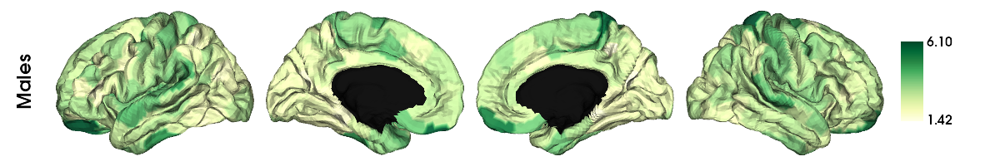

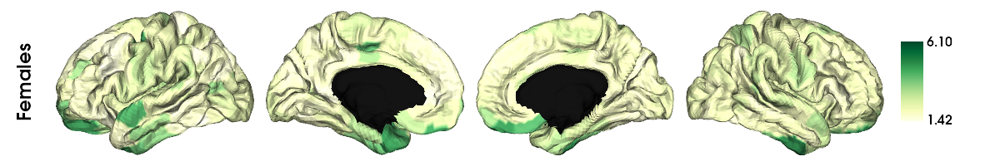

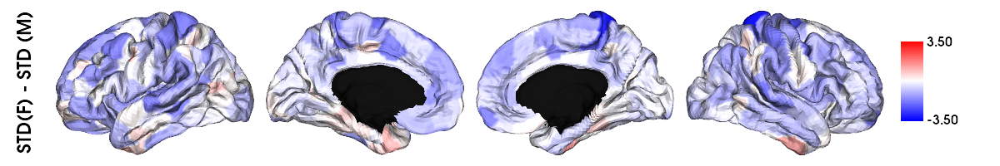

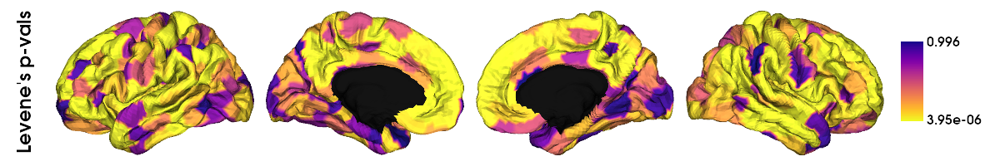

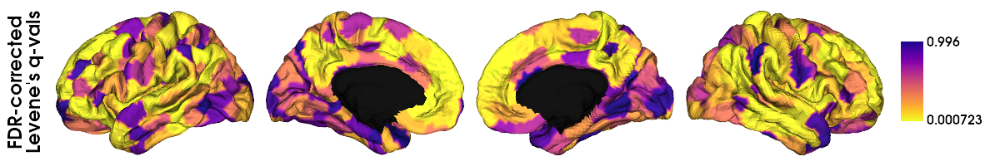

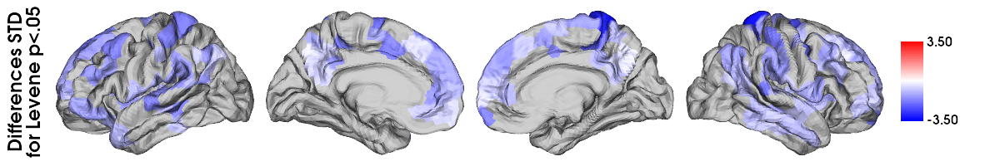

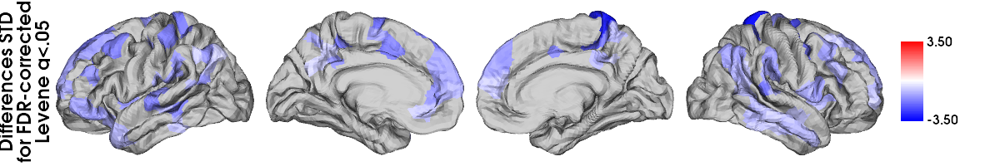

Number of significant parcels: 112

Number of significant parcels for males: 111
Number of significant parcels for females: 1

Number of significant parcels in each Yeo network (across sexes):
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 23 out of 77 (29.87%) -> 20.54% of overall significance
- DMN: 45 out of 46 (97.83%) -> 40.18% of overall significance
- dorsal attention: 5 out of 47 (10.64%) -> 4.46% of overall significance
- ventral attention: 24 out of 26 (92.31%) -> 21.43% of overall significance
- limbic: 2 out of 53 (3.77%) -> 1.79% of overall significance
- fronto parietal: 13 out of 90 (14.44%) -> 11.61% of overall significance





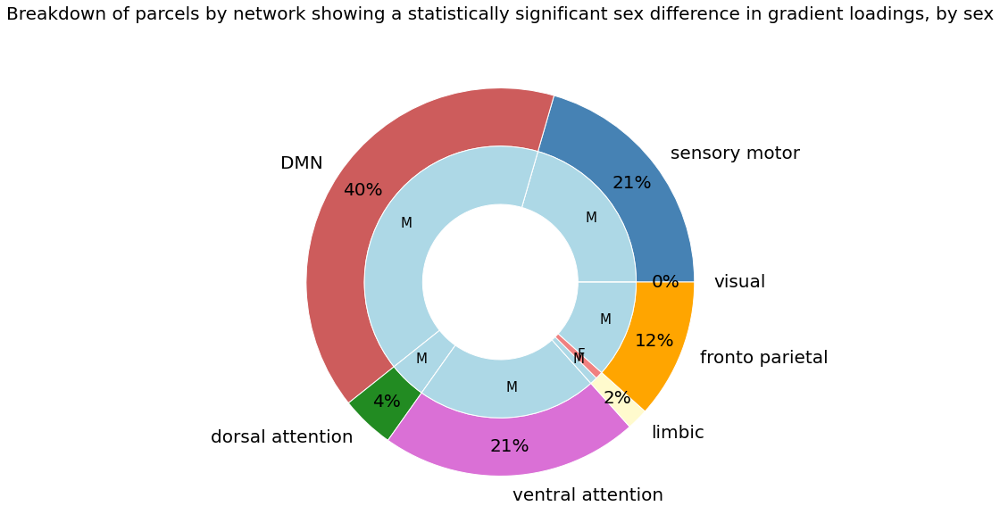

Number of significant parcels by sex:
visual - Male: 0, Female: 0
sensory motor - Male: 23, Female: 0
DMN - Male: 45, Female: 0
dorsal attention - Male: 5, Female: 0
ventral attention - Male: 24, Female: 0
limbic - Male: 1, Female: 1
fronto parietal - Male: 13, Female: 0





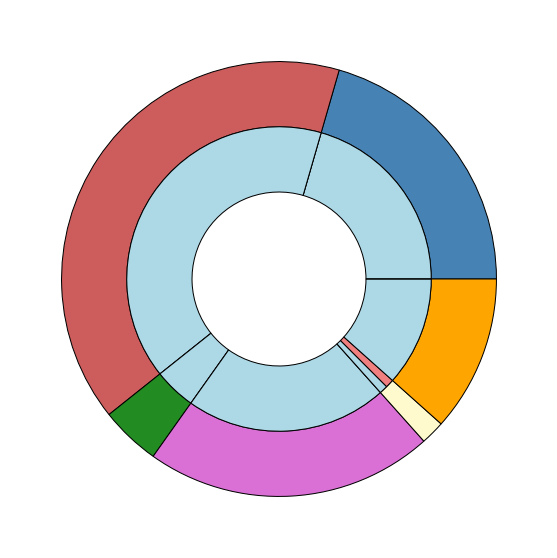

In [ ]:
diff_std_Me_He_PM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_G1, subject_grad_F=array_aligned_fc_G1_excl26, sample_modality='Me_He', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


## Difference in variability between M and F when taking same number of datapoints for M & F (n=20)

### Make new aligned gradients for F

#### Exclude 10 equally-spaced datapoints from original 30-long array (including day 26 (index 25) given that needs to be excluded anyway)

In [ ]:
fc_matrices_n20 =  np.delete(fc_matrices, [1,4,7,10,13,16,19,22,25,28], axis = 0)

In [ ]:
fc_matrices_n20.shape

(20, 400, 400)

### Mean gradient

In [ ]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_n20 = sum(fc_matrices_n20)/len(fc_matrices_n20)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_excl26 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_n20 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_n20.fit(mean_fc_matrix_n20)

# mean G1
mean_fc_G1_n20 = mean_fc_grad_n20.gradients_[:,0]

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')


#### Plot on hemispheres

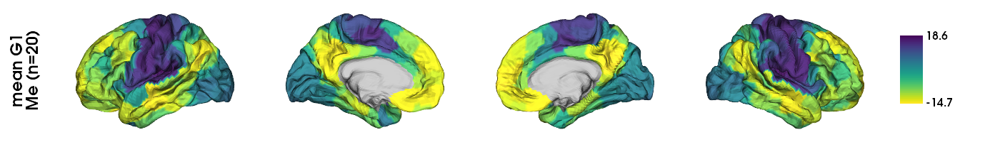

In [ ]:
### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
# and the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_n20_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_n20, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_n20_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nMe (n=20)"],
    zoom = 1.45,
    screenshot = False)

plotted_hemispheres

### Aligned gradients

In [ ]:
compute_aligned_grad_n20 = compute_aligned_gradients(fc_matrices_n20, mean_fc_grad_n20.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1_n20 = compute_aligned_grad_n20['array_aligned_G1']

In [ ]:
array_aligned_fc_G1_n20.shape

(20, 400)

### Differences in variability

Number of parcels for which there males have a statistically significant larger variance than females: 69
Number of parcels for which there females have a statistically significant larger variance than males: 2
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 0
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.399; Females = 1.214
Maximum SD: Males = 5.247; Females = 5.043


/tmp/ipykernel_4616/1849898711.py:92: RuntimeWarning: All-NaN slice encountered
  color_range_custom = (0, np.nanmax(std_grad_fdr_corr_levene_sig_sexdiff))
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


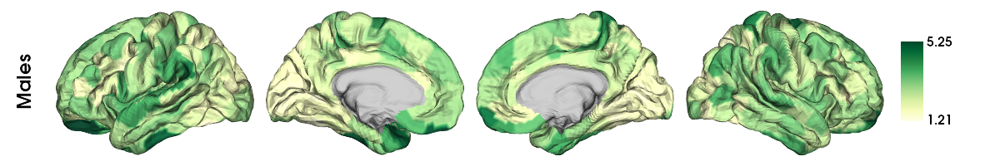

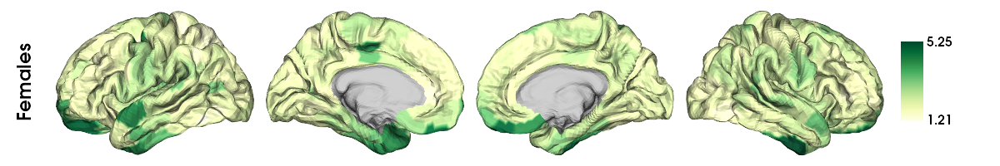

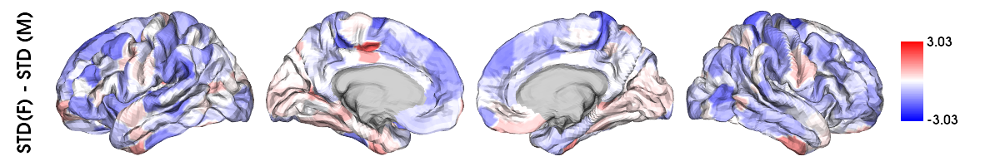

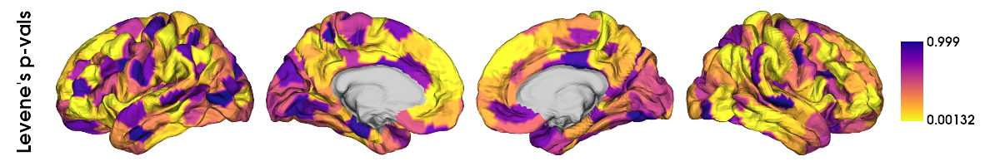

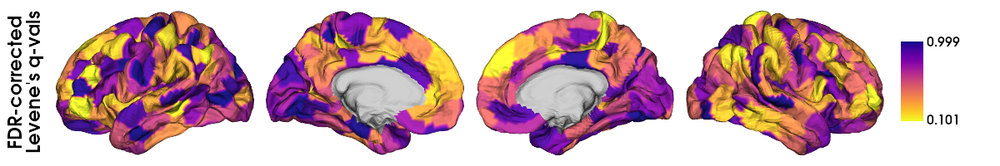

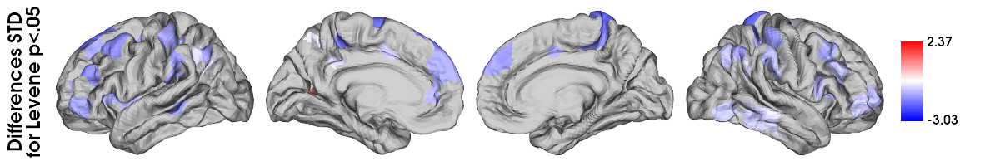

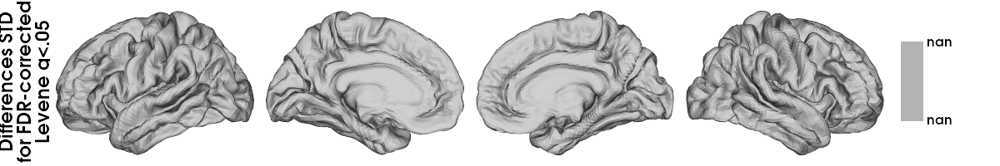

Number of significant parcels: 0

Number of significant parcels for males: 0
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):


ZeroDivisionError: division by zero

In [ ]:
diff_std_Me_He_AM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_AM_G1, subject_grad_F=array_aligned_fc_G1_n20, sample_modality='Me_HeAM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)
